In [8]:
import os
import pandas as pd
from tqdm import tqdm
from datetime import timedelta
import requests
from zipfile import ZipFile
import numpy as np
import shutil

def download_and_extract(zip_urls, download_folder, extract_folder):
    """
    Downloads ZIP files from provided URLs and extracts their contents.
    """
    os.makedirs(download_folder, exist_ok=True)
    os.makedirs(extract_folder, exist_ok=True)
    
    for idx, url in enumerate(zip_urls):
        print(f"({idx + 1}/{len(zip_urls)}) Downloading: {url}")
        zip_filename = os.path.join(download_folder, os.path.basename(url))
        
        # Download the file
        with requests.get(url, stream=True) as response:
            response.raise_for_status()
            with open(zip_filename, 'wb') as f:
                for chunk in response.iter_content(chunk_size=8192):
                    f.write(chunk)
        
        print(f"Downloaded: {zip_filename}")
        
        # Extract the ZIP file
        with ZipFile(zip_filename, 'r') as zip_ref:
            zip_ref.extractall(extract_folder)
            print(f"Extracted: {zip_filename} to {extract_folder}")


def process_large_csv(csv_files, temp_folder, chunk_size=100000):
    """Reads large CSV files and splits them into individual MMSI files."""
    os.makedirs(temp_folder, exist_ok=True)
    mmsi_dict = {}

    for csv_file in csv_files:
        print(f"Processing {csv_file}...")
        with tqdm(total=sum(1 for _ in open(csv_file)) - 1, desc="Processing chunks", unit="rows") as pbar:
            for chunk in pd.read_csv(csv_file, chunksize=chunk_size):
                # Filter out rows with 'Unknown value' in Navigational Status
                chunk = chunk[chunk['Navigational status'] != 'Unknown value']
                for mmsi, group in chunk.groupby('MMSI'):
                    if mmsi not in mmsi_dict:
                        mmsi_dict[mmsi] = group
                    else:
                        mmsi_dict[mmsi] = pd.concat([mmsi_dict[mmsi], group])
                pbar.update(len(chunk))
    
    # Save individual MMSI files
    for mmsi, group in tqdm(mmsi_dict.items(), desc="Saving MMSI files"):
        output_file = os.path.join(temp_folder, f"{mmsi}.csv")
        group.to_csv(output_file, index=False)

def filter_by_area(input_folder, output_folder, area_bounds):
    """Filters MMSI files for entries within a specified geographical area."""
    os.makedirs(output_folder, exist_ok=True)
    min_lat, max_lat, min_lon, max_lon = area_bounds

    for file in tqdm(os.listdir(input_folder), desc="Filtering by area"):
        if not file.endswith('.csv'):
            continue
        df = pd.read_csv(os.path.join(input_folder, file))
        df = df[(df['Latitude'] >= min_lat) & (df['Latitude'] <= max_lat) & 
                (df['Longitude'] >= min_lon) & (df['Longitude'] <= max_lon)]
        if len(df) >= 10:  # Ensure at least 10 consecutive entries
            df.to_csv(os.path.join(output_folder, file), index=False)

def extract_time_sets(input_folder, output_folder, duration_minutes=30, tolerance_seconds=10):
    """Extracts time sets with consistent Navigational Status and saves each as a separate file with time range in the filename.
    Adds tolerance for duration of groups to account for small discrepancies (e.g., ±10 seconds).
    """
    os.makedirs(output_folder, exist_ok=True)

    for file in tqdm(os.listdir(input_folder), desc=f"Extracting {duration_minutes}-min sets"):
        if not file.endswith('.csv'):
            continue

        # Load the CSV file
        file_path = os.path.join(input_folder, file)
        try:
            df = pd.read_csv(file_path)

            # Strip leading and trailing spaces and remove the '#' from column names
            df.columns = df.columns.str.strip().str.lstrip('# ')
            print(f"Cleaned column names: {list(df.columns)}")

            # Ensure the 'Timestamp' column exists
            if 'Timestamp' not in df.columns:
                print(f"Error: 'Timestamp' column not found in {file}")
                continue

            # Convert the 'Timestamp' column to datetime
            try:
                df['Timestamp'] = pd.to_datetime(df['Timestamp'], format='%d/%m/%Y %H:%M:%S', errors='coerce')
            except Exception as e:
                print(f"Error parsing 'Timestamp' in {file}: {e}")
                continue

            # Drop rows with invalid timestamps
            df = df.dropna(subset=['Timestamp'])

            # Skip files with only one entry
            if len(df) == 1:
                print(f"File '{file}' contains only one entry and will be skipped.")
                continue

            # Sort the DataFrame by timestamp
            df = df.sort_values('Timestamp')

            # Calculate the duration in minutes for each row and ensure it's consistent with the desired interval
            time_delta = pd.Timedelta(minutes=duration_minutes)

            # Calculate time groupings: we use the first timestamp to start the interval and group by durations
            df['Time_Group'] = ((df['Timestamp'] - df['Timestamp'].min()) // time_delta)

            grouped = df.groupby('Time_Group')

            valid_sets = 0
            for group_id, group in grouped:
                # Check if the Navigational Status is consistent
                if group['Navigational status'].nunique() == 1:
                    # Calculate the duration of the group
                    group_duration = group['Timestamp'].max() - group['Timestamp'].min()

                    # Calculate the expected duration in seconds
                    expected_duration_seconds = time_delta.total_seconds()

                    # Calculate the tolerance range (±10 seconds)
                    tolerance_range_min = expected_duration_seconds - tolerance_seconds
                    tolerance_range_max = expected_duration_seconds + tolerance_seconds
                    group_duration_seconds = group_duration.total_seconds()

                    # Skip groups that don't match the expected duration +/- tolerance
                    if not (tolerance_range_min <= group_duration_seconds <= tolerance_range_max):
                        print(f"File '{file}' has a group with a duration of {group_duration}. Skipping group {group_id}.")
                        continue

                    valid_sets += 1

                    # Get start and end times for the interval
                    start_time = group['Timestamp'].min().strftime('%Y%m%d_%H%M')
                    end_time = group['Timestamp'].max().strftime('%Y%m%d_%H%M')

                    # Construct the output filename with time range in the format: original_filename_starttime-endtime.csv
                    output_filename = f"{os.path.splitext(file)[0]}_{start_time}-{end_time}.csv"
                    output_path = os.path.join(output_folder, output_filename)

                    # Save the group as a separate file
                    group.to_csv(output_path, index=False)
                    print(f"Saved {duration_minutes}-min set: {output_filename}")

            if valid_sets == 0:
                print(f"No valid {duration_minutes}-min sets found in {file}.")

        except Exception as e:
            print(f"Error processing file {file}: {e}")

def analyze_navigational_status(input_folder):
    """Analyzes the distribution of 30-minute sets by Navigational Status."""
    status_counts = {}

    for file in tqdm(os.listdir(input_folder), desc="Analyzing Navigational Status"):
        if not file.endswith('.csv'):
            continue
        df = pd.read_csv(os.path.join(input_folder, file))
        status = df['Navigational status'].iloc[0]  # Assuming consistent status in each set
        status_counts[status] = status_counts.get(status, 0) + 1

    return status_counts

def filter_and_save_csv(input_folder: str, output_folder: str, columns_to_keep: list, row_filter: str = None):
    """
    Processes CSV files in the input folder, keeps only the specified columns,
    optionally applies row filtering, removes duplicate rows based on "Timestamp",
    and saves the filtered CSV files to the output folder.

    Parameters:
    - input_folder (str): Path to the folder containing input .csv files.
    - output_folder (str): Path to the folder where the filtered .csv files will be saved.
    - columns_to_keep (list): List of column names to retain.
    - row_filter (str, optional): A string representing a row filter condition, 
                                  e.g., 'SOG > 0'. Defaults to None (no row filtering).
    """
    # Ensure the output folder exists
    os.makedirs(output_folder, exist_ok=True)
    
    # List all the CSV files in the input folder
    csv_files = [f for f in os.listdir(input_folder) if f.endswith('.csv')]

    for file in csv_files:
        file_path = os.path.join(input_folder, file)
        
        # Read the CSV file
        df = pd.read_csv(file_path)
        
        # Remove duplicate rows based on the "Timestamp" column
        df = df.drop_duplicates(subset=["Timestamp"], keep="first")
        
        # Filter only the columns you need
        df_filtered = df[columns_to_keep]
        
        # Apply the row filtering condition if provided
        if row_filter:
            df_filtered = df_filtered.query(row_filter)
        
        # Save the filtered DataFrame to the output folder
        output_path = os.path.join(output_folder, f'filtered_{file}')
        df_filtered.to_csv(output_path, index=False)
        
        print(f"Processed {file} and saved to {output_path}")

def check_missing_values_in_csv(directory_path):
    # Loop through all CSV files in the specified directory
    for filename in os.listdir(directory_path):
        if filename.endswith(".csv"):
            file_path = os.path.join(directory_path, filename)
            df = pd.read_csv(file_path)
            
            # Check for missing values in each column
            missing_data = df.isnull().sum()
            
            print(f"Missing values in {filename}:")
            print(missing_data)
            
            # Handle missing values:
            for column in df.columns:
                if missing_data[column] > 0:
                    # Suggestion for handling missing values
                    print(f"\nColumn: {column}")
                    if df[column].dtype in ['float64', 'int64']:
                        # Numeric columns: Suggest filling or interpolating
                        print(f"Suggested action: Interpolate missing values or fill with a default value (e.g., 0).")
                    else:
                        # Non-numeric columns (e.g., text): Suggest filling with the mode or dropping rows
                        print(f"Suggested action: Fill missing values with the most frequent value or drop rows.")
            
            print("\n")

def process_csv_files(input_folder):
    """
    Processes CSV files in a given folder to handle missing numerical values.

    Parameters:
    input_folder (str): Path to the folder containing CSV files.

    Returns:
    dict: A dictionary with statistics about the processing.
    """
    # Counters for statistics
    files_deleted = 0
    files_with_interpolation = 0

    # Function to process a single CSV file
    def process_csv(file_path):
        nonlocal files_deleted, files_with_interpolation

        try:
            # Read the CSV file
            df = pd.read_csv(file_path, parse_dates=['Timestamp'])

            # Ensure numerical columns only
            numerical_columns = ['Latitude', 'Longitude', 'SOG', 'COG', 'Heading']
            for col in numerical_columns:
                if col not in df.columns:
                    raise ValueError(f"Missing expected column: {col}")

            # Check for columns with all missing values
            for col in numerical_columns:
                if df[col].isnull().all():
                    print(f"File {file_path} has an entire column '{col}' with missing values. Deleting file.")
                    os.remove(file_path)
                    files_deleted += 1
                    return

            # Calculate missing values per row in numerical columns
            df['missing_values_count'] = df[numerical_columns].isnull().sum(axis=1)

            # Check for rows with more than 50% missing numerical values
            if (df['missing_values_count'] > len(numerical_columns) / 2).any():
                print(f"File {file_path} has rows with >50% missing values. Deleting file.")
                os.remove(file_path)
                files_deleted += 1
                return

            # Check if any interpolation is needed
            if df[numerical_columns].isnull().any().any():
                print(f"File {file_path} requires interpolation.")
                files_with_interpolation += 1

            # Ensure Timestamp column is properly parsed and set as the index
            df['Timestamp'] = pd.to_datetime(df['Timestamp'])
            df = df.set_index('Timestamp')

            # Interpolate missing values based on the timestamp
            df[numerical_columns] = df[numerical_columns].interpolate(
                method='time', limit_direction='both', axis=0
            )

            # Reset the index after interpolation
            df = df.reset_index()

            # Drop the helper column
            df = df.drop(columns=['missing_values_count'])

            # Overwrite the original file
            df.to_csv(file_path, index=False)
            print(f"File {file_path} has been updated.")

        except Exception as e:
            print(f"Error processing file {file_path}: {e}")

    # Iterate over all files in the folder
    for filename in os.listdir(input_folder):
        if filename.endswith(".csv"):
            file_path = os.path.join(input_folder, filename)
            process_csv(file_path)

    # Final check for missing values in all processed files
    missing_values_found = False
    for filename in os.listdir(input_folder):
        if filename.endswith(".csv"):
            file_path = os.path.join(input_folder, filename)
            df = pd.read_csv(file_path)
            if df.isnull().any().any():
                print(f"File {file_path} still contains missing values!")
                missing_values_found = True

    if not missing_values_found:
        print("No missing values found in any processed files.")

    # Return statistics
    return {
        "files_deleted": files_deleted,
        "files_with_interpolation": files_with_interpolation,
        "missing_values_remaining": missing_values_found
    }

# Function to standardize the time intervals in each CSV file
def standardize_time_intervals(file_path, interval_seconds=10, output_folder="standardized_files"):
    # Step 1: Read the CSV file
    df = pd.read_csv(file_path)
    
    # Step 2: Convert the 'Timestamp' column to datetime format
    df['Timestamp'] = pd.to_datetime(df['Timestamp'])
    
    # Step 3: Generate a regular time range starting from the first timestamp to the last
    start_time = df['Timestamp'].min()
    end_time = df['Timestamp'].max()
    
    # Create a new time index with the specified interval (e.g., every 10 seconds)
    new_time_index = pd.date_range(start=start_time, end=end_time, freq=f'{interval_seconds}s')
    
    # Step 4: Interpolate the data for each numerical column
    df.set_index('Timestamp', inplace=True)
    
    # Reindex the dataframe to the new time index and interpolate missing numerical values
    df_resampled = df.reindex(new_time_index)

    # Interpolate only numerical columns
    numerical_columns = df.select_dtypes(include=[np.number]).columns
    df_resampled[numerical_columns] = df_resampled[numerical_columns].interpolate(method='linear')

    # For non-numerical columns (like 'Navigational Status'), we fill the missing values by forward filling (ffill)
    df_resampled['Navigational status'] = df_resampled['Navigational status'].ffill()

    # Reset index to have Timestamp as a column again
    df_resampled.reset_index(inplace=True)
    df_resampled.rename(columns={'index': 'Timestamp'}, inplace=True)
    
    # Step 5: Ensure output folder exists, create if it doesn't
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    
    # Generate the output file path
    output_path = os.path.join(output_folder, file_path.split(os.sep)[-1].replace('.csv', f'_standardized_{interval_seconds}s.csv'))
    
    # Step 6: Save the result to a new CSV file in the output folder
    df_resampled.to_csv(output_path, index=False)
    print(f"Standardized file saved to {output_path}")

# Step 11: Function to process each CSV file
def process_csv_step11(file_path, output_path):
    # Read the CSV file
    df = pd.read_csv(file_path)
    
    # Remove the specified columns
    columns_to_remove = ['MMSI', 'Latitude', 'Longitude']
    df = df.drop(columns=columns_to_remove, errors='ignore')
    
    # Check if 'COG' and 'Heading' columns exist and subtract the first value of 'COG' from both columns
    if 'COG' in df.columns and 'Heading' in df.columns:
        first_cog = df['COG'].iloc[0]
        
        # Subtract the first 'COG' value from all 'COG' and 'Heading' values, ensuring the 0-360 format
        def adjust_angle(x, first_cog_value):
            diff = x - first_cog_value
            return (diff + 360) % 360
    
        df['COG'] = df['COG'].apply(lambda x: adjust_angle(x, first_cog))
        df['Heading'] = df['Heading'].apply(lambda x: adjust_angle(x, first_cog))
          
    # Save the modified DataFrame to the new folder
    df.to_csv(output_path, index=False)
    # print(f"Processed file saved to: {output_path}")

# Step 12: Speed threshold
def check_and_move_files(folder_1, folder_2, dest_folder_1, dest_folder_2, sog_threshold_fishing, sog_threshold_underway):
    # Ensure the destination folders exist, create them if not
    os.makedirs(dest_folder_1, exist_ok=True)
    os.makedirs(dest_folder_2, exist_ok=True)

    # Step 1: Get all CSV files in the two specified folders
    csv_files_1 = [f for f in os.listdir(folder_1) if f.endswith('.csv')]
    csv_files_2 = [f for f in os.listdir(folder_2) if f.endswith('.csv')]

    # Function to check conditions and move files for a given folder
    def process_files_in_folder(folder, dest_folder, sog_threshold_fishing, sog_threshold_underway):
        for csv_file in os.listdir(folder):
            if csv_file.endswith('.csv'):
                file_path = os.path.join(folder, csv_file)
                try:
                    df = pd.read_csv(file_path)

                    # Case 1: Check for "Engaged in fishing" and mean SOG > sog_threshold_fishing
                    fishing_condition = (df['Navigational status'] == 'Engaged in fishing')
                    mean_sog = df['SOG'].mean()
                    
                    # Case 2: Check for "Underway using engine" and any SOG > sog_threshold_underway
                    underway_condition = (df['Navigational status'] == 'Underway using engine')
                    sog_above_threshold = df['SOG'] > sog_threshold_underway
                    
                    # If any condition is met, move the file
                    if (fishing_condition.any() and mean_sog > sog_threshold_fishing) or \
                       (underway_condition.any() and sog_above_threshold.any()):
                        shutil.move(file_path, os.path.join(dest_folder, csv_file))
                        print(f"Moved {csv_file} from {folder} to {dest_folder}")

                except Exception as e:
                    print(f"Failed to process {csv_file} in {folder}: {e}")

    # Process files in both folders
    process_files_in_folder(folder_1, dest_folder_1, sog_threshold_fishing, sog_threshold_underway)
    process_files_in_folder(folder_2, dest_folder_2, sog_threshold_fishing, sog_threshold_underway)

def integrate_pipeline_with_web_sources(zip_urls, temp_folder, area_bounds):
    """
    Downloads and processes ZIP files, extracting CSVs and running the pipeline.
    """
    """# Step 1: Download and Extract
    # download_folder = './downloaded_zips'
    extract_folder = './extracted_files'    
    # download_and_extract(zip_urls, download_folder, extract_folder)

    # Step 2: Split CSVs into MMSI-specific files
    process_large_csv([os.path.join(extract_folder, f) for f in os.listdir(extract_folder) if f.endswith('.csv')], temp_folder)

    # Step 3: Filter files by geographical area
    filtered_folder = './filtered_area'
    filter_by_area(temp_folder, filtered_folder, area_bounds)"""

    # Step 4: Extract time sets
    extract_time_sets(input_folder='./filtered_area', output_folder='./time_sets', duration_minutes=15, tolerance_seconds=10)

    # Step 5: Analyze Navigational Status
    sets_folder = './time_sets'
    status_distribution = analyze_navigational_status(sets_folder)
    print("Distribution of Navigational Status:", status_distribution)

    # Step 6: Slim the .csv files down to what we want to work with
    input_folder = './time_sets'
    output_folder = './time_sets_slim'

    # Columns you want to retain in the filtered CSVs
    columns_to_keep = [
        'Timestamp', 'MMSI', 'Latitude', 'Longitude', 
        'Navigational status', 'SOG', 'COG', 'Heading'
    ]

    # Optionally define a row filter (e.g., remove rows with SOG <= 0)
    # row_filter = 'SOG > 0'  # Optional, can be set to None if no filtering is needed

    # Call the function
    filter_and_save_csv(input_folder, output_folder, columns_to_keep)

    # Step 7: Getting overview of missing values in the slimmed sets
    directory_path = "./time_sets_slim"
    check_missing_values_in_csv(directory_path)

    # Step 8: Imputing and deleting
    input_folder = "./time_sets_slim"
    process_csv_files(input_folder)

    # Step 9: Analyze Navigational Status again
    sets_folder = './time_sets_standardized'
    status_distribution = analyze_navigational_status(sets_folder)
    print("Distribution of Navigational Status:", status_distribution)

    # Step 10: standardize to specified interval in files
    folder_path = 'time_sets_slim'
    output_folder = 'time_sets_standardized'

    for file_name in os.listdir(folder_path):
        if file_name.endswith('.csv'):
            file_path = os.path.join(folder_path, file_name)
            standardize_time_intervals(file_path, interval_seconds=10, output_folder=output_folder)  # Adjust interval as needed
    
    # Step 11: cut down to what we would have in radar and zeroed course
    # Define the input and output folders
    input_folder = 'time_sets_standardized'  # Replace with your folder containing CSV files
    output_folder = 'time_sets_st_shortened'
    # Create the output folder if it doesn't exist
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    # Iterate through all CSV files in the input folder
    for filename in os.listdir(input_folder):
        if filename.endswith('.csv'):
            input_file = os.path.join(input_folder, filename)
            output_file = os.path.join(output_folder, filename)
            
            # Process each CSV file
            process_csv_step11(input_file, output_file)
    
    # Step 12: Speed thresholds
    folder_1 = 'time_sets_standardized'
    folder_2 = 'time_sets_st_shortened'
    dest_folder_1 = 'time_sets_standardized_out'
    dest_folder_2 = 'time_sets_st_shortened_out'

    sog_threshold_fishing = 10.0  # Example threshold for "Engaged in fishing" scenario
    sog_threshold_underway = 30.0  # Example threshold for "Underway using engine" scenario

    check_and_move_files(folder_1, folder_2, dest_folder_1, dest_folder_2, sog_threshold_fishing, sog_threshold_underway)
    


# Example URLs for ZIP files (replace with actual URLs)
zip_urls = [
    "https://web.ais.dk/aisdata/aisdk-2024-05-24.zip",
    "https://web.ais.dk/aisdata/aisdk-2024-05-23.zip",
    "https://web.ais.dk/aisdata/aisdk-2024-05-22.zip"
]

# Example usage
area_bounds = (55.0, 56.0, 7.0, 8.0)  # Define your area
temp_folder = './mmsi_temp'
integrate_pipeline_with_web_sources(zip_urls, temp_folder, area_bounds)


Extracting 15-min sets:   0%|          | 0/2057 [00:00<?, ?it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 111219502_20240621_1430-20240621_1445.csv
Saved 15-min set: 111219502_20240621_1445-20240621_1500.csv
File '111219502.csv' has a group with a duration of 0 days 00:13:11. Skipping group 2.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '111219508.csv' has a group with a duration of 0 days 00:01:08. Skipping group 0.
No valid 15-min sets found in 111219508.csv.
Cleaned column na

Extracting 15-min sets:   0%|          | 6/2057 [00:00<03:19, 10.26it/s]

Saved 15-min set: 205144000_20240626_1158-20240626_1213.csv
File '205144000.csv' has a group with a duration of 0 days 00:08:10. Skipping group 660.
Saved 15-min set: 205144000_20240627_1358-20240627_1413.csv
File '205144000.csv' has a group with a duration of 0 days 00:12:28. Skipping group 765.
File '205144000.csv' has a group with a duration of 0 days 00:12:00. Skipping group 766.
File '205144000.csv' has a group with a duration of 0 days 00:12:27. Skipping group 767.
File '205144000.csv' has a group with a duration of 0 days 00:11:59. Skipping group 768.
File '205144000.csv' has a group with a duration of 0 days 00:12:29. Skipping group 769.
File '205144000.csv' has a group with a duration of 0 days 00:12:02. Skipping group 770.
File '205144000.csv' has a group with a duration of 0 days 00:12:00. Skipping group 771.
File '205144000.csv' has a group with a duration of 0 days 00:12:00. Skipping group 772.
File '205144000.csv' has a group with a duration of 0 days 00:11:58. Skipping g

Extracting 15-min sets:   0%|          | 9/2057 [00:00<02:30, 13.59it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 207138000_20240604_1428-20240604_1442.csv
Saved 15-min set: 207138000_20240604_1443-20240604_1457.csv
Saved 15-min set: 207138000_20240604_1458-20240604_1512.csv
Saved 15-min set: 207138000_20240604_1513-20240604_1527.csv
Saved 15-min set: 207138000_20240604_1528-20240604_1542.csv
File '207138000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 5.
File '207138000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 207138000_20240604_1613-20240604_1627.csv
Saved 15-min set: 207138000_20240604_1628-20240604_1642.csv
File '207138000.csv' has a group with a duration of 0 days 00:10:11. Skipping group 

Extracting 15-min sets:   1%|          | 11/2057 [00:01<03:05, 11.02it/s]

Saved 15-min set: 209114000_20240614_2327-20240614_2342.csv
Saved 15-min set: 209114000_20240614_2342-20240614_2357.csv
File '209114000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 868.
Saved 15-min set: 209114000_20240615_0012-20240615_0027.csv
File '209114000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 870.
Saved 15-min set: 209114000_20240615_0042-20240615_0057.csv
Saved 15-min set: 209114000_20240615_0057-20240615_0112.csv
File '209114000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 873.
Saved 15-min set: 209114000_20240615_0127-20240615_0142.csv
Saved 15-min set: 209114000_20240615_0142-20240615_0157.csv
Saved 15-min set: 209114000_20240615_0157-20240615_0212.csv
Saved 15-min set: 209114000_20240615_0212-20240615_0227.csv
Saved 15-min set: 209114000_20240615_0227-20240615_0242.csv
Saved 15-min set: 209114000_20240615_0242-20240615_0257.csv
File '209114000.csv' has a group with a duration of 0 days 00:14:39. Skip

Extracting 15-min sets:   1%|          | 13/2057 [00:01<03:22, 10.11it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 209217000_20240604_0413-20240604_0428.csv
Saved 15-min set: 209217000_20240604_0428-20240604_0443.csv
Saved 15-min set: 209217000_20240604_0443-20240604_0458.csv
Saved 15-min set: 209217000_20240604_0458-20240604_0513.csv
Saved 15-min set: 209217000_20240604_0513-20240604_0528.csv
Saved 15-min set: 209217000_20240604_0528-20240604_0543.csv
File '209217000.csv' has a group with a duration of 0 days 00:11:09. Skipping group 6.
File '209217000.csv' has a group with a duration of 0 days 00:00:20. Skipping group 180.
File '209217000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 181.
Saved 15-min set: 209217000_20240606_0143-20240606_01

Extracting 15-min sets:   1%|          | 16/2057 [00:01<02:53, 11.79it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 209223000_20240628_0349-20240628_0404.csv
File '209223000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1.
File '209223000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
File '209223000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 209223000_20240628_0449-20240628_0504.csv
Saved 15-min set: 209223000_20240628_0504-20240628_0519.csv
File '209223000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 209223000_20240628_0534-20240628_0549.csv
File '209223000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
Sav

Extracting 15-min sets:   1%|          | 19/2057 [00:01<02:25, 14.03it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 209313000_20240616_1842-20240616_1857.csv
Saved 15-min set: 209313000_20240616_1857-20240616_1912.csv
File '209313000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 2.
File '209313000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 3.
Saved 15-min set: 209313000_20240616_1942-20240616_1957.csv
File '209313000.csv' has a group with a duration of 0 days 00:14:43. Skipping group 5.
Saved 15-min set: 209313000_20240616_2012-20240616_2027.csv
File '209313000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 7.
File '209313000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 8.
Sav

Extracting 15-min sets:   1%|          | 21/2057 [00:01<02:19, 14.57it/s]

Saved 15-min set: 209332000_20240621_1559-20240621_1614.csv
File '209332000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 915.
Saved 15-min set: 209332000_20240621_1629-20240621_1644.csv
File '209332000.csv' has a group with a duration of 0 days 00:14:29. Skipping group 917.
Saved 15-min set: 209332000_20240621_1659-20240621_1714.csv
File '209332000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 919.
Saved 15-min set: 209332000_20240621_1729-20240621_1744.csv
File '209332000.csv' has a group with a duration of 0 days 00:02:51. Skipping group 921.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 209391000_20240626_0506-20240626_0521.csv
Saved 15-min set: 2093

Extracting 15-min sets:   1%|          | 23/2057 [00:01<02:24, 14.08it/s]

Saved 15-min set: 209525000_20240626_1949-20240626_2003.csv
File '209525000.csv' has a group with a duration of 0 days 00:00:41. Skipping group 2335.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 209535000_20240607_0033-20240607_0048.csv
File '209535000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '209535000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
File '209535000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 3.
Saved 15-min set: 209535000_20240607_0133-20240607_0148.csv
Saved 15-min set: 209535000_20240607_0148-20240607_0203.csv
File '209535000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.


Extracting 15-min sets:   1%|          | 25/2057 [00:02<03:28,  9.74it/s]

Saved 15-min set: 209535000_20240618_1848-20240618_1903.csv
Saved 15-min set: 209535000_20240618_1904-20240618_1918.csv
Saved 15-min set: 209535000_20240618_1919-20240618_1933.csv
Saved 15-min set: 209535000_20240618_1933-20240618_1948.csv
File '209535000.csv' has a group with a duration of 0 days 00:05:17. Skipping group 1133.
File '209535000.csv' has a group with a duration of 0 days 00:09:52. Skipping group 1324.
Saved 15-min set: 209535000_20240620_1948-20240620_2003.csv
File '209535000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1326.
Saved 15-min set: 209535000_20240620_2018-20240620_2033.csv
Saved 15-min set: 209535000_20240620_2033-20240620_2048.csv
Saved 15-min set: 209535000_20240620_2048-20240620_2103.csv
Saved 15-min set: 209535000_20240620_2103-20240620_2118.csv
File '209535000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1331.
Saved 15-min set: 209535000_20240620_2133-20240620_2148.csv
Saved 15-min set: 209535000_20240620_214

Extracting 15-min sets:   1%|▏         | 29/2057 [00:02<03:35,  9.39it/s]

Saved 15-min set: 209659000_20240625_0607-20240625_0622.csv
Saved 15-min set: 209659000_20240625_0622-20240625_0637.csv
File '209659000.csv' has a group with a duration of 0 days 00:08:05. Skipping group 2051.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 209671000_20240604_2029-20240604_2044.csv
Saved 15-min set: 209671000_20240604_2044-20240604_2059.csv
Saved 15-min set: 209671000_20240604_2059-20240604_2114.csv
File '209671000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
File '209671000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 209671000_20240604_2144-20240604_2159.csv
File '209671000.csv' has a group with a duration of 0 

Extracting 15-min sets:   2%|▏         | 31/2057 [00:02<03:26,  9.79it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 209715000_20240606_2202-20240606_2217.csv
Saved 15-min set: 209715000_20240606_2217-20240606_2232.csv
Saved 15-min set: 209715000_20240606_2232-20240606_2247.csv
Saved 15-min set: 209715000_20240606_2247-20240606_2302.csv
File '209715000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 209715000_20240606_2317-20240606_2332.csv
Saved 15-min set: 209715000_20240606_2332-20240606_2347.csv
File '209715000.csv' has a group with a duration of 0 days 00:03:09. Skipping group 7.
File '209715000.csv' has a group with a duration of 0 days 00:08:23. Skipping group 746.
Saved 15-min set: 209715000_20240614_1647-20240614_1702

Extracting 15-min sets:   2%|▏         | 33/2057 [00:03<03:40,  9.19it/s]

Saved 15-min set: 209734000_20240619_1159-20240619_1214.csv
File '209734000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 419.
File '209734000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 420.
File '209734000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 421.
Saved 15-min set: 209734000_20240619_1259-20240619_1314.csv
File '209734000.csv' has a group with a duration of 0 days 00:03:06. Skipping group 423.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 209876000_20240613_0744-20240613_0759.csv
Saved 15-min set: 209876000_20240613_0800-20240613_0814.csv
File '209876000.csv' has a group with a duration of 0 days 00:14:49. Skipping grou

Extracting 15-min sets:   2%|▏         | 35/2057 [00:03<03:20, 10.07it/s]

Saved 15-min set: 209882000_20240605_0356-20240605_0411.csv
Saved 15-min set: 209882000_20240605_0411-20240605_0426.csv
File '209882000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2.
File '209882000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
File '209882000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 209882000_20240605_0511-20240605_0525.csv
Saved 15-min set: 209882000_20240605_0526-20240605_0540.csv
Saved 15-min set: 209882000_20240605_0541-20240605_0555.csv
Saved 15-min set: 209882000_20240605_0556-20240605_0611.csv
File '209882000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 9.
Saved 15-min set: 209882000_20240605_0626-20240605_0640.csv
Saved 15-min set: 209882000_20240605_0641-20240605_0656.csv
Saved 15-min set: 209882000_20240605_0656-20240605_0711.csv
Saved 15-min set: 209882000_20240605_0711-20240605_0726.csv
File '209882000.csv' has a group with a duration of 

Extracting 15-min sets:   2%|▏         | 37/2057 [00:03<03:41,  9.10it/s]

Saved 15-min set: 209903000_20240611_1057-20240611_1112.csv
Saved 15-min set: 209903000_20240611_1112-20240611_1127.csv
File '209903000.csv' has a group with a duration of 0 days 00:14:32. Skipping group 910.
File '209903000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 911.
Saved 15-min set: 209903000_20240611_1157-20240611_1212.csv
File '209903000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 913.
Saved 15-min set: 209903000_20240611_1227-20240611_1242.csv
File '209903000.csv' has a group with a duration of 0 days 00:14:30. Skipping group 915.
File '209903000.csv' has a group with a duration of 0 days 00:13:58. Skipping group 916.
File '209903000.csv' has a group with a duration of 0 days 00:04:50. Skipping group 1937.
File '209903000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1938.
Saved 15-min set: 209903000_20240622_0442-20240622_0457.csv
Saved 15-min set: 209903000_20240622_0457-20240622_0512.csv
Saved 15-min se

Extracting 15-min sets:   2%|▏         | 39/2057 [00:03<03:18, 10.14it/s]

Saved 15-min set: 209968000_20240629_0514-20240629_0529.csv
Saved 15-min set: 209968000_20240629_0529-20240629_0544.csv
Saved 15-min set: 209968000_20240629_0544-20240629_0559.csv
Saved 15-min set: 209968000_20240629_0559-20240629_0614.csv
File '209968000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1063.
Saved 15-min set: 209968000_20240629_0629-20240629_0644.csv
Saved 15-min set: 209968000_20240629_0644-20240629_0659.csv
Saved 15-min set: 209968000_20240629_0659-20240629_0714.csv
Saved 15-min set: 209968000_20240629_0714-20240629_0729.csv
File '209968000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1068.
File '209968000.csv' has a group with a duration of 0 days 00:08:02. Skipping group 1069.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', '

Extracting 15-min sets:   2%|▏         | 41/2057 [00:03<03:19, 10.10it/s]

Saved 15-min set: 210028000_20240601_0438-20240601_0453.csv
Saved 15-min set: 210028000_20240601_0453-20240601_0508.csv
Saved 15-min set: 210028000_20240601_0508-20240601_0523.csv
Saved 15-min set: 210028000_20240601_0523-20240601_0538.csv
Saved 15-min set: 210028000_20240601_0538-20240601_0553.csv
Saved 15-min set: 210028000_20240601_0553-20240601_0608.csv
File '210028000.csv' has a group with a duration of 0 days 00:11:06. Skipping group 7.
File '210028000.csv' has a group with a duration of 0 days 00:12:11. Skipping group 1336.
Saved 15-min set: 210028000_20240615_0238-20240615_0253.csv
Saved 15-min set: 210028000_20240615_0253-20240615_0308.csv
Saved 15-min set: 210028000_20240615_0308-20240615_0323.csv
Saved 15-min set: 210028000_20240615_0323-20240615_0338.csv
File '210028000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1341.
Saved 15-min set: 210028000_20240615_0353-20240615_0408.csv
File '210028000.csv' has a group with a duration of 0 days 00:04:18. Skip

Extracting 15-min sets:   2%|▏         | 43/2057 [00:04<03:10, 10.57it/s]

Saved 15-min set: 210048000_20240624_0037-20240624_0052.csv
File '210048000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1.
Saved 15-min set: 210048000_20240624_0107-20240624_0122.csv
Saved 15-min set: 210048000_20240624_0122-20240624_0137.csv
Saved 15-min set: 210048000_20240624_0137-20240624_0152.csv
Saved 15-min set: 210048000_20240624_0153-20240624_0207.csv
File '210048000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 6.
Saved 15-min set: 210048000_20240624_0222-20240624_0237.csv
Saved 15-min set: 210048000_20240624_0238-20240624_0252.csv
File '210048000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 9.
File '210048000.csv' has a group with a duration of 0 days 00:10:11. Skipping group 10.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of positio

Extracting 15-min sets:   2%|▏         | 45/2057 [00:04<03:08, 10.67it/s]

Saved 15-min set: 210056000_20240625_0259-20240625_0314.csv
Saved 15-min set: 210056000_20240625_0314-20240625_0329.csv
File '210056000.csv' has a group with a duration of 0 days 00:14:28. Skipping group 1953.
File '210056000.csv' has a group with a duration of 0 days 00:04:49. Skipping group 1954.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 210155000_20240604_0745-20240604_0800.csv
Saved 15-min set: 210155000_20240604_0800-20240604_0815.csv
Saved 15-min set: 210155000_20240604_0815-20240604_0830.csv
File '210155000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 210155000_20240604_0845-20240604_0900.csv
File '210155000.csv' has a group with a duration of

Extracting 15-min sets:   2%|▏         | 49/2057 [00:04<03:48,  8.78it/s]

File '210172000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 0.
Saved 15-min set: 210172000_20240626_0202-20240626_0216.csv
File '210172000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 210172000_20240626_0232-20240626_0246.csv
File '210172000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 4.
Saved 15-min set: 210172000_20240626_0302-20240626_0316.csv
File '210172000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 6.
Saved 15-min set: 210172000_20240626_0332-20240626_0346.csv
Saved 15-min set: 210172000_20240626_0347-20240626_0401.csv
Saved 15-min set: 210172000_20240626_0402-20240626_0416.csv
File '210172000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 10.
File '210172000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 11.
File '210172000.csv' has a group with a duration of 0 days 00:03:30. Skipping group 12.
File '210172000.csv' has a g

Extracting 15-min sets:   2%|▏         | 51/2057 [00:04<03:26,  9.73it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 210253000_20240615_1100-20240615_1115.csv
Saved 15-min set: 210253000_20240615_1115-20240615_1130.csv
Saved 15-min set: 210253000_20240615_1130-20240615_1145.csv
Saved 15-min set: 210253000_20240615_1145-20240615_1200.csv
File '210253000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 4.
File '210253000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 5.
Saved 15-min set: 210253000_20240615_1230-20240615_1245.csv
Saved 15-min set: 210253000_20240615_1245-20240615_1300.csv
File '210253000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 8.
File '210253000.csv' has a group with a duration of 0 day

Extracting 15-min sets:   3%|▎         | 54/2057 [00:05<02:44, 12.20it/s]

Saved 15-min set: 210350000_20240603_2310-20240603_2325.csv
File '210350000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '210350000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 210350000_20240603_2355-20240604_0010.csv
Saved 15-min set: 210350000_20240604_0010-20240604_0025.csv
File '210350000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 5.
Saved 15-min set: 210350000_20240604_0040-20240604_0055.csv
Saved 15-min set: 210350000_20240604_0055-20240604_0110.csv
File '210350000.csv' has a group with a duration of 0 days 00:08:30. Skipping group 8.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 210377000_20

Extracting 15-min sets:   3%|▎         | 57/2057 [00:05<02:52, 11.56it/s]

Saved 15-min set: 210445000_20240603_2055-20240603_2110.csv
Saved 15-min set: 210445000_20240603_2110-20240603_2125.csv
Saved 15-min set: 210445000_20240603_2125-20240603_2140.csv
Saved 15-min set: 210445000_20240603_2140-20240603_2155.csv
Saved 15-min set: 210445000_20240603_2155-20240603_2210.csv
Saved 15-min set: 210445000_20240603_2210-20240603_2225.csv
Saved 15-min set: 210445000_20240603_2225-20240603_2240.csv
Saved 15-min set: 210445000_20240603_2240-20240603_2255.csv
Saved 15-min set: 210445000_20240603_2255-20240603_2310.csv
Saved 15-min set: 210445000_20240603_2310-20240603_2325.csv
File '210445000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 12.
File '210445000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 13.
Saved 15-min set: 210445000_20240603_2355-20240604_0010.csv
Saved 15-min set: 210445000_20240604_0010-20240604_0025.csv
File '210445000.csv' has a group with a duration of 0 days 00:13:55. Skipping group 16.
File '210445000.

Extracting 15-min sets:   3%|▎         | 59/2057 [00:05<02:40, 12.47it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 210524000_20240627_1800-20240627_1814.csv
Saved 15-min set: 210524000_20240627_1815-20240627_1829.csv
Saved 15-min set: 210524000_20240627_1830-20240627_1844.csv
Saved 15-min set: 210524000_20240627_1845-20240627_1859.csv
Saved 15-min set: 210524000_20240627_1900-20240627_1914.csv
File '210524000.csv' has a group with a duration of 0 days 00:14:46. Skipping group 5.
File '210524000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 6.
File '210524000.csv' has a group with a duration of 0 days 00:14:23. Skipping group 7.
File '210524000.csv' has a group with a duration of 0 days 00:12:19. Skipping group 8.
Cleaned column names: ['Timest

Extracting 15-min sets:   3%|▎         | 64/2057 [00:05<02:09, 15.41it/s]

Saved 15-min set: 210534000_20240601_0349-20240601_0403.csv
File '210534000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
File '210534000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 5.
Saved 15-min set: 210534000_20240601_0434-20240601_0448.csv
Saved 15-min set: 210534000_20240601_0449-20240601_0503.csv
File '210534000.csv' has a group with a duration of 0 days 00:10:28. Skipping group 8.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 210538000_20240630_2313-20240630_2328.csv
File '210538000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1.
Saved 15-min set: 210538000_20240630_2343-20240630_2358.csv
File '210538000.csv' has a gro

Extracting 15-min sets:   3%|▎         | 66/2057 [00:06<02:22, 13.93it/s]

Saved 15-min set: 210549000_20240608_0841-20240608_0856.csv
File '210549000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 1.
File '210549000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2.
Saved 15-min set: 210549000_20240608_0926-20240608_0941.csv
Saved 15-min set: 210549000_20240608_0941-20240608_0956.csv
File '210549000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 210549000_20240608_1011-20240608_1026.csv
Saved 15-min set: 210549000_20240608_1026-20240608_1041.csv
Saved 15-min set: 210549000_20240608_1041-20240608_1056.csv
Saved 15-min set: 210549000_20240608_1056-20240608_1111.csv
Saved 15-min set: 210549000_20240608_1111-20240608_1126.csv
Saved 15-min set: 210549000_20240608_1126-20240608_1141.csv
File '210549000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 12.
Saved 15-min set: 210549000_20240608_1156-20240608_1211.csv
File '210549000.csv' has a group with a duration of

Extracting 15-min sets:   3%|▎         | 68/2057 [00:06<02:27, 13.50it/s]

Saved 15-min set: 210553000_20240621_1930-20240621_1945.csv
File '210553000.csv' has a group with a duration of 0 days 00:01:29. Skipping group 1278.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 210586000_20240617_0623-20240617_0638.csv
Saved 15-min set: 210586000_20240617_0638-20240617_0653.csv
Saved 15-min set: 210586000_20240617_0653-20240617_0708.csv
File '210586000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
File '210586000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
File '210586000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 210586000_20240617_0753-20240617_0808.csv
Saved 15-min set: 210586000

Extracting 15-min sets:   3%|▎         | 70/2057 [00:06<02:57, 11.23it/s]

Saved 15-min set: 210745000_20240605_1122-20240605_1137.csv
File '210745000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1.
File '210745000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 2.
File '210745000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 210745000_20240605_1222-20240605_1237.csv
File '210745000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 5.
Saved 15-min set: 210745000_20240605_1252-20240605_1307.csv
File '210745000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 7.
Saved 15-min set: 210745000_20240605_1322-20240605_1337.csv
File '210745000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 9.
File '210745000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 10.
File '210745000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 11.
File '210745000.csv' has a group with a duration of 0 days 00:

Extracting 15-min sets:   4%|▎         | 73/2057 [00:06<03:37,  9.12it/s]

Saved 15-min set: 211211450_20240603_0404-20240603_0419.csv
Saved 15-min set: 211211450_20240603_0419-20240603_0434.csv
Saved 15-min set: 211211450_20240603_0434-20240603_0449.csv
Saved 15-min set: 211211450_20240603_0449-20240603_0504.csv
File '211211450.csv' has a group with a duration of 0 days 00:03:43. Skipping group 23.
File '211211450.csv' has a group with a duration of 0 days 00:00:57. Skipping group 1115.
Saved 15-min set: 211211450_20240614_1419-20240614_1434.csv
Saved 15-min set: 211211450_20240614_1434-20240614_1449.csv
Saved 15-min set: 211211450_20240614_1449-20240614_1504.csv
Saved 15-min set: 211211450_20240614_1504-20240614_1519.csv
Saved 15-min set: 211211450_20240614_1519-20240614_1534.csv
Saved 15-min set: 211211450_20240614_1534-20240614_1549.csv
Saved 15-min set: 211211450_20240614_1549-20240614_1604.csv
Saved 15-min set: 211211450_20240614_1604-20240614_1619.csv
Saved 15-min set: 211211450_20240614_1619-20240614_1634.csv
File '211211450.csv' has a group with a du

Extracting 15-min sets:   4%|▎         | 75/2057 [00:07<04:02,  8.17it/s]

Saved 15-min set: 211211460_20240627_1745-20240627_1800.csv
Saved 15-min set: 211211460_20240627_1800-20240627_1815.csv
Saved 15-min set: 211211460_20240627_1815-20240627_1830.csv
File '211211460.csv' has a group with a duration of 0 days 00:02:41. Skipping group 10.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 211211520_20240603_2019-20240603_2034.csv
Saved 15-min set: 211211520_20240603_2034-20240603_2049.csv
Saved 15-min set: 211211520_20240603_2049-20240603_2104.csv
Saved 15-min set: 211211520_20240603_2104-20240603_2119.csv
Saved 15-min set: 211211520_20240603_2119-20240603_2134.csv
Saved 15-min set: 211211520_20240603_2134-20240603_2149.csv
Saved 15-min set: 211211520_20240603_2149-20240603

Extracting 15-min sets:   4%|▍         | 79/2057 [00:07<03:46,  8.72it/s]

Saved 15-min set: 211230400_20240613_0748-20240613_0803.csv
File '211230400.csv' has a group with a duration of 0 days 00:14:40. Skipping group 359.
Saved 15-min set: 211230400_20240613_0818-20240613_0833.csv
File '211230400.csv' has a group with a duration of 0 days 00:14:39. Skipping group 361.
Saved 15-min set: 211230400_20240613_0848-20240613_0903.csv
Saved 15-min set: 211230400_20240613_0903-20240613_0918.csv
File '211230400.csv' has a group with a duration of 0 days 00:14:44. Skipping group 364.
Saved 15-min set: 211230400_20240613_0933-20240613_0948.csv
Saved 15-min set: 211230400_20240613_0948-20240613_1003.csv
Saved 15-min set: 211230400_20240613_1003-20240613_1018.csv
Saved 15-min set: 211230400_20240613_1018-20240613_1033.csv
Saved 15-min set: 211230400_20240613_1033-20240613_1048.csv
File '211230400.csv' has a group with a duration of 0 days 00:14:44. Skipping group 370.
File '211230400.csv' has a group with a duration of 0 days 00:14:49. Skipping group 371.
File '211230400

Extracting 15-min sets:   4%|▍         | 80/2057 [00:07<03:47,  8.69it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 211237730_20240606_0645-20240606_0700.csv
Saved 15-min set: 211237730_20240606_0700-20240606_0715.csv
Saved 15-min set: 211237730_20240606_0715-20240606_0730.csv
Saved 15-min set: 211237730_20240606_0730-20240606_0745.csv
File '211237730.csv' has a group with a duration of 0 days 00:14:40. Skipping group 4.
File '211237730.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 211237730_20240606_0815-20240606_0830.csv
Saved 15-min set: 211237730_20240606_0830-20240606_0845.csv
File '211237730.csv' has a group with a duration of 0 days 00:14:47. Skipping group 8.
Saved 15-min set: 211237730_20240606_0900-20240606_0915.c

Extracting 15-min sets:   4%|▍         | 82/2057 [00:07<04:04,  8.07it/s]

Saved 15-min set: 211265530_20240616_1448-20240616_1503.csv
Saved 15-min set: 211265530_20240616_1503-20240616_1518.csv
Saved 15-min set: 211265530_20240616_1518-20240616_1533.csv
Saved 15-min set: 211265530_20240616_1533-20240616_1548.csv
Saved 15-min set: 211265530_20240616_1548-20240616_1603.csv
Saved 15-min set: 211265530_20240616_1603-20240616_1618.csv
File '211265530.csv' has a group with a duration of 0 days 00:14:46. Skipping group 629.
Saved 15-min set: 211265530_20240616_1633-20240616_1648.csv
File '211265530.csv' has a group with a duration of 0 days 00:10:00. Skipping group 631.
File '211265530.csv' has a group with a duration of 0 days 00:12:18. Skipping group 969.
Saved 15-min set: 211265530_20240620_0533-20240620_0548.csv
Saved 15-min set: 211265530_20240620_0548-20240620_0603.csv
Saved 15-min set: 211265530_20240620_0603-20240620_0618.csv
Saved 15-min set: 211265530_20240620_0618-20240620_0633.csv
Saved 15-min set: 211265530_20240620_0633-20240620_0648.csv
Saved 15-min 

Extracting 15-min sets:   4%|▍         | 86/2057 [00:08<03:39,  8.98it/s]

Saved 15-min set: 211302790_20240614_1545-20240614_1600.csv
Saved 15-min set: 211302790_20240614_1600-20240614_1615.csv
Saved 15-min set: 211302790_20240614_1615-20240614_1630.csv
File '211302790.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1252.
File '211302790.csv' has a group with a duration of 0 days 00:10:21. Skipping group 1253.
File '211302790.csv' has a group with a duration of 0 days 00:06:09. Skipping group 1973.
File '211302790.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1974.
Saved 15-min set: 211302790_20240622_0515-20240622_0530.csv
File '211302790.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1976.
Saved 15-min set: 211302790_20240622_0545-20240622_0600.csv
File '211302790.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1978.
Saved 15-min set: 211302790_20240622_0615-20240622_0630.csv
Saved 15-min set: 211302790_20240622_0630-20240622_0645.csv
Saved 15-min set: 211302790_20240622_064

Extracting 15-min sets:   4%|▍         | 89/2057 [00:08<02:41, 12.21it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 211341960_20240624_0427-20240624_0442.csv
Saved 15-min set: 211341960_20240624_0442-20240624_0457.csv
File '211341960.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 211341960_20240624_0512-20240624_0527.csv
File '211341960.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
File '211341960.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 211341960_20240624_0557-20240624_0612.csv
Saved 15-min set: 211341960_20240624_0612-20240624_0627.csv
File '211341960.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
File '211341960.csv' has a gro

Extracting 15-min sets:   4%|▍         | 91/2057 [00:08<03:27,  9.46it/s]

Saved 15-min set: 211845000_20240604_0029-20240604_0044.csv
Saved 15-min set: 211845000_20240604_0044-20240604_0059.csv
File '211845000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2.
Saved 15-min set: 211845000_20240604_0114-20240604_0129.csv
Saved 15-min set: 211845000_20240604_0129-20240604_0144.csv
Saved 15-min set: 211845000_20240604_0144-20240604_0159.csv
Saved 15-min set: 211845000_20240604_0159-20240604_0214.csv
File '211845000.csv' has a group with a duration of 0 days 00:12:40. Skipping group 7.
File '211845000.csv' has a group with a duration of 0 days 00:02:18. Skipping group 559.
Saved 15-min set: 211845000_20240609_2029-20240609_2044.csv
Saved 15-min set: 211845000_20240609_2044-20240609_2059.csv
Saved 15-min set: 211845000_20240609_2059-20240609_2114.csv
Saved 15-min set: 211845000_20240609_2114-20240609_2129.csv
Saved 15-min set: 211845000_20240609_2129-20240609_2144.csv
Saved 15-min set: 211845000_20240609_2144-20240609_2159.csv
Saved 15-min set:

Extracting 15-min sets:   5%|▍         | 93/2057 [00:09<04:07,  7.95it/s]

Saved 15-min set: 211870240_20240624_1332-20240624_1347.csv
Saved 15-min set: 211870240_20240624_1347-20240624_1402.csv
Saved 15-min set: 211870240_20240624_1402-20240624_1417.csv
Saved 15-min set: 211870240_20240624_1417-20240624_1432.csv
Saved 15-min set: 211870240_20240624_1432-20240624_1447.csv
Saved 15-min set: 211870240_20240624_1447-20240624_1502.csv
File '211870240.csv' has a group with a duration of 0 days 00:03:48. Skipping group 2028.
File '211870240.csv' has a group with a duration of 0 days 00:08:00. Skipping group 2371.
Saved 15-min set: 211870240_20240628_0502-20240628_0517.csv
Saved 15-min set: 211870240_20240628_0517-20240628_0532.csv
Saved 15-min set: 211870240_20240628_0532-20240628_0547.csv
Saved 15-min set: 211870240_20240628_0547-20240628_0602.csv
Saved 15-min set: 211870240_20240628_0602-20240628_0617.csv
Saved 15-min set: 211870240_20240628_0617-20240628_0632.csv
File '211870240.csv' has a group with a duration of 0 days 00:01:29. Skipping group 2378.
Cleaned co

Extracting 15-min sets:   5%|▍         | 96/2057 [00:09<03:05, 10.56it/s]

Saved 15-min set: 211927000_20240630_0459-20240630_0514.csv
File '211927000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 211927000_20240630_0529-20240630_0544.csv
File '211927000.csv' has a group with a duration of 0 days 00:14:46. Skipping group 4.
Saved 15-min set: 211927000_20240630_0559-20240630_0614.csv
File '211927000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 6.
Saved 15-min set: 211927000_20240630_0629-20240630_0644.csv
File '211927000.csv' has a group with a duration of 0 days 00:07:43. Skipping group 8.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 212163000_20240622_0406-20240622_0421.csv
File '212163000.csv' has a gro

Extracting 15-min sets:   5%|▍         | 101/2057 [00:09<02:44, 11.87it/s]

Saved 15-min set: 212357000_20240630_1325-20240630_1340.csv
Saved 15-min set: 212357000_20240630_1340-20240630_1355.csv
File '212357000.csv' has a group with a duration of 0 days 00:00:42. Skipping group 879.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 212376000_20240622_0057-20240622_0111.csv
File '212376000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 212376000_20240622_0127-20240622_0141.csv
File '212376000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 212376000_20240622_0157-20240622_0211.csv
File '212376000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 212376000_

Extracting 15-min sets:   5%|▌         | 103/2057 [00:09<02:28, 13.20it/s]

Saved 15-min set: 212503000_20240623_1408-20240623_1423.csv
File '212503000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 213.
File '212503000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 214.
File '212503000.csv' has a group with a duration of 0 days 00:04:11. Skipping group 215.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 212571000_20240624_0956-20240624_1011.csv
Saved 15-min set: 212571000_20240624_1011-20240624_1026.csv
Saved 15-min set: 212571000_20240624_1026-20240624_1041.csv
Saved 15-min set: 212571000_20240624_1041-20240624_1056.csv
Saved 15-min set: 212571000_20240624_1056-20240624_1111.csv
Saved 15-min set: 212571000_20240624_1111-20240624_

Extracting 15-min sets:   5%|▌         | 105/2057 [00:10<02:35, 12.53it/s]

Saved 15-min set: 212613000_20240614_0215-20240614_0229.csv
Saved 15-min set: 212613000_20240614_0230-20240614_0244.csv
File '212613000.csv' has a group with a duration of 0 days 00:14:37. Skipping group 1259.
File '212613000.csv' has a group with a duration of 0 days 00:03:23. Skipping group 1260.
File '212613000.csv' has a group with a duration of 0 days 00:01:22. Skipping group 1827.
Saved 15-min set: 212613000_20240620_0100-20240620_0114.csv
Saved 15-min set: 212613000_20240620_0115-20240620_0129.csv
Saved 15-min set: 212613000_20240620_0130-20240620_0144.csv
Saved 15-min set: 212613000_20240620_0145-20240620_0200.csv
File '212613000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1832.
Saved 15-min set: 212613000_20240620_0215-20240620_0229.csv
Saved 15-min set: 212613000_20240620_0230-20240620_0245.csv
File '212613000.csv' has a group with a duration of 0 days 00:13:59. Skipping group 1835.
File '212613000.csv' has a group with a duration of 0 days 00:11:35. S

Extracting 15-min sets:   5%|▌         | 107/2057 [00:10<03:19,  9.78it/s]

Saved 15-min set: 212667000_20240612_2122-20240612_2137.csv
Saved 15-min set: 212667000_20240612_2137-20240612_2152.csv
Saved 15-min set: 212667000_20240612_2152-20240612_2207.csv
File '212667000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
File '212667000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 4.
Saved 15-min set: 212667000_20240612_2237-20240612_2252.csv
Saved 15-min set: 212667000_20240612_2252-20240612_2307.csv
File '212667000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
File '212667000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 8.
Saved 15-min set: 212667000_20240612_2337-20240612_2352.csv
File '212667000.csv' has a group with a duration of 0 days 00:03:14. Skipping group 10.
File '212667000.csv' has a group with a duration of 0 days 00:13:36. Skipping group 652.
Saved 15-min set: 212667000_20240619_1637-20240619_1652.csv
Saved 15-min set: 212667000_20240619_1652-20240619_1707

Extracting 15-min sets:   5%|▌         | 110/2057 [00:10<03:44,  8.69it/s]

Saved 15-min set: 212891000_20240602_1052-20240602_1107.csv
Saved 15-min set: 212891000_20240602_1107-20240602_1122.csv
File '212891000.csv' has a group with a duration of 0 days 00:06:55. Skipping group 10.
File '212891000.csv' has a group with a duration of 0 days 00:00:10. Skipping group 1064.
Saved 15-min set: 212891000_20240613_1107-20240613_1122.csv
Saved 15-min set: 212891000_20240613_1122-20240613_1137.csv
Saved 15-min set: 212891000_20240613_1137-20240613_1152.csv
Saved 15-min set: 212891000_20240613_1152-20240613_1207.csv
Saved 15-min set: 212891000_20240613_1207-20240613_1222.csv
Saved 15-min set: 212891000_20240613_1222-20240613_1237.csv
Saved 15-min set: 212891000_20240613_1237-20240613_1252.csv
Saved 15-min set: 212891000_20240613_1252-20240613_1307.csv
File '212891000.csv' has a group with a duration of 0 days 00:05:08. Skipping group 1073.
File '212891000.csv' has a group with a duration of 0 days 00:05:46. Skipping group 1162.
Saved 15-min set: 212891000_20240614_1137-

Extracting 15-min sets:   5%|▌         | 113/2057 [00:10<03:12, 10.09it/s]

Saved 15-min set: 215031000_20240626_2354-20240627_0009.csv
Saved 15-min set: 215031000_20240627_0009-20240627_0024.csv
Saved 15-min set: 215031000_20240627_0024-20240627_0039.csv
Saved 15-min set: 215031000_20240627_0039-20240627_0054.csv
Saved 15-min set: 215031000_20240627_0054-20240627_0109.csv
Saved 15-min set: 215031000_20240627_0109-20240627_0124.csv
Saved 15-min set: 215031000_20240627_0124-20240627_0139.csv
Saved 15-min set: 215031000_20240627_0139-20240627_0154.csv
Saved 15-min set: 215031000_20240627_0154-20240627_0209.csv
Saved 15-min set: 215031000_20240627_0209-20240627_0224.csv
File '215031000.csv' has a group with a duration of 0 days 00:02:00. Skipping group 10.
File '215031000.csv' has a group with a duration of 0 days 00:01:30. Skipping group 37.
File '215031000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 38.
File '215031000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 39.
Saved 15-min set: 215031000_20240627_0954-202406

Extracting 15-min sets:   6%|▌         | 115/2057 [00:11<02:57, 10.95it/s]

Saved 15-min set: 215078000_20240616_0743-20240616_0757.csv
File '215078000.csv' has a group with a duration of 0 days 00:12:50. Skipping group 791.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '215090000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 0.
Saved 15-min set: 215090000_20240601_0429-20240601_0444.csv
Saved 15-min set: 215090000_20240601_0444-20240601_0459.csv
File '215090000.csv' has a group with a duration of 0 days 00:14:29. Skipping group 3.
File '215090000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 4.
File '215090000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 215090000_20240601_0544-20240601_0559.csv
F

Extracting 15-min sets:   6%|▌         | 117/2057 [00:11<03:25,  9.45it/s]

Saved 15-min set: 215105000_20240617_0235-20240617_0250.csv
Saved 15-min set: 215105000_20240617_0250-20240617_0305.csv
Saved 15-min set: 215105000_20240617_0305-20240617_0320.csv
File '215105000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1057.
File '215105000.csv' has a group with a duration of 0 days 00:05:06. Skipping group 1058.
File '215105000.csv' has a group with a duration of 0 days 00:05:06. Skipping group 1824.
Saved 15-min set: 215105000_20240625_0320-20240625_0335.csv
Saved 15-min set: 215105000_20240625_0335-20240625_0350.csv
Saved 15-min set: 215105000_20240625_0350-20240625_0405.csv
Saved 15-min set: 215105000_20240625_0405-20240625_0420.csv
Saved 15-min set: 215105000_20240625_0420-20240625_0435.csv
Saved 15-min set: 215105000_20240625_0435-20240625_0450.csv
File '215105000.csv' has a group with a duration of 0 days 00:04:53. Skipping group 1831.
File '215105000.csv' has a group with a duration of 0 days 00:13:01. Skipping group 1868.
File '2151

Extracting 15-min sets:   6%|▌         | 119/2057 [00:11<03:02, 10.64it/s]

Saved 15-min set: 215143000_20240605_0234-20240605_0248.csv
File '215143000.csv' has a group with a duration of 0 days 00:05:31. Skipping group 9.
File '215143000.csv' has a group with a duration of 0 days 00:01:39. Skipping group 21.
Saved 15-min set: 215143000_20240605_0604-20240605_0618.csv
Saved 15-min set: 215143000_20240605_0619-20240605_0634.csv
File '215143000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 24.
Saved 15-min set: 215143000_20240605_0649-20240605_0704.csv
File '215143000.csv' has a group with a duration of 0 days 00:08:10. Skipping group 26.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 215199000_20240601_1340-20240601_1355.csv
Saved 15-min set: 215199000

Extracting 15-min sets:   6%|▌         | 121/2057 [00:11<03:06, 10.36it/s]

Saved 15-min set: 215207000_20240628_0737-20240628_0752.csv
Saved 15-min set: 215207000_20240628_0752-20240628_0807.csv
File '215207000.csv' has a group with a duration of 0 days 00:02:24. Skipping group 459.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 215211000_20240602_1754-20240602_1809.csv
Saved 15-min set: 215211000_20240602_1809-20240602_1824.csv
Saved 15-min set: 215211000_20240602_1824-20240602_1839.csv
Saved 15-min set: 215211000_20240602_1839-20240602_1854.csv
File '215211000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 215211000_20240602_1909-20240602_1924.csv
Saved 15-min set: 215211000_20240602_1924-20240602_1939.csv
File '215211000.csv' h

Extracting 15-min sets:   6%|▌         | 123/2057 [00:12<03:41,  8.72it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 215219000_20240609_1816-20240609_1830.csv
Saved 15-min set: 215219000_20240609_1831-20240609_1846.csv
File '215219000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 215219000_20240609_1901-20240609_1915.csv
Saved 15-min set: 215219000_20240609_1916-20240609_1930.csv
Saved 15-min set: 215219000_20240609_1931-20240609_1945.csv
Saved 15-min set: 215219000_20240609_1946-20240609_2000.csv
File '215219000.csv' has a group with a duration of 0 days 00:07:30. Skipping group 397.
Saved 15-min set: 215219000_20240613_2146-20240613_2200.csv
Saved 15-min set: 215219000_20240613_2216-20240613_2230.csv
Saved 15-min set: 2152

Extracting 15-min sets:   6%|▌         | 125/2057 [00:12<03:17,  9.78it/s]

Saved 15-min set: 215362000_20240613_1749-20240613_1804.csv
Saved 15-min set: 215362000_20240613_1804-20240613_1819.csv
Saved 15-min set: 215362000_20240613_1819-20240613_1834.csv
File '215362000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
File '215362000.csv' has a group with a duration of 0 days 00:13:59. Skipping group 8.
File '215362000.csv' has a group with a duration of 0 days 00:05:11. Skipping group 1083.
File '215362000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1084.
Saved 15-min set: 215362000_20240625_0004-20240625_0019.csv
Saved 15-min set: 215362000_20240625_0019-20240625_0034.csv
File '215362000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1087.
Saved 15-min set: 215362000_20240625_0049-20240625_0104.csv
File '215362000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1089.
File '215362000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1090.
Saved 15-min set

Extracting 15-min sets:   6%|▋         | 129/2057 [00:12<02:52, 11.15it/s]

Saved 15-min set: 215459000_20240626_0922-20240626_0936.csv
Saved 15-min set: 215459000_20240626_0937-20240626_0951.csv
Saved 15-min set: 215459000_20240626_0952-20240626_1006.csv
Saved 15-min set: 215459000_20240626_1007-20240626_1021.csv
Saved 15-min set: 215459000_20240626_1022-20240626_1036.csv
Saved 15-min set: 215459000_20240626_1037-20240626_1051.csv
Saved 15-min set: 215459000_20240626_1052-20240626_1106.csv
File '215459000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1433.
Saved 15-min set: 215459000_20240626_1122-20240626_1136.csv
Saved 15-min set: 215459000_20240626_1137-20240626_1151.csv
File '215459000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1436.
Saved 15-min set: 215459000_20240626_1207-20240626_1221.csv
File '215459000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1438.
Saved 15-min set: 215459000_20240626_1237-20240626_1251.csv
Saved 15-min set: 215459000_20240626_1252-20240626_1306.csv
Saved 15-m

Extracting 15-min sets:   6%|▋         | 131/2057 [00:12<03:01, 10.63it/s]

Saved 15-min set: 215544000_20240630_1404-20240630_1419.csv
Saved 15-min set: 215544000_20240630_1419-20240630_1434.csv
Saved 15-min set: 215544000_20240630_1434-20240630_1449.csv
Saved 15-min set: 215544000_20240630_1449-20240630_1504.csv
File '215544000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 481.
Saved 15-min set: 215544000_20240630_1519-20240630_1534.csv
File '215544000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 483.
File '215544000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 484.
File '215544000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 485.
File '215544000.csv' has a group with a duration of 0 days 00:04:09. Skipping group 486.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draug

Extracting 15-min sets:   6%|▋         | 133/2057 [00:12<02:59, 10.71it/s]

Saved 15-min set: 215610000_20240618_2253-20240618_2308.csv
Saved 15-min set: 215610000_20240618_2308-20240618_2323.csv
Saved 15-min set: 215610000_20240618_2323-20240618_2338.csv
Saved 15-min set: 215610000_20240618_2338-20240618_2353.csv
File '215610000.csv' has a group with a duration of 0 days 00:01:24. Skipping group 170.
File '215610000.csv' has a group with a duration of 0 days 00:06:30. Skipping group 267.
Saved 15-min set: 215610000_20240620_0023-20240620_0038.csv
Saved 15-min set: 215610000_20240620_0038-20240620_0053.csv
Saved 15-min set: 215610000_20240620_0053-20240620_0108.csv
Saved 15-min set: 215610000_20240620_0108-20240620_0123.csv
Saved 15-min set: 215610000_20240620_0123-20240620_0138.csv
Saved 15-min set: 215610000_20240620_0138-20240620_0153.csv
File '215610000.csv' has a group with a duration of 0 days 00:07:18. Skipping group 274.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'H

Extracting 15-min sets:   7%|▋         | 135/2057 [00:13<02:44, 11.68it/s]

Saved 15-min set: 215769000_20240610_1728-20240610_1743.csv
Saved 15-min set: 215769000_20240610_1743-20240610_1758.csv
File '215769000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 7.
Saved 15-min set: 215769000_20240610_1813-20240610_1828.csv
Saved 15-min set: 215769000_20240610_1828-20240610_1843.csv
Saved 15-min set: 215769000_20240610_1843-20240610_1858.csv
File '215769000.csv' has a group with a duration of 0 days 00:12:20. Skipping group 11.
File '215769000.csv' has a group with a duration of 0 days 00:11:22. Skipping group 136.
File '215769000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 137.
Saved 15-min set: 215769000_20240612_0243-20240612_0258.csv
File '215769000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 139.
File '215769000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 140.
Saved 15-min set: 215769000_20240612_0328-20240612_0343.csv
Saved 15-min set: 215769000_20240612_0343-2024061

Extracting 15-min sets:   7%|▋         | 140/2057 [00:13<02:30, 12.73it/s]

Saved 15-min set: 215887000_20240608_2158-20240608_2213.csv
Saved 15-min set: 215887000_20240608_2213-20240608_2228.csv
File '215887000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 76.
File '215887000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 77.
File '215887000.csv' has a group with a duration of 0 days 00:04:00. Skipping group 78.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 215933000_20240606_2242-20240606_2257.csv
Saved 15-min set: 215933000_20240606_2257-20240606_2312.csv
Saved 15-min set: 215933000_20240606_2312-20240606_2327.csv
File '215933000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 3.
Saved 15-min set: 215933000

Extracting 15-min sets:   7%|▋         | 143/2057 [00:13<02:02, 15.63it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 218085000_20240623_0552-20240623_0607.csv
Saved 15-min set: 218085000_20240623_0607-20240623_0622.csv
File '218085000.csv' has a group with a duration of 0 days 00:14:38. Skipping group 2.
Saved 15-min set: 218085000_20240623_0637-20240623_0652.csv
Saved 15-min set: 218085000_20240623_0652-20240623_0707.csv
Saved 15-min set: 218085000_20240623_0707-20240623_0722.csv
File '218085000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
File '218085000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
Saved 15-min set: 218085000_20240623_0752-20240623_0807.csv
File '218085000.csv' has a group with a duration of 0 day

Extracting 15-min sets:   7%|▋         | 145/2057 [00:13<02:09, 14.78it/s]

Saved 15-min set: 218481000_20240611_0345-20240611_0359.csv
Saved 15-min set: 218481000_20240611_0400-20240611_0414.csv
File '218481000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
File '218481000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 218481000_20240611_0445-20240611_0459.csv
Saved 15-min set: 218481000_20240611_0500-20240611_0514.csv
File '218481000.csv' has a group with a duration of 0 days 00:11:37. Skipping group 7.
File '218481000.csv' has a group with a duration of 0 days 00:14:30. Skipping group 233.
Saved 15-min set: 218481000_20240613_1400-20240613_1414.csv
Saved 15-min set: 218481000_20240613_1415-20240613_1429.csv
Saved 15-min set: 218481000_20240613_1430-20240613_1444.csv
Saved 15-min set: 218481000_20240613_1445-20240613_1459.csv
File '218481000.csv' has a group with a duration of 0 days 00:14:19. Skipping group 238.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longit

Extracting 15-min sets:   7%|▋         | 150/2057 [00:14<03:10, 10.01it/s]

Saved 15-min set: 218768000_20240623_0940-20240623_0955.csv
Saved 15-min set: 218768000_20240623_0955-20240623_1010.csv
File '218768000.csv' has a group with a duration of 0 days 00:13:20. Skipping group 617.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 218805000_20240627_1724-20240627_1739.csv
Saved 15-min set: 218805000_20240627_1739-20240627_1754.csv
File '218805000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
File '218805000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 3.
Saved 15-min set: 218805000_20240627_1824-20240627_1839.csv
File '218805000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 218805000_

Extracting 15-min sets:   7%|▋         | 152/2057 [00:14<04:28,  7.09it/s]

Saved 15-min set: 219000897_20240602_0515-20240602_0530.csv
File '219000897.csv' has a group with a duration of 0 days 00:14:29. Skipping group 118.
Saved 15-min set: 219000897_20240602_0545-20240602_0559.csv
File '219000897.csv' has a group with a duration of 0 days 00:14:49. Skipping group 120.
File '219000897.csv' has a group with a duration of 0 days 00:06:50. Skipping group 121.
File '219000897.csv' has a group with a duration of 0 days 00:00:05. Skipping group 159.
File '219000897.csv' has a group with a duration of 0 days 00:14:48. Skipping group 160.
File '219000897.csv' has a group with a duration of 0 days 00:14:39. Skipping group 161.
Saved 15-min set: 219000897_20240602_1630-20240602_1644.csv
Saved 15-min set: 219000897_20240602_1645-20240602_1659.csv
Saved 15-min set: 219000897_20240602_1700-20240602_1714.csv
Saved 15-min set: 219000897_20240602_1715-20240602_1729.csv
Saved 15-min set: 219000897_20240602_1730-20240602_1744.csv
Saved 15-min set: 219000897_20240602_1745-2024

Extracting 15-min sets:   7%|▋         | 154/2057 [00:15<05:24,  5.87it/s]

Saved 15-min set: 219001125_20240603_0215-20240603_0230.csv
Saved 15-min set: 219001125_20240603_0230-20240603_0245.csv
File '219001125.csv' has a group with a duration of 0 days 00:14:40. Skipping group 203.
File '219001125.csv' has a group with a duration of 0 days 00:14:49. Skipping group 204.
Saved 15-min set: 219001125_20240603_0315-20240603_0330.csv
File '219001125.csv' has a group with a duration of 0 days 00:14:49. Skipping group 206.
File '219001125.csv' has a group with a duration of 0 days 00:14:49. Skipping group 207.
Saved 15-min set: 219001125_20240603_0400-20240603_0415.csv
File '219001125.csv' has a group with a duration of 0 days 00:14:40. Skipping group 209.
Saved 15-min set: 219001125_20240603_0430-20240603_0445.csv
Saved 15-min set: 219001125_20240603_0445-20240603_0500.csv
File '219001125.csv' has a group with a duration of 0 days 00:14:39. Skipping group 212.
Saved 15-min set: 219001125_20240603_0515-20240603_0530.csv
File '219001125.csv' has a group with a durati

Extracting 15-min sets:   8%|▊         | 156/2057 [00:16<06:32,  4.84it/s]

Saved 15-min set: 219001522_20240619_2346-20240620_0001.csv
File '219001522.csv' has a group with a duration of 0 days 00:13:40. Skipping group 1641.
File '219001522.csv' has a group with a duration of 0 days 00:08:19. Skipping group 1726.
Saved 15-min set: 219001522_20240620_2131-20240620_2146.csv
File '219001522.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1728.
Saved 15-min set: 219001522_20240620_2201-20240620_2216.csv
File '219001522.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1730.
Saved 15-min set: 219001522_20240620_2231-20240620_2246.csv
Saved 15-min set: 219001522_20240620_2246-20240620_2301.csv
Saved 15-min set: 219001522_20240620_2301-20240620_2316.csv
Saved 15-min set: 219001522_20240620_2316-20240620_2331.csv
Saved 15-min set: 219001522_20240620_2331-20240620_2346.csv
File '219001522.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1736.
File '219001522.csv' has a group with a duration of 0 days 00:05:21. S

Extracting 15-min sets:   8%|▊         | 157/2057 [00:16<06:43,  4.71it/s]

Saved 15-min set: 219001588_20240625_2345-20240626_0000.csv
Saved 15-min set: 219001588_20240626_0000-20240626_0015.csv
File '219001588.csv' has a group with a duration of 0 days 00:14:02. Skipping group 2.
File '219001588.csv' has a group with a duration of 0 days 00:10:04. Skipping group 3.
File '219001588.csv' has a group with a duration of 0 days 00:05:58. Skipping group 4.
File '219001588.csv' has a group with a duration of 0 days 00:11:04. Skipping group 5.
File '219001588.csv' has a group with a duration of 0 days 00:12:05. Skipping group 6.
File '219001588.csv' has a group with a duration of 0 days 00:09:03. Skipping group 7.
File '219001588.csv' has a group with a duration of 0 days 00:12:01. Skipping group 8.
File '219001588.csv' has a group with a duration of 0 days 00:01:03. Skipping group 9.
File '219001588.csv' has a group with a duration of 0 days 00:06:59. Skipping group 10.
File '219001588.csv' has a group with a duration of 0 days 00:08:02. Skipping group 11.
File '21

Extracting 15-min sets:   8%|▊         | 158/2057 [00:16<06:46,  4.67it/s]

Saved 15-min set: 219002005_20240601_0000-20240601_0014.csv
Saved 15-min set: 219002005_20240601_0015-20240601_0029.csv
File '219002005.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 219002005_20240601_0045-20240601_0059.csv
File '219002005.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
File '219002005.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
File '219002005.csv' has a group with a duration of 0 days 00:06:59. Skipping group 6.
File '219002005.csv' has a group with a duration of 0 days 00:11:52. Skipping group 83.
Saved 15-min set: 219002005_20240601_2100-20240601_2114.csv
Saved 15-min set: 219002005_20240601_2115-20240601_2129.csv
File '219002005.csv' has a group with a duration of 0 days 00:14:49. Skipping group 86.
Saved 15-min set: 219002005_20240601_2145-20240601_2159.csv
File '219002005.csv' has a group with a duration of 0 days 00:14:49. Skipping group 88.
File '219002005.csv' has a g

Extracting 15-min sets:   8%|▊         | 159/2057 [00:16<06:34,  4.82it/s]

Saved 15-min set: 219002585_20240602_2159-20240602_2214.csv
File '219002585.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1.
File '219002585.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
File '219002585.csv' has a group with a duration of 0 days 00:14:41. Skipping group 3.
File '219002585.csv' has a group with a duration of 0 days 00:14:48. Skipping group 4.
File '219002585.csv' has a group with a duration of 0 days 00:14:38. Skipping group 5.
File '219002585.csv' has a group with a duration of 0 days 00:14:46. Skipping group 6.
File '219002585.csv' has a group with a duration of 0 days 00:14:48. Skipping group 7.
Saved 15-min set: 219002585_20240602_2359-20240603_0014.csv
File '219002585.csv' has a group with a duration of 0 days 00:06:19. Skipping group 9.
File '219002585.csv' has a group with a duration of 0 days 00:11:10. Skipping group 288.
Saved 15-min set: 219002585_20240605_2214-20240605_2229.csv
Saved 15-min set: 219002585_2024060

Extracting 15-min sets:   8%|▊         | 163/2057 [00:18<08:19,  3.79it/s]

Saved 15-min set: 219002827_20240628_0230-20240628_0244.csv
File '219002827.csv' has a group with a duration of 0 days 00:08:50. Skipping group 2603.
File '219002827.csv' has a group with a duration of 0 days 00:04:50. Skipping group 2854.
Saved 15-min set: 219002827_20240630_1745-20240630_1759.csv
File '219002827.csv' has a group with a duration of 0 days 00:14:31. Skipping group 2856.
File '219002827.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2857.
Saved 15-min set: 219002827_20240630_1830-20240630_1844.csv
Saved 15-min set: 219002827_20240630_1845-20240630_1859.csv
File '219002827.csv' has a group with a duration of 0 days 00:13:51. Skipping group 2860.
File '219002827.csv' has a group with a duration of 0 days 00:06:00. Skipping group 2873.
Saved 15-min set: 219002827_20240630_2230-20240630_2244.csv
File '219002827.csv' has a group with a duration of 0 days 00:14:41. Skipping group 2875.
File '219002827.csv' has a group with a duration of 0 days 00:14:49. S

Extracting 15-min sets:   8%|▊         | 164/2057 [00:18<07:51,  4.01it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 219005583_20240601_0000-20240601_0015.csv
Saved 15-min set: 219005583_20240601_0015-20240601_0030.csv
File '219005583.csv' has a group with a duration of 0 days 00:14:42. Skipping group 2.
Saved 15-min set: 219005583_20240601_0045-20240601_0100.csv
File '219005583.csv' has a group with a duration of 0 days 00:14:30. Skipping group 4.
File '219005583.csv' has a group with a duration of 0 days 00:14:30. Skipping group 5.
File '219005583.csv' has a group with a duration of 0 days 00:14:39. Skipping group 6.
Saved 15-min set: 219005583_20240601_0145-20240601_0200.csv
File '219005583.csv' has a group with a duration of 0 days 00:14:40. Skipping group 8.
Sav

Extracting 15-min sets:   8%|▊         | 166/2057 [00:18<05:38,  5.59it/s]

Saved 15-min set: 219005732_20240624_2147-20240624_2201.csv
File '219005732.csv' has a group with a duration of 0 days 00:14:42. Skipping group 672.
Saved 15-min set: 219005732_20240624_2217-20240624_2231.csv
Saved 15-min set: 219005732_20240624_2232-20240624_2246.csv
File '219005732.csv' has a group with a duration of 0 days 00:14:41. Skipping group 675.
Saved 15-min set: 219005732_20240624_2302-20240624_2316.csv
Saved 15-min set: 219005732_20240624_2317-20240624_2331.csv
File '219005732.csv' has a group with a duration of 0 days 00:14:49. Skipping group 678.
File '219005732.csv' has a group with a duration of 0 days 00:14:48. Skipping group 679.
Saved 15-min set: 219005732_20240625_0002-20240625_0016.csv
File '219005732.csv' has a group with a duration of 0 days 00:01:01. Skipping group 681.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type',

Extracting 15-min sets:   8%|▊         | 169/2057 [00:18<04:16,  7.37it/s]

Saved 15-min set: 219005954_20240626_2159-20240626_2214.csv
Saved 15-min set: 219005954_20240626_2214-20240626_2229.csv
File '219005954.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2290.
Saved 15-min set: 219005954_20240626_2244-20240626_2259.csv
File '219005954.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2292.
Saved 15-min set: 219005954_20240626_2314-20240626_2329.csv
File '219005954.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2294.
File '219005954.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2295.
Saved 15-min set: 219005954_20240626_2359-20240627_0014.csv
File '219005954.csv' has a group with a duration of 0 days 00:03:30. Skipping group 2297.
File '219005954.csv' has a group with a duration of 0 days 00:03:51. Skipping group 2480.
File '219005954.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2481.
Saved 15-min set: 219005954_20240628_2229-20240628_2244.csv
File '2190

Extracting 15-min sets:   8%|▊         | 171/2057 [00:18<04:53,  6.42it/s]

Saved 15-min set: 219005964_20240625_2159-20240625_2214.csv
Saved 15-min set: 219005964_20240625_2214-20240625_2229.csv
File '219005964.csv' has a group with a duration of 0 days 00:14:49. Skipping group 101.
File '219005964.csv' has a group with a duration of 0 days 00:14:39. Skipping group 102.
Saved 15-min set: 219005964_20240625_2259-20240625_2314.csv
Saved 15-min set: 219005964_20240625_2314-20240625_2329.csv
Saved 15-min set: 219005964_20240625_2329-20240625_2344.csv
File '219005964.csv' has a group with a duration of 0 days 00:12:39. Skipping group 106.
File '219005964.csv' has a group with a duration of 0 days 00:00:30. Skipping group 123.
File '219005964.csv' has a group with a duration of 0 days 00:04:31. Skipping group 200.
Saved 15-min set: 219005964_20240626_2329-20240626_2344.csv
Saved 15-min set: 219005964_20240626_2344-20240626_2359.csv
Saved 15-min set: 219005964_20240626_2359-20240627_0014.csv
Saved 15-min set: 219005964_20240627_0014-20240627_0029.csv
File '219005964

Extracting 15-min sets:   8%|▊         | 173/2057 [00:19<04:40,  6.71it/s]

Saved 15-min set: 219006113_20240625_0229-20240625_0244.csv
File '219006113.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1654.
File '219006113.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1655.
Saved 15-min set: 219006113_20240625_0314-20240625_0329.csv
File '219006113.csv' has a group with a duration of 0 days 00:11:31. Skipping group 1657.
File '219006113.csv' has a group with a duration of 0 days 00:06:30. Skipping group 1924.
File '219006113.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1925.
File '219006113.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1926.
Saved 15-min set: 219006113_20240627_2259-20240627_2314.csv
File '219006113.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1928.
Saved 15-min set: 219006113_20240627_2329-20240627_2344.csv
File '219006113.csv' has a group with a duration of 0 days 00:14:31. Skipping group 1930.
Saved 15-min set: 219006113_20240627_235

Extracting 15-min sets:   8%|▊         | 174/2057 [00:19<06:27,  4.86it/s]

Saved 15-min set: 219006835_20240624_2245-20240624_2300.csv
File '219006835.csv' has a group with a duration of 0 days 00:10:51. Skipping group 2300.
File '219006835.csv' has a group with a duration of 0 days 00:02:09. Skipping group 2308.
File '219006835.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2309.
Saved 15-min set: 219006835_20240625_0130-20240625_0145.csv
File '219006835.csv' has a group with a duration of 0 days 00:14:41. Skipping group 2311.
File '219006835.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2312.
Saved 15-min set: 219006835_20240625_0215-20240625_0230.csv
Saved 15-min set: 219006835_20240625_0230-20240625_0245.csv
File '219006835.csv' has a group with a duration of 0 days 00:14:39. Skipping group 2315.
File '219006835.csv' has a group with a duration of 0 days 00:09:48. Skipping group 2316.
File '219006835.csv' has a group with a duration of 0 days 00:07:49. Skipping group 2382.
Saved 15-min set: 219006835_20240625_194

Extracting 15-min sets:   9%|▊         | 175/2057 [00:19<05:47,  5.42it/s]

Saved 15-min set: 219006971_20240619_0105-20240619_0120.csv
File '219006971.csv' has a group with a duration of 0 days 00:10:08. Skipping group 1448.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 219007027_20240601_0648-20240601_0703.csv
Saved 15-min set: 219007027_20240601_0703-20240601_0718.csv
File '219007027.csv' has a group with a duration of 0 days 00:14:39. Skipping group 2.
Saved 15-min set: 219007027_20240601_0733-20240601_0748.csv
Saved 15-min set: 219007027_20240601_0748-20240601_0803.csv
Saved 15-min set: 219007027_20240601_0803-20240601_0818.csv
File '219007027.csv' has a group with a duration of 0 days 00:14:47. Skipping group 6.
Saved 15-min set: 219007027_20240601_0833-20240601_084

Extracting 15-min sets:   9%|▊         | 176/2057 [00:20<07:07,  4.40it/s]

Saved 15-min set: 219007027_20240601_2203-20240601_2218.csv
File '219007027.csv' has a group with a duration of 0 days 00:14:49. Skipping group 62.
Saved 15-min set: 219007027_20240601_2233-20240601_2248.csv
Saved 15-min set: 219007027_20240601_2248-20240601_2303.csv
File '219007027.csv' has a group with a duration of 0 days 00:01:39. Skipping group 65.
File '219007027.csv' has a group with a duration of 0 days 00:06:03. Skipping group 942.
Saved 15-min set: 219007027_20240611_0233-20240611_0248.csv
Saved 15-min set: 219007027_20240611_0248-20240611_0303.csv
File '219007027.csv' has a group with a duration of 0 days 00:14:44. Skipping group 945.
Saved 15-min set: 219007027_20240611_0318-20240611_0333.csv
File '219007027.csv' has a group with a duration of 0 days 00:14:49. Skipping group 947.
Saved 15-min set: 219007027_20240611_0348-20240611_0403.csv
File '219007027.csv' has a group with a duration of 0 days 00:14:48. Skipping group 949.
File '219007027.csv' has a group with a duration

Extracting 15-min sets:   9%|▊         | 177/2057 [00:20<07:10,  4.36it/s]

File '219007034.csv' has a group with a duration of 0 days 00:14:46. Skipping group 0.
File '219007034.csv' has a group with a duration of 0 days 00:14:46. Skipping group 1.
Saved 15-min set: 219007034_20240602_0421-20240602_0436.csv
Saved 15-min set: 219007034_20240602_0436-20240602_0451.csv
File '219007034.csv' has a group with a duration of 0 days 00:14:40. Skipping group 4.
File '219007034.csv' has a group with a duration of 0 days 00:14:28. Skipping group 5.
File '219007034.csv' has a group with a duration of 0 days 00:14:31. Skipping group 6.
File '219007034.csv' has a group with a duration of 0 days 00:14:21. Skipping group 7.
File '219007034.csv' has a group with a duration of 0 days 00:14:30. Skipping group 8.
File '219007034.csv' has a group with a duration of 0 days 00:11:10. Skipping group 37.
File '219007034.csv' has a group with a duration of 0 days 00:14:40. Skipping group 38.
File '219007034.csv' has a group with a duration of 0 days 00:14:39. Skipping group 39.
File '2

Extracting 15-min sets:   9%|▊         | 179/2057 [00:20<05:03,  6.18it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 219008000_20240613_1326-20240613_1340.csv
File '219008000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 219008000_20240613_1356-20240613_1410.csv
Saved 15-min set: 219008000_20240613_1411-20240613_1425.csv
Saved 15-min set: 219008000_20240613_1426-20240613_1440.csv
File '219008000.csv' has a group with a duration of 0 days 00:14:24. Skipping group 5.
File '219008000.csv' has a group with a duration of 0 days 00:09:10. Skipping group 161.
Saved 15-min set: 219008000_20240615_0556-20240615_0610.csv
File '219008000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 163.
File '219008000.csv' has a

Extracting 15-min sets:   9%|▉         | 180/2057 [00:21<08:25,  3.71it/s]

Saved 15-min set: 219009135_20240624_1105-20240624_1120.csv
File '219009135.csv' has a group with a duration of 0 days 00:01:50. Skipping group 2183.
File '219009135.csv' has a group with a duration of 0 days 00:08:11. Skipping group 2226.
File '219009135.csv' has a group with a duration of 0 days 00:14:31. Skipping group 2227.
Saved 15-min set: 219009135_20240624_2235-20240624_2249.csv
Saved 15-min set: 219009135_20240624_2250-20240624_2305.csv
Saved 15-min set: 219009135_20240624_2305-20240624_2319.csv
File '219009135.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2231.
File '219009135.csv' has a group with a duration of 0 days 00:14:29. Skipping group 2232.
Saved 15-min set: 219009135_20240624_2350-20240625_0005.csv
File '219009135.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2234.
Saved 15-min set: 219009135_20240625_0020-20240625_0035.csv
Saved 15-min set: 219009135_20240625_0035-20240625_0049.csv
Saved 15-min set: 219009135_20240625_005

Extracting 15-min sets:   9%|▉         | 181/2057 [00:21<10:53,  2.87it/s]

Saved 15-min set: 219009229_20240624_1933-20240624_1948.csv
Saved 15-min set: 219009229_20240624_1948-20240624_2003.csv
Saved 15-min set: 219009229_20240624_2003-20240624_2018.csv
Saved 15-min set: 219009229_20240624_2018-20240624_2033.csv
Saved 15-min set: 219009229_20240624_2033-20240624_2048.csv
Saved 15-min set: 219009229_20240624_2048-20240624_2103.csv
Saved 15-min set: 219009229_20240624_2103-20240624_2118.csv
Saved 15-min set: 219009229_20240624_2118-20240624_2133.csv
File '219009229.csv' has a group with a duration of 0 days 00:08:36. Skipping group 1735.
File '219009229.csv' has a group with a duration of 0 days 00:12:37. Skipping group 1745.
Saved 15-min set: 219009229_20240625_0018-20240625_0033.csv
Saved 15-min set: 219009229_20240625_0033-20240625_0048.csv
Saved 15-min set: 219009229_20240625_0048-20240625_0103.csv
Saved 15-min set: 219009229_20240625_0103-20240625_0118.csv
Saved 15-min set: 219009229_20240625_0118-20240625_0133.csv
Saved 15-min set: 219009229_20240625_013

Extracting 15-min sets:   9%|▉         | 182/2057 [00:22<16:17,  1.92it/s]

Saved 15-min set: 219010873_20240625_1549-20240625_1604.csv
File '219010873.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2336.
Saved 15-min set: 219010873_20240625_1619-20240625_1634.csv
File '219010873.csv' has a group with a duration of 0 days 00:13:40. Skipping group 2338.
File '219010873.csv' has a group with a duration of 0 days 00:06:40. Skipping group 2343.
File '219010873.csv' has a group with a duration of 0 days 00:11:22. Skipping group 2350.
File '219010873.csv' has a group with a duration of 0 days 00:14:41. Skipping group 2351.
Saved 15-min set: 219010873_20240625_2004-20240625_2019.csv
Saved 15-min set: 219010873_20240625_2019-20240625_2034.csv
Saved 15-min set: 219010873_20240625_2034-20240625_2049.csv
File '219010873.csv' has a group with a duration of 0 days 00:10:59. Skipping group 2355.
File '219010873.csv' has a group with a duration of 0 days 00:04:00. Skipping group 2360.
File '219010873.csv' has a group with a duration of 0 days 00:14:49. S

Extracting 15-min sets:   9%|▉         | 184/2057 [00:22<10:31,  2.96it/s]

Saved 15-min set: 219012521_20240618_1135-20240618_1150.csv
Saved 15-min set: 219012521_20240618_1150-20240618_1205.csv
File '219012521.csv' has a group with a duration of 0 days 00:14:31. Skipping group 51.
File '219012521.csv' has a group with a duration of 0 days 00:01:49. Skipping group 52.
File '219012521.csv' has a group with a duration of 0 days 00:08:29. Skipping group 60.
Saved 15-min set: 219012521_20240618_1435-20240618_1450.csv
File '219012521.csv' has a group with a duration of 0 days 00:14:10. Skipping group 62.
File '219012521.csv' has a group with a duration of 0 days 00:14:49. Skipping group 63.
Saved 15-min set: 219012521_20240618_1520-20240618_1535.csv
File '219012521.csv' has a group with a duration of 0 days 00:14:49. Skipping group 65.
File '219012521.csv' has a group with a duration of 0 days 00:14:49. Skipping group 66.
File '219012521.csv' has a group with a duration of 0 days 00:14:49. Skipping group 67.
Saved 15-min set: 219012521_20240618_1620-20240618_1635.

Extracting 15-min sets:   9%|▉         | 186/2057 [00:23<09:00,  3.46it/s]

Saved 15-min set: 219012671_20240604_1300-20240604_1315.csv
Saved 15-min set: 219012671_20240604_1315-20240604_1330.csv
File '219012671.csv' has a group with a duration of 0 days 00:13:51. Skipping group 342.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '219013538.csv' has a group with a duration of 0 days 00:14:40. Skipping group 0.
Saved 15-min set: 219013538_20240604_1622-20240604_1637.csv
File '219013538.csv' has a group with a duration of 0 days 00:14:41. Skipping group 2.
File '219013538.csv' has a group with a duration of 0 days 00:14:30. Skipping group 3.
Saved 15-min set: 219013538_20240604_1707-20240604_1722.csv
Saved 15-min set: 219013538_20240604_1722-20240604_1737.csv
File '219013538.csv' has a g

Extracting 15-min sets:   9%|▉         | 187/2057 [00:23<10:24,  3.00it/s]

Saved 15-min set: 219013885_20240619_2304-20240619_2319.csv
Saved 15-min set: 219013885_20240619_2319-20240619_2334.csv
Saved 15-min set: 219013885_20240619_2334-20240619_2349.csv
Saved 15-min set: 219013885_20240619_2349-20240620_0004.csv
File '219013885.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1637.
File '219013885.csv' has a group with a duration of 0 days 00:14:42. Skipping group 1638.
Saved 15-min set: 219013885_20240620_0034-20240620_0049.csv
File '219013885.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1640.
File '219013885.csv' has a group with a duration of 0 days 00:03:10. Skipping group 1641.
File '219013885.csv' has a group with a duration of 0 days 00:08:20. Skipping group 1723.
Saved 15-min set: 219013885_20240620_2149-20240620_2204.csv
File '219013885.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1725.
File '219013885.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1726.
File '2190

Extracting 15-min sets:   9%|▉         | 188/2057 [00:24<08:58,  3.47it/s]

Saved 15-min set: 219014435_20240607_0450-20240607_0505.csv
Saved 15-min set: 219014435_20240607_0505-20240607_0520.csv
Saved 15-min set: 219014435_20240607_0520-20240607_0535.csv
Saved 15-min set: 219014435_20240607_0535-20240607_0550.csv
File '219014435.csv' has a group with a duration of 0 days 00:14:49. Skipping group 73.
File '219014435.csv' has a group with a duration of 0 days 00:14:40. Skipping group 74.
Saved 15-min set: 219014435_20240607_0620-20240607_0635.csv
File '219014435.csv' has a group with a duration of 0 days 00:14:48. Skipping group 76.
File '219014435.csv' has a group with a duration of 0 days 00:14:49. Skipping group 77.
File '219014435.csv' has a group with a duration of 0 days 00:14:44. Skipping group 78.
File '219014435.csv' has a group with a duration of 0 days 00:00:36. Skipping group 79.
File '219014435.csv' has a group with a duration of 0 days 00:12:17. Skipping group 1447.
File '219014435.csv' has a group with a duration of 0 days 00:14:44. Skipping grou

Extracting 15-min sets:   9%|▉         | 190/2057 [00:24<06:47,  4.58it/s]

Saved 15-min set: 219015153_20240602_0618-20240602_0633.csv
Saved 15-min set: 219015153_20240602_0633-20240602_0648.csv
Saved 15-min set: 219015153_20240602_0648-20240602_0703.csv
File '219015153.csv' has a group with a duration of 0 days 00:13:04. Skipping group 3.
File '219015153.csv' has a group with a duration of 0 days 00:14:26. Skipping group 40.
Saved 15-min set: 219015153_20240602_1633-20240602_1648.csv
Saved 15-min set: 219015153_20240602_1648-20240602_1703.csv
File '219015153.csv' has a group with a duration of 0 days 00:11:52. Skipping group 43.
File '219015153.csv' has a group with a duration of 0 days 00:02:02. Skipping group 1438.
Saved 15-min set: 219015153_20240617_0603-20240617_0618.csv
Saved 15-min set: 219015153_20240617_0618-20240617_0633.csv
Saved 15-min set: 219015153_20240617_0633-20240617_0648.csv
File '219015153.csv' has a group with a duration of 0 days 00:12:54. Skipping group 1442.
File '219015153.csv' has a group with a duration of 0 days 00:06:02. Skipping

Extracting 15-min sets:   9%|▉         | 192/2057 [00:24<05:07,  6.07it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 219015579_20240624_0322-20240624_0337.csv
File '219015579.csv' has a group with a duration of 0 days 00:14:45. Skipping group 1.
File '219015579.csv' has a group with a duration of 0 days 00:14:45. Skipping group 2.
File '219015579.csv' has a group with a duration of 0 days 00:14:40. Skipping group 3.
Saved 15-min set: 219015579_20240624_0422-20240624_0437.csv
Saved 15-min set: 219015579_20240624_0437-20240624_0452.csv
Saved 15-min set: 219015579_20240624_0452-20240624_0507.csv
Saved 15-min set: 219015579_20240624_0507-20240624_0522.csv
File '219015579.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
Saved 15-min set: 219015579_20

Extracting 15-min sets:   9%|▉         | 193/2057 [00:25<08:01,  3.87it/s]

Saved 15-min set: 219017733_20240620_1445-20240620_1500.csv
File '219017733.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1884.
File '219017733.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1885.
File '219017733.csv' has a group with a duration of 0 days 00:04:50. Skipping group 1886.
Saved 15-min set: 219017733_20240622_1230-20240622_1244.csv
File '219017733.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2067.
Saved 15-min set: 219017733_20240622_1300-20240622_1315.csv
Saved 15-min set: 219017733_20240622_1315-20240622_1330.csv
File '219017733.csv' has a group with a duration of 0 days 00:13:56. Skipping group 2070.
File '219017733.csv' has a group with a duration of 0 days 00:13:49. Skipping group 2083.
Saved 15-min set: 219017733_20240622_1700-20240622_1715.csv
File '219017733.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2085.
File '219017733.csv' has a group with a duration of 0 days 00:14:42. S

Extracting 15-min sets:   9%|▉         | 195/2057 [00:25<05:53,  5.26it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 219017843_20240610_0811-20240610_0826.csv
File '219017843.csv' has a group with a duration of 0 days 00:02:20. Skipping group 1.
File '219017843.csv' has a group with a duration of 0 days 00:06:32. Skipping group 1323.
Saved 15-min set: 219017843_20240624_0311-20240624_0326.csv
File '219017843.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1325.
Saved 15-min set: 219017843_20240624_0341-20240624_0356.csv
Saved 15-min set: 219017843_20240624_0356-20240624_0411.csv
Saved 15-min set: 219017843_20240624_0411-20240624_0426.csv
Saved 15-min set: 219017843_20240624_0426-20240624_0441.csv
Saved 15-min set: 219017843_20240624_0441-20240624_

Extracting 15-min sets:  10%|▉         | 198/2057 [00:25<04:05,  7.57it/s]

Saved 15-min set: 219019139_20240626_2317-20240626_2332.csv
File '219019139.csv' has a group with a duration of 0 days 00:14:45. Skipping group 7.
Saved 15-min set: 219019139_20240626_2347-20240627_0002.csv
File '219019139.csv' has a group with a duration of 0 days 00:05:35. Skipping group 9.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 219020398_20240601_0552-20240601_0607.csv
File '219020398.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '219020398.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2.
Saved 15-min set: 219020398_20240601_0637-20240601_0652.csv
File '219020398.csv' has a group with a duration of 0 days 00:14:39. Skipping group 4.
Sav

Extracting 15-min sets:  10%|▉         | 200/2057 [00:25<05:02,  6.15it/s]

Saved 15-min set: 219021321_20240618_2122-20240618_2136.csv
File '219021321.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1484.
Saved 15-min set: 219021321_20240618_2152-20240618_2206.csv
File '219021321.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1486.
File '219021321.csv' has a group with a duration of 0 days 00:03:31. Skipping group 1487.
File '219021321.csv' has a group with a duration of 0 days 00:08:46. Skipping group 1583.
File '219021321.csv' has a group with a duration of 0 days 00:14:29. Skipping group 1584.
File '219021321.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1585.
Saved 15-min set: 219021321_20240619_2307-20240619_2322.csv
Saved 15-min set: 219021321_20240619_2322-20240619_2337.csv
File '219021321.csv' has a group with a duration of 0 days 00:00:41. Skipping group 1588.
File '219021321.csv' has a group with a duration of 0 days 00:09:50. Skipping group 1692.
Saved 15-min set: 219021321_20240621_015

Extracting 15-min sets:  10%|▉         | 201/2057 [00:26<04:55,  6.28it/s]

Saved 15-min set: 219022000_20240607_0006-20240607_0021.csv
Saved 15-min set: 219022000_20240607_0021-20240607_0036.csv
File '219022000.csv' has a group with a duration of 0 days 00:12:31. Skipping group 9.
File '219022000.csv' has a group with a duration of 0 days 00:04:30. Skipping group 56.
File '219022000.csv' has a group with a duration of 0 days 00:12:30. Skipping group 57.
File '219022000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 671.
Saved 15-min set: 219022000_20240613_2221-20240613_2236.csv
File '219022000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 673.
Saved 15-min set: 219022000_20240613_2251-20240613_2306.csv
File '219022000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 675.
Saved 15-min set: 219022000_20240613_2321-20240613_2336.csv
File '219022000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 677.
Saved 15-min set: 219022000_20240613_2351-20240614_0006.csv
Saved 15-min set: 219

C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:86: DtypeWarning: Columns (10) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(file_path)


Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 219022257_20240601_0216-20240601_0230.csv
File '219022257.csv' has a group with a duration of 0 days 00:06:54. Skipping group 1.
File '219022257.csv' has a group with a duration of 0 days 00:06:16. Skipping group 13.
Saved 15-min set: 219022257_20240601_0546-20240601_0600.csv
Saved 15-min set: 219022257_20240601_0601-20240601_0615.csv
File '219022257.csv' has a group with a duration of 0 days 00:01:18. Skipping group 16.
File '219022257.csv' has a group with a duration of 0 days 00:03:37. Skipping group 19.
Saved 15-min set: 219022257_20240601_0716-20240601_0730.csv
File '219022257.csv' has a group with a duration of 0 days 00:02:42. Skipping group 24.

Extracting 15-min sets:  10%|▉         | 202/2057 [00:29<23:46,  1.30it/s]

Saved 15-min set: 219022257_20240630_0101-20240630_0116.csv
File '219022257.csv' has a group with a duration of 0 days 00:14:02. Skipping group 2780.
File '219022257.csv' has a group with a duration of 0 days 00:03:17. Skipping group 2781.
File '219022257.csv' has a group with a duration of 0 days 00:11:13. Skipping group 2782.
File '219022257.csv' has a group with a duration of 0 days 00:04:57. Skipping group 2786.
Saved 15-min set: 219022257_20240630_0301-20240630_0316.csv
File '219022257.csv' has a group with a duration of 0 days 00:01:49. Skipping group 2788.
File '219022257.csv' has a group with a duration of 0 days 00:10:57. Skipping group 2795.
Saved 15-min set: 219022257_20240630_0516-20240630_0531.csv
File '219022257.csv' has a group with a duration of 0 days 00:01:51. Skipping group 2797.
File '219022257.csv' has a group with a duration of 0 days 00:01:06. Skipping group 2801.
Saved 15-min set: 219022257_20240630_0646-20240630_0700.csv
Saved 15-min set: 219022257_20240630_070

Extracting 15-min sets:  10%|▉         | 203/2057 [00:29<21:50,  1.41it/s]

File '219022300.csv' has a group with a duration of 0 days 00:13:59. Skipping group 2258.
File '219022300.csv' has a group with a duration of 0 days 00:14:01. Skipping group 2259.
File '219022300.csv' has a group with a duration of 0 days 00:13:58. Skipping group 2260.
File '219022300.csv' has a group with a duration of 0 days 00:13:02. Skipping group 2261.
File '219022300.csv' has a group with a duration of 0 days 00:13:59. Skipping group 2262.
File '219022300.csv' has a group with a duration of 0 days 00:14:00. Skipping group 2263.
File '219022300.csv' has a group with a duration of 0 days 00:00:30. Skipping group 2264.
File '219022300.csv' has a group with a duration of 0 days 00:11:01. Skipping group 2312.
File '219022300.csv' has a group with a duration of 0 days 00:13:59. Skipping group 2313.
File '219022300.csv' has a group with a duration of 0 days 00:13:59. Skipping group 2314.
File '219022300.csv' has a group with a duration of 0 days 00:14:00. Skipping group 2315.
File '2190

Extracting 15-min sets:  10%|▉         | 205/2057 [00:30<19:48,  1.56it/s]

Saved 15-min set: 219024000_20240628_0330-20240628_0345.csv
Saved 15-min set: 219024000_20240628_0345-20240628_0400.csv
File '219024000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2608.
File '219024000.csv' has a group with a duration of 0 days 00:12:09. Skipping group 2609.
File '219024000.csv' has a group with a duration of 0 days 00:06:50. Skipping group 2794.
File '219024000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2795.
Saved 15-min set: 219024000_20240630_0300-20240630_0315.csv
Saved 15-min set: 219024000_20240630_0315-20240630_0330.csv
Saved 15-min set: 219024000_20240630_0330-20240630_0345.csv
File '219024000.csv' has a group with a duration of 0 days 00:08:20. Skipping group 2799.
File '219024000.csv' has a group with a duration of 0 days 00:00:00. Skipping group 2811.
Saved 15-min set: 219024000_20240630_0700-20240630_0715.csv
File '219024000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2813.
Saved 15-m

Extracting 15-min sets:  10%|█         | 207/2057 [00:31<14:22,  2.15it/s]

File '219024715.csv' has a group with a duration of 0 days 00:14:40. Skipping group 0.
File '219024715.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '219024715.csv' has a group with a duration of 0 days 00:14:41. Skipping group 2.
File '219024715.csv' has a group with a duration of 0 days 00:14:23. Skipping group 3.
Saved 15-min set: 219024715_20240617_2232-20240617_2247.csv
Saved 15-min set: 219024715_20240617_2247-20240617_2302.csv
Saved 15-min set: 219024715_20240617_2302-20240617_2317.csv
Saved 15-min set: 219024715_20240617_2317-20240617_2332.csv
Saved 15-min set: 219024715_20240617_2332-20240617_2347.csv
File '219024715.csv' has a group with a duration of 0 days 00:03:00. Skipping group 9.
File '219024715.csv' has a group with a duration of 0 days 00:08:37. Skipping group 93.
Saved 15-min set: 219024715_20240618_2102-20240618_2117.csv
File '219024715.csv' has a group with a duration of 0 days 00:14:30. Skipping group 95.
File '219024715.csv' has a gr

Extracting 15-min sets:  10%|█         | 209/2057 [00:31<11:21,  2.71it/s]

Saved 15-min set: 219024923_20240612_2324-20240612_2339.csv
Saved 15-min set: 219024923_20240612_2339-20240612_2354.csv
Saved 15-min set: 219024923_20240612_2354-20240613_0009.csv
File '219024923.csv' has a group with a duration of 0 days 00:11:49. Skipping group 971.
File '219024923.csv' has a group with a duration of 0 days 00:07:09. Skipping group 978.
File '219024923.csv' has a group with a duration of 0 days 00:14:47. Skipping group 979.
File '219024923.csv' has a group with a duration of 0 days 00:13:32. Skipping group 980.
File '219024923.csv' has a group with a duration of 0 days 00:09:10. Skipping group 2211.
File '219024923.csv' has a group with a duration of 0 days 00:14:47. Skipping group 2212.
Saved 15-min set: 219024923_20240625_2239-20240625_2254.csv
Saved 15-min set: 219024923_20240625_2254-20240625_2309.csv
File '219024923.csv' has a group with a duration of 0 days 00:13:51. Skipping group 2215.
File '219024923.csv' has a group with a duration of 0 days 00:07:49. Skipp

Extracting 15-min sets:  10%|█         | 211/2057 [00:31<08:27,  3.64it/s]

Saved 15-min set: 219025245_20240629_0300-20240629_0315.csv
File '219025245.csv' has a group with a duration of 0 days 00:12:29. Skipping group 2701.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 219025976_20240622_2039-20240622_2053.csv
File '219025976.csv' has a group with a duration of 0 days 00:10:00. Skipping group 1.
File '219025976.csv' has a group with a duration of 0 days 00:04:21. Skipping group 67.
Saved 15-min set: 219025976_20240623_1339-20240623_1354.csv
File '219025976.csv' has a group with a duration of 0 days 00:04:21. Skipping group 69.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IM

Extracting 15-min sets:  10%|█         | 215/2057 [00:32<06:45,  4.54it/s]

Saved 15-min set: 219026706_20240621_0517-20240621_0532.csv
Saved 15-min set: 219026706_20240621_0532-20240621_0547.csv
Saved 15-min set: 219026706_20240621_0547-20240621_0602.csv
Saved 15-min set: 219026706_20240621_0602-20240621_0617.csv
Saved 15-min set: 219026706_20240621_0617-20240621_0632.csv
File '219026706.csv' has a group with a duration of 0 days 00:14:44. Skipping group 1727.
File '219026706.csv' has a group with a duration of 0 days 00:13:27. Skipping group 1728.
File '219026706.csv' has a group with a duration of 0 days 00:00:58. Skipping group 1730.
Saved 15-min set: 219026706_20240621_0732-20240621_0747.csv
File '219026706.csv' has a group with a duration of 0 days 00:08:10. Skipping group 1732.
Saved 15-min set: 219026706_20240621_0832-20240621_0847.csv
Saved 15-min set: 219026706_20240621_0847-20240621_0902.csv
Saved 15-min set: 219026706_20240621_0902-20240621_0917.csv
File '219026706.csv' has a group with a duration of 0 days 00:14:32. Skipping group 1738.
File '2190

Extracting 15-min sets:  11%|█         | 216/2057 [00:32<07:34,  4.05it/s]

Saved 15-min set: 219027026_20240627_0800-20240627_0815.csv
Saved 15-min set: 219027026_20240627_0815-20240627_0830.csv
Saved 15-min set: 219027026_20240627_0830-20240627_0845.csv
Saved 15-min set: 219027026_20240627_0845-20240627_0900.csv
Saved 15-min set: 219027026_20240627_0900-20240627_0915.csv
File '219027026.csv' has a group with a duration of 0 days 00:05:31. Skipping group 2533.
File '219027026.csv' has a group with a duration of 0 days 00:09:51. Skipping group 2642.
File '219027026.csv' has a group with a duration of 0 days 00:01:22. Skipping group 2723.
File '219027026.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2724.
File '219027026.csv' has a group with a duration of 0 days 00:13:20. Skipping group 2725.
File '219027026.csv' has a group with a duration of 0 days 00:08:14. Skipping group 2739.
Saved 15-min set: 219027026_20240629_1300-20240629_1314.csv
File '219027026.csv' has a group with a duration of 0 days 00:13:30. Skipping group 2741.
File '2190

Extracting 15-min sets:  11%|█         | 217/2057 [00:32<07:40,  4.00it/s]

Saved 15-min set: 219027992_20240622_2117-20240622_2131.csv
Saved 15-min set: 219027992_20240622_2132-20240622_2146.csv
Saved 15-min set: 219027992_20240622_2147-20240622_2201.csv
Saved 15-min set: 219027992_20240622_2202-20240622_2216.csv
Saved 15-min set: 219027992_20240622_2217-20240622_2232.csv
File '219027992.csv' has a group with a duration of 0 days 00:14:48. Skipping group 45.
File '219027992.csv' has a group with a duration of 0 days 00:14:49. Skipping group 46.
Saved 15-min set: 219027992_20240622_2302-20240622_2316.csv
File '219027992.csv' has a group with a duration of 0 days 00:14:45. Skipping group 48.
File '219027992.csv' has a group with a duration of 0 days 00:14:49. Skipping group 49.
Saved 15-min set: 219027992_20240622_2347-20240623_0002.csv
Saved 15-min set: 219027992_20240623_0002-20240623_0016.csv
Saved 15-min set: 219027992_20240623_0017-20240623_0032.csv
File '219027992.csv' has a group with a duration of 0 days 00:14:39. Skipping group 53.
Saved 15-min set: 21

Extracting 15-min sets:  11%|█         | 221/2057 [00:33<05:04,  6.03it/s]

Saved 15-min set: 219028009_20240623_1230-20240623_1244.csv
Saved 15-min set: 219028009_20240623_1245-20240623_1300.csv
File '219028009.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2.
Saved 15-min set: 219028009_20240623_1315-20240623_1330.csv
Saved 15-min set: 219028009_20240623_1330-20240623_1345.csv
File '219028009.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 219028009_20240623_1400-20240623_1415.csv
Saved 15-min set: 219028009_20240623_1415-20240623_1430.csv
File '219028009.csv' has a group with a duration of 0 days 00:14:40. Skipping group 8.
Saved 15-min set: 219028009_20240623_1445-20240623_1500.csv
File '219028009.csv' has a group with a duration of 0 days 00:14:49. Skipping group 10.
File '219028009.csv' has a group with a duration of 0 days 00:04:49. Skipping group 11.
File '219028009.csv' has a group with a duration of 0 days 00:02:11. Skipping group 485.
Saved 15-min set: 219028009_20240628_1400-20240628_141

Extracting 15-min sets:  11%|█         | 224/2057 [00:33<03:46,  8.08it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '219028337.csv' has a group with a duration of 0 days 00:14:39. Skipping group 0.
Saved 15-min set: 219028337_20240624_0917-20240624_0932.csv
File '219028337.csv' has a group with a duration of 0 days 00:14:19. Skipping group 2.
File '219028337.csv' has a group with a duration of 0 days 00:14:39. Skipping group 3.
File '219028337.csv' has a group with a duration of 0 days 00:14:39. Skipping group 4.
File '219028337.csv' has a group with a duration of 0 days 00:14:39. Skipping group 5.
File '219028337.csv' has a group with a duration of 0 days 00:14:21. Skipping group 6.
File '219028337.csv' has a group with a duration of 0 days 00:14:40. Skipping group 7.
File '219

Extracting 15-min sets:  11%|█         | 226/2057 [00:33<03:38,  8.38it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 219029880_20240601_0546-20240601_0601.csv
Saved 15-min set: 219029880_20240601_0601-20240601_0616.csv
Saved 15-min set: 219029880_20240601_0616-20240601_0631.csv
Saved 15-min set: 219029880_20240601_0631-20240601_0646.csv
Saved 15-min set: 219029880_20240601_0646-20240601_0701.csv
Saved 15-min set: 219029880_20240601_0701-20240601_0716.csv
Saved 15-min set: 219029880_20240601_0716-20240601_0731.csv
File '219029880.csv' has a group with a duration of 0 days 00:08:14. Skipping group 7.
File '219029880.csv' has a group with a duration of 0 days 00:06:50. Skipping group 613.
Saved 15-min set: 219029880_20240607_1516-20240607_1531.csv
File '219029880.csv' h

Extracting 15-min sets:  11%|█         | 229/2057 [00:33<02:51, 10.68it/s]

Saved 15-min set: 219030432_20240606_1250-20240606_1305.csv
File '219030432.csv' has a group with a duration of 0 days 00:14:38. Skipping group 1.
Saved 15-min set: 219030432_20240606_1320-20240606_1335.csv
Saved 15-min set: 219030432_20240606_1335-20240606_1350.csv
File '219030432.csv' has a group with a duration of 0 days 00:14:41. Skipping group 4.
Saved 15-min set: 219030432_20240606_1405-20240606_1420.csv
Saved 15-min set: 219030432_20240606_1420-20240606_1435.csv
Saved 15-min set: 219030432_20240606_1435-20240606_1450.csv
Saved 15-min set: 219030432_20240606_1450-20240606_1505.csv
File '219030432.csv' has a group with a duration of 0 days 00:14:39. Skipping group 9.
Saved 15-min set: 219030432_20240606_1520-20240606_1535.csv
File '219030432.csv' has a group with a duration of 0 days 00:14:49. Skipping group 11.
File '219030432.csv' has a group with a duration of 0 days 00:05:50. Skipping group 12.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitud

Extracting 15-min sets:  11%|█▏        | 235/2057 [00:34<02:05, 14.56it/s]

File '219031111.csv' has a group with a duration of 0 days 00:14:31. Skipping group 11.
File '219031111.csv' has a group with a duration of 0 days 00:14:29. Skipping group 12.
File '219031111.csv' has a group with a duration of 0 days 00:07:21. Skipping group 13.
File '219031111.csv' has a group with a duration of 0 days 00:09:02. Skipping group 368.
Saved 15-min set: 219031111_20240612_0403-20240612_0418.csv
File '219031111.csv' has a group with a duration of 0 days 00:14:39. Skipping group 370.
Saved 15-min set: 219031111_20240612_0433-20240612_0448.csv
Saved 15-min set: 219031111_20240612_0448-20240612_0503.csv
File '219031111.csv' has a group with a duration of 0 days 00:14:39. Skipping group 373.
Saved 15-min set: 219031111_20240612_0518-20240612_0533.csv
File '219031111.csv' has a group with a duration of 0 days 00:14:30. Skipping group 375.
File '219031111.csv' has a group with a duration of 0 days 00:14:49. Skipping group 376.
File '219031111.csv' has a group with a duration of

Extracting 15-min sets:  12%|█▏        | 237/2057 [00:34<01:56, 15.57it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 219031444_20240618_0519-20240618_0534.csv
Saved 15-min set: 219031444_20240618_0534-20240618_0549.csv
File '219031444.csv' has a group with a duration of 0 days 00:14:41. Skipping group 2.
File '219031444.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
File '219031444.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 219031444_20240618_0634-20240618_0649.csv
File '219031444.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
File '219031444.csv' has a group with a duration of 0 days 00:14:11. Skipping group 7.
File '219031444.csv' has a group with a duration of 0 days 00:1

Extracting 15-min sets:  12%|█▏        | 240/2057 [00:34<02:15, 13.42it/s]

File '219032932.csv' has a group with a duration of 0 days 00:14:41. Skipping group 0.
File '219032932.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1.
File '219032932.csv' has a group with a duration of 0 days 00:14:39. Skipping group 2.
File '219032932.csv' has a group with a duration of 0 days 00:14:41. Skipping group 3.
File '219032932.csv' has a group with a duration of 0 days 00:14:41. Skipping group 4.
File '219032932.csv' has a group with a duration of 0 days 00:14:39. Skipping group 5.
File '219032932.csv' has a group with a duration of 0 days 00:14:40. Skipping group 6.
File '219032932.csv' has a group with a duration of 0 days 00:09:21. Skipping group 7.
File '219032932.csv' has a group with a duration of 0 days 00:10:59. Skipping group 14.
File '219032932.csv' has a group with a duration of 0 days 00:14:41. Skipping group 15.
File '219032932.csv' has a group with a duration of 0 days 00:14:41. Skipping group 16.
File '219032932.csv' has a group with a 

Extracting 15-min sets:  12%|█▏        | 245/2057 [00:34<01:56, 15.52it/s]

Saved 15-min set: 219034000_20240620_1211-20240620_1226.csv
Saved 15-min set: 219034000_20240620_1226-20240620_1241.csv
Saved 15-min set: 219034000_20240620_1241-20240620_1256.csv
File '219034000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 601.
Saved 15-min set: 219034000_20240620_1311-20240620_1326.csv
Saved 15-min set: 219034000_20240620_1326-20240620_1341.csv
Saved 15-min set: 219034000_20240620_1341-20240620_1356.csv
Saved 15-min set: 219034000_20240620_1356-20240620_1411.csv
File '219034000.csv' has a group with a duration of 0 days 00:14:09. Skipping group 606.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 219036000_20240630_2025-20240630_2040.csv
File '219036000.csv'

Extracting 15-min sets:  12%|█▏        | 247/2057 [00:35<02:55, 10.34it/s]

Saved 15-min set: 219115000_20240601_2212-20240601_2227.csv
Saved 15-min set: 219115000_20240601_2227-20240601_2242.csv
Saved 15-min set: 219115000_20240601_2242-20240601_2257.csv
Saved 15-min set: 219115000_20240601_2257-20240601_2312.csv
File '219115000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
File '219115000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 219115000_20240601_2342-20240601_2357.csv
Saved 15-min set: 219115000_20240601_2357-20240602_0012.csv
File '219115000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
File '219115000.csv' has a group with a duration of 0 days 00:04:29. Skipping group 9.
File '219115000.csv' has a group with a duration of 0 days 00:08:36. Skipping group 777.
Saved 15-min set: 219115000_20240610_0042-20240610_0057.csv
Saved 15-min set: 219115000_20240610_0057-20240610_0112.csv
Saved 15-min set: 219115000_20240610_0112-20240610_0127.csv
Saved 15-min set: 21911

Extracting 15-min sets:  12%|█▏        | 249/2057 [00:35<03:38,  8.29it/s]

Saved 15-min set: 219136000_20240615_0317-20240615_0332.csv
Saved 15-min set: 219136000_20240615_0332-20240615_0347.csv
Saved 15-min set: 219136000_20240615_0347-20240615_0402.csv
Saved 15-min set: 219136000_20240615_0402-20240615_0417.csv
Saved 15-min set: 219136000_20240615_0417-20240615_0432.csv
Saved 15-min set: 219136000_20240615_0432-20240615_0447.csv
File '219136000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1068.
Saved 15-min set: 219136000_20240615_0502-20240615_0517.csv
File '219136000.csv' has a group with a duration of 0 days 00:03:12. Skipping group 1070.
Saved 15-min set: 219136000_20240624_2132-20240624_2147.csv
Saved 15-min set: 219136000_20240624_2147-20240624_2202.csv
File '219136000.csv' has a group with a duration of 0 days 00:14:47. Skipping group 2001.
Saved 15-min set: 219136000_20240624_2217-20240624_2232.csv
Saved 15-min set: 219136000_20240624_2232-20240624_2247.csv
Saved 15-min set: 219136000_20240624_2247-20240624_2302.csv
File '2191

Extracting 15-min sets:  12%|█▏        | 253/2057 [00:36<03:27,  8.69it/s]

Saved 15-min set: 219164000_20240630_1745-20240630_1800.csv
Saved 15-min set: 219164000_20240630_1800-20240630_1815.csv
File '219164000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2735.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 219222000_20240611_0824-20240611_0839.csv
File '219222000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1.
Saved 15-min set: 219222000_20240611_0854-20240611_0909.csv
Saved 15-min set: 219222000_20240611_0909-20240611_0924.csv
File '219222000.csv' has a group with a duration of 0 days 00:14:47. Skipping group 4.
File '219222000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 5.
Saved 15-min set: 219222000

Extracting 15-min sets:  12%|█▏        | 255/2057 [00:36<06:06,  4.91it/s]

Saved 15-min set: 219304000_20240625_2039-20240625_2054.csv
Saved 15-min set: 219304000_20240625_2054-20240625_2109.csv
Saved 15-min set: 219304000_20240625_2109-20240625_2124.csv
File '219304000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2043.
Saved 15-min set: 219304000_20240625_2139-20240625_2154.csv
Saved 15-min set: 219304000_20240625_2154-20240625_2209.csv
File '219304000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2046.
Saved 15-min set: 219304000_20240625_2224-20240625_2239.csv
File '219304000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2048.
File '219304000.csv' has a group with a duration of 0 days 00:12:50. Skipping group 2049.
File '219304000.csv' has a group with a duration of 0 days 00:13:55. Skipping group 2304.
Saved 15-min set: 219304000_20240628_1454-20240628_1509.csv
Saved 15-min set: 219304000_20240628_1509-20240628_1524.csv
Saved 15-min set: 219304000_20240628_1524-20240628_1539.csv
Saved 15-m

Extracting 15-min sets:  12%|█▏        | 256/2057 [00:37<06:56,  4.33it/s]

Saved 15-min set: 219309000_20240630_0251-20240630_0306.csv
File '219309000.csv' has a group with a duration of 0 days 00:00:51. Skipping group 2157.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 219332000_20240605_1829-20240605_1843.csv
Saved 15-min set: 219332000_20240605_1844-20240605_1858.csv
Saved 15-min set: 219332000_20240605_1859-20240605_1914.csv
File '219332000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 3.
File '219332000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 219332000_20240605_1944-20240605_1959.csv
File '219332000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
File '219332000.csv' has a 

Extracting 15-min sets:  12%|█▏        | 257/2057 [00:37<08:12,  3.65it/s]

Saved 15-min set: 219332000_20240609_1744-20240609_1759.csv
File '219332000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 382.
Saved 15-min set: 219332000_20240609_1814-20240609_1829.csv
Saved 15-min set: 219332000_20240609_1829-20240609_1844.csv
File '219332000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 385.
File '219332000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 387.
Saved 15-min set: 219332000_20240609_1929-20240609_1944.csv
Saved 15-min set: 219332000_20240609_1944-20240609_1959.csv
Saved 15-min set: 219332000_20240609_1959-20240609_2014.csv
File '219332000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 391.
Saved 15-min set: 219332000_20240609_2029-20240609_2044.csv
Saved 15-min set: 219332000_20240609_2044-20240609_2059.csv
File '219332000.csv' has a group with a duration of 0 days 00:01:49. Skipping group 394.
File '219332000.csv' has a group with a duration of 0 days 00:00:41. Skippi

Extracting 15-min sets:  13%|█▎        | 259/2057 [00:38<08:23,  3.57it/s]

Saved 15-min set: 219355000_20240611_1156-20240611_1211.csv
Saved 15-min set: 219355000_20240611_1211-20240611_1226.csv
Saved 15-min set: 219355000_20240611_1226-20240611_1241.csv
Saved 15-min set: 219355000_20240611_1241-20240611_1256.csv
File '219355000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 911.
Saved 15-min set: 219355000_20240611_1311-20240611_1326.csv
File '219355000.csv' has a group with a duration of 0 days 00:09:08. Skipping group 913.
File '219355000.csv' has a group with a duration of 0 days 00:08:40. Skipping group 1203.
File '219355000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1204.
Saved 15-min set: 219355000_20240614_1426-20240614_1441.csv
Saved 15-min set: 219355000_20240614_1441-20240614_1456.csv
File '219355000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 1207.
File '219355000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1208.
File '219355000.csv' has a group with a du

Extracting 15-min sets:  13%|█▎        | 260/2057 [00:38<10:32,  2.84it/s]

Saved 15-min set: 219358000_20240625_0725-20240625_0739.csv
Saved 15-min set: 219358000_20240625_0740-20240625_0754.csv
File '219358000.csv' has a group with a duration of 0 days 00:13:59. Skipping group 2295.
File '219358000.csv' has a group with a duration of 0 days 00:10:00. Skipping group 2358.
Saved 15-min set: 219358000_20240625_2355-20240626_0009.csv
Saved 15-min set: 219358000_20240626_0010-20240626_0024.csv
Saved 15-min set: 219358000_20240626_0025-20240626_0039.csv
Saved 15-min set: 219358000_20240626_0040-20240626_0054.csv
File '219358000.csv' has a group with a duration of 0 days 00:00:17. Skipping group 2363.
File '219358000.csv' has a group with a duration of 0 days 00:02:12. Skipping group 2619.
Saved 15-min set: 219358000_20240628_1710-20240628_1724.csv
Saved 15-min set: 219358000_20240628_1725-20240628_1739.csv
Saved 15-min set: 219358000_20240628_1740-20240628_1754.csv
Saved 15-min set: 219358000_20240628_1755-20240628_1809.csv
Saved 15-min set: 219358000_20240628_181

Extracting 15-min sets:  13%|█▎        | 261/2057 [00:39<10:41,  2.80it/s]

Saved 15-min set: 219429000_20240627_1143-20240627_1158.csv
Saved 15-min set: 219429000_20240627_1158-20240627_1213.csv
File '219429000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 66.
File '219429000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 67.
Saved 15-min set: 219429000_20240627_1243-20240627_1258.csv
File '219429000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 69.
Saved 15-min set: 219429000_20240627_1313-20240627_1328.csv
Saved 15-min set: 219429000_20240627_1328-20240627_1343.csv
Saved 15-min set: 219429000_20240627_1343-20240627_1358.csv
Saved 15-min set: 219429000_20240627_1358-20240627_1413.csv
File '219429000.csv' has a group with a duration of 0 days 00:03:12. Skipping group 74.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of posi

Extracting 15-min sets:  13%|█▎        | 262/2057 [00:39<10:12,  2.93it/s]

Saved 15-min set: 219435000_20240614_0410-20240614_0425.csv
File '219435000.csv' has a group with a duration of 0 days 00:01:31. Skipping group 970.
File '219435000.csv' has a group with a duration of 0 days 00:01:53. Skipping group 1028.
File '219435000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1029.
Saved 15-min set: 219435000_20240614_1925-20240614_1940.csv
Saved 15-min set: 219435000_20240614_1940-20240614_1955.csv
Saved 15-min set: 219435000_20240614_1955-20240614_2010.csv
File '219435000.csv' has a group with a duration of 0 days 00:12:11. Skipping group 1033.
File '219435000.csv' has a group with a duration of 0 days 00:06:11. Skipping group 1341.
Saved 15-min set: 219435000_20240618_0125-20240618_0140.csv
File '219435000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 1343.
File '219435000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1344.
File '219435000.csv' has a group with a duration of 0 days 00:14:39. Sk

Extracting 15-min sets:  13%|█▎        | 263/2057 [00:40<11:33,  2.59it/s]

Saved 15-min set: 219437000_20240613_0349-20240613_0404.csv
File '219437000.csv' has a group with a duration of 0 days 00:04:11. Skipping group 1148.
File '219437000.csv' has a group with a duration of 0 days 00:09:06. Skipping group 1464.
Saved 15-min set: 219437000_20240616_1119-20240616_1134.csv
Saved 15-min set: 219437000_20240616_1134-20240616_1149.csv
Saved 15-min set: 219437000_20240616_1149-20240616_1204.csv
File '219437000.csv' has a group with a duration of 0 days 00:11:06. Skipping group 1468.
File '219437000.csv' has a group with a duration of 0 days 00:04:06. Skipping group 1511.
Saved 15-min set: 219437000_20240616_2304-20240616_2319.csv
Saved 15-min set: 219437000_20240616_2319-20240616_2334.csv
Saved 15-min set: 219437000_20240616_2334-20240616_2349.csv
Saved 15-min set: 219437000_20240616_2349-20240617_0004.csv
File '219437000.csv' has a group with a duration of 0 days 00:05:54. Skipping group 1516.
File '219437000.csv' has a group with a duration of 0 days 00:09:23. S

Extracting 15-min sets:  13%|█▎        | 264/2057 [00:40<11:47,  2.53it/s]

Saved 15-min set: 219458000_20240626_0423-20240626_0437.csv
Saved 15-min set: 219458000_20240626_0438-20240626_0452.csv
Saved 15-min set: 219458000_20240626_0453-20240626_0507.csv
File '219458000.csv' has a group with a duration of 0 days 00:07:00. Skipping group 1350.
File '219458000.csv' has a group with a duration of 0 days 00:01:23. Skipping group 1405.
Saved 15-min set: 219458000_20240626_1908-20240626_1922.csv
Saved 15-min set: 219458000_20240626_1923-20240626_1937.csv
Saved 15-min set: 219458000_20240626_1938-20240626_1952.csv
Saved 15-min set: 219458000_20240626_1953-20240626_2007.csv
Saved 15-min set: 219458000_20240626_2008-20240626_2022.csv
File '219458000.csv' has a group with a duration of 0 days 00:01:25. Skipping group 1411.
File '219458000.csv' has a group with a duration of 0 days 00:04:18. Skipping group 1641.
Saved 15-min set: 219458000_20240629_0608-20240629_0622.csv
Saved 15-min set: 219458000_20240629_0623-20240629_0637.csv
Saved 15-min set: 219458000_20240629_063

Extracting 15-min sets:  13%|█▎        | 267/2057 [00:40<06:14,  4.78it/s]

Saved 15-min set: 219500000_20240624_1543-20240624_1558.csv
File '219500000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1329.
Saved 15-min set: 219500000_20240624_1613-20240624_1628.csv
Saved 15-min set: 219500000_20240624_1628-20240624_1643.csv
Saved 15-min set: 219500000_20240624_1643-20240624_1658.csv
File '219500000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1333.
File '219500000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1334.
Saved 15-min set: 219500000_20240624_1728-20240624_1743.csv
File '219500000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1336.
File '219500000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1337.
Saved 15-min set: 219500000_20240624_1813-20240624_1828.csv
File '219500000.csv' has a group with a duration of 0 days 00:08:58. Skipping group 1339.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational

Extracting 15-min sets:  13%|█▎        | 269/2057 [00:41<05:48,  5.13it/s]

Saved 15-min set: 219543000_20240615_1728-20240615_1743.csv
File '219543000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1320.
File '219543000.csv' has a group with a duration of 0 days 00:09:58. Skipping group 1321.
File '219543000.csv' has a group with a duration of 0 days 00:13:11. Skipping group 1719.
File '219543000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1720.
Saved 15-min set: 219543000_20240619_2158-20240619_2213.csv
File '219543000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1722.
Saved 15-min set: 219543000_20240619_2228-20240619_2243.csv
Saved 15-min set: 219543000_20240619_2243-20240619_2258.csv
File '219543000.csv' has a group with a duration of 0 days 00:07:24. Skipping group 1725.
File '219543000.csv' has a group with a duration of 0 days 00:06:51. Skipping group 1916.
Saved 15-min set: 219543000_20240621_2258-20240621_2313.csv
Saved 15-min set: 219543000_20240621_2313-20240621_2328.csv
Saved 15-m

Extracting 15-min sets:  13%|█▎        | 270/2057 [00:41<05:24,  5.50it/s]

Saved 15-min set: 219554000_20240618_0313-20240618_0328.csv
File '219554000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1413.
File '219554000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1414.
Saved 15-min set: 219554000_20240618_0358-20240618_0413.csv
Saved 15-min set: 219554000_20240618_0413-20240618_0428.csv
File '219554000.csv' has a group with a duration of 0 days 00:04:10. Skipping group 1417.
File '219554000.csv' has a group with a duration of 0 days 00:13:49. Skipping group 1762.
Saved 15-min set: 219554000_20240621_1858-20240621_1913.csv
Saved 15-min set: 219554000_20240621_1913-20240621_1928.csv
File '219554000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1765.
File '219554000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1766.
File '219554000.csv' has a group with a duration of 0 days 00:07:41. Skipping group 1767.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitud

Extracting 15-min sets:  13%|█▎        | 271/2057 [00:41<05:46,  5.16it/s]

Saved 15-min set: 219581000_20240607_0137-20240607_0152.csv
Saved 15-min set: 219581000_20240607_0152-20240607_0207.csv
Saved 15-min set: 219581000_20240607_0207-20240607_0222.csv
Saved 15-min set: 219581000_20240607_0222-20240607_0237.csv
File '219581000.csv' has a group with a duration of 0 days 00:14:42. Skipping group 490.
Saved 15-min set: 219581000_20240607_0252-20240607_0307.csv
Saved 15-min set: 219581000_20240607_0307-20240607_0322.csv
File '219581000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 493.
Saved 15-min set: 219581000_20240607_0337-20240607_0352.csv
File '219581000.csv' has a group with a duration of 0 days 00:02:09. Skipping group 495.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', '

Extracting 15-min sets:  13%|█▎        | 272/2057 [00:43<16:19,  1.82it/s]

File '219592000.csv' has a group with a duration of 0 days 00:02:00. Skipping group 2593.
File '219592000.csv' has a group with a duration of 0 days 00:01:47. Skipping group 2688.
Saved 15-min set: 219592000_20240629_2228-20240629_2243.csv
Saved 15-min set: 219592000_20240629_2243-20240629_2258.csv
Saved 15-min set: 219592000_20240629_2258-20240629_2313.csv
Saved 15-min set: 219592000_20240629_2313-20240629_2328.csv
Saved 15-min set: 219592000_20240629_2328-20240629_2343.csv
Saved 15-min set: 219592000_20240629_2343-20240629_2358.csv
File '219592000.csv' has a group with a duration of 0 days 00:10:18. Skipping group 2695.
File '219592000.csv' has a group with a duration of 0 days 00:00:30. Skipping group 2775.
Saved 15-min set: 219592000_20240630_2013-20240630_2028.csv
Saved 15-min set: 219592000_20240630_2028-20240630_2043.csv
Saved 15-min set: 219592000_20240630_2043-20240630_2058.csv
Saved 15-min set: 219592000_20240630_2058-20240630_2113.csv
Saved 15-min set: 219592000_20240630_211

Extracting 15-min sets:  13%|█▎        | 274/2057 [00:43<10:49,  2.75it/s]

Saved 15-min set: 219629000_20240616_2156-20240616_2211.csv
Saved 15-min set: 219629000_20240616_2211-20240616_2226.csv
Saved 15-min set: 219629000_20240616_2226-20240616_2241.csv
Saved 15-min set: 219629000_20240616_2241-20240616_2256.csv
File '219629000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 219629000_20240616_2311-20240616_2326.csv
File '219629000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 219629000_20240616_2341-20240616_2356.csv
File '219629000.csv' has a group with a duration of 0 days 00:04:10. Skipping group 8.
File '219629000.csv' has a group with a duration of 0 days 00:06:53. Skipping group 380.
Saved 15-min set: 219629000_20240620_2111-20240620_2126.csv
Saved 15-min set: 219629000_20240620_2126-20240620_2141.csv
Saved 15-min set: 219629000_20240620_2141-20240620_2156.csv
Saved 15-min set: 219629000_20240620_2156-20240620_2211.csv
Saved 15-min set: 219629000_20240620_2211-20240620

Extracting 15-min sets:  13%|█▎        | 277/2057 [00:43<06:28,  4.58it/s]

Saved 15-min set: 219630000_20240623_2213-20240623_2228.csv
File '219630000.csv' has a group with a duration of 0 days 00:03:30. Skipping group 6.
File '219630000.csv' has a group with a duration of 0 days 00:03:06. Skipping group 399.
Saved 15-min set: 219630000_20240628_0058-20240628_0113.csv
Saved 15-min set: 219630000_20240628_0113-20240628_0128.csv
Saved 15-min set: 219630000_20240628_0128-20240628_0143.csv
Saved 15-min set: 219630000_20240628_0143-20240628_0158.csv
Saved 15-min set: 219630000_20240628_0158-20240628_0213.csv
Saved 15-min set: 219630000_20240628_0213-20240628_0228.csv
Saved 15-min set: 219630000_20240628_0228-20240628_0243.csv
Saved 15-min set: 219630000_20240628_0243-20240628_0258.csv
File '219630000.csv' has a group with a duration of 0 days 00:03:53. Skipping group 408.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type',

Extracting 15-min sets:  14%|█▎        | 280/2057 [00:43<03:56,  7.50it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 219699000_20240609_0107-20240609_0122.csv
File '219699000.csv' has a group with a duration of 0 days 00:14:38. Skipping group 1.
Saved 15-min set: 219699000_20240609_0137-20240609_0152.csv
File '219699000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 219699000_20240609_0207-20240609_0222.csv
File '219699000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 5.
Saved 15-min set: 219699000_20240609_0237-20240609_0252.csv
File '219699000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 7.
File '219699000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 8.
Fil

Extracting 15-min sets:  14%|█▎        | 282/2057 [00:44<04:14,  6.99it/s]

File '219805000.csv' has a group with a duration of 0 days 00:04:30. Skipping group 605.
File '219805000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 606.
Saved 15-min set: 219805000_20240622_0241-20240622_0255.csv
File '219805000.csv' has a group with a duration of 0 days 00:14:43. Skipping group 608.
Saved 15-min set: 219805000_20240622_0311-20240622_0326.csv
Saved 15-min set: 219805000_20240622_0326-20240622_0340.csv
File '219805000.csv' has a group with a duration of 0 days 00:08:00. Skipping group 611.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 219814000_20240608_0001-20240608_0015.csv
Saved 15-min set: 219814000_20240608_0016-20240608_0030.csv
Saved 15-min set: 2198

Extracting 15-min sets:  14%|█▍        | 284/2057 [00:44<03:50,  7.68it/s]

Saved 15-min set: 219829000_20240603_0155-20240603_0210.csv
File '219829000.csv' has a group with a duration of 0 days 00:03:31. Skipping group 59.
File '219829000.csv' has a group with a duration of 0 days 00:13:01. Skipping group 1434.
File '219829000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1435.
File '219829000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1436.
File '219829000.csv' has a group with a duration of 0 days 00:06:51. Skipping group 1437.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 219836000_20240610_0303-20240610_0318.csv
Saved 15-min set: 219836000_20240610_0318-20240610_0333.csv
File '219836000.csv' has a group with a duration o

Extracting 15-min sets:  14%|█▍        | 286/2057 [00:44<04:01,  7.34it/s]

Saved 15-min set: 219861000_20240601_0725-20240601_0739.csv
Saved 15-min set: 219861000_20240601_0740-20240601_0754.csv
Saved 15-min set: 219861000_20240601_0755-20240601_0809.csv
Saved 15-min set: 219861000_20240601_0810-20240601_0824.csv
Saved 15-min set: 219861000_20240601_0825-20240601_0839.csv
Saved 15-min set: 219861000_20240601_0840-20240601_0854.csv
Saved 15-min set: 219861000_20240601_0855-20240601_0909.csv
Saved 15-min set: 219861000_20240601_0910-20240601_0924.csv
File '219861000.csv' has a group with a duration of 0 days 00:02:48. Skipping group 8.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 219864000_20240620_1744-20240620_1759.csv
Saved 15-min set: 219864000_20240620_1759-20240620_

Extracting 15-min sets:  14%|█▍        | 288/2057 [00:45<08:25,  3.50it/s]

Saved 15-min set: 219945000_20240627_2120-20240627_2135.csv
Saved 15-min set: 219945000_20240627_2135-20240627_2150.csv
File '219945000.csv' has a group with a duration of 0 days 00:04:01. Skipping group 2498.
File '219945000.csv' has a group with a duration of 0 days 00:10:36. Skipping group 2513.
File '219945000.csv' has a group with a duration of 0 days 00:03:18. Skipping group 2514.
File '219945000.csv' has a group with a duration of 0 days 00:14:36. Skipping group 2597.
Saved 15-min set: 219945000_20240628_2250-20240628_2305.csv
Saved 15-min set: 219945000_20240628_2305-20240628_2320.csv
Saved 15-min set: 219945000_20240628_2320-20240628_2335.csv
Saved 15-min set: 219945000_20240628_2335-20240628_2350.csv
Saved 15-min set: 219945000_20240628_2350-20240629_0005.csv
Saved 15-min set: 219945000_20240629_0005-20240629_0020.csv
File '219945000.csv' has a group with a duration of 0 days 00:05:18. Skipping group 2604.
File '219945000.csv' has a group with a duration of 0 days 00:05:30. S

Extracting 15-min sets:  14%|█▍        | 289/2057 [00:46<08:25,  3.50it/s]

Saved 15-min set: 219948000_20240614_1257-20240614_1312.csv
Saved 15-min set: 219948000_20240614_1312-20240614_1327.csv
File '219948000.csv' has a group with a duration of 0 days 00:06:17. Skipping group 780.
File '219948000.csv' has a group with a duration of 0 days 00:05:50. Skipping group 961.
File '219948000.csv' has a group with a duration of 0 days 00:14:19. Skipping group 962.
File '219948000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 963.
Saved 15-min set: 219948000_20240616_1127-20240616_1142.csv
Saved 15-min set: 219948000_20240616_1142-20240616_1157.csv
Saved 15-min set: 219948000_20240616_1157-20240616_1212.csv
File '219948000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 967.
File '219948000.csv' has a group with a duration of 0 days 00:00:20. Skipping group 968.
File '219948000.csv' has a group with a duration of 0 days 00:06:24. Skipping group 977.
Saved 15-min set: 219948000_20240616_1457-20240616_1512.csv
Saved 15-min set:

Extracting 15-min sets:  14%|█▍        | 291/2057 [00:46<06:28,  4.54it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 220010000_20240607_1342-20240607_1357.csv
Saved 15-min set: 220010000_20240607_1357-20240607_1412.csv
Saved 15-min set: 220010000_20240607_1412-20240607_1427.csv
File '220010000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 220010000_20240607_1442-20240607_1456.csv
Saved 15-min set: 220010000_20240607_1457-20240607_1511.csv
Saved 15-min set: 220010000_20240607_1512-20240607_1526.csv
File '220010000.csv' has a group with a duration of 0 days 00:07:41. Skipping group 7.
File '220010000.csv' has a group with a duration of 0 days 00:14:06. Skipping group 532.
Saved 15-min set: 220010000_20240613_0257-20240613_0312

Extracting 15-min sets:  14%|█▍        | 292/2057 [00:46<07:54,  3.72it/s]

Saved 15-min set: 220012000_20240602_2330-20240602_2344.csv
File '220012000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 191.
Saved 15-min set: 220012000_20240603_0000-20240603_0014.csv
Saved 15-min set: 220012000_20240603_0015-20240603_0030.csv
Saved 15-min set: 220012000_20240603_0030-20240603_0045.csv
File '220012000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 195.
Saved 15-min set: 220012000_20240603_0100-20240603_0114.csv
Saved 15-min set: 220012000_20240603_0115-20240603_0129.csv
Saved 15-min set: 220012000_20240603_0130-20240603_0144.csv
Saved 15-min set: 220012000_20240603_0145-20240603_0159.csv
Saved 15-min set: 220012000_20240603_0200-20240603_0214.csv
File '220012000.csv' has a group with a duration of 0 days 00:10:30. Skipping group 201.
File '220012000.csv' has a group with a duration of 0 days 00:05:19. Skipping group 929.
Saved 15-min set: 220012000_20240610_1630-20240610_1645.csv
Saved 15-min set: 220012000_20240610_1645-20

Extracting 15-min sets:  14%|█▍        | 293/2057 [00:47<08:25,  3.49it/s]

Saved 15-min set: 220043000_20240603_1715-20240603_1730.csv
Saved 15-min set: 220043000_20240603_1730-20240603_1745.csv
Saved 15-min set: 220043000_20240603_1745-20240603_1800.csv
Saved 15-min set: 220043000_20240603_1800-20240603_1814.csv
Saved 15-min set: 220043000_20240603_1815-20240603_1830.csv
File '220043000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 266.
File '220043000.csv' has a group with a duration of 0 days 00:10:59. Skipping group 267.
File '220043000.csv' has a group with a duration of 0 days 00:09:18. Skipping group 312.
File '220043000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 313.
File '220043000.csv' has a group with a duration of 0 days 00:14:20. Skipping group 314.
File '220043000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 315.
Saved 15-min set: 220043000_20240604_0700-20240604_0715.csv
Saved 15-min set: 220043000_20240604_0715-20240604_0730.csv
File '220043000.csv' has a group with a durati

Extracting 15-min sets:  14%|█▍        | 295/2057 [00:47<06:35,  4.46it/s]

Saved 15-min set: 220072000_20240618_2145-20240618_2159.csv
File '220072000.csv' has a group with a duration of 0 days 00:14:30. Skipping group 1720.
File '220072000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1721.
File '220072000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1722.
File '220072000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1723.
File '220072000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1724.
File '220072000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1725.
Saved 15-min set: 220072000_20240618_2330-20240618_2344.csv
File '220072000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1727.
Saved 15-min set: 220072000_20240619_0000-20240619_0014.csv
Saved 15-min set: 220072000_20240619_0015-20240619_0030.csv
File '220072000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1730.
File '220072000.csv' has a group with a 

Extracting 15-min sets:  14%|█▍        | 296/2057 [00:47<06:31,  4.49it/s]

Saved 15-min set: 220088000_20240625_1900-20240625_1915.csv
Saved 15-min set: 220088000_20240625_1915-20240625_1930.csv
File '220088000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 38.
Saved 15-min set: 220088000_20240625_1945-20240625_2000.csv
File '220088000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 40.
Saved 15-min set: 220088000_20240625_2015-20240625_2030.csv
File '220088000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 42.
File '220088000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 43.
File '220088000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 44.
File '220088000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 45.
File '220088000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 46.
Saved 15-min set: 220088000_20240625_2145-20240625_2200.csv
File '220088000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 

Extracting 15-min sets:  15%|█▍        | 300/2057 [00:47<03:44,  7.84it/s]

Saved 15-min set: 220189000_20240618_0040-20240618_0055.csv
Saved 15-min set: 220189000_20240618_0055-20240618_0110.csv
Saved 15-min set: 220189000_20240618_0110-20240618_0125.csv
Saved 15-min set: 220189000_20240618_0125-20240618_0140.csv
Saved 15-min set: 220189000_20240618_0140-20240618_0155.csv
Saved 15-min set: 220189000_20240618_0155-20240618_0210.csv
File '220189000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 6.
Saved 15-min set: 220189000_20240618_0225-20240618_0240.csv
File '220189000.csv' has a group with a duration of 0 days 00:02:00. Skipping group 8.
File '220189000.csv' has a group with a duration of 0 days 00:13:54. Skipping group 80.
File '220189000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 81.
Saved 15-min set: 220189000_20240618_2110-20240618_2125.csv
Saved 15-min set: 220189000_20240618_2125-20240618_2140.csv
Saved 15-min set: 220189000_20240618_2140-20240618_2155.csv
Saved 15-min set: 220189000_20240618_2155-20240618

Extracting 15-min sets:  15%|█▍        | 301/2057 [00:47<03:51,  7.60it/s]

Saved 15-min set: 220223000_20240605_0405-20240605_0420.csv
Saved 15-min set: 220223000_20240605_0420-20240605_0435.csv
Saved 15-min set: 220223000_20240605_0435-20240605_0450.csv
Saved 15-min set: 220223000_20240605_0450-20240605_0505.csv
File '220223000.csv' has a group with a duration of 0 days 00:11:42. Skipping group 332.
File '220223000.csv' has a group with a duration of 0 days 00:12:23. Skipping group 672.
File '220223000.csv' has a group with a duration of 0 days 00:14:47. Skipping group 673.
File '220223000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 674.
Saved 15-min set: 220223000_20240608_1850-20240608_1905.csv
Saved 15-min set: 220223000_20240608_1905-20240608_1920.csv
Saved 15-min set: 220223000_20240608_1920-20240608_1935.csv
File '220223000.csv' has a group with a duration of 0 days 00:03:42. Skipping group 678.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Hea

Extracting 15-min sets:  15%|█▍        | 302/2057 [00:48<05:23,  5.43it/s]

File '220253000.csv' has a group with a duration of 0 days 00:04:06. Skipping group 2685.
File '220253000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2686.
File '220253000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2687.
File '220253000.csv' has a group with a duration of 0 days 00:14:47. Skipping group 2688.
File '220253000.csv' has a group with a duration of 0 days 00:05:59. Skipping group 2689.
File '220253000.csv' has a group with a duration of 0 days 00:12:47. Skipping group 2730.
Saved 15-min set: 220253000_20240630_2231-20240630_2246.csv
Saved 15-min set: 220253000_20240630_2246-20240630_2301.csv
Saved 15-min set: 220253000_20240630_2301-20240630_2316.csv
File '220253000.csv' has a group with a duration of 0 days 00:13:30. Skipping group 2734.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo t

Extracting 15-min sets:  15%|█▍        | 303/2057 [00:48<06:30,  4.49it/s]

Saved 15-min set: 220256000_20240617_2140-20240617_2155.csv
Saved 15-min set: 220256000_20240617_2155-20240617_2210.csv
File '220256000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1440.
Saved 15-min set: 220256000_20240617_2225-20240617_2240.csv
Saved 15-min set: 220256000_20240617_2240-20240617_2255.csv
File '220256000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1443.
File '220256000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1444.
File '220256000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1445.
Saved 15-min set: 220256000_20240617_2340-20240617_2355.csv
Saved 15-min set: 220256000_20240617_2355-20240618_0010.csv
File '220256000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1448.
Saved 15-min set: 220256000_20240618_0025-20240618_0040.csv
File '220256000.csv' has a group with a duration of 0 days 00:12:12. Skipping group 1450.
File '220256000.csv' has a group with a 

Extracting 15-min sets:  15%|█▍        | 304/2057 [00:48<06:04,  4.81it/s]

File '220278000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 0.
File '220278000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1.
File '220278000.csv' has a group with a duration of 0 days 00:14:29. Skipping group 2.
File '220278000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 3.
File '220278000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 4.
File '220278000.csv' has a group with a duration of 0 days 00:00:28. Skipping group 5.
File '220278000.csv' has a group with a duration of 0 days 00:04:49. Skipping group 280.
File '220278000.csv' has a group with a duration of 0 days 00:02:39. Skipping group 281.
File '220278000.csv' has a group with a duration of 0 days 00:04:09. Skipping group 298.
File '220278000.csv' has a group with a duration of 0 days 00:12:59. Skipping group 299.
File '220278000.csv' has a group with a duration of 0 days 00:05:19. Skipping group 686.
Saved 15-min set: 220278000_20240

Extracting 15-min sets:  15%|█▍        | 305/2057 [00:48<05:27,  5.34it/s]

Saved 15-min set: 220279000_20240628_0051-20240628_0106.csv
Saved 15-min set: 220279000_20240628_0106-20240628_0121.csv
Saved 15-min set: 220279000_20240628_0121-20240628_0136.csv
File '220279000.csv' has a group with a duration of 0 days 00:09:50. Skipping group 407.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '220307000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 0.
File '220307000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 220307000_20240622_1650-20240622_1705.csv
File '220307000.csv' has a group with a duration of 0 days 00:14:30. Skipping group 3.
File '220307000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 4.
F

Extracting 15-min sets:  15%|█▍        | 308/2057 [00:49<05:38,  5.17it/s]

Saved 15-min set: 220323000_20240626_2338-20240626_2352.csv
Saved 15-min set: 220323000_20240626_2353-20240627_0007.csv
Saved 15-min set: 220323000_20240627_0008-20240627_0022.csv
Saved 15-min set: 220323000_20240627_0023-20240627_0037.csv
Saved 15-min set: 220323000_20240627_0037-20240627_0052.csv
Saved 15-min set: 220323000_20240627_0053-20240627_0107.csv
File '220323000.csv' has a group with a duration of 0 days 00:14:30. Skipping group 1943.
File '220323000.csv' has a group with a duration of 0 days 00:14:47. Skipping group 1944.
Saved 15-min set: 220323000_20240627_0138-20240627_0152.csv
File '220323000.csv' has a group with a duration of 0 days 00:09:10. Skipping group 1946.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B'

Extracting 15-min sets:  15%|█▌        | 309/2057 [00:49<05:13,  5.57it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 220343000_20240601_0229-20240601_0244.csv
File '220343000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '220343000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 2.
Saved 15-min set: 220343000_20240601_0314-20240601_0329.csv
File '220343000.csv' has a group with a duration of 0 days 00:14:47. Skipping group 4.
File '220343000.csv' has a group with a duration of 0 days 00:08:59. Skipping group 5.
File '220343000.csv' has a group with a duration of 0 days 00:14:29. Skipping group 31.
File '220343000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 32.
File '220343000.csv' has a group w

Extracting 15-min sets:  15%|█▌        | 310/2057 [00:50<07:13,  4.03it/s]

Saved 15-min set: 220345000_20240611_2229-20240611_2244.csv
File '220345000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 465.
Saved 15-min set: 220345000_20240611_2259-20240611_2314.csv
File '220345000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 467.
File '220345000.csv' has a group with a duration of 0 days 00:13:21. Skipping group 468.
File '220345000.csv' has a group with a duration of 0 days 00:13:49. Skipping group 1717.
Saved 15-min set: 220345000_20240624_2359-20240625_0014.csv
Saved 15-min set: 220345000_20240625_0014-20240625_0029.csv
Saved 15-min set: 220345000_20240625_0029-20240625_0044.csv
Saved 15-min set: 220345000_20240625_0044-20240625_0059.csv
File '220345000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1722.
Saved 15-min set: 220345000_20240625_0114-20240625_0129.csv
File '220345000.csv' has a group with a duration of 0 days 00:11:17. Skipping group 1724.
File '220345000.csv' has a group with a dur

Extracting 15-min sets:  15%|█▌        | 311/2057 [00:50<07:54,  3.68it/s]

Saved 15-min set: 220359000_20240602_2254-20240602_2309.csv
Saved 15-min set: 220359000_20240602_2309-20240602_2324.csv
File '220359000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 8.
Saved 15-min set: 220359000_20240602_2339-20240602_2354.csv
Saved 15-min set: 220359000_20240602_2354-20240603_0009.csv
Saved 15-min set: 220359000_20240603_0009-20240603_0024.csv
Saved 15-min set: 220359000_20240603_0024-20240603_0039.csv
File '220359000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 13.
Saved 15-min set: 220359000_20240603_0054-20240603_0109.csv
File '220359000.csv' has a group with a duration of 0 days 00:10:50. Skipping group 15.
File '220359000.csv' has a group with a duration of 0 days 00:06:31. Skipping group 285.
File '220359000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 286.
Saved 15-min set: 220359000_20240605_2109-20240605_2124.csv
File '220359000.csv' has a group with a duration of 0 days 00:14:41. Skipping g

Extracting 15-min sets:  15%|█▌        | 314/2057 [00:50<04:41,  6.20it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 220428000_20240624_1233-20240624_1248.csv
Saved 15-min set: 220428000_20240624_1248-20240624_1303.csv
File '220428000.csv' has a group with a duration of 0 days 00:02:31. Skipping group 2.
File '220428000.csv' has a group with a duration of 0 days 00:07:20. Skipping group 4.
Saved 15-min set: 220428000_20240624_1348-20240624_1403.csv
File '220428000.csv' has a group with a duration of 0 days 00:08:09. Skipping group 6.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixi

Extracting 15-min sets:  15%|█▌        | 315/2057 [00:50<04:44,  6.12it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 220436000_20240605_1953-20240605_2008.csv
Saved 15-min set: 220436000_20240605_2008-20240605_2023.csv
Saved 15-min set: 220436000_20240605_2023-20240605_2038.csv
Saved 15-min set: 220436000_20240605_2038-20240605_2053.csv
Saved 15-min set: 220436000_20240605_2053-20240605_2108.csv
Saved 15-min set: 220436000_20240605_2108-20240605_2123.csv
File '220436000.csv' has a group with a duration of 0 days 00:00:48. Skipping group 6.
File '220436000.csv' has a group with a duration of 0 days 00:05:20. Skipping group 2018.
Saved 15-min set: 220436000_20240626_2038-20240626_2053.csv
Saved 15-min set: 220436000_20240626_2053-20240626_2108.csv
Saved 15-min set: 220

Extracting 15-min sets:  15%|█▌        | 317/2057 [00:51<05:38,  5.14it/s]

Saved 15-min set: 220464000_20240617_2036-20240617_2051.csv
File '220464000.csv' has a group with a duration of 0 days 00:09:53. Skipping group 1475.
File '220464000.csv' has a group with a duration of 0 days 00:07:18. Skipping group 1695.
Saved 15-min set: 220464000_20240620_0406-20240620_0421.csv
Saved 15-min set: 220464000_20240620_0421-20240620_0436.csv
Saved 15-min set: 220464000_20240620_0436-20240620_0451.csv
Saved 15-min set: 220464000_20240620_0451-20240620_0506.csv
File '220464000.csv' has a group with a duration of 0 days 00:09:37. Skipping group 1700.
File '220464000.csv' has a group with a duration of 0 days 00:00:53. Skipping group 1745.
Saved 15-min set: 220464000_20240620_1636-20240620_1651.csv
Saved 15-min set: 220464000_20240620_1651-20240620_1706.csv
Saved 15-min set: 220464000_20240620_1706-20240620_1721.csv
File '220464000.csv' has a group with a duration of 0 days 00:06:48. Skipping group 1749.
File '220464000.csv' has a group with a duration of 0 days 00:05:55. S

Extracting 15-min sets:  16%|█▌        | 319/2057 [00:51<04:07,  7.02it/s]

Saved 15-min set: 220466000_20240630_2039-20240630_2054.csv
File '220466000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
File '220466000.csv' has a group with a duration of 0 days 00:14:20. Skipping group 6.
Saved 15-min set: 220466000_20240630_2124-20240630_2139.csv
File '220466000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
File '220466000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 9.
File '220466000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 10.
File '220466000.csv' has a group with a duration of 0 days 00:14:42. Skipping group 11.
File '220466000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 12.
File '220466000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 13.
Saved 15-min set: 220466000_20240630_2309-20240630_2324.csv
File '220466000.csv' has a group with a duration of 0 days 00:14:21. Skipping group 15.
File '220466000.csv' has a group

Extracting 15-min sets:  16%|█▌        | 321/2057 [00:51<03:49,  7.56it/s]

Saved 15-min set: 220555000_20240608_1421-20240608_1436.csv
Saved 15-min set: 220555000_20240608_1436-20240608_1451.csv
Saved 15-min set: 220555000_20240608_1451-20240608_1506.csv
Saved 15-min set: 220555000_20240608_1506-20240608_1521.csv
Saved 15-min set: 220555000_20240608_1521-20240608_1536.csv
Saved 15-min set: 220555000_20240608_1536-20240608_1551.csv
File '220555000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 6.
Saved 15-min set: 220555000_20240608_1606-20240608_1621.csv
File '220555000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 8.
Saved 15-min set: 220555000_20240608_1636-20240608_1651.csv
Saved 15-min set: 220555000_20240608_1651-20240608_1706.csv
File '220555000.csv' has a group with a duration of 0 days 00:12:18. Skipping group 11.
File '220555000.csv' has a group with a duration of 0 days 00:14:42. Skipping group 1615.
Saved 15-min set: 220555000_20240625_1021-20240625_1036.csv
Saved 15-min set: 220555000_20240625_1036-202406

Extracting 15-min sets:  16%|█▌        | 322/2057 [00:52<04:47,  6.03it/s]

Saved 15-min set: 220614000_20240605_2159-20240605_2214.csv
File '220614000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '220614000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2.
File '220614000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 220614000_20240605_2259-20240605_2314.csv
File '220614000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 5.
File '220614000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 220614000_20240605_2344-20240605_2359.csv
File '220614000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 8.
File '220614000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 9.
File '220614000.csv' has a group with a duration of 0 days 00:14:19. Skipping group 10.
File '220614000.csv' has a group with a duration of 0 days 00:10:17. Skipping group 117.
Saved 15-min set: 220614000_202406

Extracting 15-min sets:  16%|█▌        | 325/2057 [00:52<03:04,  9.41it/s]

Saved 15-min set: 220648000_20240605_1024-20240605_1039.csv
File '220648000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 9.
File '220648000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 10.
File '220648000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 11.
File '220648000.csv' has a group with a duration of 0 days 00:09:20. Skipping group 12.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '225988520.csv' has a group with a duration of 0 days 00:14:40. Skipping group 0.
File '225988520.csv' has a group with a duration of 0 days 00:14:10. Skipping group 1.
File '225988520.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2.
File '

Extracting 15-min sets:  16%|█▌        | 327/2057 [00:52<03:33,  8.10it/s]

Saved 15-min set: 228400600_20240624_2217-20240624_2232.csv
Saved 15-min set: 228400600_20240624_2232-20240624_2247.csv
Saved 15-min set: 228400600_20240624_2247-20240624_2302.csv
Saved 15-min set: 228400600_20240624_2302-20240624_2317.csv
Saved 15-min set: 228400600_20240624_2317-20240624_2332.csv
Saved 15-min set: 228400600_20240624_2332-20240624_2347.csv
Saved 15-min set: 228400600_20240624_2347-20240625_0002.csv
File '228400600.csv' has a group with a duration of 0 days 00:04:49. Skipping group 125.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 229015000_20240620_0440-20240620_0455.csv
File '229015000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '229015000.csv' h

Extracting 15-min sets:  16%|█▌        | 329/2057 [00:53<05:46,  4.98it/s]

Saved 15-min set: 229077000_20240623_1637-20240623_1652.csv
Saved 15-min set: 229077000_20240623_1652-20240623_1707.csv
Saved 15-min set: 229077000_20240623_1707-20240623_1722.csv
Saved 15-min set: 229077000_20240623_1722-20240623_1737.csv
File '229077000.csv' has a group with a duration of 0 days 00:14:36. Skipping group 2009.
File '229077000.csv' has a group with a duration of 0 days 00:12:31. Skipping group 2051.
Saved 15-min set: 229077000_20240624_0422-20240624_0437.csv
Saved 15-min set: 229077000_20240624_0437-20240624_0452.csv
Saved 15-min set: 229077000_20240624_0452-20240624_0507.csv
Saved 15-min set: 229077000_20240624_0507-20240624_0522.csv
Saved 15-min set: 229077000_20240624_0522-20240624_0537.csv
File '229077000.csv' has a group with a duration of 0 days 00:10:19. Skipping group 2057.
File '229077000.csv' has a group with a duration of 0 days 00:02:37. Skipping group 2330.
Saved 15-min set: 229077000_20240627_0207-20240627_0222.csv
Saved 15-min set: 229077000_20240627_022

Extracting 15-min sets:  16%|█▌        | 331/2057 [00:53<04:38,  6.20it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '229131000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 0.
Saved 15-min set: 229131000_20240608_2153-20240608_2208.csv
Saved 15-min set: 229131000_20240608_2208-20240608_2223.csv
Saved 15-min set: 229131000_20240608_2223-20240608_2238.csv
File '229131000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 4.
Saved 15-min set: 229131000_20240608_2253-20240608_2308.csv
File '229131000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 6.
File '229131000.csv' has a group with a duration of 0 days 00:08:10. Skipping group 7.
File '229131000.csv' has a group with a duration of 0 days 00:06:21. Skipping group 26.
Sa

Extracting 15-min sets:  16%|█▋        | 336/2057 [00:53<02:44, 10.44it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 229276000_20240603_0735-20240603_0750.csv
Saved 15-min set: 229276000_20240603_0750-20240603_0805.csv
File '229276000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 2.
File '229276000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
File '229276000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
File '229276000.csv' has a group with a duration of 0 days 00:01:29. Skipping group 5.
File '229276000.csv' has a group with a duration of 0 days 00:02:10. Skipping group 19.
Saved 15-min set: 229276000_20240603_1235-20240603_1250.csv
File '229276000.csv' has a group with a duration of 0 days 00:

Extracting 15-min sets:  16%|█▋        | 339/2057 [00:53<02:15, 12.70it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 229428000_20240607_0657-20240607_0712.csv
File '229428000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1.
Saved 15-min set: 229428000_20240607_0727-20240607_0742.csv
Saved 15-min set: 229428000_20240607_0742-20240607_0757.csv
File '229428000.csv' has a group with a duration of 0 days 00:09:08. Skipping group 4.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Fi

Extracting 15-min sets:  17%|█▋        | 341/2057 [00:54<02:40, 10.69it/s]

Saved 15-min set: 229770000_20240630_0516-20240630_0531.csv
File '229770000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1775.
Saved 15-min set: 229770000_20240630_0546-20240630_0601.csv
File '229770000.csv' has a group with a duration of 0 days 00:09:41. Skipping group 1777.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 229787000_20240606_2119-20240606_2133.csv
File '229787000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 229787000_20240606_2149-20240606_2203.csv
Saved 15-min set: 229787000_20240606_2204-20240606_2218.csv
Saved 15-min set: 229787000_20240606_2219-20240606_2233.csv
File '229787000.csv' has a group with a duration of

Extracting 15-min sets:  17%|█▋        | 343/2057 [00:54<03:54,  7.31it/s]

Saved 15-min set: 229807000_20240612_0454-20240612_0509.csv
Saved 15-min set: 229807000_20240612_0509-20240612_0524.csv
Saved 15-min set: 229807000_20240612_0524-20240612_0539.csv
File '229807000.csv' has a group with a duration of 0 days 00:00:10. Skipping group 941.
File '229807000.csv' has a group with a duration of 0 days 00:09:31. Skipping group 1313.
Saved 15-min set: 229807000_20240616_0254-20240616_0309.csv
Saved 15-min set: 229807000_20240616_0309-20240616_0324.csv
Saved 15-min set: 229807000_20240616_0324-20240616_0339.csv
Saved 15-min set: 229807000_20240616_0339-20240616_0354.csv
Saved 15-min set: 229807000_20240616_0354-20240616_0409.csv
Saved 15-min set: 229807000_20240616_0409-20240616_0424.csv
File '229807000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1320.
Saved 15-min set: 229807000_20240616_0439-20240616_0454.csv
File '229807000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1322.
Saved 15-min set: 229807000_20240616_0509

Extracting 15-min sets:  17%|█▋        | 347/2057 [00:54<03:02,  9.38it/s]

Saved 15-min set: 229879000_20240609_1457-20240609_1511.csv
Saved 15-min set: 229879000_20240609_1512-20240609_1526.csv
Saved 15-min set: 229879000_20240609_1527-20240609_1541.csv
Saved 15-min set: 229879000_20240609_1542-20240609_1556.csv
File '229879000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 279.
File '229879000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 280.
File '229879000.csv' has a group with a duration of 0 days 00:07:20. Skipping group 281.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 229880000_20240606_0618-20240606_0633.csv
File '229880000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '229880000.csv' has

Extracting 15-min sets:  17%|█▋        | 349/2057 [00:54<02:41, 10.58it/s]

Saved 15-min set: 229911000_20240604_0737-20240604_0752.csv
File '229911000.csv' has a group with a duration of 0 days 00:00:18. Skipping group 11.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 229941000_20240602_1020-20240602_1035.csv
Saved 15-min set: 229941000_20240602_1035-20240602_1050.csv
Saved 15-min set: 229941000_20240602_1050-20240602_1105.csv
File '229941000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 3.
Saved 15-min set: 229941000_20240602_1120-20240602_1135.csv
Saved 15-min set: 229941000_20240602_1135-20240602_1150.csv
Saved 15-min set: 229941000_20240602_1150-20240602_1205.csv
File '229941000.csv' has a group with a duration of 0 days 00:14:49. Skipping group

Extracting 15-min sets:  17%|█▋        | 351/2057 [00:55<04:24,  6.46it/s]

Saved 15-min set: 230042000_20240627_1029-20240627_1044.csv
File '230042000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1916.
File '230042000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1917.
Saved 15-min set: 230042000_20240627_1114-20240627_1129.csv
File '230042000.csv' has a group with a duration of 0 days 00:11:41. Skipping group 1919.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 230336000_20240606_2342-20240606_2356.csv
Saved 15-min set: 230336000_20240606_2357-20240607_0011.csv
Saved 15-min set: 230336000_20240607_0012-20240607_0026.csv
Saved 15-min set: 230336000_20240607_0027-20240607_0041.csv
Saved 15-min set: 230336000_20240607_0042-202406

Extracting 15-min sets:  17%|█▋        | 354/2057 [00:55<04:07,  6.88it/s]

Saved 15-min set: 230350000_20240630_0729-20240630_0743.csv
Saved 15-min set: 230350000_20240630_0744-20240630_0759.csv
Saved 15-min set: 230350000_20240630_0759-20240630_0813.csv
Saved 15-min set: 230350000_20240630_0814-20240630_0829.csv
File '230350000.csv' has a group with a duration of 0 days 00:02:35. Skipping group 1360.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 230351000_20240608_1004-20240608_1019.csv
File '230351000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 230351000_20240608_1034-20240608_1049.csv
Saved 15-min set: 230351000_20240608_1049-20240608_1104.csv
Saved 15-min set: 230351000_20240608_1104-20240608_1119.csv
Saved 15-min set: 230

Extracting 15-min sets:  17%|█▋        | 355/2057 [00:56<04:32,  6.24it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 230352000_20240601_0447-20240601_0502.csv
Saved 15-min set: 230352000_20240601_0502-20240601_0517.csv
Saved 15-min set: 230352000_20240601_0517-20240601_0532.csv
Saved 15-min set: 230352000_20240601_0532-20240601_0547.csv
Saved 15-min set: 230352000_20240601_0547-20240601_0602.csv
File '230352000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 230352000_20240601_0617-20240601_0632.csv
Saved 15-min set: 230352000_20240601_0632-20240601_0647.csv
File '230352000.csv' has a group with a duration of 0 days 00:00:36. Skipping group 8.
File '230352000.csv' has a group with a duration of 0 days 00:07:23. Skipping group 

Extracting 15-min sets:  17%|█▋        | 356/2057 [00:56<04:14,  6.67it/s]

Saved 15-min set: 230601000_20240620_0331-20240620_0346.csv
Saved 15-min set: 230601000_20240620_0346-20240620_0401.csv
Saved 15-min set: 230601000_20240620_0401-20240620_0416.csv
Saved 15-min set: 230601000_20240620_0416-20240620_0431.csv
File '230601000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 4.
Saved 15-min set: 230601000_20240620_0446-20240620_0501.csv
Saved 15-min set: 230601000_20240620_0501-20240620_0516.csv
Saved 15-min set: 230601000_20240620_0516-20240620_0531.csv
Saved 15-min set: 230601000_20240620_0531-20240620_0546.csv
File '230601000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 9.
Saved 15-min set: 230601000_20240620_0601-20240620_0616.csv
File '230601000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 11.
File '230601000.csv' has a group with a duration of 0 days 00:01:49. Skipping group 12.
File '230601000.csv' has a group with a duration of 0 days 00:12:08. Skipping group 377.
File '230601000.csv' 

Extracting 15-min sets:  18%|█▊        | 361/2057 [00:56<03:11,  8.85it/s]

Saved 15-min set: 230666000_20240629_0227-20240629_0242.csv
File '230666000.csv' has a group with a duration of 0 days 00:14:43. Skipping group 2588.
Saved 15-min set: 230666000_20240629_0257-20240629_0312.csv
Saved 15-min set: 230666000_20240629_0312-20240629_0327.csv
Saved 15-min set: 230666000_20240629_0327-20240629_0342.csv
Saved 15-min set: 230666000_20240629_0342-20240629_0357.csv
File '230666000.csv' has a group with a duration of 0 days 00:07:19. Skipping group 2593.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '230684000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 0.
File '230684000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 230684

Extracting 15-min sets:  18%|█▊        | 363/2057 [00:56<03:10,  8.91it/s]

Saved 15-min set: 230690000_20240626_2016-20240626_2031.csv
Saved 15-min set: 230690000_20240626_2031-20240626_2046.csv
Saved 15-min set: 230690000_20240626_2046-20240626_2101.csv
Saved 15-min set: 230690000_20240626_2101-20240626_2116.csv
File '230690000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1453.
Saved 15-min set: 230690000_20240626_2131-20240626_2146.csv
Saved 15-min set: 230690000_20240626_2146-20240626_2201.csv
File '230690000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1456.
File '230690000.csv' has a group with a duration of 0 days 00:03:40. Skipping group 1457.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '230691000.csv' has a group with a duration

Extracting 15-min sets:  18%|█▊        | 366/2057 [00:57<03:21,  8.38it/s]

Saved 15-min set: 230696000_20240627_0823-20240627_0838.csv
Saved 15-min set: 230696000_20240627_0838-20240627_0853.csv
File '230696000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2125.
Saved 15-min set: 230696000_20240627_0908-20240627_0923.csv
Saved 15-min set: 230696000_20240627_0923-20240627_0938.csv
File '230696000.csv' has a group with a duration of 0 days 00:06:29. Skipping group 2128.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 230697000_20240601_1249-20240601_1304.csv
Saved 15-min set: 230697000_20240601_1304-20240601_1319.csv
File '230697000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2.
File '230697000.csv' has a group with a duration of

Extracting 15-min sets:  18%|█▊        | 367/2057 [00:57<03:21,  8.38it/s]

Saved 15-min set: 230700000_20240622_0618-20240622_0633.csv
Saved 15-min set: 230700000_20240622_0633-20240622_0648.csv
Saved 15-min set: 230700000_20240622_0648-20240622_0703.csv
Saved 15-min set: 230700000_20240622_0703-20240622_0718.csv
File '230700000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1254.
File '230700000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1255.
File '230700000.csv' has a group with a duration of 0 days 00:04:19. Skipping group 1256.
File '230700000.csv' has a group with a duration of 0 days 00:09:53. Skipping group 2029.
File '230700000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2030.
Saved 15-min set: 230700000_20240630_0933-20240630_0948.csv
Saved 15-min set: 230700000_20240630_0948-20240630_1003.csv
Saved 15-min set: 230700000_20240630_1003-20240630_1018.csv
Saved 15-min set: 230700000_20240630_1018-20240630_1033.csv
File '230700000.csv' has a group with a duration of 0 days 00:12:29. S

Extracting 15-min sets:  18%|█▊        | 370/2057 [00:57<02:45, 10.21it/s]

Saved 15-min set: 230712000_20240616_1915-20240616_1930.csv
Saved 15-min set: 230712000_20240616_1930-20240616_1945.csv
Saved 15-min set: 230712000_20240616_1945-20240616_2000.csv
Saved 15-min set: 230712000_20240616_2000-20240616_2015.csv
Saved 15-min set: 230712000_20240616_2015-20240616_2030.csv
File '230712000.csv' has a group with a duration of 0 days 00:06:47. Skipping group 814.
File '230712000.csv' has a group with a duration of 0 days 00:14:13. Skipping group 1417.
Saved 15-min set: 230712000_20240623_0330-20240623_0345.csv
File '230712000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1419.
Saved 15-min set: 230712000_20240623_0400-20240623_0415.csv
File '230712000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1421.
Saved 15-min set: 230712000_20240623_0430-20240623_0445.csv
Saved 15-min set: 230712000_20240623_0445-20240623_0500.csv
Saved 15-min set: 230712000_20240623_0500-20240623_0515.csv
Saved 15-min set: 230712000_20240623_0515

Extracting 15-min sets:  18%|█▊        | 372/2057 [00:57<02:49,  9.96it/s]

Saved 15-min set: 230715000_20240630_2230-20240630_2244.csv
Saved 15-min set: 230715000_20240630_2245-20240630_2259.csv
File '230715000.csv' has a group with a duration of 0 days 00:14:47. Skipping group 2699.
File '230715000.csv' has a group with a duration of 0 days 00:05:19. Skipping group 2700.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 230717000_20240629_1939-20240629_1954.csv
Saved 15-min set: 230717000_20240629_1954-20240629_2009.csv
Saved 15-min set: 230717000_20240629_2009-20240629_2024.csv
Saved 15-min set: 230717000_20240629_2024-20240629_2039.csv
File '230717000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 230717000_20240629_2054-20240629_

Extracting 15-min sets:  18%|█▊        | 377/2057 [00:58<02:11, 12.78it/s]

Saved 15-min set: 230935000_20240626_0623-20240626_0638.csv
File '230935000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
Saved 15-min set: 230935000_20240626_0653-20240626_0708.csv
Saved 15-min set: 230935000_20240626_0708-20240626_0723.csv
File '230935000.csv' has a group with a duration of 0 days 00:09:29. Skipping group 10.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 230941700_20240602_0936-20240602_0951.csv
File '230941700.csv' has a group with a duration of 0 days 00:14:30. Skipping group 1.
File '230941700.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 230941700_20240602_1021-20240602_1036.csv
Saved 15-min set: 230941700_2

Extracting 15-min sets:  18%|█▊        | 379/2057 [00:58<02:58,  9.41it/s]

Saved 15-min set: 231025000_20240623_2041-20240623_2056.csv
Saved 15-min set: 231025000_20240623_2056-20240623_2111.csv
Saved 15-min set: 231025000_20240623_2111-20240623_2126.csv
Saved 15-min set: 231025000_20240623_2126-20240623_2141.csv
Saved 15-min set: 231025000_20240623_2141-20240623_2156.csv
File '231025000.csv' has a group with a duration of 0 days 00:14:30. Skipping group 1356.
File '231025000.csv' has a group with a duration of 0 days 00:09:20. Skipping group 1564.
Saved 15-min set: 231025000_20240626_0211-20240626_0226.csv
Saved 15-min set: 231025000_20240626_0226-20240626_0241.csv
Saved 15-min set: 231025000_20240626_0241-20240626_0256.csv
File '231025000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1568.
Saved 15-min set: 231025000_20240626_0311-20240626_0326.csv
Saved 15-min set: 231025000_20240626_0326-20240626_0341.csv
File '231025000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1571.
File '231025000.csv' has a group with a 

Extracting 15-min sets:  19%|█▊        | 382/2057 [00:58<02:13, 12.59it/s]

Saved 15-min set: 231114000_20240605_0345-20240605_0400.csv
Saved 15-min set: 231114000_20240605_0400-20240605_0415.csv
Saved 15-min set: 231114000_20240605_0415-20240605_0430.csv
File '231114000.csv' has a group with a duration of 0 days 00:00:10. Skipping group 9.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 231355000_20240605_0857-20240605_0912.csv
Saved 15-min set: 231355000_20240605_0912-20240605_0927.csv
Saved 15-min set: 231355000_20240605_0927-20240605_0942.csv
Saved 15-min set: 231355000_20240605_0942-20240605_0957.csv
Saved 15-min set: 231355000_20240605_0957-20240605_1012.csv
Saved 15-min set: 231355000_20240605_1012-20240605_1027.csv
File '231355000.csv' has a group with a duration of

Extracting 15-min sets:  19%|█▊        | 384/2057 [00:59<03:09,  8.84it/s]

Saved 15-min set: 231356000_20240628_2342-20240628_2357.csv
Saved 15-min set: 231356000_20240628_2357-20240629_0012.csv
File '231356000.csv' has a group with a duration of 0 days 00:10:36. Skipping group 1594.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 231522000_20240619_0345-20240619_0400.csv
Saved 15-min set: 231522000_20240619_0400-20240619_0415.csv
Saved 15-min set: 231522000_20240619_0415-20240619_0430.csv
File '231522000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 231522000_20240619_0445-20240619_0500.csv
Saved 15-min set: 231522000_20240619_0500-20240619_0515.csv
File '231522000.csv' has a group with a duration of 0 days 00:14:49. Skipping gro

Extracting 15-min sets:  19%|█▉        | 386/2057 [00:59<04:20,  6.42it/s]

Saved 15-min set: 231613000_20240622_0358-20240622_0413.csv
File '231613000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1735.
File '231613000.csv' has a group with a duration of 0 days 00:00:50. Skipping group 1736.
File '231613000.csv' has a group with a duration of 0 days 00:12:19. Skipping group 2018.
File '231613000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2019.
Saved 15-min set: 231613000_20240625_0328-20240625_0343.csv
Saved 15-min set: 231613000_20240625_0343-20240625_0358.csv
Saved 15-min set: 231613000_20240625_0358-20240625_0413.csv
File '231613000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2023.
File '231613000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2024.
Saved 15-min set: 231613000_20240625_0443-20240625_0457.csv
File '231613000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2026.
Saved 15-min set: 231613000_20240625_0513-20240625_0528.csv
Saved 15-m

Extracting 15-min sets:  19%|█▉        | 389/2057 [01:00<03:47,  7.32it/s]

Saved 15-min set: 231789000_20240606_1027-20240606_1042.csv
Saved 15-min set: 231789000_20240606_1042-20240606_1057.csv
File '231789000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2.
File '231789000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
File '231789000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 4.
File '231789000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
File '231789000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 6.
Saved 15-min set: 231789000_20240606_1212-20240606_1227.csv
Saved 15-min set: 231789000_20240606_1227-20240606_1242.csv
File '231789000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 9.
File '231789000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 10.
File '231789000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 11.
Saved 15-min set: 231789000_20240606_1327-20240606_1342.csv
Fi

Extracting 15-min sets:  19%|█▉        | 390/2057 [01:00<03:36,  7.72it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 231791000_20240605_1658-20240605_1713.csv
File '231791000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1.
Saved 15-min set: 231791000_20240605_1728-20240605_1743.csv
File '231791000.csv' has a group with a duration of 0 days 00:14:30. Skipping group 3.
Saved 15-min set: 231791000_20240605_1758-20240605_1813.csv
File '231791000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
File '231791000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
File '231791000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 7.
Saved 15-min set: 231791000_20240605_1858-20240605_1913.csv
Sav

Extracting 15-min sets:  19%|█▉        | 393/2057 [01:00<03:11,  8.71it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 231803000_20240603_1142-20240603_1157.csv
File '231803000.csv' has a group with a duration of 0 days 00:13:42. Skipping group 1.
File '231803000.csv' has a group with a duration of 0 days 00:02:32. Skipping group 2.
File '231803000.csv' has a group with a duration of 0 days 00:08:03. Skipping group 123.
Saved 15-min set: 231803000_20240604_1842-20240604_1857.csv
File '231803000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 125.
Saved 15-min set: 231803000_20240604_1912-20240604_1927.csv
Saved 15-min set: 231803000_20240604_1927-20240604_1942.csv
Saved 15-min set: 231803000_20240604_1942-20240604_1957.csv
Saved 15-min set: 23180300

Extracting 15-min sets:  19%|█▉        | 395/2057 [01:00<02:46, 10.00it/s]

Saved 15-min set: 231836000_20240611_1129-20240611_1144.csv
Saved 15-min set: 231836000_20240611_1144-20240611_1159.csv
Saved 15-min set: 231836000_20240611_1159-20240611_1214.csv
Saved 15-min set: 231836000_20240611_1214-20240611_1229.csv
Saved 15-min set: 231836000_20240611_1229-20240611_1244.csv
File '231836000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 5.
Saved 15-min set: 231836000_20240611_1259-20240611_1314.csv
File '231836000.csv' has a group with a duration of 0 days 00:11:31. Skipping group 7.
File '231836000.csv' has a group with a duration of 0 days 00:11:24. Skipping group 292.
Saved 15-min set: 231836000_20240614_1244-20240614_1259.csv
Saved 15-min set: 231836000_20240614_1259-20240614_1314.csv
Saved 15-min set: 231836000_20240614_1314-20240614_1329.csv
Saved 15-min set: 231836000_20240614_1329-20240614_1344.csv
File '231836000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 297.
File '231836000.csv' has a group with a duration

Extracting 15-min sets:  19%|█▉        | 397/2057 [01:00<03:44,  7.39it/s]

Saved 15-min set: 231841000_20240625_0309-20240625_0324.csv
Saved 15-min set: 231841000_20240625_0324-20240625_0339.csv
File '231841000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 2073.
Saved 15-min set: 231841000_20240625_0354-20240625_0409.csv
Saved 15-min set: 231841000_20240625_0409-20240625_0424.csv
File '231841000.csv' has a group with a duration of 0 days 00:02:21. Skipping group 2076.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 231843000_20240620_0856-20240620_0911.csv
Saved 15-min set: 231843000_20240620_0911-20240620_0926.csv
Saved 15-min set: 231843000_20240620_0926-20240620_0941.csv
File '231843000.csv' has a group with a duration of 0 days 00:14:47. Skipping 

Extracting 15-min sets:  19%|█▉        | 399/2057 [01:01<03:13,  8.55it/s]

Saved 15-min set: 231855000_20240629_0102-20240629_0117.csv
File '231855000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1746.
Saved 15-min set: 231855000_20240629_0132-20240629_0147.csv
Saved 15-min set: 231855000_20240629_0147-20240629_0202.csv
Saved 15-min set: 231855000_20240629_0202-20240629_0217.csv
Saved 15-min set: 231855000_20240629_0217-20240629_0232.csv
Saved 15-min set: 231855000_20240629_0232-20240629_0247.csv
Saved 15-min set: 231855000_20240629_0247-20240629_0302.csv
Saved 15-min set: 231855000_20240629_0302-20240629_0317.csv
Saved 15-min set: 231855000_20240629_0317-20240629_0332.csv
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 231856000_20240612_0540-202406

Extracting 15-min sets:  19%|█▉        | 401/2057 [01:01<03:18,  8.34it/s]

Saved 15-min set: 231859000_20240603_2045-20240603_2100.csv
Saved 15-min set: 231859000_20240603_2100-20240603_2115.csv
Saved 15-min set: 231859000_20240603_2115-20240603_2130.csv
Saved 15-min set: 231859000_20240603_2130-20240603_2145.csv
Saved 15-min set: 231859000_20240603_2145-20240603_2200.csv
File '231859000.csv' has a group with a duration of 0 days 00:00:58. Skipping group 76.
File '231859000.csv' has a group with a duration of 0 days 00:11:41. Skipping group 808.
File '231859000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 809.
Saved 15-min set: 231859000_20240611_1330-20240611_1345.csv
Saved 15-min set: 231859000_20240611_1345-20240611_1400.csv
File '231859000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 812.
Saved 15-min set: 231859000_20240611_1415-20240611_1430.csv
File '231859000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 814.
Saved 15-min set: 231859000_20240611_1445-20240611_1500.csv
Saved 15-min set

Extracting 15-min sets:  20%|█▉        | 403/2057 [01:01<03:10,  8.68it/s]

Saved 15-min set: 231873000_20240608_1245-20240608_1300.csv
File '231873000.csv' has a group with a duration of 0 days 00:10:50. Skipping group 11.
File '231873000.csv' has a group with a duration of 0 days 00:03:21. Skipping group 750.
File '231873000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 751.
Saved 15-min set: 231873000_20240616_0615-20240616_0630.csv
Saved 15-min set: 231873000_20240616_0630-20240616_0645.csv
Saved 15-min set: 231873000_20240616_0645-20240616_0700.csv
Saved 15-min set: 231873000_20240616_0700-20240616_0715.csv
Saved 15-min set: 231873000_20240616_0715-20240616_0730.csv
Saved 15-min set: 231873000_20240616_0730-20240616_0745.csv
File '231873000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 758.
Saved 15-min set: 231873000_20240616_0800-20240616_0815.csv
Saved 15-min set: 231873000_20240616_0815-20240616_0830.csv
Saved 15-min set: 231873000_20240616_0830-20240616_0845.csv
File '231873000.csv' has a group with a durat

Extracting 15-min sets:  20%|█▉        | 405/2057 [01:01<03:00,  9.17it/s]

Saved 15-min set: 232007762_20240614_1157-20240614_1212.csv
File '232007762.csv' has a group with a duration of 0 days 00:01:40. Skipping group 10.
File '232007762.csv' has a group with a duration of 0 days 00:03:52. Skipping group 239.
Saved 15-min set: 232007762_20240616_2142-20240616_2157.csv
Saved 15-min set: 232007762_20240616_2157-20240616_2212.csv
Saved 15-min set: 232007762_20240616_2212-20240616_2227.csv
Saved 15-min set: 232007762_20240616_2227-20240616_2242.csv
Saved 15-min set: 232007762_20240616_2242-20240616_2257.csv
Saved 15-min set: 232007762_20240616_2257-20240616_2312.csv
Saved 15-min set: 232007762_20240616_2312-20240616_2327.csv
Saved 15-min set: 232007762_20240616_2327-20240616_2342.csv
File '232007762.csv' has a group with a duration of 0 days 00:03:29. Skipping group 248.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type'

Extracting 15-min sets:  20%|█▉        | 409/2057 [01:02<03:04,  8.93it/s]

Saved 15-min set: 232018267_20240618_2022-20240618_2037.csv
Saved 15-min set: 232018267_20240618_2037-20240618_2052.csv
File '232018267.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1712.
Saved 15-min set: 232018267_20240618_2107-20240618_2122.csv
File '232018267.csv' has a group with a duration of 0 days 00:14:41. Skipping group 1714.
Saved 15-min set: 232018267_20240618_2137-20240618_2152.csv
Saved 15-min set: 232018267_20240618_2152-20240618_2207.csv
File '232018267.csv' has a group with a duration of 0 days 00:11:24. Skipping group 1717.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '232020261.csv' has a group with a duration of 0 days 00:14:39. Skipping group 0.
No valid 15-min sets 

Extracting 15-min sets:  20%|█▉        | 411/2057 [01:02<03:06,  8.82it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 232031538_20240606_0559-20240606_0614.csv
Saved 15-min set: 232031538_20240606_0614-20240606_0629.csv
Saved 15-min set: 232031538_20240606_0630-20240606_0644.csv
File '232031538.csv' has a group with a duration of 0 days 00:14:42. Skipping group 3.
Saved 15-min set: 232031538_20240606_0700-20240606_0714.csv
Saved 15-min set: 232031538_20240606_0715-20240606_0729.csv
Saved 15-min set: 232031538_20240606_0730-20240606_0744.csv
Saved 15-min set: 232031538_20240606_0745-20240606_0759.csv
File '232031538.csv' has a group with a duration of 0 days 00:12:03. Skipping group 8.
File '232031538.csv' has a group with a duration of 0 days 00:09:41. Skipping group 

Extracting 15-min sets:  20%|██        | 413/2057 [01:02<03:03,  8.96it/s]

Saved 15-min set: 232032105_20240616_2042-20240616_2057.csv
Saved 15-min set: 232032105_20240616_2057-20240616_2112.csv
Saved 15-min set: 232032105_20240616_2112-20240616_2127.csv
File '232032105.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 232032105_20240616_2142-20240616_2157.csv
File '232032105.csv' has a group with a duration of 0 days 00:14:39. Skipping group 5.
Saved 15-min set: 232032105_20240616_2212-20240616_2227.csv
Saved 15-min set: 232032105_20240616_2227-20240616_2242.csv
File '232032105.csv' has a group with a duration of 0 days 00:14:41. Skipping group 8.
File '232032105.csv' has a group with a duration of 0 days 00:04:08. Skipping group 9.
File '232032105.csv' has a group with a duration of 0 days 00:01:39. Skipping group 819.
Saved 15-min set: 232032105_20240625_0942-20240625_0957.csv
File '232032105.csv' has a group with a duration of 0 days 00:14:49. Skipping group 821.
File '232032105.csv' has a group with a duration of 0 

Extracting 15-min sets:  20%|██        | 418/2057 [01:03<02:10, 12.51it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '232033027.csv' has a group with a duration of 0 days 00:14:49. Skipping group 0.
Saved 15-min set: 232033027_20240625_0037-20240625_0052.csv
File '232033027.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 232033027_20240625_0107-20240625_0122.csv
File '232033027.csv' has a group with a duration of 0 days 00:14:39. Skipping group 4.
Saved 15-min set: 232033027_20240625_0137-20240625_0152.csv
File '232033027.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
File '232033027.csv' has a group with a duration of 0 days 00:14:40. Skipping group 7.
File '232033027.csv' has a group with a duration of 0 days 00:1

Extracting 15-min sets:  20%|██        | 420/2057 [01:03<02:08, 12.70it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 232047453_20240619_0408-20240619_0423.csv
Saved 15-min set: 232047453_20240619_0423-20240619_0438.csv
Saved 15-min set: 232047453_20240619_0438-20240619_0453.csv
Saved 15-min set: 232047453_20240619_0453-20240619_0508.csv
File '232047453.csv' has a group with a duration of 0 days 00:14:46. Skipping group 4.
Saved 15-min set: 232047453_20240619_0523-20240619_0538.csv
Saved 15-min set: 232047453_20240619_0538-20240619_0553.csv
Saved 15-min set: 232047453_20240619_0553-20240619_0608.csv
Saved 15-min set: 232047453_20240619_0608-20240619_0623.csv
File '232047453.csv' has a group with a duration of 0 days 00:09:47. Skipping group 9.
File '232047453.csv' has

Extracting 15-min sets:  21%|██        | 422/2057 [01:03<02:25, 11.22it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 232974000_20240610_1046-20240610_1101.csv
File '232974000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 232974000_20240610_1116-20240610_1131.csv
File '232974000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 232974000_20240610_1146-20240610_1201.csv
File '232974000.csv' has a group with a duration of 0 days 00:14:32. Skipping group 5.
Saved 15-min set: 232974000_20240610_1216-20240610_1231.csv
Saved 15-min set: 232974000_20240610_1231-20240610_1246.csv
Saved 15-min set: 232974000_20240610_1246-20240610_1301.csv
File '232974000.csv' has a group with a duration of 0 day

Extracting 15-min sets:  21%|██        | 424/2057 [01:03<03:13,  8.43it/s]

Saved 15-min set: 235060914_20240601_1952-20240601_2007.csv
Saved 15-min set: 235060914_20240601_2007-20240601_2022.csv
Saved 15-min set: 235060914_20240601_2022-20240601_2037.csv
Saved 15-min set: 235060914_20240601_2037-20240601_2052.csv
Saved 15-min set: 235060914_20240601_2052-20240601_2107.csv
File '235060914.csv' has a group with a duration of 0 days 00:14:48. Skipping group 9.
Saved 15-min set: 235060914_20240601_2122-20240601_2137.csv
File '235060914.csv' has a group with a duration of 0 days 00:02:40. Skipping group 11.
File '235060914.csv' has a group with a duration of 0 days 00:00:41. Skipping group 1152.
Saved 15-min set: 235060914_20240613_1907-20240613_1922.csv
Saved 15-min set: 235060914_20240613_1922-20240613_1937.csv
Saved 15-min set: 235060914_20240613_1937-20240613_1952.csv
File '235060914.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1156.
Saved 15-min set: 235060914_20240613_2007-20240613_2022.csv
Saved 15-min set: 235060914_20240613_2022-202

Extracting 15-min sets:  21%|██        | 426/2057 [01:03<03:04,  8.86it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '235094626.csv' has a group with a duration of 0 days 00:14:49. Skipping group 0.
Saved 15-min set: 235094626_20240607_1515-20240607_1530.csv
Saved 15-min set: 235094626_20240607_1530-20240607_1545.csv
Saved 15-min set: 235094626_20240607_1545-20240607_1600.csv
Saved 15-min set: 235094626_20240607_1600-20240607_1615.csv
Saved 15-min set: 235094626_20240607_1615-20240607_1630.csv
Saved 15-min set: 235094626_20240607_1630-20240607_1645.csv
File '235094626.csv' has a group with a duration of 0 days 00:12:00. Skipping group 7.
File '235094626.csv' has a group with a duration of 0 days 00:05:30. Skipping group 467.
Saved 15-min set: 235094626_20240612_1200-20240612_1215

Extracting 15-min sets:  21%|██        | 430/2057 [01:04<02:36, 10.41it/s]

File '235103057.csv' has a group with a duration of 0 days 00:11:47. Skipping group 79.
File '235103057.csv' has a group with a duration of 0 days 00:12:16. Skipping group 80.
File '235103057.csv' has a group with a duration of 0 days 00:12:00. Skipping group 81.
File '235103057.csv' has a group with a duration of 0 days 00:12:09. Skipping group 82.
File '235103057.csv' has a group with a duration of 0 days 00:12:00. Skipping group 83.
File '235103057.csv' has a group with a duration of 0 days 00:12:02. Skipping group 84.
File '235103057.csv' has a group with a duration of 0 days 00:12:00. Skipping group 85.
File '235103057.csv' has a group with a duration of 0 days 00:12:04. Skipping group 86.
File '235103057.csv' has a group with a duration of 0 days 00:12:01. Skipping group 87.
File '235103057.csv' has a group with a duration of 0 days 00:12:14. Skipping group 88.
File '235103057.csv' has a group with a duration of 0 days 00:14:41. Skipping group 89.
File '235103057.csv' has a group

Extracting 15-min sets:  21%|██        | 434/2057 [01:04<02:51,  9.45it/s]

Saved 15-min set: 235108528_20240606_1319-20240606_1334.csv
Saved 15-min set: 235108528_20240606_1334-20240606_1349.csv
Saved 15-min set: 235108528_20240606_1349-20240606_1404.csv
Saved 15-min set: 235108528_20240606_1404-20240606_1419.csv
File '235108528.csv' has a group with a duration of 0 days 00:00:10. Skipping group 50.
File '235108528.csv' has a group with a duration of 0 days 00:09:10. Skipping group 1928.
Saved 15-min set: 235108528_20240626_0404-20240626_0419.csv
Saved 15-min set: 235108528_20240626_0434-20240626_0449.csv
Saved 15-min set: 235108528_20240626_0449-20240626_0504.csv
Saved 15-min set: 235108528_20240626_0504-20240626_0519.csv
Saved 15-min set: 235108528_20240626_0519-20240626_0534.csv
File '235108528.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1935.
Saved 15-min set: 235108528_20240626_0549-20240626_0604.csv
Saved 15-min set: 235108528_20240626_0604-20240626_0619.csv
File '235108528.csv' has a group with a duration of 0 days 00:06:50. Ski

Extracting 15-min sets:  21%|██        | 437/2057 [01:05<02:26, 11.04it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 235500000_20240604_1754-20240604_1809.csv
File '235500000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1.
Saved 15-min set: 235500000_20240604_1824-20240604_1839.csv
File '235500000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 235500000_20240604_1854-20240604_1909.csv
File '235500000.csv' has a group with a duration of 0 days 00:14:38. Skipping group 5.
Saved 15-min set: 235500000_20240604_1924-20240604_1939.csv
File '235500000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 7.
Saved 15-min set: 235500000_20240604_1954-20240604_2009.csv
File '235500000.csv' has a gro

Extracting 15-min sets:  21%|██▏       | 440/2057 [01:05<02:09, 12.51it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 236111974_20240615_0355-20240615_0410.csv
Saved 15-min set: 236111974_20240615_0410-20240615_0425.csv
File '236111974.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 236111974_20240615_0440-20240615_0455.csv
File '236111974.csv' has a group with a duration of 0 days 00:14:40. Skipping group 4.
Saved 15-min set: 236111974_20240615_0510-20240615_0525.csv
Saved 15-min set: 236111974_20240615_0525-20240615_0540.csv
File '236111974.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
File '236111974.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
Saved 15-min set: 236111974_20

Extracting 15-min sets:  21%|██▏       | 442/2057 [01:05<02:17, 11.75it/s]

Saved 15-min set: 236180000_20240604_2243-20240604_2258.csv
File '236180000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1.
Saved 15-min set: 236180000_20240604_2313-20240604_2328.csv
File '236180000.csv' has a group with a duration of 0 days 00:14:19. Skipping group 3.
File '236180000.csv' has a group with a duration of 0 days 00:14:30. Skipping group 4.
File '236180000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 5.
File '236180000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 6.
Saved 15-min set: 236180000_20240605_0028-20240605_0042.csv
File '236180000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 8.
File '236180000.csv' has a group with a duration of 0 days 00:14:30. Skipping group 9.
Saved 15-min set: 236180000_20240605_0113-20240605_0127.csv
File '236180000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 11.
Saved 15-min set: 236180000_20240605_0143-20240605_0158.csv
Fil

Extracting 15-min sets:  22%|██▏       | 446/2057 [01:05<02:03, 13.04it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 236407000_20240618_1902-20240618_1916.csv
Saved 15-min set: 236407000_20240618_1917-20240618_1932.csv
Saved 15-min set: 236407000_20240618_1932-20240618_1947.csv
Saved 15-min set: 236407000_20240618_1947-20240618_2002.csv
File '236407000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 4.
Saved 15-min set: 236407000_20240618_2017-20240618_2032.csv
File '236407000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 6.
Saved 15-min set: 236407000_20240618_2047-20240618_2102.csv
Saved 15-min set: 236407000_20240618_2102-20240618_2117.csv
File '236407000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 

Extracting 15-min sets:  22%|██▏       | 448/2057 [01:05<01:54, 14.01it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 236522000_20240615_1328-20240615_1343.csv
File '236522000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1.
Saved 15-min set: 236522000_20240615_1358-20240615_1413.csv
File '236522000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 3.
Saved 15-min set: 236522000_20240615_1428-20240615_1443.csv
File '236522000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
File '236522000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 6.
Saved 15-min set: 236522000_20240615_1513-20240615_1528.csv
Saved 15-min set: 236522000_20240615_1528-20240615_1543.csv
File '236522000.csv' has a gro

Extracting 15-min sets:  22%|██▏       | 453/2057 [01:06<01:37, 16.44it/s]

Saved 15-min set: 236662000_20240613_1017-20240613_1032.csv
Saved 15-min set: 236662000_20240613_1032-20240613_1047.csv
Saved 15-min set: 236662000_20240613_1047-20240613_1102.csv
File '236662000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
Saved 15-min set: 236662000_20240613_1117-20240613_1132.csv
File '236662000.csv' has a group with a duration of 0 days 00:05:19. Skipping group 9.
File '236662000.csv' has a group with a duration of 0 days 00:13:40. Skipping group 678.
File '236662000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 679.
Saved 15-min set: 236662000_20240620_1117-20240620_1132.csv
File '236662000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 681.
File '236662000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 682.
Saved 15-min set: 236662000_20240620_1202-20240620_1217.csv
Saved 15-min set: 236662000_20240620_1217-20240620_1232.csv
Saved 15-min set: 236662000_20240620_1232-20240620

Extracting 15-min sets:  22%|██▏       | 455/2057 [01:06<01:38, 16.30it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 236729000_20240629_0536-20240629_0551.csv
Saved 15-min set: 236729000_20240629_0551-20240629_0606.csv
Saved 15-min set: 236729000_20240629_0606-20240629_0621.csv
Saved 15-min set: 236729000_20240629_0621-20240629_0636.csv
Saved 15-min set: 236729000_20240629_0636-20240629_0651.csv
Saved 15-min set: 236729000_20240629_0651-20240629_0706.csv
Saved 15-min set: 236729000_20240629_0706-20240629_0721.csv
Saved 15-min set: 236729000_20240629_0721-20240629_0736.csv
File '236729000.csv' has a group with a duration of 0 days 00:03:46. Skipping group 8.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', '

Extracting 15-min sets:  22%|██▏       | 457/2057 [01:06<01:41, 15.80it/s]

File '238295000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 0.
File '238295000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1.
File '238295000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2.
File '238295000.csv' has a group with a duration of 0 days 00:13:37. Skipping group 3.
File '238295000.csv' has a group with a duration of 0 days 00:02:21. Skipping group 49.
Saved 15-min set: 238295000_20240611_2048-20240611_2103.csv
File '238295000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 51.
Saved 15-min set: 238295000_20240611_2118-20240611_2133.csv
Saved 15-min set: 238295000_20240611_2133-20240611_2148.csv
Saved 15-min set: 238295000_20240611_2148-20240611_2203.csv
File '238295000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 55.
File '238295000.csv' has a group with a duration of 0 days 00:11:09. Skipping group 56.
File '238295000.csv' has a group with a duration of 0 days 0

Extracting 15-min sets:  22%|██▏       | 459/2057 [01:06<01:51, 14.39it/s]

Saved 15-min set: 240447000_20240619_2229-20240619_2244.csv
File '240447000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 486.
File '240447000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 487.
File '240447000.csv' has a group with a duration of 0 days 00:01:40. Skipping group 488.
File '240447000.csv' has a group with a duration of 0 days 00:01:11. Skipping group 620.
Saved 15-min set: 240447000_20240621_0829-20240621_0844.csv
Saved 15-min set: 240447000_20240621_0844-20240621_0859.csv
Saved 15-min set: 240447000_20240621_0859-20240621_0914.csv
File '240447000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 624.
Saved 15-min set: 240447000_20240621_0929-20240621_0944.csv
File '240447000.csv' has a group with a duration of 0 days 00:02:49. Skipping group 626.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name

Extracting 15-min sets:  22%|██▏       | 461/2057 [01:06<02:40,  9.96it/s]

Saved 15-min set: 240657000_20240602_0726-20240602_0741.csv
File '240657000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 6.
File '240657000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
Saved 15-min set: 240657000_20240602_0811-20240602_0826.csv
File '240657000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 9.
Saved 15-min set: 240657000_20240602_0841-20240602_0856.csv
File '240657000.csv' has a group with a duration of 0 days 00:09:30. Skipping group 11.
File '240657000.csv' has a group with a duration of 0 days 00:04:19. Skipping group 53.
Saved 15-min set: 240657000_20240602_1941-20240602_1956.csv
Saved 15-min set: 240657000_20240602_1956-20240602_2011.csv
Saved 15-min set: 240657000_20240602_2011-20240602_2026.csv
File '240657000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 57.
Saved 15-min set: 240657000_20240602_2041-20240602_2056.csv
File '240657000.csv' has a group with a duration of 0 d

Extracting 15-min sets:  23%|██▎       | 463/2057 [01:07<02:36, 10.20it/s]

Saved 15-min set: 240893000_20240604_2000-20240604_2014.csv
File '240893000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 240893000_20240604_2030-20240604_2045.csv
File '240893000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 3.
File '240893000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 240893000_20240604_2115-20240604_2130.csv
File '240893000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 6.
Saved 15-min set: 240893000_20240604_2145-20240604_2159.csv
File '240893000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
Saved 15-min set: 240893000_20240604_2215-20240604_2230.csv
File '240893000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 10.
File '240893000.csv' has a group with a duration of 0 days 00:00:19. Skipping group 11.
File '240893000.csv' has a group with a duration of 0 days 00:03:20. Skipping group 495.


Extracting 15-min sets:  23%|██▎       | 465/2057 [01:07<02:20, 11.33it/s]

Saved 15-min set: 241142000_20240606_0145-20240606_0200.csv
File '241142000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 1.
Saved 15-min set: 241142000_20240606_0215-20240606_0230.csv
Saved 15-min set: 241142000_20240606_0230-20240606_0245.csv
Saved 15-min set: 241142000_20240606_0245-20240606_0300.csv
Saved 15-min set: 241142000_20240606_0300-20240606_0315.csv
File '241142000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 6.
Saved 15-min set: 241142000_20240606_0330-20240606_0345.csv
Saved 15-min set: 241142000_20240606_0345-20240606_0400.csv
Saved 15-min set: 241142000_20240606_0400-20240606_0415.csv
File '241142000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 10.
Saved 15-min set: 241142000_20240606_0430-20240606_0445.csv
File '241142000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 12.
File '241142000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 13.
Saved 15-min set: 2411

Extracting 15-min sets:  23%|██▎       | 467/2057 [01:07<02:18, 11.47it/s]

Saved 15-min set: 241212000_20240630_1735-20240630_1750.csv
File '241212000.csv' has a group with a duration of 0 days 00:00:21. Skipping group 4.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '241267000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 0.
Saved 15-min set: 241267000_20240603_0618-20240603_0633.csv
Saved 15-min set: 241267000_20240603_0634-20240603_0648.csv
Saved 15-min set: 241267000_20240603_0649-20240603_0703.csv
Saved 15-min set: 241267000_20240603_0704-20240603_0718.csv
File '241267000.csv' has a group with a duration of 0 days 00:14:45. Skipping group 5.
Saved 15-min set: 241267000_20240603_0733-20240603_0748.csv
Saved 15-min set: 241267000_20240603_0749-20240603_0803.c

Extracting 15-min sets:  23%|██▎       | 472/2057 [01:07<02:04, 12.77it/s]

Saved 15-min set: 241359000_20240610_1539-20240610_1554.csv
Saved 15-min set: 241359000_20240610_1554-20240610_1609.csv
File '241359000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 21.
Saved 15-min set: 241359000_20240610_1624-20240610_1639.csv
Saved 15-min set: 241359000_20240610_1639-20240610_1654.csv
Saved 15-min set: 241359000_20240610_1654-20240610_1709.csv
File '241359000.csv' has a group with a duration of 0 days 00:05:35. Skipping group 25.
File '241359000.csv' has a group with a duration of 0 days 00:05:59. Skipping group 714.
File '241359000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 715.
Saved 15-min set: 241359000_20240617_2154-20240617_2209.csv
Saved 15-min set: 241359000_20240617_2209-20240617_2224.csv
Saved 15-min set: 241359000_20240617_2224-20240617_2239.csv
Saved 15-min set: 241359000_20240617_2239-20240617_2254.csv
Saved 15-min set: 241359000_20240617_2254-20240617_2309.csv
Saved 15-min set: 241359000_20240617_2309-2024

Extracting 15-min sets:  23%|██▎       | 474/2057 [01:08<02:35, 10.20it/s]

Saved 15-min set: 241646000_20240622_0115-20240622_0130.csv
Saved 15-min set: 241646000_20240622_0130-20240622_0145.csv
File '241646000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 774.
Saved 15-min set: 241646000_20240622_0200-20240622_0215.csv
File '241646000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 776.
Saved 15-min set: 241646000_20240622_0230-20240622_0245.csv
File '241646000.csv' has a group with a duration of 0 days 00:01:10. Skipping group 778.
File '241646000.csv' has a group with a duration of 0 days 00:12:10. Skipping group 1219.
Saved 15-min set: 241646000_20240626_1715-20240626_1730.csv
Saved 15-min set: 241646000_20240626_1730-20240626_1745.csv
Saved 15-min set: 241646000_20240626_1745-20240626_1800.csv
File '241646000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1223.
File '241646000.csv' has a group with a duration of 0 days 00:14:11. Skipping group 1224.
Cleaned column names: ['Timestamp', 'Type o

Extracting 15-min sets:  23%|██▎       | 478/2057 [01:08<02:20, 11.23it/s]

Saved 15-min set: 241703000_20240629_0636-20240629_0651.csv
File '241703000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 821.
Saved 15-min set: 241703000_20240629_0706-20240629_0721.csv
File '241703000.csv' has a group with a duration of 0 days 00:05:21. Skipping group 823.
File '241703000.csv' has a group with a duration of 0 days 00:09:06. Skipping group 845.
Saved 15-min set: 241703000_20240629_1306-20240629_1321.csv
Saved 15-min set: 241703000_20240629_1321-20240629_1336.csv
Saved 15-min set: 241703000_20240629_1336-20240629_1351.csv
Saved 15-min set: 241703000_20240629_1351-20240629_1406.csv
Saved 15-min set: 241703000_20240629_1406-20240629_1421.csv
File '241703000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 851.
Saved 15-min set: 241703000_20240629_1436-20240629_1451.csv
File '241703000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 853.
File '241703000.csv' has a group with a duration of 0 days 00:11:10. Skippi

Extracting 15-min sets:  23%|██▎       | 480/2057 [01:08<03:04,  8.56it/s]

Saved 15-min set: 241869000_20240611_0203-20240611_0218.csv
Saved 15-min set: 241869000_20240611_0218-20240611_0233.csv
File '241869000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 923.
File '241869000.csv' has a group with a duration of 0 days 00:04:59. Skipping group 924.
File '241869000.csv' has a group with a duration of 0 days 00:12:11. Skipping group 967.
Saved 15-min set: 241869000_20240611_1348-20240611_1402.csv
Saved 15-min set: 241869000_20240611_1403-20240611_1417.csv
Saved 15-min set: 241869000_20240611_1418-20240611_1432.csv
File '241869000.csv' has a group with a duration of 0 days 00:08:52. Skipping group 971.
File '241869000.csv' has a group with a duration of 0 days 00:02:50. Skipping group 1289.
Saved 15-min set: 241869000_20240614_2218-20240614_2233.csv
Saved 15-min set: 241869000_20240614_2233-20240614_2248.csv
Saved 15-min set: 241869000_20240614_2248-20240614_2303.csv
Saved 15-min set: 241869000_20240614_2303-20240614_2318.csv
Saved 15-min s

Extracting 15-min sets:  23%|██▎       | 482/2057 [01:08<02:48,  9.37it/s]

Saved 15-min set: 241875000_20240610_1811-20240610_1826.csv
Saved 15-min set: 241875000_20240610_1826-20240610_1841.csv
Saved 15-min set: 241875000_20240610_1841-20240610_1856.csv
Saved 15-min set: 241875000_20240610_1856-20240610_1911.csv
Saved 15-min set: 241875000_20240610_1911-20240610_1926.csv
Saved 15-min set: 241875000_20240610_1926-20240610_1941.csv
File '241875000.csv' has a group with a duration of 0 days 00:06:43. Skipping group 10.
File '241875000.csv' has a group with a duration of 0 days 00:06:20. Skipping group 557.
File '241875000.csv' has a group with a duration of 0 days 00:14:46. Skipping group 558.
Saved 15-min set: 241875000_20240616_1256-20240616_1311.csv
File '241875000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 560.
File '241875000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 561.
Saved 15-min set: 241875000_20240616_1341-20240616_1356.csv
Saved 15-min set: 241875000_20240616_1356-20240616_1411.csv
Saved 15-min set

Extracting 15-min sets:  24%|██▎       | 484/2057 [01:09<02:25, 10.79it/s]

Saved 15-min set: 244013654_20240607_0345-20240607_0400.csv
File '244013654.csv' has a group with a duration of 0 days 00:14:41. Skipping group 4.
File '244013654.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
File '244013654.csv' has a group with a duration of 0 days 00:13:59. Skipping group 6.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 244020000_20240603_1956-20240603_2011.csv
File '244020000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 244020000_20240603_2026-20240603_2041.csv
File '244020000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 3.
Saved 15-min set: 244020000_20240603_2056-20240603_2111.csv
Sav

Extracting 15-min sets:  24%|██▍       | 489/2057 [01:09<02:08, 12.21it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 244024000_20240602_1310-20240602_1325.csv
Saved 15-min set: 244024000_20240602_1325-20240602_1340.csv
File '244024000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
File '244024000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 3.
File '244024000.csv' has a group with a duration of 0 days 00:14:30. Skipping group 4.
File '244024000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 244024000_20240602_1440-20240602_1455.csv
Saved 15-min set: 244024000_20240602_1455-20240602_1510.csv
File '244024000.csv' has a group with a duration of 0 days 00:00:00. Skipping group 8.
Fil

Extracting 15-min sets:  24%|██▍       | 491/2057 [01:09<01:59, 13.12it/s]

Saved 15-min set: 244059000_20240626_2135-20240626_2150.csv
Saved 15-min set: 244059000_20240626_2150-20240626_2205.csv
Saved 15-min set: 244059000_20240626_2205-20240626_2220.csv
Saved 15-min set: 244059000_20240626_2220-20240626_2235.csv
File '244059000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
File '244059000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 9.
File '244059000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 10.
File '244059000.csv' has a group with a duration of 0 days 00:07:38. Skipping group 11.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 244062000_20240613_2104-20240613_2119.csv
Saved 15-min set: 244062000_

Extracting 15-min sets:  24%|██▍       | 493/2057 [01:09<02:13, 11.73it/s]

Saved 15-min set: 244063000_20240624_2234-20240624_2249.csv
File '244063000.csv' has a group with a duration of 0 days 00:14:45. Skipping group 2193.
Saved 15-min set: 244063000_20240624_2304-20240624_2319.csv
File '244063000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 2195.
File '244063000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2196.
Saved 15-min set: 244063000_20240624_2349-20240625_0004.csv
File '244063000.csv' has a group with a duration of 0 days 00:10:51. Skipping group 2198.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 244090224_20240625_0156-20240625_0211.csv
File '244090224.csv' has a group with a duration of 0 days 00:14:49. Skipping 

Extracting 15-min sets:  24%|██▍       | 495/2057 [01:09<02:18, 11.24it/s]

Saved 15-min set: 244090800_20240628_2236-20240628_2251.csv
Saved 15-min set: 244090800_20240628_2251-20240628_2306.csv
Saved 15-min set: 244090800_20240628_2306-20240628_2321.csv
File '244090800.csv' has a group with a duration of 0 days 00:11:04. Skipping group 2088.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '244110823.csv' has a group with a duration of 0 days 00:14:41. Skipping group 0.
File '244110823.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1.
File '244110823.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2.
File '244110823.csv' has a group with a duration of 0 days 00:14:39. Skipping group 3.
File '244110823.csv' has a group with a duration of 0 days 0

Extracting 15-min sets:  24%|██▍       | 497/2057 [01:10<02:36,  9.96it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 244122000_20240610_1242-20240610_1257.csv
Saved 15-min set: 244122000_20240610_1257-20240610_1312.csv
Saved 15-min set: 244122000_20240610_1312-20240610_1327.csv
File '244122000.csv' has a group with a duration of 0 days 00:14:47. Skipping group 3.
Saved 15-min set: 244122000_20240610_1342-20240610_1357.csv
Saved 15-min set: 244122000_20240610_1357-20240610_1412.csv
Saved 15-min set: 244122000_20240610_1412-20240610_1427.csv
File '244122000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
File '244122000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
File '244122000.csv' has a group with a duration of 0 day

Extracting 15-min sets:  24%|██▍       | 500/2057 [01:10<01:58, 13.16it/s]

File '244140468.csv' has a group with a duration of 0 days 00:10:09. Skipping group 0.
File '244140468.csv' has a group with a duration of 0 days 00:02:20. Skipping group 170.
File '244140468.csv' has a group with a duration of 0 days 00:14:49. Skipping group 171.
File '244140468.csv' has a group with a duration of 0 days 00:14:49. Skipping group 172.
Saved 15-min set: 244140468_20240614_0049-20240614_0104.csv
File '244140468.csv' has a group with a duration of 0 days 00:14:49. Skipping group 174.
Saved 15-min set: 244140468_20240614_0119-20240614_0134.csv
Saved 15-min set: 244140468_20240614_0134-20240614_0149.csv
File '244140468.csv' has a group with a duration of 0 days 00:02:49. Skipping group 177.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data 

Extracting 15-min sets:  24%|██▍       | 502/2057 [01:10<02:49,  9.20it/s]

Saved 15-min set: 244140580_20240601_2120-20240601_2135.csv
Saved 15-min set: 244140580_20240601_2135-20240601_2150.csv
Saved 15-min set: 244140580_20240601_2150-20240601_2205.csv
File '244140580.csv' has a group with a duration of 0 days 00:14:48. Skipping group 3.
Saved 15-min set: 244140580_20240601_2220-20240601_2235.csv
File '244140580.csv' has a group with a duration of 0 days 00:14:48. Skipping group 5.
Saved 15-min set: 244140580_20240601_2250-20240601_2305.csv
File '244140580.csv' has a group with a duration of 0 days 00:11:06. Skipping group 7.
File '244140580.csv' has a group with a duration of 0 days 00:10:42. Skipping group 1240.
Saved 15-min set: 244140580_20240614_1935-20240614_1950.csv
Saved 15-min set: 244140580_20240614_1950-20240614_2005.csv
Saved 15-min set: 244140580_20240614_2005-20240614_2020.csv
Saved 15-min set: 244140580_20240614_2020-20240614_2035.csv
Saved 15-min set: 244140580_20240614_2035-20240614_2050.csv
File '244140580.csv' has a group with a duration 

Extracting 15-min sets:  25%|██▍       | 505/2057 [01:10<02:15, 11.44it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 244171000_20240602_2002-20240602_2017.csv
File '244171000.csv' has a group with a duration of 0 days 00:14:46. Skipping group 1.
Saved 15-min set: 244171000_20240602_2032-20240602_2047.csv
Saved 15-min set: 244171000_20240602_2047-20240602_2102.csv
Saved 15-min set: 244171000_20240602_2102-20240602_2117.csv
File '244171000.csv' has a group with a duration of 0 days 00:05:29. Skipping group 5.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Des

Extracting 15-min sets:  25%|██▍       | 507/2057 [01:11<02:20, 11.00it/s]

Saved 15-min set: 244234000_20240604_0755-20240604_0810.csv
File '244234000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 6.
File '244234000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
File '244234000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
File '244234000.csv' has a group with a duration of 0 days 00:14:30. Skipping group 9.
File '244234000.csv' has a group with a duration of 0 days 00:14:30. Skipping group 10.
File '244234000.csv' has a group with a duration of 0 days 00:14:29. Skipping group 11.
File '244234000.csv' has a group with a duration of 0 days 00:02:30. Skipping group 12.
File '244234000.csv' has a group with a duration of 0 days 00:13:00. Skipping group 2254.
File '244234000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 2255.
File '244234000.csv' has a group with a duration of 0 days 00:04:40. Skipping group 2256.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMS

Extracting 15-min sets:  25%|██▍       | 509/2057 [01:11<02:31, 10.20it/s]

Saved 15-min set: 244255000_20240609_0350-20240609_0405.csv
Saved 15-min set: 244255000_20240609_0405-20240609_0420.csv
Saved 15-min set: 244255000_20240609_0420-20240609_0435.csv
File '244255000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 5.
Saved 15-min set: 244255000_20240609_0450-20240609_0505.csv
File '244255000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
File '244255000.csv' has a group with a duration of 0 days 00:00:06. Skipping group 8.
File '244255000.csv' has a group with a duration of 0 days 00:02:11. Skipping group 1315.
Saved 15-min set: 244255000_20240622_2020-20240622_2035.csv
Saved 15-min set: 244255000_20240622_2035-20240622_2050.csv
Saved 15-min set: 244255000_20240622_2050-20240622_2105.csv
Saved 15-min set: 244255000_20240622_2105-20240622_2120.csv
Saved 15-min set: 244255000_20240622_2120-20240622_2135.csv
Saved 15-min set: 244255000_20240622_2135-20240622_2150.csv
Saved 15-min set: 244255000_20240622_2150-2024062

Extracting 15-min sets:  25%|██▍       | 511/2057 [01:11<03:12,  8.04it/s]

Saved 15-min set: 244279000_20240628_1001-20240628_1016.csv
File '244279000.csv' has a group with a duration of 0 days 00:07:35. Skipping group 2406.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 244311000_20240617_0232-20240617_0247.csv
Saved 15-min set: 244311000_20240617_0247-20240617_0302.csv
File '244311000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 244311000_20240617_0317-20240617_0332.csv
Saved 15-min set: 244311000_20240617_0332-20240617_0347.csv
Saved 15-min set: 244311000_20240617_0347-20240617_0402.csv
Saved 15-min set: 244311000_20240617_0402-20240617_0417.csv
File '244311000.csv' has a group with a duration of 0 days 00:14:43. Skipping gro

Extracting 15-min sets:  25%|██▌       | 515/2057 [01:11<02:15, 11.36it/s]

Saved 15-min set: 244321000_20240612_2354-20240613_0009.csv
Saved 15-min set: 244321000_20240613_0009-20240613_0024.csv
File '244321000.csv' has a group with a duration of 0 days 00:14:42. Skipping group 663.
Saved 15-min set: 244321000_20240613_0039-20240613_0054.csv
Saved 15-min set: 244321000_20240613_0054-20240613_0109.csv
Saved 15-min set: 244321000_20240613_0109-20240613_0124.csv
File '244321000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 667.
File '244321000.csv' has a group with a duration of 0 days 00:09:01. Skipping group 668.
File '244321000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2247.
Saved 15-min set: 244321000_20240629_1239-20240629_1254.csv
Saved 15-min set: 244321000_20240629_1254-20240629_1309.csv
File '244321000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 2250.
Saved 15-min set: 244321000_20240629_1324-20240629_1339.csv
Saved 15-min set: 244321000_20240629_1339-20240629_1354.csv
File '2443210

Extracting 15-min sets:  25%|██▌       | 517/2057 [01:12<02:26, 10.51it/s]

Saved 15-min set: 244527000_20240601_2151-20240601_2206.csv
Saved 15-min set: 244527000_20240601_2206-20240601_2221.csv
Saved 15-min set: 244527000_20240601_2221-20240601_2236.csv
File '244527000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 244527000_20240601_2251-20240601_2306.csv
File '244527000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 244527000_20240601_2321-20240601_2336.csv
Saved 15-min set: 244527000_20240601_2336-20240601_2351.csv
Saved 15-min set: 244527000_20240601_2351-20240602_0006.csv
Saved 15-min set: 244527000_20240602_0006-20240602_0021.csv
File '244527000.csv' has a group with a duration of 0 days 00:13:11. Skipping group 10.
File '244527000.csv' has a group with a duration of 0 days 00:08:58. Skipping group 2224.
Saved 15-min set: 244527000_20240625_0206-20240625_0221.csv
Saved 15-min set: 244527000_20240625_0221-20240625_0236.csv
Saved 15-min set: 244527000_20240625_0236-202406

Extracting 15-min sets:  25%|██▌       | 519/2057 [01:12<02:07, 12.06it/s]

Saved 15-min set: 244557000_20240625_0736-20240625_0751.csv
Saved 15-min set: 244557000_20240625_0751-20240625_0806.csv
File '244557000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 6.
Saved 15-min set: 244557000_20240625_0821-20240625_0836.csv
File '244557000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 8.
File '244557000.csv' has a group with a duration of 0 days 00:14:30. Skipping group 9.
Saved 15-min set: 244557000_20240625_0906-20240625_0921.csv
File '244557000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 11.
File '244557000.csv' has a group with a duration of 0 days 00:10:00. Skipping group 12.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
F

Extracting 15-min sets:  25%|██▌       | 524/2057 [01:12<01:49, 13.94it/s]

Saved 15-min set: 244584000_20240616_1713-20240616_1728.csv
File '244584000.csv' has a group with a duration of 0 days 00:13:48. Skipping group 7.
File '244584000.csv' has a group with a duration of 0 days 00:03:24. Skipping group 585.
Saved 15-min set: 244584000_20240622_1813-20240622_1828.csv
Saved 15-min set: 244584000_20240622_1828-20240622_1843.csv
Saved 15-min set: 244584000_20240622_1843-20240622_1858.csv
Saved 15-min set: 244584000_20240622_1858-20240622_1913.csv
Saved 15-min set: 244584000_20240622_1913-20240622_1928.csv
Saved 15-min set: 244584000_20240622_1928-20240622_1943.csv
Saved 15-min set: 244584000_20240622_1943-20240622_1958.csv
File '244584000.csv' has a group with a duration of 0 days 00:12:00. Skipping group 593.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draug

Extracting 15-min sets:  26%|██▌       | 527/2057 [01:12<01:29, 17.17it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 244615000_20240615_0425-20240615_0439.csv
Saved 15-min set: 244615000_20240615_0440-20240615_0454.csv
Saved 15-min set: 244615000_20240615_0455-20240615_0510.csv
File '244615000.csv' has a group with a duration of 0 days 00:14:42. Skipping group 3.
Saved 15-min set: 244615000_20240615_0525-20240615_0539.csv
File '244615000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
File '244615000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 6.
File '244615000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 7.
File '244615000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 8.
Cle

Extracting 15-min sets:  26%|██▌       | 530/2057 [01:12<01:36, 15.77it/s]

Saved 15-min set: 244656000_20240627_1010-20240627_1025.csv
Saved 15-min set: 244656000_20240627_1025-20240627_1040.csv
Saved 15-min set: 244656000_20240627_1040-20240627_1055.csv
Saved 15-min set: 244656000_20240627_1055-20240627_1110.csv
Saved 15-min set: 244656000_20240627_1110-20240627_1125.csv
File '244656000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 6.
File '244656000.csv' has a group with a duration of 0 days 00:02:50. Skipping group 7.
File '244656000.csv' has a group with a duration of 0 days 00:09:39. Skipping group 146.
Saved 15-min set: 244656000_20240628_2240-20240628_2255.csv
Saved 15-min set: 244656000_20240628_2255-20240628_2310.csv
Saved 15-min set: 244656000_20240628_2310-20240628_2325.csv
Saved 15-min set: 244656000_20240628_2325-20240628_2340.csv
File '244656000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 151.
File '244656000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 152.
File '244656000.csv

Extracting 15-min sets:  26%|██▌       | 534/2057 [01:13<01:37, 15.61it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 244675000_20240628_1912-20240628_1927.csv
Saved 15-min set: 244675000_20240628_1928-20240628_1942.csv
File '244675000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 2.
File '244675000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
File '244675000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
File '244675000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 244675000_20240628_2043-20240628_2057.csv
Saved 15-min set: 244675000_20240628_2058-20240628_2112.csv
File '244675000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 8.
Fil

Extracting 15-min sets:  26%|██▌       | 536/2057 [01:13<01:45, 14.44it/s]

Saved 15-min set: 244730469_20240622_1613-20240622_1628.csv
File '244730469.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 244730469_20240622_1643-20240622_1658.csv
File '244730469.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 244730469_20240622_1713-20240622_1728.csv
Saved 15-min set: 244730469_20240622_1728-20240622_1743.csv
Saved 15-min set: 244730469_20240622_1743-20240622_1758.csv
Saved 15-min set: 244730469_20240622_1758-20240622_1813.csv
File '244730469.csv' has a group with a duration of 0 days 00:13:59. Skipping group 10.
File '244730469.csv' has a group with a duration of 0 days 00:07:20. Skipping group 415.
Saved 15-min set: 244730469_20240626_2343-20240626_2358.csv
Saved 15-min set: 244730469_20240626_2358-20240627_0013.csv
Saved 15-min set: 244730469_20240627_0013-20240627_0028.csv
File '244730469.csv' has a group with a duration of 0 days 00:14:40. Skipping group 419.
Saved 15-min set: 24

Extracting 15-min sets:  26%|██▌       | 538/2057 [01:13<02:01, 12.52it/s]

Saved 15-min set: 244750595_20240615_1327-20240615_1342.csv
File '244750595.csv' has a group with a duration of 0 days 00:14:49. Skipping group 326.
Saved 15-min set: 244750595_20240615_1357-20240615_1412.csv
Saved 15-min set: 244750595_20240615_1412-20240615_1427.csv
File '244750595.csv' has a group with a duration of 0 days 00:14:49. Skipping group 329.
Saved 15-min set: 244750595_20240615_1442-20240615_1457.csv
File '244750595.csv' has a group with a duration of 0 days 00:14:49. Skipping group 331.
File '244750595.csv' has a group with a duration of 0 days 00:14:49. Skipping group 332.
Saved 15-min set: 244750595_20240615_1527-20240615_1542.csv
File '244750595.csv' has a group with a duration of 0 days 00:11:20. Skipping group 334.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draug

Extracting 15-min sets:  26%|██▋       | 540/2057 [01:13<02:17, 11.00it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 244784000_20240608_1828-20240608_1843.csv
File '244784000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 244784000_20240608_1858-20240608_1913.csv
Saved 15-min set: 244784000_20240608_1913-20240608_1928.csv
Saved 15-min set: 244784000_20240608_1928-20240608_1943.csv
File '244784000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 5.
Saved 15-min set: 244784000_20240608_1958-20240608_2013.csv
Saved 15-min set: 244784000_20240608_2013-20240608_2028.csv
File '244784000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 8.
File '244784000.csv' has a group with a duration of 0 day

Extracting 15-min sets:  26%|██▋       | 542/2057 [01:13<02:00, 12.57it/s]

Saved 15-min set: 244790522_20240610_1144-20240610_1159.csv
File '244790522.csv' has a group with a duration of 0 days 00:10:20. Skipping group 8.
File '244790522.csv' has a group with a duration of 0 days 00:14:20. Skipping group 210.
Saved 15-min set: 244790522_20240612_1444-20240612_1459.csv
File '244790522.csv' has a group with a duration of 0 days 00:14:49. Skipping group 212.
File '244790522.csv' has a group with a duration of 0 days 00:14:49. Skipping group 213.
Saved 15-min set: 244790522_20240612_1529-20240612_1544.csv
Saved 15-min set: 244790522_20240612_1544-20240612_1559.csv
Saved 15-min set: 244790522_20240612_1559-20240612_1614.csv
Saved 15-min set: 244790522_20240612_1614-20240612_1629.csv
Saved 15-min set: 244790522_20240612_1629-20240612_1644.csv
File '244790522.csv' has a group with a duration of 0 days 00:02:40. Skipping group 219.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Headi

Extracting 15-min sets:  26%|██▋       | 544/2057 [01:14<02:22, 10.59it/s]

Saved 15-min set: 244790608_20240603_0015-20240603_0030.csv
File '244790608.csv' has a group with a duration of 0 days 00:08:47. Skipping group 194.
File '244790608.csv' has a group with a duration of 0 days 00:11:59. Skipping group 195.
File '244790608.csv' has a group with a duration of 0 days 00:08:59. Skipping group 196.
File '244790608.csv' has a group with a duration of 0 days 00:14:48. Skipping group 197.
File '244790608.csv' has a group with a duration of 0 days 00:11:45. Skipping group 198.
File '244790608.csv' has a group with a duration of 0 days 00:14:49. Skipping group 199.
File '244790608.csv' has a group with a duration of 0 days 00:12:01. Skipping group 200.
File '244790608.csv' has a group with a duration of 0 days 00:11:59. Skipping group 201.
File '244790608.csv' has a group with a duration of 0 days 00:11:59. Skipping group 202.
File '244790608.csv' has a group with a duration of 0 days 00:11:52. Skipping group 203.
File '244790608.csv' has a group with a duration o

Extracting 15-min sets:  27%|██▋       | 548/2057 [01:14<02:01, 12.42it/s]

Saved 15-min set: 244790899_20240620_2034-20240620_2049.csv
File '244790899.csv' has a group with a duration of 0 days 00:14:49. Skipping group 25.
File '244790899.csv' has a group with a duration of 0 days 00:13:02. Skipping group 26.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 244810323_20240610_1908-20240610_1923.csv
File '244810323.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 244810323_20240610_1938-20240610_1953.csv
Saved 15-min set: 244810323_20240610_1953-20240610_2008.csv
Saved 15-min set: 244810323_20240610_2008-20240610_2023.csv
Saved 15-min set: 244810323_20240610_2023-20240610_2038.csv
File '244810323.csv' has a group with a duration of 0 d

Extracting 15-min sets:  27%|██▋       | 550/2057 [01:14<01:51, 13.51it/s]

Saved 15-min set: 244820165_20240602_1028-20240602_1043.csv
Saved 15-min set: 244820165_20240602_1043-20240602_1058.csv
Saved 15-min set: 244820165_20240602_1058-20240602_1113.csv
File '244820165.csv' has a group with a duration of 0 days 00:14:30. Skipping group 5.
Saved 15-min set: 244820165_20240602_1128-20240602_1143.csv
File '244820165.csv' has a group with a duration of 0 days 00:14:47. Skipping group 7.
Saved 15-min set: 244820165_20240602_1158-20240602_1213.csv
Saved 15-min set: 244820165_20240602_1213-20240602_1228.csv
File '244820165.csv' has a group with a duration of 0 days 00:08:10. Skipping group 10.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '244828000.csv' has a group with a duration of 0 da

Extracting 15-min sets:  27%|██▋       | 554/2057 [01:14<01:51, 13.45it/s]

Saved 15-min set: 244830183_20240618_0128-20240618_0143.csv
File '244830183.csv' has a group with a duration of 0 days 00:08:30. Skipping group 12.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 244830818_20240620_0633-20240620_0648.csv
File '244830818.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1.
Saved 15-min set: 244830818_20240620_0703-20240620_0718.csv
File '244830818.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 244830818_20240620_0733-20240620_0748.csv
Saved 15-min set: 244830818_20240620_0748-20240620_0803.csv
File '244830818.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 244830818_2

Extracting 15-min sets:  27%|██▋       | 557/2057 [01:15<01:36, 15.54it/s]

Saved 15-min set: 244855000_20240622_1239-20240622_1254.csv
Saved 15-min set: 244855000_20240622_1254-20240622_1309.csv
File '244855000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 8.
File '244855000.csv' has a group with a duration of 0 days 00:13:20. Skipping group 9.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 244859000_20240619_0432-20240619_0447.csv
File '244859000.csv' has a group with a duration of 0 days 00:14:46. Skipping group 1.
Saved 15-min set: 244859000_20240619_0502-20240619_0517.csv
Saved 15-min set: 244859000_20240619_0517-20240619_0532.csv
File '244859000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
File '244859000.csv' has a gro

Extracting 15-min sets:  27%|██▋       | 562/2057 [01:15<01:32, 16.11it/s]

Saved 15-min set: 244870189_20240601_1026-20240601_1041.csv
Saved 15-min set: 244870189_20240601_1041-20240601_1056.csv
File '244870189.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 244870189_20240601_1111-20240601_1126.csv
Saved 15-min set: 244870189_20240601_1126-20240601_1141.csv
Saved 15-min set: 244870189_20240601_1141-20240601_1156.csv
Saved 15-min set: 244870189_20240601_1156-20240601_1211.csv
File '244870189.csv' has a group with a duration of 0 days 00:10:39. Skipping group 11.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 244870327_20240623_0207-20240623_0222.csv
Saved 15-min set: 244870327_20240623_0222-20240623_0237.csv
File '244870327.csv' ha

Extracting 15-min sets:  27%|██▋       | 564/2057 [01:15<01:31, 16.27it/s]

Saved 15-min set: 244870428_20240610_1118-20240610_1133.csv
File '244870428.csv' has a group with a duration of 0 days 00:14:49. Skipping group 50.
Saved 15-min set: 244870428_20240610_1148-20240610_1203.csv
Saved 15-min set: 244870428_20240610_1203-20240610_1218.csv
Saved 15-min set: 244870428_20240610_1218-20240610_1233.csv
Saved 15-min set: 244870428_20240610_1233-20240610_1248.csv
File '244870428.csv' has a group with a duration of 0 days 00:10:51. Skipping group 55.
File '244870428.csv' has a group with a duration of 0 days 00:00:29. Skipping group 272.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 244870430_20240608_1832-20240608_1847.csv
Saved 15-min set: 244870430_20240608_1847-20240608_19

Extracting 15-min sets:  28%|██▊       | 569/2057 [01:15<01:28, 16.81it/s]

Saved 15-min set: 244901000_20240608_1117-20240608_1131.csv
Saved 15-min set: 244901000_20240608_1132-20240608_1146.csv
File '244901000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 500.
Saved 15-min set: 244901000_20240608_1202-20240608_1216.csv
Saved 15-min set: 244901000_20240608_1217-20240608_1231.csv
Saved 15-min set: 244901000_20240608_1232-20240608_1246.csv
File '244901000.csv' has a group with a duration of 0 days 00:08:18. Skipping group 504.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '244909000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 0.
File '244909000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '244909000.csv' has a

Extracting 15-min sets:  28%|██▊       | 571/2057 [01:15<01:52, 13.22it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 244976000_20240603_0056-20240603_0111.csv
Saved 15-min set: 244976000_20240603_0111-20240603_0126.csv
Saved 15-min set: 244976000_20240603_0126-20240603_0141.csv
Saved 15-min set: 244976000_20240603_0141-20240603_0156.csv
Saved 15-min set: 244976000_20240603_0156-20240603_0211.csv
Saved 15-min set: 244976000_20240603_0211-20240603_0226.csv
Saved 15-min set: 244976000_20240603_0226-20240603_0241.csv
Saved 15-min set: 244976000_20240603_0241-20240603_0256.csv
Saved 15-min set: 244976000_20240603_0256-20240603_0311.csv
Saved 15-min set: 244976000_20240603_0311-20240603_0326.csv
File '244976000.csv' has a group with a duration of 0 days 00:07:11. Skipping 

Extracting 15-min sets:  28%|██▊       | 573/2057 [01:16<02:03, 12.06it/s]

Saved 15-min set: 244995000_20240623_1134-20240623_1149.csv
Saved 15-min set: 244995000_20240623_1149-20240623_1204.csv
File '244995000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1427.
File '244995000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1428.
Saved 15-min set: 244995000_20240623_1234-20240623_1249.csv
File '244995000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1430.
File '244995000.csv' has a group with a duration of 0 days 00:08:12. Skipping group 1431.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 245015000_20240616_1627-20240616_1642.csv
Saved 15-min set: 245015000_20240616_1642-20240616_1657.csv
Saved 15-min set: 

Extracting 15-min sets:  28%|██▊       | 575/2057 [01:16<02:11, 11.27it/s]

Saved 15-min set: 245017000_20240608_1232-20240608_1247.csv
File '245017000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 634.
Saved 15-min set: 245017000_20240608_1302-20240608_1317.csv
File '245017000.csv' has a group with a duration of 0 days 00:05:40. Skipping group 636.
File '245017000.csv' has a group with a duration of 0 days 00:11:51. Skipping group 897.
File '245017000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 898.
File '245017000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 899.
File '245017000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 900.
Saved 15-min set: 245017000_20240611_0732-20240611_0747.csv
File '245017000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 902.
Saved 15-min set: 245017000_20240611_0802-20240611_0817.csv
Saved 15-min set: 245017000_20240611_0817-20240611_0832.csv
File '245017000.csv' has a group with a duration of 0 days 00:03:59. Skipping

Extracting 15-min sets:  28%|██▊       | 579/2057 [01:16<01:53, 13.01it/s]

Saved 15-min set: 245078000_20240606_0246-20240606_0301.csv
Saved 15-min set: 245078000_20240606_0301-20240606_0316.csv
Saved 15-min set: 245078000_20240606_0316-20240606_0331.csv
Saved 15-min set: 245078000_20240606_0331-20240606_0346.csv
File '245078000.csv' has a group with a duration of 0 days 00:10:19. Skipping group 6.
File '245078000.csv' has a group with a duration of 0 days 00:06:09. Skipping group 189.
File '245078000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 190.
Saved 15-min set: 245078000_20240608_0201-20240608_0216.csv
Saved 15-min set: 245078000_20240608_0216-20240608_0231.csv
Saved 15-min set: 245078000_20240608_0231-20240608_0246.csv
File '245078000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 194.
File '245078000.csv' has a group with a duration of 0 days 00:14:29. Skipping group 195.
File '245078000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 196.
Saved 15-min set: 245078000_20240608_0331-202406

Extracting 15-min sets:  28%|██▊       | 581/2057 [01:16<02:03, 11.91it/s]

Saved 15-min set: 245097000_20240609_0107-20240609_0122.csv
Saved 15-min set: 245097000_20240609_0122-20240609_0137.csv
Saved 15-min set: 245097000_20240609_0137-20240609_0152.csv
File '245097000.csv' has a group with a duration of 0 days 00:14:47. Skipping group 3.
Saved 15-min set: 245097000_20240609_0207-20240609_0222.csv
File '245097000.csv' has a group with a duration of 0 days 00:05:29. Skipping group 5.
File '245097000.csv' has a group with a duration of 0 days 00:09:24. Skipping group 487.
Saved 15-min set: 245097000_20240614_0307-20240614_0322.csv
Saved 15-min set: 245097000_20240614_0322-20240614_0337.csv
Saved 15-min set: 245097000_20240614_0337-20240614_0352.csv
Saved 15-min set: 245097000_20240614_0352-20240614_0407.csv
Saved 15-min set: 245097000_20240614_0407-20240614_0422.csv
File '245097000.csv' has a group with a duration of 0 days 00:03:13. Skipping group 493.
File '245097000.csv' has a group with a duration of 0 days 00:02:36. Skipping group 848.
Saved 15-min set: 2

Extracting 15-min sets:  28%|██▊       | 583/2057 [01:16<02:03, 11.93it/s]

Saved 15-min set: 245147000_20240628_1058-20240628_1112.csv
File '245147000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 245147000_20240628_1128-20240628_1142.csv
File '245147000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
Saved 15-min set: 245147000_20240628_1158-20240628_1212.csv
Saved 15-min set: 245147000_20240628_1213-20240628_1227.csv
Saved 15-min set: 245147000_20240628_1228-20240628_1242.csv
File '245147000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 11.
Saved 15-min set: 245147000_20240628_1258-20240628_1312.csv
Saved 15-min set: 245147000_20240628_1313-20240628_1327.csv
File '245147000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 14.
Saved 15-min set: 245147000_20240628_1343-20240628_1357.csv
Saved 15-min set: 245147000_20240628_1358-20240628_1412.csv
Saved 15-min set: 245147000_20240628_1413-20240628_1427.csv
Saved 15-min set: 245147000_20240628_1428-20240628

Extracting 15-min sets:  28%|██▊       | 585/2057 [01:17<02:10, 11.31it/s]

Saved 15-min set: 245170000_20240629_1947-20240629_2002.csv
Saved 15-min set: 245170000_20240629_2002-20240629_2017.csv
Saved 15-min set: 245170000_20240629_2017-20240629_2032.csv
Saved 15-min set: 245170000_20240629_2032-20240629_2047.csv
File '245170000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 45.
File '245170000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 46.
Saved 15-min set: 245170000_20240629_2117-20240629_2132.csv
Saved 15-min set: 245170000_20240629_2132-20240629_2147.csv
Saved 15-min set: 245170000_20240629_2147-20240629_2202.csv
File '245170000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 50.
Saved 15-min set: 245170000_20240629_2217-20240629_2232.csv
Saved 15-min set: 245170000_20240629_2232-20240629_2247.csv
Saved 15-min set: 245170000_20240629_2247-20240629_2302.csv
Saved 15-min set: 245170000_20240629_2302-20240629_2317.csv
File '245170000.csv' has a group with a duration of 0 days 00:14:49. Skippin

Extracting 15-min sets:  29%|██▊       | 588/2057 [01:17<01:54, 12.82it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 245241000_20240617_1851-20240617_1905.csv
Saved 15-min set: 245241000_20240617_1906-20240617_1920.csv
Saved 15-min set: 245241000_20240617_1921-20240617_1935.csv
File '245241000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
File '245241000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 4.
File '245241000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 245241000_20240617_2021-20240617_2035.csv
Saved 15-min set: 245241000_20240617_2036-20240617_2050.csv
File '245241000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
Saved 15-min set: 245241000_20

Extracting 15-min sets:  29%|██▉       | 592/2057 [01:17<01:50, 13.21it/s]

Saved 15-min set: 245258000_20240606_1516-20240606_1530.csv
Saved 15-min set: 245258000_20240606_1531-20240606_1545.csv
File '245258000.csv' has a group with a duration of 0 days 00:12:06. Skipping group 410.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 245261000_20240622_1227-20240622_1242.csv
Saved 15-min set: 245261000_20240622_1242-20240622_1257.csv
Saved 15-min set: 245261000_20240622_1257-20240622_1312.csv
Saved 15-min set: 245261000_20240622_1312-20240622_1327.csv
Saved 15-min set: 245261000_20240622_1327-20240622_1342.csv
Saved 15-min set: 245261000_20240622_1343-20240622_1357.csv
File '245261000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 2452

Extracting 15-min sets:  29%|██▉       | 596/2057 [01:17<01:38, 14.82it/s]

Saved 15-min set: 245279000_20240615_0359-20240615_0414.csv
Saved 15-min set: 245279000_20240615_0414-20240615_0429.csv
File '245279000.csv' has a group with a duration of 0 days 00:12:30. Skipping group 2.
File '245279000.csv' has a group with a duration of 0 days 00:06:09. Skipping group 18.
Saved 15-min set: 245279000_20240615_0844-20240615_0859.csv
Saved 15-min set: 245279000_20240615_0859-20240615_0914.csv
Saved 15-min set: 245279000_20240615_0914-20240615_0929.csv
Saved 15-min set: 245279000_20240615_0929-20240615_0944.csv
Saved 15-min set: 245279000_20240615_0944-20240615_0959.csv
Saved 15-min set: 245279000_20240615_0959-20240615_1014.csv
Saved 15-min set: 245279000_20240615_1014-20240615_1029.csv
File '245279000.csv' has a group with a duration of 0 days 00:01:09. Skipping group 26.
File '245279000.csv' has a group with a duration of 0 days 00:12:31. Skipping group 1137.
Saved 15-min set: 245279000_20240627_0029-20240627_0044.csv
Saved 15-min set: 245279000_20240627_0044-20240

Extracting 15-min sets:  29%|██▉       | 599/2057 [01:18<01:25, 16.97it/s]

Saved 15-min set: 245304000_20240606_2151-20240606_2206.csv
Saved 15-min set: 245304000_20240606_2206-20240606_2221.csv
Saved 15-min set: 245304000_20240606_2221-20240606_2236.csv
File '245304000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 245304000_20240606_2251-20240606_2306.csv
File '245304000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 5.
File '245304000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 6.
File '245304000.csv' has a group with a duration of 0 days 00:03:24. Skipping group 7.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 245306000_20240628_0052-20240628_0107.csv
File '245306000.csv' has a gro

Extracting 15-min sets:  29%|██▉       | 606/2057 [01:18<01:07, 21.55it/s]

Saved 15-min set: 245465000_20240627_2143-20240627_2158.csv
File '245465000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 11.
Saved 15-min set: 245465000_20240627_2213-20240627_2228.csv
File '245465000.csv' has a group with a duration of 0 days 00:12:11. Skipping group 13.
File '245465000.csv' has a group with a duration of 0 days 00:12:42. Skipping group 111.
Saved 15-min set: 245465000_20240628_2313-20240628_2328.csv
File '245465000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 113.
Saved 15-min set: 245465000_20240628_2343-20240628_2358.csv
Saved 15-min set: 245465000_20240628_2358-20240629_0013.csv
Saved 15-min set: 245465000_20240629_0013-20240629_0028.csv
Saved 15-min set: 245465000_20240629_0028-20240629_0043.csv
Saved 15-min set: 245465000_20240629_0043-20240629_0058.csv
Saved 15-min set: 245465000_20240629_0058-20240629_0113.csv
File '245465000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 120.
File '245465000.c

Extracting 15-min sets:  30%|██▉       | 609/2057 [01:18<01:16, 18.99it/s]

Saved 15-min set: 245543000_20240606_1344-20240606_1359.csv
Saved 15-min set: 245543000_20240606_1359-20240606_1414.csv
Saved 15-min set: 245543000_20240606_1414-20240606_1429.csv
File '245543000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 7.
Saved 15-min set: 245543000_20240606_1444-20240606_1459.csv
File '245543000.csv' has a group with a duration of 0 days 00:06:11. Skipping group 9.
File '245543000.csv' has a group with a duration of 0 days 00:05:34. Skipping group 1535.
Saved 15-min set: 245543000_20240622_1244-20240622_1259.csv
Saved 15-min set: 245543000_20240622_1259-20240622_1314.csv
Saved 15-min set: 245543000_20240622_1314-20240622_1329.csv
Saved 15-min set: 245543000_20240622_1329-20240622_1344.csv
File '245543000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1540.
Saved 15-min set: 245543000_20240622_1359-20240622_1414.csv
File '245543000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1542.
File '245543000.

Extracting 15-min sets:  30%|██▉       | 613/2057 [01:18<01:18, 18.32it/s]

Saved 15-min set: 245634000_20240607_1538-20240607_1553.csv
Saved 15-min set: 245634000_20240607_1553-20240607_1608.csv
Saved 15-min set: 245634000_20240607_1608-20240607_1623.csv
File '245634000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
File '245634000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 245634000_20240607_1653-20240607_1708.csv
File '245634000.csv' has a group with a duration of 0 days 00:05:50. Skipping group 7.
File '245634000.csv' has a group with a duration of 0 days 00:14:10. Skipping group 104.
Saved 15-min set: 245634000_20240608_1738-20240608_1753.csv
Saved 15-min set: 245634000_20240608_1753-20240608_1808.csv
File '245634000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 107.
File '245634000.csv' has a group with a duration of 0 days 00:12:51. Skipping group 108.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'R

Extracting 15-min sets:  30%|██▉       | 615/2057 [01:18<01:38, 14.65it/s]

Saved 15-min set: 245772000_20240629_0849-20240629_0904.csv
Saved 15-min set: 245772000_20240629_0904-20240629_0919.csv
Saved 15-min set: 245772000_20240629_0919-20240629_0934.csv
File '245772000.csv' has a group with a duration of 0 days 00:04:31. Skipping group 2234.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 245789000_20240627_1951-20240627_2005.csv
File '245789000.csv' has a group with a duration of 0 days 00:14:30. Skipping group 1.
File '245789000.csv' has a group with a duration of 0 days 00:14:30. Skipping group 2.
Saved 15-min set: 245789000_20240627_2036-20240627_2050.csv
File '245789000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 4.
Saved 15-min set: 245789000

Extracting 15-min sets:  30%|██▉       | 617/2057 [01:19<02:08, 11.23it/s]

Saved 15-min set: 245806000_20240626_0825-20240626_0840.csv
Saved 15-min set: 245806000_20240626_0840-20240626_0855.csv
Saved 15-min set: 245806000_20240626_0855-20240626_0910.csv
File '245806000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2085.
Saved 15-min set: 245806000_20240626_0925-20240626_0940.csv
Saved 15-min set: 245806000_20240626_0940-20240626_0955.csv
Saved 15-min set: 245806000_20240626_0955-20240626_1010.csv
Saved 15-min set: 245806000_20240626_1010-20240626_1025.csv
Saved 15-min set: 245806000_20240626_1025-20240626_1040.csv
Saved 15-min set: 245806000_20240626_1040-20240626_1055.csv
Saved 15-min set: 245806000_20240626_1055-20240626_1110.csv
Saved 15-min set: 245806000_20240626_1110-20240626_1125.csv
Saved 15-min set: 245806000_20240626_1125-20240626_1140.csv
Saved 15-min set: 245806000_20240626_1140-20240626_1155.csv
File '245806000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2096.
File '245806000.csv' has a group with a 

Extracting 15-min sets:  30%|███       | 621/2057 [01:19<01:54, 12.49it/s]

Saved 15-min set: 245930000_20240619_0748-20240619_0803.csv
File '245930000.csv' has a group with a duration of 0 days 00:14:38. Skipping group 1.
File '245930000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 245930000_20240619_0833-20240619_0848.csv
File '245930000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
File '245930000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 5.
File '245930000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
File '245930000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 7.
Saved 15-min set: 245930000_20240619_0948-20240619_1003.csv
Saved 15-min set: 245930000_20240619_1003-20240619_1018.csv
Saved 15-min set: 245930000_20240619_1018-20240619_1033.csv
File '245930000.csv' has a group with a duration of 0 days 00:05:28. Skipping group 11.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Na

Extracting 15-min sets:  30%|███       | 624/2057 [01:19<01:35, 14.94it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 245974000_20240627_0307-20240627_0322.csv
Saved 15-min set: 245974000_20240627_0322-20240627_0337.csv
File '245974000.csv' has a group with a duration of 0 days 00:14:47. Skipping group 2.
File '245974000.csv' has a group with a duration of 0 days 00:14:29. Skipping group 3.
Saved 15-min set: 245974000_20240627_0407-20240627_0422.csv
File '245974000.csv' has a group with a duration of 0 days 00:14:47. Skipping group 5.
File '245974000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 6.
File '245974000.csv' has a group with a duration of 0 days 00:14:20. Skipping group 7.
File '245974000.csv' has a group with a duration of 0 days 00:1

Extracting 15-min sets:  31%|███       | 628/2057 [01:20<02:08, 11.16it/s]

Saved 15-min set: 246090000_20240613_0013-20240613_0028.csv
File '246090000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 285.
File '246090000.csv' has a group with a duration of 0 days 00:14:38. Skipping group 286.
Saved 15-min set: 246090000_20240613_0058-20240613_0113.csv
File '246090000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 288.
Saved 15-min set: 246090000_20240613_0128-20240613_0143.csv
File '246090000.csv' has a group with a duration of 0 days 00:14:00. Skipping group 290.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '246100000.csv' has a group with a duration of 0 days 00:14:31. Skipping group 0.
File '246100000.csv' has a group with a duration of 0 d

Extracting 15-min sets:  31%|███       | 630/2057 [01:20<01:53, 12.60it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 246141000_20240611_1218-20240611_1233.csv
Saved 15-min set: 246141000_20240611_1233-20240611_1248.csv
File '246141000.csv' has a group with a duration of 0 days 00:14:46. Skipping group 2.
Saved 15-min set: 246141000_20240611_1303-20240611_1318.csv
Saved 15-min set: 246141000_20240611_1318-20240611_1333.csv
Saved 15-min set: 246141000_20240611_1333-20240611_1348.csv
File '246141000.csv' has a group with a duration of 0 days 00:14:43. Skipping group 6.
File '246141000.csv' has a group with a duration of 0 days 00:05:47. Skipping group 7.
File '246141000.csv' has a group with a duration of 0 days 00:08:09. Skipping group 472.
File '246141000.csv' has a g

Extracting 15-min sets:  31%|███       | 632/2057 [01:20<02:04, 11.41it/s]

Saved 15-min set: 246191000_20240628_0433-20240628_0448.csv
Saved 15-min set: 246191000_20240628_0448-20240628_0503.csv
File '246191000.csv' has a group with a duration of 0 days 00:09:52. Skipping group 2537.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 246265000_20240604_2128-20240604_2143.csv
File '246265000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 246265000_20240604_2158-20240604_2213.csv
File '246265000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 3.
File '246265000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 246265000_20240604_2243-20240604_2258.csv
File '246265000.csv' has a 

Extracting 15-min sets:  31%|███       | 634/2057 [01:20<02:03, 11.52it/s]

Saved 15-min set: 246354000_20240603_0802-20240603_0817.csv
Saved 15-min set: 246354000_20240603_0817-20240603_0832.csv
Saved 15-min set: 246354000_20240603_0832-20240603_0847.csv
File '246354000.csv' has a group with a duration of 0 days 00:14:46. Skipping group 3.
Saved 15-min set: 246354000_20240603_0902-20240603_0917.csv
File '246354000.csv' has a group with a duration of 0 days 00:06:01. Skipping group 5.
File '246354000.csv' has a group with a duration of 0 days 00:10:11. Skipping group 138.
File '246354000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 139.
Saved 15-min set: 246354000_20240604_1902-20240604_1917.csv
Saved 15-min set: 246354000_20240604_1917-20240604_1932.csv
Saved 15-min set: 246354000_20240604_1932-20240604_1947.csv
Saved 15-min set: 246354000_20240604_1947-20240604_2002.csv
Saved 15-min set: 246354000_20240604_2002-20240604_2017.csv
Saved 15-min set: 246354000_20240604_2017-20240604_2032.csv
File '246354000.csv' has a group with a duration

Extracting 15-min sets:  31%|███       | 639/2057 [01:20<01:43, 13.74it/s]

Saved 15-min set: 246388000_20240607_0919-20240607_0934.csv
File '246388000.csv' has a group with a duration of 0 days 00:10:10. Skipping group 449.
File '246388000.csv' has a group with a duration of 0 days 00:13:09. Skipping group 946.
Saved 15-min set: 246388000_20240612_1404-20240612_1419.csv
Saved 15-min set: 246388000_20240612_1419-20240612_1434.csv
File '246388000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 949.
File '246388000.csv' has a group with a duration of 0 days 00:14:29. Skipping group 950.
Saved 15-min set: 246388000_20240612_1504-20240612_1519.csv
File '246388000.csv' has a group with a duration of 0 days 00:00:30. Skipping group 952.
File '246388000.csv' has a group with a duration of 0 days 00:08:30. Skipping group 1081.
Saved 15-min set: 246388000_20240613_2349-20240614_0004.csv
File '246388000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1083.
Saved 15-min set: 246388000_20240614_0019-20240614_0034.csv
Saved 15-min se

Extracting 15-min sets:  31%|███       | 642/2057 [01:21<01:45, 13.45it/s]

Saved 15-min set: 246430000_20240602_1255-20240602_1310.csv
Saved 15-min set: 246430000_20240602_1310-20240602_1325.csv
File '246430000.csv' has a group with a duration of 0 days 00:10:52. Skipping group 4.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 246436000_20240626_0207-20240626_0222.csv
Saved 15-min set: 246436000_20240626_0222-20240626_0237.csv
Saved 15-min set: 246436000_20240626_0237-20240626_0252.csv
Saved 15-min set: 246436000_20240626_0252-20240626_0307.csv
Saved 15-min set: 246436000_20240626_0307-20240626_0322.csv
Saved 15-min set: 246436000_20240626_0322-20240626_0337.csv
Saved 15-min set: 246436000_20240626_0337-20240626_0352.csv
Saved 15-min set: 246436000_20240626_0352-20240626_

Extracting 15-min sets:  31%|███▏      | 644/2057 [01:21<01:45, 13.34it/s]

Saved 15-min set: 246441000_20240612_0752-20240612_0807.csv
Saved 15-min set: 246441000_20240612_0807-20240612_0822.csv
File '246441000.csv' has a group with a duration of 0 days 00:05:21. Skipping group 2.
File '246441000.csv' has a group with a duration of 0 days 00:01:40. Skipping group 36.
File '246441000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 37.
Saved 15-min set: 246441000_20240612_1722-20240612_1737.csv
File '246441000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 39.
File '246441000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 40.
File '246441000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 41.
Saved 15-min set: 246441000_20240612_1822-20240612_1837.csv
File '246441000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 43.
File '246441000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 44.
Saved 15-min set: 246441000_20240612_1907-20240612_1922.c

Extracting 15-min sets:  31%|███▏      | 646/2057 [01:21<01:52, 12.56it/s]

Saved 15-min set: 246447000_20240616_0229-20240616_0244.csv
File '246447000.csv' has a group with a duration of 0 days 00:05:00. Skipping group 1191.
File '246447000.csv' has a group with a duration of 0 days 00:09:19. Skipping group 1891.
File '246447000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1892.
Saved 15-min set: 246447000_20240623_1014-20240623_1029.csv
Saved 15-min set: 246447000_20240623_1029-20240623_1044.csv
File '246447000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1895.
Saved 15-min set: 246447000_20240623_1059-20240623_1114.csv
File '246447000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1897.
File '246447000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1898.
Saved 15-min set: 246447000_20240623_1144-20240623_1159.csv
File '246447000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1900.
File '246447000.csv' has a group with a duration of 0 days 00:00:00. S

Extracting 15-min sets:  32%|███▏      | 649/2057 [01:21<01:40, 14.04it/s]

Saved 15-min set: 246466000_20240606_0752-20240606_0807.csv
Saved 15-min set: 246466000_20240606_0807-20240606_0822.csv
File '246466000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 4.
Saved 15-min set: 246466000_20240606_0837-20240606_0852.csv
File '246466000.csv' has a group with a duration of 0 days 00:11:42. Skipping group 6.
File '246466000.csv' has a group with a duration of 0 days 00:00:00. Skipping group 815.
Saved 15-min set: 246466000_20240614_1922-20240614_1937.csv
Saved 15-min set: 246466000_20240614_1937-20240614_1952.csv
File '246466000.csv' has a group with a duration of 0 days 00:14:47. Skipping group 818.
Saved 15-min set: 246466000_20240614_2007-20240614_2022.csv
File '246466000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 820.
Saved 15-min set: 246466000_20240614_2037-20240614_2052.csv
Saved 15-min set: 246466000_20240614_2052-20240614_2107.csv
File '246466000.csv' has a group with a duration of 0 days 00:12:48. Skipping g

Extracting 15-min sets:  32%|███▏      | 651/2057 [01:21<01:52, 12.46it/s]

Saved 15-min set: 246478000_20240601_2133-20240601_2148.csv
Saved 15-min set: 246478000_20240601_2148-20240601_2203.csv
Saved 15-min set: 246478000_20240601_2203-20240601_2218.csv
File '246478000.csv' has a group with a duration of 0 days 00:03:48. Skipping group 3.
File '246478000.csv' has a group with a duration of 0 days 00:09:42. Skipping group 158.
Saved 15-min set: 246478000_20240603_1318-20240603_1333.csv
File '246478000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 160.
File '246478000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 161.
Saved 15-min set: 246478000_20240603_1403-20240603_1418.csv
File '246478000.csv' has a group with a duration of 0 days 00:05:18. Skipping group 163.
File '246478000.csv' has a group with a duration of 0 days 00:05:30. Skipping group 433.
Saved 15-min set: 246478000_20240606_1003-20240606_1018.csv
Saved 15-min set: 246478000_20240606_1018-20240606_1033.csv
File '246478000.csv' has a group with a duration

Extracting 15-min sets:  32%|███▏      | 653/2057 [01:22<02:22,  9.85it/s]

Saved 15-min set: 246497000_20240601_1918-20240601_1933.csv
Saved 15-min set: 246497000_20240601_1933-20240601_1948.csv
Saved 15-min set: 246497000_20240601_1948-20240601_2003.csv
Saved 15-min set: 246497000_20240601_2003-20240601_2018.csv
Saved 15-min set: 246497000_20240601_2018-20240601_2033.csv
Saved 15-min set: 246497000_20240601_2033-20240601_2048.csv
Saved 15-min set: 246497000_20240601_2048-20240601_2103.csv
File '246497000.csv' has a group with a duration of 0 days 00:07:27. Skipping group 7.
File '246497000.csv' has a group with a duration of 0 days 00:00:30. Skipping group 477.
Saved 15-min set: 246497000_20240606_1848-20240606_1903.csv
Saved 15-min set: 246497000_20240606_1903-20240606_1918.csv
Saved 15-min set: 246497000_20240606_1918-20240606_1933.csv
Saved 15-min set: 246497000_20240606_1933-20240606_1948.csv
Saved 15-min set: 246497000_20240606_1948-20240606_2003.csv
Saved 15-min set: 246497000_20240606_2003-20240606_2018.csv
File '246497000.csv' has a group with a dura

Extracting 15-min sets:  32%|███▏      | 655/2057 [01:22<02:18, 10.10it/s]

Saved 15-min set: 246512000_20240602_0918-20240602_0933.csv
File '246512000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 9.
File '246512000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 10.
File '246512000.csv' has a group with a duration of 0 days 00:05:00. Skipping group 11.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 246518000_20240602_1700-20240602_1715.csv
Saved 15-min set: 246518000_20240602_1715-20240602_1730.csv
Saved 15-min set: 246518000_20240602_1730-20240602_1745.csv
File '246518000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 3.
Saved 15-min set: 246518000_20240602_1800-20240602_1815.csv
Saved 15-min set: 246518000_

Extracting 15-min sets:  32%|███▏      | 657/2057 [01:22<02:22,  9.83it/s]

Saved 15-min set: 246521000_20240614_0724-20240614_0738.csv
Saved 15-min set: 246521000_20240614_0739-20240614_0753.csv
Saved 15-min set: 246521000_20240614_0754-20240614_0808.csv
Saved 15-min set: 246521000_20240614_0809-20240614_0823.csv
Saved 15-min set: 246521000_20240614_0824-20240614_0838.csv
File '246521000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 5.
Saved 15-min set: 246521000_20240614_0854-20240614_0908.csv
Saved 15-min set: 246521000_20240614_0909-20240614_0923.csv
File '246521000.csv' has a group with a duration of 0 days 00:01:12. Skipping group 8.
File '246521000.csv' has a group with a duration of 0 days 00:06:40. Skipping group 855.
Saved 15-min set: 246521000_20240623_0524-20240623_0538.csv
Saved 15-min set: 246521000_20240623_0539-20240623_0554.csv
File '246521000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 858.
Saved 15-min set: 246521000_20240623_0609-20240623_0623.csv
Saved 15-min set: 246521000_20240623_0624-202406

Extracting 15-min sets:  32%|███▏      | 662/2057 [01:22<01:40, 13.92it/s]

Saved 15-min set: 246544000_20240625_1005-20240625_1020.csv
File '246544000.csv' has a group with a duration of 0 days 00:14:38. Skipping group 1543.
Saved 15-min set: 246544000_20240625_1035-20240625_1050.csv
Saved 15-min set: 246544000_20240625_1050-20240625_1105.csv
Saved 15-min set: 246544000_20240625_1105-20240625_1120.csv
Saved 15-min set: 246544000_20240625_1120-20240625_1135.csv
Saved 15-min set: 246544000_20240625_1135-20240625_1150.csv
File '246544000.csv' has a group with a duration of 0 days 00:14:29. Skipping group 1549.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '246545000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 0.
File '246545000.csv' has a group with a duration of

Extracting 15-min sets:  32%|███▏      | 666/2057 [01:23<01:39, 14.04it/s]

Saved 15-min set: 246554000_20240630_1834-20240630_1849.csv
Saved 15-min set: 246554000_20240630_1849-20240630_1904.csv
Saved 15-min set: 246554000_20240630_1904-20240630_1919.csv
Saved 15-min set: 246554000_20240630_1919-20240630_1934.csv
Saved 15-min set: 246554000_20240630_1934-20240630_1949.csv
File '246554000.csv' has a group with a duration of 0 days 00:05:18. Skipping group 1423.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '246555000.csv' has a group with a duration of 0 days 00:14:46. Skipping group 0.
File '246555000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '246555000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
File '246555000.csv' has a 

Extracting 15-min sets:  32%|███▏      | 668/2057 [01:23<01:33, 14.85it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '246605000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 0.
Saved 15-min set: 246605000_20240601_0711-20240601_0726.csv
File '246605000.csv' has a group with a duration of 0 days 00:14:31. Skipping group 2.
Saved 15-min set: 246605000_20240601_0741-20240601_0756.csv
Saved 15-min set: 246605000_20240601_0756-20240601_0811.csv
File '246605000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 5.
File '246605000.csv' has a group with a duration of 0 days 00:08:39. Skipping group 6.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', '

Extracting 15-min sets:  33%|███▎      | 671/2057 [01:23<01:21, 17.03it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 246630000_20240601_1606-20240601_1621.csv
Saved 15-min set: 246630000_20240601_1621-20240601_1636.csv
Saved 15-min set: 246630000_20240601_1636-20240601_1651.csv
Saved 15-min set: 246630000_20240601_1651-20240601_1706.csv
Saved 15-min set: 246630000_20240601_1706-20240601_1721.csv
Saved 15-min set: 246630000_20240601_1721-20240601_1736.csv
Saved 15-min set: 246630000_20240601_1736-20240601_1751.csv
Saved 15-min set: 246630000_20240601_1751-20240601_1806.csv
Saved 15-min set: 246630000_20240601_1806-20240601_1821.csv
File '246630000.csv' has a group with a duration of 0 days 00:04:40. Skipping group 9.
Cleaned column names: ['Timestamp', 'Type of mobile

Extracting 15-min sets:  33%|███▎      | 677/2057 [01:23<01:18, 17.66it/s]

Saved 15-min set: 246669000_20240602_0412-20240602_0427.csv
File '246669000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 5.
File '246669000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 246669000_20240602_0457-20240602_0512.csv
File '246669000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 8.
File '246669000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 9.
File '246669000.csv' has a group with a duration of 0 days 00:02:48. Skipping group 10.
File '246669000.csv' has a group with a duration of 0 days 00:02:31. Skipping group 2169.
Saved 15-min set: 246669000_20240624_1742-20240624_1757.csv
Saved 15-min set: 246669000_20240624_1757-20240624_1812.csv
Saved 15-min set: 246669000_20240624_1812-20240624_1827.csv
File '246669000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2173.
File '246669000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 

Extracting 15-min sets:  33%|███▎      | 679/2057 [01:23<01:32, 14.82it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 246774000_20240606_0259-20240606_0314.csv
Saved 15-min set: 246774000_20240606_0314-20240606_0329.csv
Saved 15-min set: 246774000_20240606_0329-20240606_0344.csv
Saved 15-min set: 246774000_20240606_0344-20240606_0359.csv
Saved 15-min set: 246774000_20240606_0359-20240606_0414.csv
Saved 15-min set: 246774000_20240606_0414-20240606_0429.csv
Saved 15-min set: 246774000_20240606_0429-20240606_0444.csv
Saved 15-min set: 246774000_20240606_0444-20240606_0459.csv
Saved 15-min set: 246774000_20240606_0459-20240606_0514.csv
Saved 15-min set: 246774000_20240606_0514-20240606_0529.csv
Saved 15-min set: 246774000_20240606_0529-20240606_0544.csv
Saved 15-min set: 

Extracting 15-min sets:  33%|███▎      | 685/2057 [01:24<01:10, 19.53it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 246802000_20240606_0312-20240606_0327.csv
Saved 15-min set: 246802000_20240606_0327-20240606_0342.csv
Saved 15-min set: 246802000_20240606_0342-20240606_0357.csv
File '246802000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 246802000_20240606_0412-20240606_0427.csv
File '246802000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 246802000_20240606_0442-20240606_0457.csv
Saved 15-min set: 246802000_20240606_0457-20240606_0512.csv
Saved 15-min set: 246802000_20240606_0512-20240606_0527.csv
File '246802000.csv' has a group with a duration of 0 days 00:14:29. Skipping group 

Extracting 15-min sets:  34%|███▎      | 690/2057 [01:25<02:21,  9.68it/s]

Saved 15-min set: 246878000_20240628_1956-20240628_2011.csv
File '246878000.csv' has a group with a duration of 0 days 00:03:07. Skipping group 2530.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 246900000_20240606_0406-20240606_0421.csv
File '246900000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '246900000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
File '246900000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 246900000_20240606_0506-20240606_0521.csv
Saved 15-min set: 246900000_20240606_0521-20240606_0536.csv
Saved 15-min set: 246900000_20240606_0536-20240606_0551.csv
Saved 15-min set: 246900000

Extracting 15-min sets:  34%|███▎      | 692/2057 [01:25<02:41,  8.44it/s]

Saved 15-min set: 247187700_20240616_0541-20240616_0556.csv
Saved 15-min set: 247187700_20240616_0556-20240616_0611.csv
Saved 15-min set: 247187700_20240616_0611-20240616_0626.csv
Saved 15-min set: 247187700_20240616_0626-20240616_0641.csv
Saved 15-min set: 247187700_20240616_0641-20240616_0655.csv
Saved 15-min set: 247187700_20240616_0656-20240616_0711.csv
File '247187700.csv' has a group with a duration of 0 days 00:02:19. Skipping group 1347.
File '247187700.csv' has a group with a duration of 0 days 00:07:30. Skipping group 1844.
Saved 15-min set: 247187700_20240621_1141-20240621_1155.csv
Saved 15-min set: 247187700_20240621_1156-20240621_1210.csv
File '247187700.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1847.
File '247187700.csv' has a group with a duration of 0 days 00:14:47. Skipping group 1848.
File '247187700.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1849.
File '247187700.csv' has a group with a duration of 0 days 00:14:17. S

Extracting 15-min sets:  34%|███▎      | 694/2057 [01:25<02:50,  7.99it/s]

Saved 15-min set: 247229700_20240608_0934-20240608_0949.csv
Saved 15-min set: 247229700_20240608_0949-20240608_1004.csv
Saved 15-min set: 247229700_20240608_1004-20240608_1019.csv
Saved 15-min set: 247229700_20240608_1019-20240608_1034.csv
Saved 15-min set: 247229700_20240608_1034-20240608_1049.csv
Saved 15-min set: 247229700_20240608_1049-20240608_1104.csv
Saved 15-min set: 247229700_20240608_1104-20240608_1119.csv
File '247229700.csv' has a group with a duration of 0 days 00:04:12. Skipping group 7.
File '247229700.csv' has a group with a duration of 0 days 00:03:06. Skipping group 176.
Saved 15-min set: 247229700_20240610_0549-20240610_0604.csv
Saved 15-min set: 247229700_20240610_0604-20240610_0619.csv
Saved 15-min set: 247229700_20240610_0619-20240610_0634.csv
Saved 15-min set: 247229700_20240610_0634-20240610_0649.csv
Saved 15-min set: 247229700_20240610_0649-20240610_0704.csv
Saved 15-min set: 247229700_20240610_0704-20240610_0719.csv
Saved 15-min set: 247229700_20240610_0719-20

Extracting 15-min sets:  34%|███▍      | 696/2057 [01:26<04:00,  5.65it/s]

Saved 15-min set: 247353700_20240620_0404-20240620_0419.csv
Saved 15-min set: 247353700_20240620_0419-20240620_0434.csv
Saved 15-min set: 247353700_20240620_0434-20240620_0449.csv
Saved 15-min set: 247353700_20240620_0449-20240620_0504.csv
Saved 15-min set: 247353700_20240620_0504-20240620_0519.csv
File '247353700.csv' has a group with a duration of 0 days 00:01:40. Skipping group 1752.
File '247353700.csv' has a group with a duration of 0 days 00:10:49. Skipping group 2020.
Saved 15-min set: 247353700_20240623_0034-20240623_0049.csv
Saved 15-min set: 247353700_20240623_0049-20240623_0104.csv
Saved 15-min set: 247353700_20240623_0104-20240623_0119.csv
Saved 15-min set: 247353700_20240623_0119-20240623_0134.csv
Saved 15-min set: 247353700_20240623_0134-20240623_0149.csv
Saved 15-min set: 247353700_20240623_0149-20240623_0204.csv
File '247353700.csv' has a group with a duration of 0 days 00:10:53. Skipping group 2027.
File '247353700.csv' has a group with a duration of 0 days 00:14:36. S

Extracting 15-min sets:  34%|███▍      | 697/2057 [01:26<03:59,  5.67it/s]

Saved 15-min set: 247386800_20240617_0359-20240617_0414.csv
Saved 15-min set: 247386800_20240617_0414-20240617_0429.csv
Saved 15-min set: 247386800_20240617_0429-20240617_0444.csv
Saved 15-min set: 247386800_20240617_0444-20240617_0459.csv
Saved 15-min set: 247386800_20240617_0459-20240617_0514.csv
File '247386800.csv' has a group with a duration of 0 days 00:03:24. Skipping group 469.
File '247386800.csv' has a group with a duration of 0 days 00:08:25. Skipping group 959.
Saved 15-min set: 247386800_20240622_0759-20240622_0814.csv
Saved 15-min set: 247386800_20240622_0814-20240622_0829.csv
Saved 15-min set: 247386800_20240622_0829-20240622_0844.csv
Saved 15-min set: 247386800_20240622_0844-20240622_0859.csv
Saved 15-min set: 247386800_20240622_0859-20240622_0914.csv
Saved 15-min set: 247386800_20240622_0914-20240622_0929.csv
File '247386800.csv' has a group with a duration of 0 days 00:05:12. Skipping group 966.
File '247386800.csv' has a group with a duration of 0 days 00:10:11. Skip

Extracting 15-min sets:  34%|███▍      | 699/2057 [01:26<04:21,  5.19it/s]

Saved 15-min set: 247389200_20240623_1817-20240623_1831.csv
Saved 15-min set: 247389200_20240623_1832-20240623_1846.csv
Saved 15-min set: 247389200_20240623_1847-20240623_1901.csv
Saved 15-min set: 247389200_20240623_1902-20240623_1916.csv
File '247389200.csv' has a group with a duration of 0 days 00:07:29. Skipping group 2032.
File '247389200.csv' has a group with a duration of 0 days 00:09:41. Skipping group 2447.
File '247389200.csv' has a group with a duration of 0 days 00:14:46. Skipping group 2448.
File '247389200.csv' has a group with a duration of 0 days 00:01:19. Skipping group 2449.
File '247389200.csv' has a group with a duration of 0 days 00:04:18. Skipping group 2488.
Saved 15-min set: 247389200_20240628_1331-20240628_1346.csv
Saved 15-min set: 247389200_20240628_1346-20240628_1401.csv
Saved 15-min set: 247389200_20240628_1401-20240628_1416.csv
Saved 15-min set: 247389200_20240628_1416-20240628_1431.csv
File '247389200.csv' has a group with a duration of 0 days 00:10:29. S

Extracting 15-min sets:  34%|███▍      | 701/2057 [01:27<03:47,  5.95it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '248221000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 0.
Saved 15-min set: 248221000_20240601_1549-20240601_1604.csv
File '248221000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2.
File '248221000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 3.
Saved 15-min set: 248221000_20240601_1634-20240601_1649.csv
File '248221000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 5.
File '248221000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 248221000_20240601_1719-20240601_1734.csv
File '248221000.csv' has a group with a duration of 0 days 00:1

Extracting 15-min sets:  34%|███▍      | 704/2057 [01:27<02:53,  7.78it/s]

Saved 15-min set: 248493000_20240610_0648-20240610_0703.csv
Saved 15-min set: 248493000_20240610_0703-20240610_0718.csv
File '248493000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2.
Saved 15-min set: 248493000_20240610_0733-20240610_0748.csv
Saved 15-min set: 248493000_20240610_0748-20240610_0803.csv
File '248493000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 5.
File '248493000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
File '248493000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
File '248493000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
Saved 15-min set: 248493000_20240610_0903-20240610_0918.csv
Saved 15-min set: 248493000_20240610_0918-20240610_0933.csv
File '248493000.csv' has a group with a duration of 0 days 00:10:59. Skipping group 11.
File '248493000.csv' has a group with a duration of 0 days 00:00:31. Skipping group 899.
Saved 15-min set: 248493000_

Extracting 15-min sets:  34%|███▍      | 705/2057 [01:27<02:46,  8.11it/s]

Saved 15-min set: 248625000_20240608_1604-20240608_1619.csv
File '248625000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 48.
File '248625000.csv' has a group with a duration of 0 days 00:14:21. Skipping group 49.
File '248625000.csv' has a group with a duration of 0 days 00:05:23. Skipping group 674.
Saved 15-min set: 248625000_20240615_0504-20240615_0519.csv
Saved 15-min set: 248625000_20240615_0519-20240615_0534.csv
Saved 15-min set: 248625000_20240615_0534-20240615_0549.csv
Saved 15-min set: 248625000_20240615_0549-20240615_0604.csv
Saved 15-min set: 248625000_20240615_0604-20240615_0619.csv
Saved 15-min set: 248625000_20240615_0619-20240615_0634.csv
Saved 15-min set: 248625000_20240615_0634-20240615_0649.csv
Saved 15-min set: 248625000_20240615_0649-20240615_0704.csv
File '248625000.csv' has a group with a duration of 0 days 00:00:53. Skipping group 683.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational statu

Extracting 15-min sets:  34%|███▍      | 708/2057 [01:27<02:08, 10.47it/s]

Saved 15-min set: 248886000_20240616_0041-20240616_0056.csv
File '248886000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1423.
Saved 15-min set: 248886000_20240616_0111-20240616_0126.csv
File '248886000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1425.
Saved 15-min set: 248886000_20240616_0141-20240616_0156.csv
File '248886000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1427.
Saved 15-min set: 248886000_20240616_0211-20240616_0226.csv
File '248886000.csv' has a group with a duration of 0 days 00:14:29. Skipping group 1429.
File '248886000.csv' has a group with a duration of 0 days 00:08:19. Skipping group 1849.
Saved 15-min set: 248886000_20240620_1141-20240620_1156.csv
File '248886000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1851.
Saved 15-min set: 248886000_20240620_1211-20240620_1226.csv
Saved 15-min set: 248886000_20240620_1226-20240620_1241.csv
File '248886000.csv' has a group with a 

Extracting 15-min sets:  35%|███▍      | 712/2057 [01:28<01:57, 11.42it/s]

Saved 15-min set: 248939000_20240604_2311-20240604_2326.csv
Saved 15-min set: 248939000_20240604_2326-20240604_2341.csv
Saved 15-min set: 248939000_20240604_2341-20240604_2356.csv
Saved 15-min set: 248939000_20240604_2356-20240605_0011.csv
Saved 15-min set: 248939000_20240605_0011-20240605_0026.csv
Saved 15-min set: 248939000_20240605_0026-20240605_0041.csv
File '248939000.csv' has a group with a duration of 0 days 00:07:35. Skipping group 6.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '248964000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 0.
Saved 15-min set: 248964000_20240609_2230-20240609_2245.csv
File '248964000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 

Extracting 15-min sets:  35%|███▍      | 716/2057 [01:28<02:10, 10.28it/s]

Saved 15-min set: 249397000_20240603_0155-20240603_0210.csv
File '249397000.csv' has a group with a duration of 0 days 00:01:33. Skipping group 19.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 249399000_20240606_1722-20240606_1737.csv
Saved 15-min set: 249399000_20240606_1737-20240606_1752.csv
Saved 15-min set: 249399000_20240606_1752-20240606_1807.csv
Saved 15-min set: 249399000_20240606_1807-20240606_1822.csv
Saved 15-min set: 249399000_20240606_1822-20240606_1837.csv
Saved 15-min set: 249399000_20240606_1837-20240606_1852.csv
Saved 15-min set: 249399000_20240606_1852-20240606_1907.csv
File '249399000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
File '249399000.csv' ha

Extracting 15-min sets:  35%|███▍      | 718/2057 [01:28<01:54, 11.68it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 249575000_20240606_0234-20240606_0249.csv
File '249575000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '249575000.csv' has a group with a duration of 0 days 00:14:29. Skipping group 2.
Saved 15-min set: 249575000_20240606_0319-20240606_0334.csv
File '249575000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 249575000_20240606_0349-20240606_0404.csv
Saved 15-min set: 249575000_20240606_0404-20240606_0419.csv
File '249575000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 7.
Saved 15-min set: 249575000_20240606_0434-20240606_0449.csv
Saved 15-min set: 249575000_20

Extracting 15-min sets:  35%|███▌      | 720/2057 [01:28<01:47, 12.45it/s]

Saved 15-min set: 249706000_20240618_0505-20240618_0520.csv
Saved 15-min set: 249706000_20240618_0520-20240618_0535.csv
File '249706000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 11.
File '249706000.csv' has a group with a duration of 0 days 00:08:50. Skipping group 12.
File '249706000.csv' has a group with a duration of 0 days 00:00:00. Skipping group 54.
File '249706000.csv' has a group with a duration of 0 days 00:11:58. Skipping group 55.
File '249706000.csv' has a group with a duration of 0 days 00:12:10. Skipping group 56.
File '249706000.csv' has a group with a duration of 0 days 00:09:04. Skipping group 57.
File '249706000.csv' has a group with a duration of 0 days 00:12:11. Skipping group 58.
File '249706000.csv' has a group with a duration of 0 days 00:12:01. Skipping group 59.
File '249706000.csv' has a group with a duration of 0 days 00:12:10. Skipping group 60.
File '249706000.csv' has a group with a duration of 0 days 00:12:01. Skipping group 61.


Extracting 15-min sets:  35%|███▌      | 722/2057 [01:29<03:12,  6.95it/s]

Saved 15-min set: 249934000_20240615_0714-20240615_0729.csv
Saved 15-min set: 249934000_20240615_0729-20240615_0744.csv
Saved 15-min set: 249934000_20240615_0744-20240615_0759.csv
File '249934000.csv' has a group with a duration of 0 days 00:04:13. Skipping group 1391.
Saved 15-min set: 249934000_20240616_0629-20240616_0644.csv
Saved 15-min set: 249934000_20240616_0644-20240616_0659.csv
Saved 15-min set: 249934000_20240616_0659-20240616_0714.csv
Saved 15-min set: 249934000_20240616_0714-20240616_0729.csv
Saved 15-min set: 249934000_20240616_0729-20240616_0744.csv
Saved 15-min set: 249934000_20240616_0744-20240616_0759.csv
Saved 15-min set: 249934000_20240616_0759-20240616_0814.csv
File '249934000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1399.
File '249934000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1400.
File '249934000.csv' has a group with a duration of 0 days 00:01:10. Skipping group 1401.
File '249934000.csv' has a group with a 

Extracting 15-min sets:  35%|███▌      | 724/2057 [01:29<02:47,  7.98it/s]

Saved 15-min set: 250002012_20240620_0536-20240620_0551.csv
File '250002012.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1329.
Saved 15-min set: 250002012_20240620_0606-20240620_0621.csv
Saved 15-min set: 250002012_20240620_0621-20240620_0636.csv
Saved 15-min set: 250002012_20240620_0636-20240620_0651.csv
File '250002012.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1333.
File '250002012.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1334.
File '250002012.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1335.
File '250002012.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1336.
Saved 15-min set: 250002012_20240620_0751-20240620_0806.csv
Saved 15-min set: 250002012_20240620_0806-20240620_0821.csv
Saved 15-min set: 250002012_20240620_0821-20240620_0836.csv
File '250002012.csv' has a group with a duration of 0 days 00:08:19. Skipping group 1340.
Cleaned column names: ['Timestamp', 'Typ

Extracting 15-min sets:  35%|███▌      | 726/2057 [01:29<02:47,  7.97it/s]

Saved 15-min set: 250005693_20240609_1836-20240609_1851.csv
Saved 15-min set: 250005693_20240609_1851-20240609_1906.csv
File '250005693.csv' has a group with a duration of 0 days 00:14:49. Skipping group 726.
Saved 15-min set: 250005693_20240609_1921-20240609_1936.csv
Saved 15-min set: 250005693_20240609_1936-20240609_1951.csv
File '250005693.csv' has a group with a duration of 0 days 00:14:48. Skipping group 729.
File '250005693.csv' has a group with a duration of 0 days 00:14:49. Skipping group 730.
File '250005693.csv' has a group with a duration of 0 days 00:14:49. Skipping group 731.
Saved 15-min set: 250005693_20240609_2036-20240609_2051.csv
File '250005693.csv' has a group with a duration of 0 days 00:14:48. Skipping group 733.
Saved 15-min set: 250005693_20240609_2106-20240609_2121.csv
Saved 15-min set: 250005693_20240609_2121-20240609_2136.csv
File '250005693.csv' has a group with a duration of 0 days 00:14:49. Skipping group 736.
Saved 15-min set: 250005693_20240609_2151-2024

Extracting 15-min sets:  36%|███▌      | 731/2057 [01:29<01:39, 13.31it/s]

Saved 15-min set: 250006161_20240622_0012-20240622_0027.csv
Saved 15-min set: 250006161_20240622_0027-20240622_0042.csv
File '250006161.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 250006161_20240622_0057-20240622_0112.csv
File '250006161.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
File '250006161.csv' has a group with a duration of 0 days 00:14:40. Skipping group 6.
Saved 15-min set: 250006161_20240622_0142-20240622_0157.csv
Saved 15-min set: 250006161_20240622_0157-20240622_0212.csv
Saved 15-min set: 250006161_20240622_0212-20240622_0227.csv
Saved 15-min set: 250006161_20240622_0227-20240622_0242.csv
File '250006161.csv' has a group with a duration of 0 days 00:09:09. Skipping group 11.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of positio

Extracting 15-min sets:  36%|███▌      | 736/2057 [01:30<01:42, 12.91it/s]

File '255714000.csv' has a group with a duration of 0 days 00:14:30. Skipping group 190.
Saved 15-min set: 255714000_20240622_0908-20240622_0923.csv
File '255714000.csv' has a group with a duration of 0 days 00:02:31. Skipping group 192.
File '255714000.csv' has a group with a duration of 0 days 00:13:40. Skipping group 386.
Saved 15-min set: 255714000_20240624_1008-20240624_1023.csv
File '255714000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 388.
Saved 15-min set: 255714000_20240624_1038-20240624_1053.csv
File '255714000.csv' has a group with a duration of 0 days 00:14:42. Skipping group 390.
File '255714000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 391.
File '255714000.csv' has a group with a duration of 0 days 00:13:11. Skipping group 392.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', '

Extracting 15-min sets:  36%|███▌      | 738/2057 [01:30<01:46, 12.35it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 255791000_20240612_1839-20240612_1854.csv
Saved 15-min set: 255791000_20240612_1854-20240612_1909.csv
Saved 15-min set: 255791000_20240612_1909-20240612_1924.csv
File '255791000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 255791000_20240612_1939-20240612_1954.csv
File '255791000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 5.
Saved 15-min set: 255791000_20240612_2009-20240612_2024.csv
Saved 15-min set: 255791000_20240612_2024-20240612_2039.csv
File '255791000.csv' has a group with a duration of 0 days 00:03:03. Skipping group 8.
File '255791000.csv' has a group with a duration of 0 day

Extracting 15-min sets:  36%|███▌      | 740/2057 [01:30<02:00, 10.94it/s]

Saved 15-min set: 255801580_20240606_1148-20240606_1203.csv
File '255801580.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2.
Saved 15-min set: 255801580_20240606_1218-20240606_1233.csv
File '255801580.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
File '255801580.csv' has a group with a duration of 0 days 00:14:42. Skipping group 5.
Saved 15-min set: 255801580_20240606_1303-20240606_1318.csv
Saved 15-min set: 255801580_20240606_1318-20240606_1333.csv
File '255801580.csv' has a group with a duration of 0 days 00:14:48. Skipping group 8.
Saved 15-min set: 255801580_20240606_1348-20240606_1403.csv
Saved 15-min set: 255801580_20240606_1403-20240606_1418.csv
File '255801580.csv' has a group with a duration of 0 days 00:14:39. Skipping group 11.
Saved 15-min set: 255801580_20240606_1433-20240606_1448.csv
File '255801580.csv' has a group with a duration of 0 days 00:14:41. Skipping group 13.
File '255801580.csv' has a group with a duration of 0 da

Extracting 15-min sets:  36%|███▌      | 742/2057 [01:30<01:49, 12.02it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '255802270.csv' has a group with a duration of 0 days 00:14:40. Skipping group 0.
Saved 15-min set: 255802270_20240630_1410-20240630_1425.csv
File '255802270.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
File '255802270.csv' has a group with a duration of 0 days 00:14:41. Skipping group 3.
File '255802270.csv' has a group with a duration of 0 days 00:14:40. Skipping group 4.
File '255802270.csv' has a group with a duration of 0 days 00:14:48. Skipping group 5.
Saved 15-min set: 255802270_20240630_1525-20240630_1540.csv
File '255802270.csv' has a group with a duration of 0 days 00:14:48. Skipping group 7.
File '255802270.csv' has a group wit

Extracting 15-min sets:  36%|███▌      | 744/2057 [01:31<02:05, 10.49it/s]

Saved 15-min set: 255802940_20240606_0920-20240606_0935.csv
File '255802940.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1.
File '255802940.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2.
File '255802940.csv' has a group with a duration of 0 days 00:09:53. Skipping group 4.
File '255802940.csv' has a group with a duration of 0 days 00:14:05. Skipping group 5.
File '255802940.csv' has a group with a duration of 0 days 00:12:01. Skipping group 6.
File '255802940.csv' has a group with a duration of 0 days 00:12:50. Skipping group 7.
File '255802940.csv' has a group with a duration of 0 days 00:11:17. Skipping group 8.
File '255802940.csv' has a group with a duration of 0 days 00:12:07. Skipping group 9.
File '255802940.csv' has a group with a duration of 0 days 00:11:06. Skipping group 10.
File '255802940.csv' has a group with a duration of 0 days 00:11:58. Skipping group 11.
File '255802940.csv' has a group with a duration of 0 days 00:12:05.

Extracting 15-min sets:  36%|███▋      | 746/2057 [01:31<03:07,  6.98it/s]

Saved 15-min set: 255804460_20240613_1643-20240613_1658.csv
Saved 15-min set: 255804460_20240613_1658-20240613_1713.csv
File '255804460.csv' has a group with a duration of 0 days 00:14:30. Skipping group 2.
Saved 15-min set: 255804460_20240613_1728-20240613_1743.csv
Saved 15-min set: 255804460_20240613_1743-20240613_1758.csv
File '255804460.csv' has a group with a duration of 0 days 00:13:44. Skipping group 5.
File '255804460.csv' has a group with a duration of 0 days 00:09:42. Skipping group 6.
Saved 15-min set: 255804460_20240613_1829-20240613_1843.csv
File '255804460.csv' has a group with a duration of 0 days 00:12:43. Skipping group 9.
File '255804460.csv' has a group with a duration of 0 days 00:12:01. Skipping group 10.
File '255804460.csv' has a group with a duration of 0 days 00:12:30. Skipping group 11.
File '255804460.csv' has a group with a duration of 0 days 00:12:01. Skipping group 12.
File '255804460.csv' has a group with a duration of 0 days 00:12:16. Skipping group 13.


Extracting 15-min sets:  36%|███▋      | 750/2057 [01:32<02:39,  8.22it/s]

Saved 15-min set: 255805390_20240621_2232-20240621_2247.csv
Saved 15-min set: 255805390_20240621_2247-20240621_2302.csv
File '255805390.csv' has a group with a duration of 0 days 00:11:49. Skipping group 1204.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 255805577_20240622_1001-20240622_1016.csv
Saved 15-min set: 255805577_20240622_1016-20240622_1031.csv
Saved 15-min set: 255805577_20240622_1031-20240622_1046.csv
Saved 15-min set: 255805577_20240622_1046-20240622_1101.csv
File '255805577.csv' has a group with a duration of 0 days 00:14:48. Skipping group 4.
Saved 15-min set: 255805577_20240622_1116-20240622_1131.csv
File '255805577.csv' has a group with a duration of 0 days 00:14:40. Skipping gro

Extracting 15-min sets:  37%|███▋      | 755/2057 [01:32<01:53, 11.51it/s]

Saved 15-min set: 255805880_20240607_2017-20240607_2032.csv
Saved 15-min set: 255805880_20240607_2032-20240607_2047.csv
Saved 15-min set: 255805880_20240607_2047-20240607_2102.csv
Saved 15-min set: 255805880_20240607_2102-20240607_2117.csv
File '255805880.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 255805880_20240607_2132-20240607_2147.csv
Saved 15-min set: 255805880_20240607_2147-20240607_2202.csv
File '255805880.csv' has a group with a duration of 0 days 00:14:41. Skipping group 7.
Saved 15-min set: 255805880_20240607_2217-20240607_2232.csv
Saved 15-min set: 255805880_20240607_2232-20240607_2247.csv
File '255805880.csv' has a group with a duration of 0 days 00:11:20. Skipping group 10.
File '255805880.csv' has a group with a duration of 0 days 00:01:20. Skipping group 263.
File '255805880.csv' has a group with a duration of 0 days 00:14:39. Skipping group 264.
Saved 15-min set: 255805880_20240610_1432-20240610_1447.csv
File '255805880.csv'

Extracting 15-min sets:  37%|███▋      | 759/2057 [01:32<02:04, 10.41it/s]

Saved 15-min set: 255805907_20240612_1947-20240612_2002.csv
Saved 15-min set: 255805907_20240612_2002-20240612_2017.csv
Saved 15-min set: 255805907_20240612_2017-20240612_2032.csv
File '255805907.csv' has a group with a duration of 0 days 00:14:49. Skipping group 144.
Saved 15-min set: 255805907_20240612_2047-20240612_2102.csv
Saved 15-min set: 255805907_20240612_2102-20240612_2117.csv
File '255805907.csv' has a group with a duration of 0 days 00:10:13. Skipping group 147.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 255805908_20240618_1848-20240618_1903.csv
Saved 15-min set: 255805908_20240618_1903-20240618_1918.csv
Saved 15-min set: 255805908_20240618_1918-20240618_1933.csv
File '255805908.csv'

Extracting 15-min sets:  37%|███▋      | 761/2057 [01:32<01:52, 11.48it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 255805955_20240614_0859-20240614_0914.csv
File '255805955.csv' has a group with a duration of 0 days 00:14:31. Skipping group 1.
Saved 15-min set: 255805955_20240614_0929-20240614_0944.csv
File '255805955.csv' has a group with a duration of 0 days 00:14:39. Skipping group 3.
Saved 15-min set: 255805955_20240614_0959-20240614_1014.csv
File '255805955.csv' has a group with a duration of 0 days 00:14:30. Skipping group 5.
File '255805955.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
File '255805955.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
File '255805955.csv' has a group with a duration of 0 days 00:1

Extracting 15-min sets:  37%|███▋      | 763/2057 [01:33<02:13,  9.70it/s]

Saved 15-min set: 255806081_20240604_1744-20240604_1759.csv
Saved 15-min set: 255806081_20240604_1759-20240604_1814.csv
Saved 15-min set: 255806081_20240604_1814-20240604_1829.csv
Saved 15-min set: 255806081_20240604_1829-20240604_1844.csv
Saved 15-min set: 255806081_20240604_1844-20240604_1859.csv
File '255806081.csv' has a group with a duration of 0 days 00:11:00. Skipping group 5.
File '255806081.csv' has a group with a duration of 0 days 00:10:12. Skipping group 232.
Saved 15-min set: 255806081_20240607_0359-20240607_0414.csv
File '255806081.csv' has a group with a duration of 0 days 00:14:48. Skipping group 234.
Saved 15-min set: 255806081_20240607_0429-20240607_0444.csv
File '255806081.csv' has a group with a duration of 0 days 00:14:48. Skipping group 236.
Saved 15-min set: 255806081_20240607_0459-20240607_0514.csv
Saved 15-min set: 255806081_20240607_0514-20240607_0529.csv
File '255806081.csv' has a group with a duration of 0 days 00:01:00. Skipping group 239.
File '255806081.c

Extracting 15-min sets:  37%|███▋      | 765/2057 [01:33<02:01, 10.63it/s]

Saved 15-min set: 255806224_20240621_1936-20240621_1950.csv
Saved 15-min set: 255806224_20240621_1951-20240621_2005.csv
Saved 15-min set: 255806224_20240621_2006-20240621_2020.csv
Saved 15-min set: 255806224_20240621_2021-20240621_2035.csv
Saved 15-min set: 255806224_20240621_2036-20240621_2050.csv
File '255806224.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 255806224_20240621_2106-20240621_2120.csv
Saved 15-min set: 255806224_20240621_2121-20240621_2135.csv
Saved 15-min set: 255806224_20240621_2136-20240621_2150.csv
Saved 15-min set: 255806224_20240621_2151-20240621_2205.csv
File '255806224.csv' has a group with a duration of 0 days 00:13:59. Skipping group 383.
Saved 15-min set: 255806224_20240625_1936-20240625_1950.csv
Saved 15-min set: 255806224_20240625_1951-20240625_2005.csv
File '255806224.csv' has a group with a duration of 0 days 00:14:49. Skipping group 386.
File '255806224.csv' has a group with a duration of 0 days 00:14:49. Skippi

Extracting 15-min sets:  37%|███▋      | 768/2057 [01:33<01:42, 12.58it/s]

Saved 15-min set: 255806256_20240601_2023-20240601_2037.csv
File '255806256.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
File '255806256.csv' has a group with a duration of 0 days 00:02:49. Skipping group 8.
File '255806256.csv' has a group with a duration of 0 days 00:12:12. Skipping group 299.
Saved 15-min set: 255806256_20240604_2153-20240604_2208.csv
Saved 15-min set: 255806256_20240604_2208-20240604_2223.csv
Saved 15-min set: 255806256_20240604_2223-20240604_2238.csv
File '255806256.csv' has a group with a duration of 0 days 00:14:42. Skipping group 303.
Saved 15-min set: 255806256_20240604_2253-20240604_2308.csv
File '255806256.csv' has a group with a duration of 0 days 00:14:48. Skipping group 305.
File '255806256.csv' has a group with a duration of 0 days 00:11:29. Skipping group 306.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', '

Extracting 15-min sets:  37%|███▋      | 770/2057 [01:34<02:46,  7.74it/s]

Saved 15-min set: 255806258_20240619_0414-20240619_0429.csv
Saved 15-min set: 255806258_20240619_0429-20240619_0444.csv
Saved 15-min set: 255806258_20240619_0444-20240619_0459.csv
File '255806258.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1687.
Saved 15-min set: 255806258_20240619_0514-20240619_0529.csv
File '255806258.csv' has a group with a duration of 0 days 00:12:54. Skipping group 1689.
File '255806258.csv' has a group with a duration of 0 days 00:06:10. Skipping group 2716.
Saved 15-min set: 255806258_20240629_2229-20240629_2244.csv
Saved 15-min set: 255806258_20240629_2244-20240629_2259.csv
Saved 15-min set: 255806258_20240629_2259-20240629_2314.csv
Saved 15-min set: 255806258_20240629_2314-20240629_2329.csv
Saved 15-min set: 255806258_20240629_2329-20240629_2344.csv
File '255806258.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2722.
Saved 15-min set: 255806258_20240629_2359-20240630_0014.csv
Saved 15-min set: 255806258_20240630_001

Extracting 15-min sets:  38%|███▊      | 772/2057 [01:34<02:32,  8.44it/s]

Saved 15-min set: 255806283_20240602_0613-20240602_0628.csv
File '255806283.csv' has a group with a duration of 0 days 00:00:39. Skipping group 10.
File '255806283.csv' has a group with a duration of 0 days 00:04:54. Skipping group 1092.
Saved 15-min set: 255806283_20240613_1313-20240613_1328.csv
Saved 15-min set: 255806283_20240613_1328-20240613_1343.csv
File '255806283.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1095.
Saved 15-min set: 255806283_20240613_1358-20240613_1413.csv
File '255806283.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1097.
Saved 15-min set: 255806283_20240613_1428-20240613_1443.csv
Saved 15-min set: 255806283_20240613_1443-20240613_1458.csv
Saved 15-min set: 255806283_20240613_1458-20240613_1513.csv
Saved 15-min set: 255806283_20240613_1513-20240613_1528.csv
Saved 15-min set: 255806283_20240613_1528-20240613_1543.csv
File '255806283.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1103.
Saved 15-min

Extracting 15-min sets:  38%|███▊      | 774/2057 [01:34<02:55,  7.32it/s]

Saved 15-min set: 255806305_20240603_2217-20240603_2232.csv
Saved 15-min set: 255806305_20240603_2232-20240603_2247.csv
Saved 15-min set: 255806305_20240603_2247-20240603_2302.csv
Saved 15-min set: 255806305_20240603_2302-20240603_2317.csv
File '255806305.csv' has a group with a duration of 0 days 00:12:05. Skipping group 6.
File '255806305.csv' has a group with a duration of 0 days 00:08:24. Skipping group 135.
Saved 15-min set: 255806305_20240605_0747-20240605_0802.csv
Saved 15-min set: 255806305_20240605_0802-20240605_0817.csv
File '255806305.csv' has a group with a duration of 0 days 00:14:48. Skipping group 138.
Saved 15-min set: 255806305_20240605_0832-20240605_0847.csv
Saved 15-min set: 255806305_20240605_0847-20240605_0902.csv
File '255806305.csv' has a group with a duration of 0 days 00:14:49. Skipping group 141.
File '255806305.csv' has a group with a duration of 0 days 00:14:40. Skipping group 142.
File '255806305.csv' has a group with a duration of 0 days 00:14:40. Skipping

Extracting 15-min sets:  38%|███▊      | 776/2057 [01:34<02:41,  7.93it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '255806328.csv' has a group with a duration of 0 days 00:14:49. Skipping group 0.
Saved 15-min set: 255806328_20240601_0630-20240601_0645.csv
Saved 15-min set: 255806328_20240601_0645-20240601_0700.csv
Saved 15-min set: 255806328_20240601_0700-20240601_0715.csv
File '255806328.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 255806328_20240601_0730-20240601_0745.csv
Saved 15-min set: 255806328_20240601_0745-20240601_0800.csv
Saved 15-min set: 255806328_20240601_0800-20240601_0815.csv
Saved 15-min set: 255806328_20240601_0815-20240601_0830.csv
Saved 15-min set: 255806328_20240601_0830-20240601_0845.csv
File '255806328.csv' has

Extracting 15-min sets:  38%|███▊      | 777/2057 [01:35<02:56,  7.25it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 255806352_20240601_1543-20240601_1558.csv
File '255806352.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 255806352_20240601_1613-20240601_1628.csv
File '255806352.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
File '255806352.csv' has a group with a duration of 0 days 00:14:48. Skipping group 4.
Saved 15-min set: 255806352_20240601_1658-20240601_1713.csv
File '255806352.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
File '255806352.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
Saved 15-min set: 255806352_20240601_1743-20240601_1758.csv
Fil

Extracting 15-min sets:  38%|███▊      | 778/2057 [01:35<02:50,  7.49it/s]

Saved 15-min set: 255806353_20240614_0306-20240614_0321.csv
Saved 15-min set: 255806353_20240614_0321-20240614_0336.csv
File '255806353.csv' has a group with a duration of 0 days 00:14:41. Skipping group 4.
File '255806353.csv' has a group with a duration of 0 days 00:12:30. Skipping group 52.
Saved 15-min set: 255806353_20240614_1551-20240614_1606.csv
Saved 15-min set: 255806353_20240614_1606-20240614_1621.csv
Saved 15-min set: 255806353_20240614_1621-20240614_1636.csv
File '255806353.csv' has a group with a duration of 0 days 00:14:49. Skipping group 56.
Saved 15-min set: 255806353_20240614_1651-20240614_1706.csv
Saved 15-min set: 255806353_20240614_1706-20240614_1721.csv
Saved 15-min set: 255806353_20240614_1721-20240614_1736.csv
Saved 15-min set: 255806353_20240614_1736-20240614_1751.csv
File '255806353.csv' has a group with a duration of 0 days 00:14:30. Skipping group 61.
File '255806353.csv' has a group with a duration of 0 days 00:04:40. Skipping group 826.
Saved 15-min set: 25

Extracting 15-min sets:  38%|███▊      | 782/2057 [01:35<02:00, 10.60it/s]

Saved 15-min set: 255806368_20240629_0051-20240629_0106.csv
Saved 15-min set: 255806368_20240629_0106-20240629_0121.csv
Saved 15-min set: 255806368_20240629_0121-20240629_0136.csv
Saved 15-min set: 255806368_20240629_0136-20240629_0151.csv
Saved 15-min set: 255806368_20240629_0151-20240629_0206.csv
Saved 15-min set: 255806368_20240629_0206-20240629_0221.csv
Saved 15-min set: 255806368_20240629_0221-20240629_0236.csv
Saved 15-min set: 255806368_20240629_0236-20240629_0251.csv
File '255806368.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1782.
File '255806368.csv' has a group with a duration of 0 days 00:02:56. Skipping group 1783.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 

Extracting 15-min sets:  38%|███▊      | 785/2057 [01:35<01:33, 13.67it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 255806465_20240629_1910-20240629_1925.csv
File '255806465.csv' has a group with a duration of 0 days 00:14:31. Skipping group 1.
File '255806465.csv' has a group with a duration of 0 days 00:14:39. Skipping group 2.
Saved 15-min set: 255806465_20240629_1955-20240629_2010.csv
File '255806465.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 255806465_20240629_2025-20240629_2040.csv
File '255806465.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
File '255806465.csv' has a group with a duration of 0 days 00:01:29. Skipping group 7.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', '

Extracting 15-min sets:  38%|███▊      | 787/2057 [01:35<01:59, 10.63it/s]

Saved 15-min set: 255806507_20240619_1951-20240619_2006.csv
Saved 15-min set: 255806507_20240619_2006-20240619_2021.csv
File '255806507.csv' has a group with a duration of 0 days 00:14:39. Skipping group 15.
Saved 15-min set: 255806507_20240619_2036-20240619_2051.csv
Saved 15-min set: 255806507_20240619_2051-20240619_2106.csv
File '255806507.csv' has a group with a duration of 0 days 00:14:08. Skipping group 18.
File '255806507.csv' has a group with a duration of 0 days 00:02:17. Skipping group 141.
Saved 15-min set: 255806507_20240621_0406-20240621_0421.csv
Saved 15-min set: 255806507_20240621_0421-20240621_0436.csv
Saved 15-min set: 255806507_20240621_0436-20240621_0451.csv
Saved 15-min set: 255806507_20240621_0451-20240621_0506.csv
Saved 15-min set: 255806507_20240621_0506-20240621_0521.csv
File '255806507.csv' has a group with a duration of 0 days 00:14:49. Skipping group 147.
Saved 15-min set: 255806507_20240621_0536-20240621_0551.csv
Saved 15-min set: 255806507_20240621_0551-2024

Extracting 15-min sets:  38%|███▊      | 790/2057 [01:36<01:35, 13.23it/s]

File '255806519.csv' has a group with a duration of 0 days 00:08:09. Skipping group 31.
Saved 15-min set: 255806519_20240610_0402-20240610_0417.csv
Saved 15-min set: 255806519_20240610_0417-20240610_0432.csv
File '255806519.csv' has a group with a duration of 0 days 00:14:48. Skipping group 34.
File '255806519.csv' has a group with a duration of 0 days 00:10:10. Skipping group 35.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 255816000_20240608_1053-20240608_1108.csv
Saved 15-min set: 255816000_20240608_1108-20240608_1123.csv
Saved 15-min set: 255816000_20240608_1123-20240608_1138.csv
File '255816000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 3.
Saved 15-min set: 255816000

Extracting 15-min sets:  39%|███▊      | 792/2057 [01:36<01:43, 12.19it/s]

Saved 15-min set: 255851000_20240603_0256-20240603_0311.csv
Saved 15-min set: 255851000_20240603_0311-20240603_0326.csv
Saved 15-min set: 255851000_20240603_0326-20240603_0341.csv
File '255851000.csv' has a group with a duration of 0 days 00:14:42. Skipping group 3.
Saved 15-min set: 255851000_20240603_0356-20240603_0411.csv
File '255851000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
File '255851000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 6.
File '255851000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 7.
Saved 15-min set: 255851000_20240603_0456-20240603_0511.csv
File '255851000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 9.
File '255851000.csv' has a group with a duration of 0 days 00:06:20. Skipping group 10.
File '255851000.csv' has a group with a duration of 0 days 00:08:21. Skipping group 1162.
Saved 15-min set: 255851000_20240615_0541-20240615_0556.csv
Saved 15-min set: 255851000

Extracting 15-min sets:  39%|███▊      | 797/2057 [01:36<01:30, 13.98it/s]

Saved 15-min set: 255915000_20240605_1540-20240605_1554.csv
File '255915000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 3.
File '255915000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 255915000_20240605_1625-20240605_1639.csv
File '255915000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
File '255915000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
File '255915000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
Saved 15-min set: 255915000_20240605_1725-20240605_1740.csv
File '255915000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 10.
File '255915000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 11.
Saved 15-min set: 255915000_20240605_1810-20240605_1824.csv
Saved 15-min set: 255915000_20240605_1825-20240605_1840.csv
File '255915000.csv' has a group with a duration of 0 days 00:08:51. Skipping group 14.
F

Extracting 15-min sets:  39%|███▉      | 799/2057 [01:36<01:26, 14.51it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 255915598_20240628_0723-20240628_0737.csv
Saved 15-min set: 255915598_20240628_0738-20240628_0753.csv
File '255915598.csv' has a group with a duration of 0 days 00:14:39. Skipping group 2.
Saved 15-min set: 255915598_20240628_0808-20240628_0822.csv
Saved 15-min set: 255915598_20240628_0823-20240628_0837.csv
Saved 15-min set: 255915598_20240628_0838-20240628_0853.csv
File '255915598.csv' has a group with a duration of 0 days 00:14:41. Skipping group 6.
Saved 15-min set: 255915598_20240628_0908-20240628_0923.csv
File '255915598.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
File '255915598.csv' has a group with a duration of 0 day

Extracting 15-min sets:  39%|███▉      | 803/2057 [01:36<01:22, 15.16it/s]

Saved 15-min set: 255915625_20240602_0946-20240602_1001.csv
Saved 15-min set: 255915625_20240602_1001-20240602_1016.csv
File '255915625.csv' has a group with a duration of 0 days 00:14:40. Skipping group 7.
Saved 15-min set: 255915625_20240602_1031-20240602_1046.csv
File '255915625.csv' has a group with a duration of 0 days 00:14:42. Skipping group 9.
File '255915625.csv' has a group with a duration of 0 days 00:14:49. Skipping group 10.
File '255915625.csv' has a group with a duration of 0 days 00:14:48. Skipping group 11.
File '255915625.csv' has a group with a duration of 0 days 00:14:40. Skipping group 12.
File '255915625.csv' has a group with a duration of 0 days 00:00:11. Skipping group 13.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source

Extracting 15-min sets:  39%|███▉      | 805/2057 [01:37<01:44, 12.03it/s]

Saved 15-min set: 255915768_20240629_0159-20240629_0214.csv
Saved 15-min set: 255915768_20240629_0214-20240629_0229.csv
File '255915768.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2237.
File '255915768.csv' has a group with a duration of 0 days 00:05:31. Skipping group 2238.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 255915771_20240621_2306-20240621_2321.csv
Saved 15-min set: 255915771_20240621_2321-20240621_2336.csv
File '255915771.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
File '255915771.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 255915771_20240622_0006-20240622_0021.csv
Saved 15-min set: 255915

Extracting 15-min sets:  39%|███▉      | 807/2057 [01:37<01:42, 12.14it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 255924000_20240601_0805-20240601_0820.csv
File '255924000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 1.
File '255924000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 2.
Saved 15-min set: 255924000_20240601_0850-20240601_0905.csv
File '255924000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 4.
Saved 15-min set: 255924000_20240601_0920-20240601_0935.csv
File '255924000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
File '255924000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 7.
File '255924000.csv' has a group with a duration of 0 days 00:1

Extracting 15-min sets:  39%|███▉      | 809/2057 [01:37<01:35, 13.05it/s]

Saved 15-min set: 256052000_20240612_1109-20240612_1124.csv
File '256052000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 256052000_20240612_1139-20240612_1154.csv
Saved 15-min set: 256052000_20240612_1154-20240612_1209.csv
Saved 15-min set: 256052000_20240612_1209-20240612_1224.csv
File '256052000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 256052000_20240612_1239-20240612_1254.csv
File '256052000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
Saved 15-min set: 256052000_20240612_1309-20240612_1324.csv
Saved 15-min set: 256052000_20240612_1324-20240612_1339.csv
Saved 15-min set: 256052000_20240612_1339-20240612_1354.csv
Saved 15-min set: 256052000_20240612_1354-20240612_1409.csv
File '256052000.csv' has a group with a duration of 0 days 00:11:59. Skipping group 12.
File '256052000.csv' has a group with a duration of 0 days 00:07:51. Skipping group 1052.
Saved 15-min set: 256

Extracting 15-min sets:  39%|███▉      | 811/2057 [01:37<01:38, 12.60it/s]

Saved 15-min set: 256197000_20240623_0245-20240623_0300.csv
File '256197000.csv' has a group with a duration of 0 days 00:05:29. Skipping group 832.
Saved 15-min set: 256197000_20240623_1130-20240623_1145.csv
Saved 15-min set: 256197000_20240623_1145-20240623_1200.csv
Saved 15-min set: 256197000_20240623_1200-20240623_1215.csv
Saved 15-min set: 256197000_20240623_1215-20240623_1230.csv
File '256197000.csv' has a group with a duration of 0 days 00:00:39. Skipping group 870.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '256220000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 0.
Saved 15-min set: 256220000_20240612_2108-20240612_2123.csv
File '256220000.csv' has a group with a duration of 0

Extracting 15-min sets:  40%|███▉      | 815/2057 [01:38<01:49, 11.31it/s]

Saved 15-min set: 256225000_20240629_0707-20240629_0722.csv
File '256225000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 348.
Saved 15-min set: 256225000_20240629_0737-20240629_0752.csv
File '256225000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 350.
File '256225000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 351.
Saved 15-min set: 256225000_20240629_0822-20240629_0837.csv
Saved 15-min set: 256225000_20240629_0837-20240629_0852.csv
File '256225000.csv' has a group with a duration of 0 days 00:14:47. Skipping group 354.
Saved 15-min set: 256225000_20240629_0907-20240629_0922.csv
File '256225000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 356.
Saved 15-min set: 256225000_20240629_0937-20240629_0952.csv
File '256225000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 358.
Saved 15-min set: 256225000_20240629_1007-20240629_1022.csv
Saved 15-min set: 256225000_20240629_1022-2024

Extracting 15-min sets:  40%|███▉      | 817/2057 [01:38<01:46, 11.70it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 256259000_20240616_2220-20240616_2235.csv
Saved 15-min set: 256259000_20240616_2235-20240616_2250.csv
Saved 15-min set: 256259000_20240616_2250-20240616_2305.csv
Saved 15-min set: 256259000_20240616_2305-20240616_2320.csv
Saved 15-min set: 256259000_20240616_2320-20240616_2335.csv
Saved 15-min set: 256259000_20240616_2335-20240616_2350.csv
Saved 15-min set: 256259000_20240616_2350-20240617_0005.csv
File '256259000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 7.
Saved 15-min set: 256259000_20240617_0020-20240617_0035.csv
Saved 15-min set: 256259000_20240617_0035-20240617_0050.csv
Saved 15-min set: 256259000_20240617_0050-20240617_

Extracting 15-min sets:  40%|███▉      | 819/2057 [01:38<03:22,  6.10it/s]

Saved 15-min set: 256281000_20240628_1542-20240628_1557.csv
File '256281000.csv' has a group with a duration of 0 days 00:02:59. Skipping group 2469.
File '256281000.csv' has a group with a duration of 0 days 00:10:29. Skipping group 2691.
Saved 15-min set: 256281000_20240630_2342-20240630_2357.csv
File '256281000.csv' has a group with a duration of 0 days 00:02:06. Skipping group 2693.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 256285000_20240617_0642-20240617_0657.csv
Saved 15-min set: 256285000_20240617_0657-20240617_0712.csv
File '256285000.csv' has a group with a duration of 0 days 00:14:46. Skipping group 2.
Saved 15-min set: 256285000_20240617_0727-20240617_0742.csv
Saved 15-min set: 256

Extracting 15-min sets:  40%|███▉      | 821/2057 [01:38<02:43,  7.56it/s]

Saved 15-min set: 256308000_20240601_0456-20240601_0511.csv
Saved 15-min set: 256308000_20240601_0511-20240601_0526.csv
Saved 15-min set: 256308000_20240601_0526-20240601_0541.csv
File '256308000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
Saved 15-min set: 256308000_20240601_0556-20240601_0611.csv
Saved 15-min set: 256308000_20240601_0611-20240601_0626.csv
File '256308000.csv' has a group with a duration of 0 days 00:09:10. Skipping group 11.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 256332000_20240606_0054-20240606_0109.csv
File '256332000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1.
File '256332000.csv' has a group with a duration of 0 da

Extracting 15-min sets:  40%|████      | 823/2057 [01:39<02:29,  8.25it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 256434000_20240626_1736-20240626_1751.csv
Saved 15-min set: 256434000_20240626_1751-20240626_1806.csv
Saved 15-min set: 256434000_20240626_1806-20240626_1821.csv
Saved 15-min set: 256434000_20240626_1821-20240626_1836.csv
Saved 15-min set: 256434000_20240626_1836-20240626_1851.csv
Saved 15-min set: 256434000_20240626_1851-20240626_1906.csv
Saved 15-min set: 256434000_20240626_1906-20240626_1921.csv
Saved 15-min set: 256434000_20240626_1921-20240626_1936.csv
File '256434000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
File '256434000.csv' has a group with a duration of 0 days 00:11:30. Skipping group 9.
Cleaned column names: ['

Extracting 15-min sets:  40%|████      | 827/2057 [01:39<02:04,  9.91it/s]

Saved 15-min set: 256505000_20240618_0736-20240618_0751.csv
File '256505000.csv' has a group with a duration of 0 days 00:08:49. Skipping group 936.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 256525000_20240625_1223-20240625_1238.csv
File '256525000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1.
Saved 15-min set: 256525000_20240625_1253-20240625_1308.csv
Saved 15-min set: 256525000_20240625_1308-20240625_1323.csv
File '256525000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 4.
Saved 15-min set: 256525000_20240625_1338-20240625_1353.csv
Saved 15-min set: 256525000_20240625_1353-20240625_1408.csv
Saved 15-min set: 256525000_20240625_1408-20240625_1423

Extracting 15-min sets:  40%|████      | 830/2057 [01:39<01:32, 13.22it/s]

Saved 15-min set: 256610000_20240607_1019-20240607_1034.csv
File '256610000.csv' has a group with a duration of 0 days 00:08:21. Skipping group 83.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '256632000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 0.
Saved 15-min set: 256632000_20240610_1312-20240610_1327.csv
Saved 15-min set: 256632000_20240610_1327-20240610_1342.csv
File '256632000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 3.
File '256632000.csv' has a group with a duration of 0 days 00:14:09. Skipping group 4.
File '256632000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 5.
File '256632000.csv' has a group with a duration of 0 days 00:

Extracting 15-min sets:  40%|████      | 832/2057 [01:40<02:54,  7.02it/s]

Saved 15-min set: 256717000_20240616_0246-20240616_0301.csv
File '256717000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1162.
File '256717000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1163.
Saved 15-min set: 256717000_20240616_0331-20240616_0346.csv
File '256717000.csv' has a group with a duration of 0 days 00:10:20. Skipping group 1165.
File '256717000.csv' has a group with a duration of 0 days 00:02:21. Skipping group 1332.
Saved 15-min set: 256717000_20240617_2146-20240617_2201.csv
Saved 15-min set: 256717000_20240617_2201-20240617_2216.csv
File '256717000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1335.
Saved 15-min set: 256717000_20240617_2231-20240617_2246.csv
Saved 15-min set: 256717000_20240617_2246-20240617_2301.csv
Saved 15-min set: 256717000_20240617_2301-20240617_2316.csv
Saved 15-min set: 256717000_20240617_2316-20240617_2331.csv
Saved 15-min set: 256717000_20240617_2331-20240617_2346.csv
File '2567

Extracting 15-min sets:  41%|████      | 834/2057 [01:40<02:45,  7.37it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 256750000_20240618_2226-20240618_2240.csv
Saved 15-min set: 256750000_20240618_2241-20240618_2255.csv
Saved 15-min set: 256750000_20240618_2256-20240618_2310.csv
Saved 15-min set: 256750000_20240618_2311-20240618_2325.csv
Saved 15-min set: 256750000_20240618_2326-20240618_2340.csv
Saved 15-min set: 256750000_20240618_2341-20240618_2355.csv
Saved 15-min set: 256750000_20240618_2356-20240619_0010.csv
Saved 15-min set: 256750000_20240619_0011-20240619_0025.csv
File '256750000.csv' has a group with a duration of 0 days 00:09:29. Skipping group 8.
File '256750000.csv' has a group with a duration of 0 days 00:14:00. Skipping group 133.
File '256750000.csv' h

Extracting 15-min sets:  41%|████      | 836/2057 [01:40<02:39,  7.67it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 256794000_20240618_1926-20240618_1941.csv
Saved 15-min set: 256794000_20240618_1941-20240618_1956.csv
Saved 15-min set: 256794000_20240618_1956-20240618_2011.csv
Saved 15-min set: 256794000_20240618_2011-20240618_2026.csv
Saved 15-min set: 256794000_20240618_2026-20240618_2041.csv
File '256794000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 5.
File '256794000.csv' has a group with a duration of 0 days 00:14:22. Skipping group 6.
File '256794000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 7.
Saved 15-min set: 256794000_20240618_2126-20240618_2141.csv
File '256794000.csv' has a group with a duration of 0 day

Extracting 15-min sets:  41%|████      | 838/2057 [01:40<02:13,  9.12it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 256809000_20240622_0437-20240622_0452.csv
Saved 15-min set: 256809000_20240622_0452-20240622_0506.csv
Saved 15-min set: 256809000_20240622_0507-20240622_0522.csv
Saved 15-min set: 256809000_20240622_0522-20240622_0537.csv
Saved 15-min set: 256809000_20240622_0537-20240622_0551.csv
Saved 15-min set: 256809000_20240622_0552-20240622_0607.csv
Saved 15-min set: 256809000_20240622_0607-20240622_0621.csv
File '256809000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
File '256809000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 8.
File '256809000.csv' has a group with a duration of 0 days 00:07:21. Skipping group 

Extracting 15-min sets:  41%|████      | 840/2057 [01:41<02:04,  9.76it/s]

Saved 15-min set: 256956000_20240602_0359-20240602_0414.csv
File '256956000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 11.
File '256956000.csv' has a group with a duration of 0 days 00:02:59. Skipping group 12.
File '256956000.csv' has a group with a duration of 0 days 00:07:11. Skipping group 2679.
File '256956000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2680.
Saved 15-min set: 256956000_20240629_2344-20240629_2359.csv
File '256956000.csv' has a group with a duration of 0 days 00:14:42. Skipping group 2682.
Saved 15-min set: 256956000_20240630_0014-20240630_0029.csv
File '256956000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2684.
Saved 15-min set: 256956000_20240630_0044-20240630_0059.csv
File '256956000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2686.
Saved 15-min set: 256956000_20240630_0114-20240630_0129.csv
Saved 15-min set: 256956000_20240630_0129-20240630_0144.csv
File '25695600

Extracting 15-min sets:  41%|████      | 845/2057 [01:41<01:34, 12.78it/s]

Saved 15-min set: 257036300_20240614_0755-20240614_0810.csv
File '257036300.csv' has a group with a duration of 0 days 00:14:41. Skipping group 1.
Saved 15-min set: 257036300_20240614_0825-20240614_0840.csv
Saved 15-min set: 257036300_20240614_0840-20240614_0855.csv
Saved 15-min set: 257036300_20240614_0855-20240614_0910.csv
File '257036300.csv' has a group with a duration of 0 days 00:14:40. Skipping group 5.
File '257036300.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 257036300_20240614_0940-20240614_0955.csv
File '257036300.csv' has a group with a duration of 0 days 00:14:48. Skipping group 8.
File '257036300.csv' has a group with a duration of 0 days 00:14:49. Skipping group 9.
Saved 15-min set: 257036300_20240614_1025-20240614_1040.csv
File '257036300.csv' has a group with a duration of 0 days 00:06:21. Skipping group 11.
File '257036300.csv' has a group with a duration of 0 days 00:10:08. Skipping group 780.
File '257036300.csv' has a g

Extracting 15-min sets:  41%|████      | 848/2057 [01:41<01:42, 11.78it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 257064430_20240608_2037-20240608_2052.csv
File '257064430.csv' has a group with a duration of 0 days 00:14:41. Skipping group 1.
Saved 15-min set: 257064430_20240608_2107-20240608_2122.csv
Saved 15-min set: 257064430_20240608_2122-20240608_2137.csv
Saved 15-min set: 257064430_20240608_2137-20240608_2152.csv
File '257064430.csv' has a group with a duration of 0 days 00:14:39. Skipping group 5.
Saved 15-min set: 257064430_20240608_2207-20240608_2222.csv
Saved 15-min set: 257064430_20240608_2222-20240608_2237.csv
Saved 15-min set: 257064430_20240608_2237-20240608_2252.csv
File '257064430.csv' has a group with a duration of 0 days 00:14:46. Skipping group 

Extracting 15-min sets:  41%|████▏     | 853/2057 [01:41<01:32, 12.95it/s]

Saved 15-min set: 257069560_20240625_0208-20240625_0223.csv
Saved 15-min set: 257069560_20240625_0223-20240625_0238.csv
File '257069560.csv' has a group with a duration of 0 days 00:14:39. Skipping group 2278.
File '257069560.csv' has a group with a duration of 0 days 00:05:39. Skipping group 2279.
File '257069560.csv' has a group with a duration of 0 days 00:05:00. Skipping group 2407.
File '257069560.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2408.
File '257069560.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2409.
Saved 15-min set: 257069560_20240626_1138-20240626_1153.csv
File '257069560.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2411.
File '257069560.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2412.
Saved 15-min set: 257069560_20240626_1223-20240626_1238.csv
Saved 15-min set: 257069560_20240626_1238-20240626_1253.csv
File '257069560.csv' has a group with a duration of 0 days 00:03:48. S

Extracting 15-min sets:  42%|████▏     | 855/2057 [01:42<01:31, 13.07it/s]

Saved 15-min set: 257076850_20240616_1532-20240616_1547.csv
File '257076850.csv' has a group with a duration of 0 days 00:06:38. Skipping group 1273.
File '257076850.csv' has a group with a duration of 0 days 00:01:00. Skipping group 1754.
File '257076850.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1755.
File '257076850.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1756.
File '257076850.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1757.
File '257076850.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1758.
Saved 15-min set: 257076850_20240621_1717-20240621_1732.csv
Saved 15-min set: 257076850_20240621_1732-20240621_1747.csv
Saved 15-min set: 257076850_20240621_1747-20240621_1802.csv
Saved 15-min set: 257076850_20240621_1802-20240621_1817.csv
File '257076850.csv' has a group with a duration of 0 days 00:11:42. Skipping group 1763.
File '257076850.csv' has a group with a duration of 0 days 00:11:50. S

Extracting 15-min sets:  42%|████▏     | 857/2057 [01:42<01:31, 13.12it/s]

Saved 15-min set: 257084120_20240619_2001-20240619_2015.csv
File '257084120.csv' has a group with a duration of 0 days 00:14:49. Skipping group 878.
File '257084120.csv' has a group with a duration of 0 days 00:14:39. Skipping group 879.
Saved 15-min set: 257084120_20240619_2046-20240619_2100.csv
Saved 15-min set: 257084120_20240619_2101-20240619_2115.csv
File '257084120.csv' has a group with a duration of 0 days 00:13:21. Skipping group 882.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 257086660_20240606_1101-20240606_1116.csv
Saved 15-min set: 257086660_20240606_1116-20240606_1131.csv
Saved 15-min set: 257086660_20240606_1131-20240606_1146.csv
Saved 15-min set: 257086660_20240606_1146-20240606_

Extracting 15-min sets:  42%|████▏     | 859/2057 [01:42<02:30,  7.94it/s]

Saved 15-min set: 257086850_20240628_1623-20240628_1638.csv
Saved 15-min set: 257086850_20240628_1638-20240628_1653.csv
Saved 15-min set: 257086850_20240628_1653-20240628_1708.csv
File '257086850.csv' has a group with a duration of 0 days 00:14:49. Skipping group 198.
Saved 15-min set: 257086850_20240628_1723-20240628_1738.csv
Saved 15-min set: 257086850_20240628_1738-20240628_1753.csv
File '257086850.csv' has a group with a duration of 0 days 00:14:49. Skipping group 201.
Saved 15-min set: 257086850_20240628_1823-20240628_1838.csv
Saved 15-min set: 257086850_20240628_1838-20240628_1853.csv
File '257086850.csv' has a group with a duration of 0 days 00:01:41. Skipping group 205.
File '257086850.csv' has a group with a duration of 0 days 00:08:30. Skipping group 248.
File '257086850.csv' has a group with a duration of 0 days 00:14:49. Skipping group 249.
Saved 15-min set: 257086850_20240629_0608-20240629_0623.csv
Saved 15-min set: 257086850_20240629_0638-20240629_0653.csv
File '257086850

Extracting 15-min sets:  42%|████▏     | 861/2057 [01:43<02:28,  8.04it/s]

Saved 15-min set: 257089140_20240610_1339-20240610_1354.csv
File '257089140.csv' has a group with a duration of 0 days 00:14:39. Skipping group 14.
Saved 15-min set: 257089140_20240610_1409-20240610_1424.csv
File '257089140.csv' has a group with a duration of 0 days 00:10:50. Skipping group 16.
File '257089140.csv' has a group with a duration of 0 days 00:00:00. Skipping group 687.
File '257089140.csv' has a group with a duration of 0 days 00:13:32. Skipping group 688.
File '257089140.csv' has a group with a duration of 0 days 00:10:35. Skipping group 689.
File '257089140.csv' has a group with a duration of 0 days 00:05:53. Skipping group 697.
File '257089140.csv' has a group with a duration of 0 days 00:07:38. Skipping group 698.
File '257089140.csv' has a group with a duration of 0 days 00:10:34. Skipping group 706.
File '257089140.csv' has a group with a duration of 0 days 00:00:00. Skipping group 707.
File '257089140.csv' has a group with a duration of 0 days 00:06:01. Skipping gro

Extracting 15-min sets:  42%|████▏     | 865/2057 [01:43<01:57, 10.16it/s]

Saved 15-min set: 257113350_20240613_2203-20240613_2218.csv
Saved 15-min set: 257113350_20240613_2218-20240613_2233.csv
Saved 15-min set: 257113350_20240613_2233-20240613_2248.csv
File '257113350.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 257113350_20240613_2303-20240613_2318.csv
File '257113350.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
File '257113350.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
File '257113350.csv' has a group with a duration of 0 days 00:14:10. Skipping group 7.
File '257113350.csv' has a group with a duration of 0 days 00:02:00. Skipping group 23.
Saved 15-min set: 257113350_20240614_0403-20240614_0418.csv
Saved 15-min set: 257113350_20240614_0418-20240614_0433.csv
Saved 15-min set: 257113350_20240614_0433-20240614_0448.csv
Saved 15-min set: 257113350_20240614_0448-20240614_0503.csv
File '257113350.csv' has a group with a duration of 0 days 00:04:10. Skipping group 

Extracting 15-min sets:  42%|████▏     | 868/2057 [01:43<01:36, 12.30it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '257127990.csv' has a group with a duration of 0 days 00:14:49. Skipping group 0.
File '257127990.csv' has a group with a duration of 0 days 00:08:19. Skipping group 1.
File '257127990.csv' has a group with a duration of 0 days 00:03:28. Skipping group 56.
Saved 15-min set: 257127990_20240625_1627-20240625_1642.csv
File '257127990.csv' has a group with a duration of 0 days 00:03:40. Skipping group 58.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destina

Extracting 15-min sets:  42%|████▏     | 870/2057 [01:44<03:08,  6.28it/s]

Saved 15-min set: 257182000_20240620_1921-20240620_1936.csv
File '257182000.csv' has a group with a duration of 0 days 00:02:00. Skipping group 1805.
File '257182000.csv' has a group with a duration of 0 days 00:07:00. Skipping group 1919.
File '257182000.csv' has a group with a duration of 0 days 00:14:47. Skipping group 1920.
Saved 15-min set: 257182000_20240622_0036-20240622_0051.csv
Saved 15-min set: 257182000_20240622_0051-20240622_0106.csv
Saved 15-min set: 257182000_20240622_0106-20240622_0121.csv
File '257182000.csv' has a group with a duration of 0 days 00:11:18. Skipping group 1924.
File '257182000.csv' has a group with a duration of 0 days 00:02:54. Skipping group 1990.
Saved 15-min set: 257182000_20240622_1806-20240622_1821.csv
Saved 15-min set: 257182000_20240622_1821-20240622_1836.csv
Saved 15-min set: 257182000_20240622_1836-20240622_1851.csv
Saved 15-min set: 257182000_20240622_1851-20240622_1906.csv
Saved 15-min set: 257182000_20240622_1906-20240622_1921.csv
File '2571

Extracting 15-min sets:  42%|████▏     | 872/2057 [01:44<02:51,  6.90it/s]

Saved 15-min set: 257186000_20240629_1031-20240629_1045.csv
Saved 15-min set: 257186000_20240629_1046-20240629_1100.csv
File '257186000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2240.
Saved 15-min set: 257186000_20240629_1116-20240629_1130.csv
File '257186000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2242.
File '257186000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2243.
File '257186000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2244.
Saved 15-min set: 257186000_20240629_1216-20240629_1230.csv
Saved 15-min set: 257186000_20240629_1231-20240629_1245.csv
Saved 15-min set: 257186000_20240629_1246-20240629_1300.csv
File '257186000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2248.
File '257186000.csv' has a group with a duration of 0 days 00:01:09. Skipping group 2249.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational

Extracting 15-min sets:  42%|████▏     | 874/2057 [01:44<03:04,  6.40it/s]

Saved 15-min set: 257207000_20240622_1115-20240622_1130.csv
Saved 15-min set: 257207000_20240622_1130-20240622_1145.csv
File '257207000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 2063.
File '257207000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2064.
File '257207000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2065.
File '257207000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2066.
Saved 15-min set: 257207000_20240622_1245-20240622_1300.csv
File '257207000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2068.
Saved 15-min set: 257207000_20240622_1315-20240622_1330.csv
File '257207000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2070.
Saved 15-min set: 257207000_20240622_1345-20240622_1400.csv
Saved 15-min set: 257207000_20240622_1400-20240622_1415.csv
File '257207000.csv' has a group with a duration of 0 days 00:04:00. Skipping group 2073.
File '2572

Extracting 15-min sets:  43%|████▎     | 877/2057 [01:44<02:25,  8.13it/s]

Saved 15-min set: 257306000_20240606_0224-20240606_0239.csv
Saved 15-min set: 257306000_20240606_0239-20240606_0254.csv
Saved 15-min set: 257306000_20240606_0254-20240606_0309.csv
Saved 15-min set: 257306000_20240606_0309-20240606_0324.csv
File '257306000.csv' has a group with a duration of 0 days 00:13:40. Skipping group 239.
Saved 15-min set: 257306000_20240617_1509-20240617_1524.csv
File '257306000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1343.
File '257306000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1344.
File '257306000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 1345.
Saved 15-min set: 257306000_20240617_1609-20240617_1624.csv
Saved 15-min set: 257306000_20240617_1624-20240617_1639.csv
File '257306000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1348.
Saved 15-min set: 257306000_20240617_1654-20240617_1708.csv
File '257306000.csv' has a group with a duration of 0 days 00:14:49. Sk

Extracting 15-min sets:  43%|████▎     | 879/2057 [01:45<02:12,  8.89it/s]

File '257312000.csv' has a group with a duration of 0 days 00:14:31. Skipping group 980.
File '257312000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 981.
File '257312000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 982.
File '257312000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 983.
File '257312000.csv' has a group with a duration of 0 days 00:14:20. Skipping group 984.
File '257312000.csv' has a group with a duration of 0 days 00:14:30. Skipping group 985.
File '257312000.csv' has a group with a duration of 0 days 00:14:22. Skipping group 986.
File '257312000.csv' has a group with a duration of 0 days 00:14:29. Skipping group 987.
File '257312000.csv' has a group with a duration of 0 days 00:02:20. Skipping group 988.
File '257312000.csv' has a group with a duration of 0 days 00:01:07. Skipping group 1568.
Saved 15-min set: 257312000_20240618_1902-20240618_1917.csv
File '257312000.csv' has a group with a duration 

Extracting 15-min sets:  43%|████▎     | 881/2057 [01:45<02:38,  7.43it/s]

Saved 15-min set: 257364000_20240605_1456-20240605_1511.csv
Saved 15-min set: 257364000_20240605_1511-20240605_1526.csv
Saved 15-min set: 257364000_20240605_1526-20240605_1541.csv
Saved 15-min set: 257364000_20240605_1541-20240605_1556.csv
Saved 15-min set: 257364000_20240605_1556-20240605_1611.csv
Saved 15-min set: 257364000_20240605_1611-20240605_1626.csv
Saved 15-min set: 257364000_20240605_1626-20240605_1641.csv
File '257364000.csv' has a group with a duration of 0 days 00:14:47. Skipping group 7.
Saved 15-min set: 257364000_20240605_1656-20240605_1711.csv
Saved 15-min set: 257364000_20240605_1711-20240605_1726.csv
Saved 15-min set: 257364000_20240605_1726-20240605_1741.csv
Saved 15-min set: 257364000_20240605_1741-20240605_1756.csv
File '257364000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 12.
File '257364000.csv' has a group with a duration of 0 days 00:10:39. Skipping group 13.
File '257364000.csv' has a group with a duration of 0 days 00:00:27. Skipping

Extracting 15-min sets:  43%|████▎     | 882/2057 [01:45<02:58,  6.57it/s]

File '257409000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 0.
Saved 15-min set: 257409000_20240602_0248-20240602_0303.csv
Saved 15-min set: 257409000_20240602_0303-20240602_0318.csv
Saved 15-min set: 257409000_20240602_0318-20240602_0333.csv
Saved 15-min set: 257409000_20240602_0333-20240602_0348.csv
File '257409000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
File '257409000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 257409000_20240602_0418-20240602_0433.csv
File '257409000.csv' has a group with a duration of 0 days 00:01:00. Skipping group 8.
File '257409000.csv' has a group with a duration of 0 days 00:10:41. Skipping group 417.
Saved 15-min set: 257409000_20240606_1103-20240606_1118.csv
Saved 15-min set: 257409000_20240606_1118-20240606_1133.csv
Saved 15-min set: 257409000_20240606_1133-20240606_1148.csv
File '257409000.csv' has a group with a duration of 0 days 00:14:49. Skipping group

Extracting 15-min sets:  43%|████▎     | 883/2057 [01:45<03:12,  6.11it/s]

Saved 15-min set: 257415000_20240614_0330-20240614_0345.csv
Saved 15-min set: 257415000_20240614_0345-20240614_0400.csv
Saved 15-min set: 257415000_20240614_0400-20240614_0415.csv
Saved 15-min set: 257415000_20240614_0415-20240614_0430.csv
File '257415000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 257415000_20240614_0445-20240614_0500.csv
File '257415000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 257415000_20240614_0515-20240614_0530.csv
File '257415000.csv' has a group with a duration of 0 days 00:01:00. Skipping group 8.
File '257415000.csv' has a group with a duration of 0 days 00:09:50. Skipping group 299.
File '257415000.csv' has a group with a duration of 0 days 00:14:31. Skipping group 300.
Saved 15-min set: 257415000_20240617_0645-20240617_0700.csv
Saved 15-min set: 257415000_20240617_0700-20240617_0715.csv
Saved 15-min set: 257415000_20240617_0715-20240617_0730.csv
Saved 15-min set: 257

Extracting 15-min sets:  43%|████▎     | 887/2057 [01:46<01:58,  9.84it/s]

Saved 15-min set: 257537000_20240608_1609-20240608_1624.csv
File '257537000.csv' has a group with a duration of 0 days 00:06:01. Skipping group 3.
File '257537000.csv' has a group with a duration of 0 days 00:03:08. Skipping group 13.
Saved 15-min set: 257537000_20240608_1909-20240608_1924.csv
Saved 15-min set: 257537000_20240608_1924-20240608_1939.csv
File '257537000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 16.
Saved 15-min set: 257537000_20240608_1954-20240608_2009.csv
File '257537000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 18.
File '257537000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 19.
File '257537000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 20.
Saved 15-min set: 257537000_20240608_2054-20240608_2109.csv
File '257537000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 22.
File '257537000.csv' has a group with a duration of 0 days 00:04:59. Skipping group 2

Extracting 15-min sets:  43%|████▎     | 889/2057 [01:46<02:01,  9.65it/s]

Saved 15-min set: 257546000_20240625_0341-20240625_0356.csv
Saved 15-min set: 257546000_20240625_0356-20240625_0411.csv
Saved 15-min set: 257546000_20240625_0411-20240625_0426.csv
File '257546000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1271.
Saved 15-min set: 257546000_20240625_0441-20240625_0456.csv
File '257546000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1273.
Saved 15-min set: 257546000_20240625_0511-20240625_0526.csv
Saved 15-min set: 257546000_20240625_0526-20240625_0541.csv
Saved 15-min set: 257546000_20240625_0541-20240625_0556.csv
File '257546000.csv' has a group with a duration of 0 days 00:03:31. Skipping group 1277.
File '257546000.csv' has a group with a duration of 0 days 00:00:20. Skipping group 1292.
File '257546000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1293.
Saved 15-min set: 257546000_20240625_1011-20240625_1026.csv
File '257546000.csv' has a group with a duration of 0 days 00:14:49. S

Extracting 15-min sets:  43%|████▎     | 891/2057 [01:46<01:56, 10.00it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 257561000_20240607_2343-20240607_2358.csv
Saved 15-min set: 257561000_20240607_2358-20240608_0013.csv
Saved 15-min set: 257561000_20240608_0013-20240608_0028.csv
Saved 15-min set: 257561000_20240608_0028-20240608_0043.csv
Saved 15-min set: 257561000_20240608_0043-20240608_0058.csv
File '257561000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
File '257561000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
File '257561000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
Saved 15-min set: 257561000_20240608_0143-20240608_0158.csv
Saved 15-min set: 257561000_20240608_0158-20240608_0213.c

Extracting 15-min sets:  43%|████▎     | 893/2057 [01:46<02:22,  8.17it/s]

Saved 15-min set: 257588000_20240624_1632-20240624_1647.csv
Saved 15-min set: 257588000_20240624_1647-20240624_1702.csv
File '257588000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 1356.
File '257588000.csv' has a group with a duration of 0 days 00:06:40. Skipping group 1357.
File '257588000.csv' has a group with a duration of 0 days 00:13:22. Skipping group 1669.
File '257588000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1670.
Saved 15-min set: 257588000_20240627_2347-20240628_0002.csv
File '257588000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1672.
File '257588000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1673.
File '257588000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1674.
File '257588000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1675.
File '257588000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1676.
File '2575

Extracting 15-min sets:  44%|████▎     | 896/2057 [01:47<02:12,  8.74it/s]

Saved 15-min set: 257601000_20240625_1514-20240625_1529.csv
Saved 15-min set: 257601000_20240625_1529-20240625_1544.csv
File '257601000.csv' has a group with a duration of 0 days 00:09:29. Skipping group 1436.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 257609000_20240626_0323-20240626_0338.csv
File '257609000.csv' has a group with a duration of 0 days 00:04:20. Skipping group 1.
File '257609000.csv' has a group with a duration of 0 days 00:14:20. Skipping group 49.
File '257609000.csv' has a group with a duration of 0 days 00:08:11. Skipping group 50.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IM

Extracting 15-min sets:  44%|████▍     | 900/2057 [01:47<01:30, 12.77it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 257685800_20240610_0831-20240610_0846.csv
File '257685800.csv' has a group with a duration of 0 days 00:06:49. Skipping group 1.
File '257685800.csv' has a group with a duration of 0 days 00:02:19. Skipping group 114.
Saved 15-min set: 257685800_20240611_1316-20240611_1331.csv
File '257685800.csv' has a group with a duration of 0 days 00:06:30. Skipping group 116.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data sourc

Extracting 15-min sets:  44%|████▍     | 902/2057 [01:47<01:42, 11.29it/s]

Saved 15-min set: 257739000_20240615_1852-20240615_1907.csv
Saved 15-min set: 257739000_20240615_1907-20240615_1922.csv
Saved 15-min set: 257739000_20240615_1922-20240615_1937.csv
File '257739000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 791.
Saved 15-min set: 257739000_20240615_1952-20240615_2007.csv
Saved 15-min set: 257739000_20240615_2007-20240615_2022.csv
Saved 15-min set: 257739000_20240615_2022-20240615_2037.csv
Saved 15-min set: 257739000_20240615_2037-20240615_2052.csv
Saved 15-min set: 257739000_20240615_2052-20240615_2107.csv
File '257739000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 797.
File '257739000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 798.
Saved 15-min set: 257739000_20240615_2137-20240615_2152.csv
Saved 15-min set: 257739000_20240615_2152-20240615_2207.csv
File '257739000.csv' has a group with a duration of 0 days 00:10:40. Skipping group 801.
Cleaned column names: ['Timestamp', 'Type of

Extracting 15-min sets:  44%|████▍     | 904/2057 [01:47<01:50, 10.42it/s]

Saved 15-min set: 257782000_20240605_1321-20240605_1336.csv
File '257782000.csv' has a group with a duration of 0 days 00:07:40. Skipping group 9.
File '257782000.csv' has a group with a duration of 0 days 00:12:50. Skipping group 610.
File '257782000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 611.
File '257782000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 612.
Saved 15-min set: 257782000_20240611_2036-20240611_2051.csv
Saved 15-min set: 257782000_20240611_2051-20240611_2106.csv
Saved 15-min set: 257782000_20240611_2106-20240611_2121.csv
File '257782000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 616.
File '257782000.csv' has a group with a duration of 0 days 00:14:34. Skipping group 618.
File '257782000.csv' has a group with a duration of 0 days 00:08:10. Skipping group 619.
File '257782000.csv' has a group with a duration of 0 days 00:00:49. Skipping group 620.
File '257782000.csv' has a group with a duration o

Extracting 15-min sets:  44%|████▍     | 906/2057 [01:48<01:51, 10.30it/s]

Saved 15-min set: 257834000_20240607_0246-20240607_0301.csv
File '257834000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 9.
File '257834000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 10.
File '257834000.csv' has a group with a duration of 0 days 00:05:49. Skipping group 11.
File '257834000.csv' has a group with a duration of 0 days 00:02:50. Skipping group 1809.
File '257834000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1810.
Saved 15-min set: 257834000_20240625_2131-20240625_2146.csv
File '257834000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1812.
Saved 15-min set: 257834000_20240625_2201-20240625_2216.csv
Saved 15-min set: 257834000_20240625_2216-20240625_2231.csv
Saved 15-min set: 257834000_20240625_2231-20240625_2246.csv
File '257834000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1816.
Saved 15-min set: 257834000_20240625_2301-20240625_2316.csv
Saved 15-min set:

Extracting 15-min sets:  44%|████▍     | 908/2057 [01:48<02:20,  8.19it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 257881000_20240602_0741-20240602_0756.csv
Saved 15-min set: 257881000_20240602_0756-20240602_0811.csv
File '257881000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 2.
Saved 15-min set: 257881000_20240602_0826-20240602_0841.csv
File '257881000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 4.
Saved 15-min set: 257881000_20240602_0856-20240602_0911.csv
File '257881000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 6.
File '257881000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
Saved 15-min set: 257881000_20240602_0941-20240602_0956.csv
File '257881000.csv' has a gro

Extracting 15-min sets:  44%|████▍     | 909/2057 [01:48<02:57,  6.45it/s]

Saved 15-min set: 257895000_20240602_1430-20240602_1445.csv
Saved 15-min set: 257895000_20240602_1445-20240602_1500.csv
Saved 15-min set: 257895000_20240602_1500-20240602_1515.csv
Saved 15-min set: 257895000_20240602_1515-20240602_1530.csv
File '257895000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 158.
File '257895000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 159.
Saved 15-min set: 257895000_20240602_1600-20240602_1615.csv
Saved 15-min set: 257895000_20240602_1615-20240602_1630.csv
Saved 15-min set: 257895000_20240602_1630-20240602_1645.csv
File '257895000.csv' has a group with a duration of 0 days 00:07:01. Skipping group 163.
File '257895000.csv' has a group with a duration of 0 days 00:10:11. Skipping group 798.
Saved 15-min set: 257895000_20240609_0745-20240609_0800.csv
Saved 15-min set: 257895000_20240609_0800-20240609_0815.csv
Saved 15-min set: 257895000_20240609_0815-20240609_0830.csv
Saved 15-min set: 257895000_20240609_0830-20

Extracting 15-min sets:  44%|████▍     | 911/2057 [01:49<03:04,  6.22it/s]

Saved 15-min set: 257935000_20240609_1611-20240609_1626.csv
Saved 15-min set: 257935000_20240609_1626-20240609_1640.csv
Saved 15-min set: 257935000_20240609_1641-20240609_1655.csv
Saved 15-min set: 257935000_20240609_1656-20240609_1710.csv
Saved 15-min set: 257935000_20240609_1711-20240609_1725.csv
Saved 15-min set: 257935000_20240609_1726-20240609_1741.csv
Saved 15-min set: 257935000_20240609_1741-20240609_1755.csv
Saved 15-min set: 257935000_20240609_1756-20240609_1811.csv
Saved 15-min set: 257935000_20240609_1811-20240609_1825.csv
Saved 15-min set: 257935000_20240609_1826-20240609_1840.csv
Saved 15-min set: 257935000_20240609_1841-20240609_1855.csv
Saved 15-min set: 257935000_20240609_1856-20240609_1910.csv
File '257935000.csv' has a group with a duration of 0 days 00:06:28. Skipping group 399.
File '257935000.csv' has a group with a duration of 0 days 00:12:39. Skipping group 558.
Saved 15-min set: 257935000_20240611_1111-20240611_1125.csv
Saved 15-min set: 257935000_20240611_1126-

Extracting 15-min sets:  44%|████▍     | 913/2057 [01:49<02:36,  7.32it/s]

Saved 15-min set: 257956000_20240604_1233-20240604_1248.csv
File '257956000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 257956000_20240604_1303-20240604_1318.csv
File '257956000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 3.
Saved 15-min set: 257956000_20240604_1333-20240604_1348.csv
Saved 15-min set: 257956000_20240604_1348-20240604_1403.csv
File '257956000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
File '257956000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 7.
Saved 15-min set: 257956000_20240604_1433-20240604_1448.csv
Saved 15-min set: 257956000_20240604_1448-20240604_1503.csv
File '257956000.csv' has a group with a duration of 0 days 00:03:29. Skipping group 10.
File '257956000.csv' has a group with a duration of 0 days 00:04:40. Skipping group 553.
Saved 15-min set: 257956000_20240610_0703-20240610_0718.csv
Saved 15-min set: 257956000_20240610_0718-20240610_0733

Extracting 15-min sets:  45%|████▍     | 916/2057 [01:49<02:16,  8.38it/s]

Saved 15-min set: 257960000_20240621_1943-20240621_1958.csv
Saved 15-min set: 257960000_20240621_1958-20240621_2013.csv
Saved 15-min set: 257960000_20240621_2013-20240621_2028.csv
File '257960000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 904.
Saved 15-min set: 257960000_20240621_2043-20240621_2058.csv
Saved 15-min set: 257960000_20240621_2058-20240621_2113.csv
File '257960000.csv' has a group with a duration of 0 days 00:04:30. Skipping group 907.
File '257960000.csv' has a group with a duration of 0 days 00:08:30. Skipping group 1329.
File '257960000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 1330.
File '257960000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1331.
Saved 15-min set: 257960000_20240626_0728-20240626_0743.csv
File '257960000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1333.
File '257960000.csv' has a group with a duration of 0 days 00:07:49. Skipping group 1334.
Cleaned colu

Extracting 15-min sets:  45%|████▍     | 918/2057 [01:49<02:02,  9.30it/s]

Saved 15-min set: 257970000_20240604_2206-20240604_2221.csv
Saved 15-min set: 257970000_20240604_2221-20240604_2236.csv
File '257970000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2.
File '257970000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 257970000_20240604_2306-20240604_2321.csv
Saved 15-min set: 257970000_20240604_2321-20240604_2336.csv
File '257970000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 6.
File '257970000.csv' has a group with a duration of 0 days 00:08:00. Skipping group 7.
File '257970000.csv' has a group with a duration of 0 days 00:07:39. Skipping group 34.
Saved 15-min set: 257970000_20240605_0651-20240605_0706.csv
File '257970000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 36.
Saved 15-min set: 257970000_20240605_0721-20240605_0736.csv
Saved 15-min set: 257970000_20240605_0736-20240605_0751.csv
File '257970000.csv' has a group with a duration of 0 da

Extracting 15-min sets:  45%|████▍     | 920/2057 [01:50<02:14,  8.48it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 257998000_20240606_1127-20240606_1141.csv
Saved 15-min set: 257998000_20240606_1142-20240606_1156.csv
Saved 15-min set: 257998000_20240606_1157-20240606_1211.csv
File '257998000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 3.
Saved 15-min set: 257998000_20240606_1227-20240606_1241.csv
Saved 15-min set: 257998000_20240606_1242-20240606_1256.csv
Saved 15-min set: 257998000_20240606_1257-20240606_1311.csv
Saved 15-min set: 257998000_20240606_1312-20240606_1326.csv
File '257998000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
Saved 15-min set: 257998000_20240606_1342-20240606_1356.csv
File '257998000.csv' has

Extracting 15-min sets:  45%|████▍     | 921/2057 [01:50<02:35,  7.32it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 258003290_20240620_2347-20240621_0002.csv
Saved 15-min set: 258003290_20240621_0002-20240621_0017.csv
File '258003290.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2.
Saved 15-min set: 258003290_20240621_0032-20240621_0047.csv
Saved 15-min set: 258003290_20240621_0047-20240621_0102.csv
File '258003290.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 258003290_20240621_0117-20240621_0132.csv
Saved 15-min set: 258003290_20240621_0132-20240621_0147.csv
Saved 15-min set: 258003290_20240621_0147-20240621_0202.csv
Saved 15-min set: 258003290_20240621_0202-20240621_0217.csv
Saved 15-min set: 258003

Extracting 15-min sets:  45%|████▍     | 922/2057 [01:50<03:03,  6.18it/s]

Saved 15-min set: 258006930_20240601_0143-20240601_0158.csv
File '258006930.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 258006930_20240601_0213-20240601_0228.csv
File '258006930.csv' has a group with a duration of 0 days 00:14:40. Skipping group 3.
File '258006930.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 258006930_20240601_0258-20240601_0313.csv
File '258006930.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
File '258006930.csv' has a group with a duration of 0 days 00:04:17. Skipping group 7.
File '258006930.csv' has a group with a duration of 0 days 00:06:49. Skipping group 17.
Saved 15-min set: 258006930_20240601_0613-20240601_0628.csv
Saved 15-min set: 258006930_20240601_0628-20240601_0643.csv
File '258006930.csv' has a group with a duration of 0 days 00:14:49. Skipping group 20.
File '258006930.csv' has a group with a duration of 0 days 00:14:49. Skipping group 21.
F

Extracting 15-min sets:  45%|████▍     | 925/2057 [01:50<01:59,  9.49it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 258009780_20240617_0639-20240617_0654.csv
Saved 15-min set: 258009780_20240617_0654-20240617_0709.csv
File '258009780.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 258009780_20240617_0724-20240617_0739.csv
File '258009780.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 258009780_20240617_0754-20240617_0809.csv
Saved 15-min set: 258009780_20240617_0809-20240617_0824.csv
File '258009780.csv' has a group with a duration of 0 days 00:02:00. Skipping group 7.
File '258009780.csv' has a group with a duration of 0 days 00:07:00. Skipping group 250.
File '258009780.csv' has a g

Extracting 15-min sets:  45%|████▌     | 929/2057 [01:50<01:33, 12.10it/s]

Saved 15-min set: 258042000_20240621_0819-20240621_0834.csv
File '258042000.csv' has a group with a duration of 0 days 00:04:09. Skipping group 39.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 258055000_20240601_0426-20240601_0441.csv
File '258055000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1.
File '258055000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2.
Saved 15-min set: 258055000_20240601_0511-20240601_0526.csv
Saved 15-min set: 258055000_20240601_0526-20240601_0541.csv
File '258055000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 258055000_20240601_0556-20240601_0611.csv
File '258055000.csv' has a gr

Extracting 15-min sets:  45%|████▌     | 933/2057 [01:51<01:35, 11.74it/s]

Saved 15-min set: 258152000_20240605_1351-20240605_1406.csv
Saved 15-min set: 258152000_20240605_1406-20240605_1421.csv
Saved 15-min set: 258152000_20240605_1421-20240605_1436.csv
Saved 15-min set: 258152000_20240605_1436-20240605_1451.csv
Saved 15-min set: 258152000_20240605_1451-20240605_1506.csv
Saved 15-min set: 258152000_20240605_1506-20240605_1521.csv
File '258152000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 325.
Saved 15-min set: 258152000_20240605_1536-20240605_1551.csv
Saved 15-min set: 258152000_20240605_1551-20240605_1606.csv
File '258152000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 328.
File '258152000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 329.
File '258152000.csv' has a group with a duration of 0 days 00:03:46. Skipping group 1934.
File '258152000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1935.
Saved 15-min set: 258152000_20240622_1006-20240622_1021.csv
Saved 15-min 

Extracting 15-min sets:  46%|████▌     | 937/2057 [01:51<01:32, 12.15it/s]

Saved 15-min set: 258381000_20240607_1846-20240607_1901.csv
File '258381000.csv' has a group with a duration of 0 days 00:09:29. Skipping group 1.
File '258381000.csv' has a group with a duration of 0 days 00:13:41. Skipping group 86.
Saved 15-min set: 258381000_20240608_1631-20240608_1646.csv
File '258381000.csv' has a group with a duration of 0 days 00:06:40. Skipping group 88.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 258407000_20240602_1706-20240602_1721.csv
File '258407000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 258407000_20240602_1736-20240602_1751.csv
Saved 15-min set: 258407000_20240602_1751-20240602_1806.csv
File '258407000.csv' has a g

Extracting 15-min sets:  46%|████▌     | 939/2057 [01:51<01:23, 13.43it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '258592000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 0.
Saved 15-min set: 258592000_20240604_1008-20240604_1023.csv
File '258592000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2.
File '258592000.csv' has a group with a duration of 0 days 00:14:32. Skipping group 3.
File '258592000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 4.
File '258592000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 5.
Saved 15-min set: 258592000_20240604_1123-20240604_1138.csv
File '258592000.csv' has a group with a duration of 0 days 00:05:10. Skipping group 7.
File '258592000.csv' has a group wit

Extracting 15-min sets:  46%|████▌     | 941/2057 [01:51<01:40, 11.07it/s]

File '258622000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1302.
File '258622000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1303.
Saved 15-min set: 258622000_20240627_1636-20240627_1650.csv
File '258622000.csv' has a group with a duration of 0 days 00:08:20. Skipping group 1305.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 258648000_20240607_1200-20240607_1215.csv
File '258648000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1.
Saved 15-min set: 258648000_20240607_1230-20240607_1245.csv
Saved 15-min set: 258648000_20240607_1245-20240607_1300.csv
Saved 15-min set: 258648000_20240607_1300-20240607_1315.csv
Saved 15-min set: 258

Extracting 15-min sets:  46%|████▌     | 943/2057 [01:52<01:37, 11.39it/s]

Saved 15-min set: 258656000_20240602_1449-20240602_1504.csv
File '258656000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 258656000_20240602_1519-20240602_1534.csv
File '258656000.csv' has a group with a duration of 0 days 00:12:29. Skipping group 6.
File '258656000.csv' has a group with a duration of 0 days 00:04:30. Skipping group 508.
Saved 15-min set: 258656000_20240607_2119-20240607_2134.csv
Saved 15-min set: 258656000_20240607_2134-20240607_2149.csv
File '258656000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 511.
Saved 15-min set: 258656000_20240607_2204-20240607_2219.csv
File '258656000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 513.
Saved 15-min set: 258656000_20240607_2234-20240607_2249.csv
File '258656000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 515.
Saved 15-min set: 258656000_20240607_2304-20240607_2319.csv
Saved 15-min set: 258656000_20240607_2319-20240607

Extracting 15-min sets:  46%|████▌     | 945/2057 [01:52<01:56,  9.53it/s]

Saved 15-min set: 258709000_20240626_0421-20240626_0436.csv
Saved 15-min set: 258709000_20240626_0436-20240626_0451.csv
File '258709000.csv' has a group with a duration of 0 days 00:07:19. Skipping group 1835.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 258714000_20240624_1228-20240624_1243.csv
File '258714000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '258714000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 258714000_20240624_1313-20240624_1328.csv
Saved 15-min set: 258714000_20240624_1328-20240624_1343.csv
File '258714000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
File '258714000.csv' has a 

Extracting 15-min sets:  46%|████▌     | 947/2057 [01:52<01:52,  9.86it/s]

Saved 15-min set: 258715000_20240610_0457-20240610_0512.csv
File '258715000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1.
Saved 15-min set: 258715000_20240610_0527-20240610_0542.csv
File '258715000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 3.
File '258715000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 4.
Saved 15-min set: 258715000_20240610_0612-20240610_0627.csv
File '258715000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
File '258715000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 7.
File '258715000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
File '258715000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 9.
File '258715000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 10.
File '258715000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 11.
Saved 15-min set: 258715000_2024061

Extracting 15-min sets:  46%|████▌     | 949/2057 [01:52<02:05,  8.84it/s]

Saved 15-min set: 258763000_20240602_0921-20240602_0936.csv
File '258763000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1.
Saved 15-min set: 258763000_20240602_0951-20240602_1006.csv
File '258763000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 258763000_20240602_1021-20240602_1036.csv
File '258763000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 5.
Saved 15-min set: 258763000_20240602_1051-20240602_1106.csv
Saved 15-min set: 258763000_20240602_1106-20240602_1121.csv
File '258763000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 8.
Saved 15-min set: 258763000_20240602_1136-20240602_1151.csv
Saved 15-min set: 258763000_20240602_1151-20240602_1206.csv
Saved 15-min set: 258763000_20240602_1206-20240602_1221.csv
Saved 15-min set: 258763000_20240602_1221-20240602_1236.csv
File '258763000.csv' has a group with a duration of 0 days 00:05:10. Skipping group 13.
File '258763000.csv' has

Extracting 15-min sets:  46%|████▌     | 950/2057 [01:53<03:26,  5.36it/s]

Saved 15-min set: 258809000_20240618_1101-20240618_1115.csv
Saved 15-min set: 258809000_20240618_1116-20240618_1131.csv
Saved 15-min set: 258809000_20240618_1131-20240618_1145.csv
Saved 15-min set: 258809000_20240618_1146-20240618_1201.csv
File '258809000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 1414.
Saved 15-min set: 258809000_20240618_1216-20240618_1230.csv
Saved 15-min set: 258809000_20240618_1231-20240618_1246.csv
File '258809000.csv' has a group with a duration of 0 days 00:02:29. Skipping group 1417.
File '258809000.csv' has a group with a duration of 0 days 00:02:20. Skipping group 1564.
Saved 15-min set: 258809000_20240620_0146-20240620_0201.csv
Saved 15-min set: 258809000_20240620_0201-20240620_0216.csv
Saved 15-min set: 258809000_20240620_0216-20240620_0231.csv
Saved 15-min set: 258809000_20240620_0231-20240620_0246.csv
File '258809000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1569.
File '258809000.csv' has a group with a 

Extracting 15-min sets:  46%|████▌     | 951/2057 [01:53<03:08,  5.85it/s]

Saved 15-min set: 258824000_20240610_0054-20240610_0109.csv
File '258824000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 258824000_20240610_0124-20240610_0139.csv
Saved 15-min set: 258824000_20240610_0139-20240610_0154.csv
Saved 15-min set: 258824000_20240610_0154-20240610_0209.csv
File '258824000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 258824000_20240610_0224-20240610_0239.csv
Saved 15-min set: 258824000_20240610_0239-20240610_0254.csv
Saved 15-min set: 258824000_20240610_0254-20240610_0309.csv
File '258824000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 9.
Saved 15-min set: 258824000_20240610_0324-20240610_0339.csv
File '258824000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 11.
Saved 15-min set: 258824000_20240610_0354-20240610_0409.csv
Saved 15-min set: 258824000_20240610_0409-20240610_0424.csv
Saved 15-min set: 258824000_20240610_0424-20240610_

Extracting 15-min sets:  46%|████▋     | 954/2057 [01:53<02:37,  7.02it/s]

Saved 15-min set: 258858000_20240617_1235-20240617_1249.csv
Saved 15-min set: 258858000_20240617_1250-20240617_1305.csv
Saved 15-min set: 258858000_20240617_1305-20240617_1320.csv
Saved 15-min set: 258858000_20240617_1320-20240617_1335.csv
File '258858000.csv' has a group with a duration of 0 days 00:14:47. Skipping group 166.
File '258858000.csv' has a group with a duration of 0 days 00:03:48. Skipping group 167.
File '258858000.csv' has a group with a duration of 0 days 00:06:59. Skipping group 299.
File '258858000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 300.
File '258858000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 301.
File '258858000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 302.
Saved 15-min set: 258858000_20240618_2350-20240619_0005.csv
Saved 15-min set: 258858000_20240619_0005-20240619_0020.csv
Saved 15-min set: 258858000_20240619_0020-20240619_0035.csv
Saved 15-min set: 258858000_20240619_0035-2024

Extracting 15-min sets:  46%|████▋     | 956/2057 [01:54<02:04,  8.86it/s]

Saved 15-min set: 258879000_20240602_1328-20240602_1343.csv
File '258879000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 4.
Saved 15-min set: 258879000_20240602_1358-20240602_1413.csv
File '258879000.csv' has a group with a duration of 0 days 00:05:40. Skipping group 6.
File '258879000.csv' has a group with a duration of 0 days 00:09:38. Skipping group 153.
Saved 15-min set: 258879000_20240604_0313-20240604_0328.csv
Saved 15-min set: 258879000_20240604_0328-20240604_0343.csv
File '258879000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 156.
Saved 15-min set: 258879000_20240604_0358-20240604_0413.csv
Saved 15-min set: 258879000_20240604_0413-20240604_0428.csv
File '258879000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 159.
Saved 15-min set: 258879000_20240604_0443-20240604_0458.csv
Saved 15-min set: 258879000_20240604_0458-20240604_0513.csv
Saved 15-min set: 258879000_20240604_0513-20240604_0528.csv
Saved 15-min set: 2

Extracting 15-min sets:  47%|████▋     | 958/2057 [01:54<01:55,  9.48it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 258915000_20240606_0056-20240606_0111.csv
Saved 15-min set: 258915000_20240606_0111-20240606_0126.csv
Saved 15-min set: 258915000_20240606_0126-20240606_0141.csv
Saved 15-min set: 258915000_20240606_0141-20240606_0156.csv
File '258915000.csv' has a group with a duration of 0 days 00:11:58. Skipping group 4.
File '258915000.csv' has a group with a duration of 0 days 00:12:23. Skipping group 37.
Saved 15-min set: 258915000_20240606_1026-20240606_1041.csv
File '258915000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 39.
Saved 15-min set: 258915000_20240606_1056-20240606_1111.csv
Saved 15-min set: 258915000_20240606_1111-20240606_1126

Extracting 15-min sets:  47%|████▋     | 962/2057 [01:54<01:35, 11.47it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 259010000_20240618_0838-20240618_0853.csv
File '259010000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 1.
Saved 15-min set: 259010000_20240618_0908-20240618_0923.csv
File '259010000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 3.
Saved 15-min set: 259010000_20240618_0938-20240618_0953.csv
Saved 15-min set: 259010000_20240618_0953-20240618_1008.csv
File '259010000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 6.
Saved 15-min set: 259010000_20240618_1023-20240618_1038.csv
File '259010000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 8.
Saved 15-min set: 259010000_20

Extracting 15-min sets:  47%|████▋     | 964/2057 [01:54<01:39, 10.95it/s]

Saved 15-min set: 259017000_20240604_2220-20240604_2235.csv
File '259017000.csv' has a group with a duration of 0 days 00:14:31. Skipping group 8.
File '259017000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 197.
File '259017000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 198.
Saved 15-min set: 259017000_20240606_2220-20240606_2235.csv
File '259017000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 200.
File '259017000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 201.
Saved 15-min set: 259017000_20240606_2305-20240606_2320.csv
Saved 15-min set: 259017000_20240606_2320-20240606_2335.csv
File '259017000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 204.
Saved 15-min set: 259017000_20240606_2350-20240607_0005.csv
File '259017000.csv' has a group with a duration of 0 days 00:14:38. Skipping group 206.
Saved 15-min set: 259017000_20240607_0020-20240607_0035.csv
File '259017000.csv

Extracting 15-min sets:  47%|████▋     | 966/2057 [01:54<01:35, 11.45it/s]

Saved 15-min set: 259029000_20240604_1421-20240604_1435.csv
File '259029000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 328.
Saved 15-min set: 259029000_20240604_1451-20240604_1505.csv
Saved 15-min set: 259029000_20240604_1506-20240604_1520.csv
Saved 15-min set: 259029000_20240604_1521-20240604_1535.csv
File '259029000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 332.
Saved 15-min set: 259029000_20240604_1551-20240604_1605.csv
File '259029000.csv' has a group with a duration of 0 days 00:11:30. Skipping group 334.
File '259029000.csv' has a group with a duration of 0 days 00:02:00. Skipping group 911.
Saved 15-min set: 259029000_20240610_1635-20240610_1650.csv
Saved 15-min set: 259029000_20240610_1651-20240610_1705.csv
Saved 15-min set: 259029000_20240610_1706-20240610_1720.csv
File '259029000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 915.
Saved 15-min set: 259029000_20240610_1736-20240610_1750.csv
File '259029000

Extracting 15-min sets:  47%|████▋     | 968/2057 [01:55<01:56,  9.34it/s]

Saved 15-min set: 259032000_20240621_1931-20240621_1946.csv
Saved 15-min set: 259032000_20240621_1946-20240621_2001.csv
Saved 15-min set: 259032000_20240621_2001-20240621_2016.csv
Saved 15-min set: 259032000_20240621_2016-20240621_2031.csv
Saved 15-min set: 259032000_20240621_2031-20240621_2046.csv
File '259032000.csv' has a group with a duration of 0 days 00:12:20. Skipping group 1229.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 259034000_20240604_2333-20240604_2347.csv
File '259034000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1.
Saved 15-min set: 259034000_20240605_0003-20240605_0017.csv
Saved 15-min set: 259034000_20240605_0018-20240605_0032.csv
Saved 15-min set: 259

Extracting 15-min sets:  47%|████▋     | 970/2057 [01:55<02:18,  7.83it/s]

Saved 15-min set: 259143000_20240609_2104-20240609_2119.csv
Saved 15-min set: 259143000_20240609_2119-20240609_2134.csv
Saved 15-min set: 259143000_20240609_2134-20240609_2149.csv
File '259143000.csv' has a group with a duration of 0 days 00:10:39. Skipping group 741.
File '259143000.csv' has a group with a duration of 0 days 00:00:50. Skipping group 1782.
File '259143000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1783.
Saved 15-min set: 259143000_20240620_1834-20240620_1849.csv
Saved 15-min set: 259143000_20240620_1849-20240620_1904.csv
Saved 15-min set: 259143000_20240620_1904-20240620_1919.csv
Saved 15-min set: 259143000_20240620_1919-20240620_1934.csv
Saved 15-min set: 259143000_20240620_1934-20240620_1949.csv
Saved 15-min set: 259143000_20240620_1949-20240620_2004.csv
Saved 15-min set: 259143000_20240620_2004-20240620_2019.csv
Saved 15-min set: 259143000_20240620_2019-20240620_2034.csv
Saved 15-min set: 259143000_20240620_2034-20240620_2049.csv
File '25914

Extracting 15-min sets:  47%|████▋     | 972/2057 [01:56<03:43,  4.85it/s]

Saved 15-min set: 259222000_20240621_1839-20240621_1854.csv
File '259222000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1994.
Saved 15-min set: 259222000_20240621_1909-20240621_1924.csv
File '259222000.csv' has a group with a duration of 0 days 00:13:29. Skipping group 1996.
File '259222000.csv' has a group with a duration of 0 days 00:04:49. Skipping group 2111.
Saved 15-min set: 259222000_20240623_0024-20240623_0039.csv
Saved 15-min set: 259222000_20240623_0039-20240623_0054.csv
File '259222000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2114.
File '259222000.csv' has a group with a duration of 0 days 00:14:47. Skipping group 2115.
Saved 15-min set: 259222000_20240623_0124-20240623_0139.csv
File '259222000.csv' has a group with a duration of 0 days 00:00:19. Skipping group 2117.
File '259222000.csv' has a group with a duration of 0 days 00:02:42. Skipping group 2182.
File '259222000.csv' has a group with a duration of 0 days 00:14:48. S

Extracting 15-min sets:  47%|████▋     | 975/2057 [01:56<02:32,  7.08it/s]

Saved 15-min set: 259255000_20240613_1957-20240613_2012.csv
File '259255000.csv' has a group with a duration of 0 days 00:03:51. Skipping group 626.
File '259255000.csv' has a group with a duration of 0 days 00:11:00. Skipping group 1419.
File '259255000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1420.
File '259255000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1421.
File '259255000.csv' has a group with a duration of 0 days 00:13:49. Skipping group 1422.
File '259255000.csv' has a group with a duration of 0 days 00:08:20. Skipping group 1423.
Saved 15-min set: 259255000_20240622_0342-20240622_0357.csv
File '259255000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1425.
File '259255000.csv' has a group with a duration of 0 days 00:14:30. Skipping group 1426.
Saved 15-min set: 259255000_20240622_0427-20240622_0442.csv
File '259255000.csv' has a group with a duration of 0 days 00:14:31. Skipping group 1428.
File '25925

Extracting 15-min sets:  47%|████▋     | 977/2057 [01:56<02:12,  8.16it/s]

Saved 15-min set: 261000150_20240611_1618-20240611_1633.csv
File '261000150.csv' has a group with a duration of 0 days 00:14:41. Skipping group 8.
Saved 15-min set: 261000150_20240611_1648-20240611_1703.csv
Saved 15-min set: 261000150_20240611_1703-20240611_1718.csv
Saved 15-min set: 261000150_20240611_1718-20240611_1733.csv
File '261000150.csv' has a group with a duration of 0 days 00:11:59. Skipping group 12.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 261000205_20240606_0632-20240606_0646.csv
Saved 15-min set: 261000205_20240606_0647-20240606_0702.csv
Saved 15-min set: 261000205_20240606_0702-20240606_0716.csv
Saved 15-min set: 261000205_20240606_0717-20240606_0731.csv
File '261000205.csv' ha

Extracting 15-min sets:  48%|████▊     | 981/2057 [01:56<01:57,  9.16it/s]

Saved 15-min set: 261002431_20240628_0521-20240628_0536.csv
File '261002431.csv' has a group with a duration of 0 days 00:12:40. Skipping group 11.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 261036120_20240610_1235-20240610_1250.csv
Saved 15-min set: 261036120_20240610_1250-20240610_1305.csv
File '261036120.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 261036120_20240610_1320-20240610_1335.csv
Saved 15-min set: 261036120_20240610_1335-20240610_1350.csv
Saved 15-min set: 261036120_20240610_1350-20240610_1405.csv
File '261036120.csv' has a group with a duration of 0 days 00:06:49. Skipping group 6.
File '261036120.csv' has a group with a duration of 0 da

Extracting 15-min sets:  48%|████▊     | 983/2057 [01:57<01:51,  9.63it/s]

Saved 15-min set: 261159000_20240603_0558-20240603_0613.csv
File '261159000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 3.
File '261159000.csv' has a group with a duration of 0 days 00:05:10. Skipping group 4.
File '261159000.csv' has a group with a duration of 0 days 00:13:24. Skipping group 19.
Saved 15-min set: 261159000_20240603_1028-20240603_1043.csv
Saved 15-min set: 261159000_20240603_1043-20240603_1058.csv
Saved 15-min set: 261159000_20240603_1058-20240603_1113.csv
File '261159000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 23.
Saved 15-min set: 261159000_20240603_1128-20240603_1143.csv
Saved 15-min set: 261159000_20240603_1143-20240603_1158.csv
Saved 15-min set: 261159000_20240603_1158-20240603_1213.csv
File '261159000.csv' has a group with a duration of 0 days 00:12:10. Skipping group 27.
File '261159000.csv' has a group with a duration of 0 days 00:08:30. Skipping group 1831.
Saved 15-min set: 261159000_20240622_0728-20240622_0

Extracting 15-min sets:  48%|████▊     | 985/2057 [01:57<02:00,  8.92it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 261221000_20240601_0803-20240601_0818.csv
Saved 15-min set: 261221000_20240601_0818-20240601_0833.csv
Saved 15-min set: 261221000_20240601_0833-20240601_0848.csv
File '261221000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
File '261221000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 261221000_20240601_0918-20240601_0933.csv
File '261221000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 261221000_20240601_0948-20240601_1003.csv
Saved 15-min set: 261221000_20240601_1003-20240601_1018.csv
Saved 15-min set: 261221000_20240601_1018-20240601_1033.c

Extracting 15-min sets:  48%|████▊     | 987/2057 [01:58<03:16,  5.45it/s]

Saved 15-min set: 265002000_20240609_1055-20240609_1110.csv
File '265002000.csv' has a group with a duration of 0 days 00:01:05. Skipping group 643.
File '265002000.csv' has a group with a duration of 0 days 00:04:41. Skipping group 1504.
Saved 15-min set: 265002000_20240618_1040-20240618_1055.csv
Saved 15-min set: 265002000_20240618_1055-20240618_1110.csv
Saved 15-min set: 265002000_20240618_1110-20240618_1125.csv
Saved 15-min set: 265002000_20240618_1125-20240618_1140.csv
Saved 15-min set: 265002000_20240618_1140-20240618_1155.csv
Saved 15-min set: 265002000_20240618_1155-20240618_1210.csv
Saved 15-min set: 265002000_20240618_1210-20240618_1225.csv
Saved 15-min set: 265002000_20240618_1225-20240618_1240.csv
Saved 15-min set: 265002000_20240618_1240-20240618_1255.csv
Saved 15-min set: 265002000_20240618_1255-20240618_1310.csv
File '265002000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1515.
Saved 15-min set: 265002000_20240618_1325-20240618_1340.csv
Saved 15-mi

Extracting 15-min sets:  48%|████▊     | 988/2057 [01:58<03:04,  5.80it/s]

Saved 15-min set: 265007070_20240619_1539-20240619_1554.csv
Saved 15-min set: 265007070_20240619_1554-20240619_1609.csv
Saved 15-min set: 265007070_20240619_1609-20240619_1624.csv
File '265007070.csv' has a group with a duration of 0 days 00:07:50. Skipping group 3.
File '265007070.csv' has a group with a duration of 0 days 00:07:10. Skipping group 147.
Saved 15-min set: 265007070_20240621_0439-20240621_0454.csv
Saved 15-min set: 265007070_20240621_0454-20240621_0509.csv
File '265007070.csv' has a group with a duration of 0 days 00:08:50. Skipping group 150.
File '265007070.csv' has a group with a duration of 0 days 00:13:28. Skipping group 156.
Saved 15-min set: 265007070_20240621_0654-20240621_0709.csv
Saved 15-min set: 265007070_20240621_0709-20240621_0724.csv
File '265007070.csv' has a group with a duration of 0 days 00:04:10. Skipping group 159.
File '265007070.csv' has a group with a duration of 0 days 00:00:30. Skipping group 355.
Saved 15-min set: 265007070_20240623_0839-202406

Extracting 15-min sets:  48%|████▊     | 990/2057 [01:58<02:43,  6.52it/s]

Saved 15-min set: 265009000_20240606_1942-20240606_1957.csv
File '265009000.csv' has a group with a duration of 0 days 00:14:44. Skipping group 1.
Saved 15-min set: 265009000_20240606_2012-20240606_2027.csv
Saved 15-min set: 265009000_20240606_2027-20240606_2042.csv
Saved 15-min set: 265009000_20240606_2057-20240606_2112.csv
File '265009000.csv' has a group with a duration of 0 days 00:14:46. Skipping group 6.
Saved 15-min set: 265009000_20240606_2127-20240606_2142.csv
Saved 15-min set: 265009000_20240606_2142-20240606_2157.csv
Saved 15-min set: 265009000_20240606_2157-20240606_2212.csv
Saved 15-min set: 265009000_20240606_2227-20240606_2242.csv
Saved 15-min set: 265009000_20240606_2242-20240606_2257.csv
File '265009000.csv' has a group with a duration of 0 days 00:14:44. Skipping group 13.
File '265009000.csv' has a group with a duration of 0 days 00:12:08. Skipping group 14.
File '265009000.csv' has a group with a duration of 0 days 00:02:26. Skipping group 246.
Saved 15-min set: 265

Extracting 15-min sets:  48%|████▊     | 991/2057 [01:59<04:41,  3.78it/s]

Saved 15-min set: 265012140_20240620_1818-20240620_1833.csv
Saved 15-min set: 265012140_20240620_1833-20240620_1848.csv
Saved 15-min set: 265012140_20240620_1848-20240620_1903.csv
Saved 15-min set: 265012140_20240620_1903-20240620_1918.csv
File '265012140.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1826.
Saved 15-min set: 265012140_20240620_1933-20240620_1948.csv
Saved 15-min set: 265012140_20240620_1948-20240620_2003.csv
Saved 15-min set: 265012140_20240620_2003-20240620_2018.csv
File '265012140.csv' has a group with a duration of 0 days 00:01:54. Skipping group 1830.
File '265012140.csv' has a group with a duration of 0 days 00:07:50. Skipping group 1894.
File '265012140.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1895.
Saved 15-min set: 265012140_20240621_1248-20240621_1303.csv
Saved 15-min set: 265012140_20240621_1303-20240621_1318.csv
Saved 15-min set: 265012140_20240621_1318-20240621_1333.csv
File '265012140.csv' has a group with a 

Extracting 15-min sets:  48%|████▊     | 992/2057 [01:59<04:07,  4.30it/s]

Saved 15-min set: 265019000_20240621_1217-20240621_1232.csv
File '265019000.csv' has a group with a duration of 0 days 00:14:33. Skipping group 1922.
File '265019000.csv' has a group with a duration of 0 days 00:14:18. Skipping group 1923.
File '265019000.csv' has a group with a duration of 0 days 00:11:40. Skipping group 1924.
File '265019000.csv' has a group with a duration of 0 days 00:01:20. Skipping group 1925.
File '265019000.csv' has a group with a duration of 0 days 00:08:00. Skipping group 2028.
File '265019000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2029.
Saved 15-min set: 265019000_20240622_1532-20240622_1547.csv
Saved 15-min set: 265019000_20240622_1547-20240622_1602.csv
Saved 15-min set: 265019000_20240622_1602-20240622_1617.csv
Saved 15-min set: 265019000_20240622_1617-20240622_1632.csv
Saved 15-min set: 265019000_20240622_1632-20240622_1647.csv
Saved 15-min set: 265019000_20240622_1647-20240622_1702.csv
File '265019000.csv' has a group with a 

Extracting 15-min sets:  48%|████▊     | 994/2057 [01:59<03:30,  5.05it/s]

Saved 15-min set: 265022000_20240624_0855-20240624_0910.csv
Saved 15-min set: 265022000_20240624_0910-20240624_0925.csv
File '265022000.csv' has a group with a duration of 0 days 00:06:00. Skipping group 1944.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 265026000_20240619_0222-20240619_0237.csv
Saved 15-min set: 265026000_20240619_0237-20240619_0252.csv
Saved 15-min set: 265026000_20240619_0252-20240619_0307.csv
Saved 15-min set: 265026000_20240619_0307-20240619_0322.csv
File '265026000.csv' has a group with a duration of 0 days 00:07:08. Skipping group 4.
File '265026000.csv' has a group with a duration of 0 days 00:06:43. Skipping group 22.
Saved 15-min set: 265026000_20240619_0807-20240619_08

Extracting 15-min sets:  49%|████▊     | 998/2057 [02:00<02:33,  6.89it/s]

Saved 15-min set: 265039000_20240601_1104-20240601_1119.csv
File '265039000.csv' has a group with a duration of 0 days 00:10:35. Skipping group 6.
File '265039000.csv' has a group with a duration of 0 days 00:11:17. Skipping group 932.
Saved 15-min set: 265039000_20240611_0304-20240611_0319.csv
Saved 15-min set: 265039000_20240611_0319-20240611_0334.csv
Saved 15-min set: 265039000_20240611_0334-20240611_0349.csv
Saved 15-min set: 265039000_20240611_0349-20240611_0404.csv
Saved 15-min set: 265039000_20240611_0404-20240611_0419.csv
File '265039000.csv' has a group with a duration of 0 days 00:13:00. Skipping group 938.
Saved 15-min set: 265039000_20240615_0619-20240615_0634.csv
Saved 15-min set: 265039000_20240615_0634-20240615_0649.csv
Saved 15-min set: 265039000_20240615_0649-20240615_0704.csv
File '265039000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1333.
File '265039000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1334.
Saved 15-min se

Extracting 15-min sets:  49%|████▊     | 999/2057 [02:00<03:19,  5.31it/s]

Saved 15-min set: 265043000_20240628_1153-20240628_1207.csv
Saved 15-min set: 265043000_20240628_1208-20240628_1222.csv
Saved 15-min set: 265043000_20240628_1223-20240628_1238.csv
File '265043000.csv' has a group with a duration of 0 days 00:14:43. Skipping group 2124.
Saved 15-min set: 265043000_20240628_1253-20240628_1308.csv
Saved 15-min set: 265043000_20240628_1308-20240628_1322.csv
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '265045110.csv' has a group with a duration of 0 days 00:14:20. Skipping group 0.
File '265045110.csv' has a group with a duration of 0 days 00:14:31. Skipping group 1.
File '265045110.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
File '265045110.csv' has a 

C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:86: DtypeWarning: Columns (10) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(file_path)


Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 265177000_20240601_0840-20240601_0855.csv
Saved 15-min set: 265177000_20240601_0855-20240601_0910.csv
Saved 15-min set: 265177000_20240601_0910-20240601_0925.csv
File '265177000.csv' has a group with a duration of 0 days 00:00:12. Skipping group 3.
File '265177000.csv' has a group with a duration of 0 days 00:14:31. Skipping group 17.
Saved 15-min set: 265177000_20240601_1310-20240601_1325.csv
File '265177000.csv' has a group with a duration of 0 days 00:12:24. Skipping group 19.
File '265177000.csv' has a group with a duration of 0 days 00:04:18. Skipping group 95.
Saved 15-min set: 265177000_20240602_0840-20240602_0855.csv
Saved 15-min set: 265177000

Extracting 15-min sets:  49%|████▉     | 1003/2057 [02:03<07:24,  2.37it/s]

Saved 15-min set: 265177000_20240629_2010-20240629_2025.csv
File '265177000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2735.
File '265177000.csv' has a group with a duration of 0 days 00:05:26. Skipping group 2736.
File '265177000.csv' has a group with a duration of 0 days 00:14:20. Skipping group 2753.
File '265177000.csv' has a group with a duration of 0 days 00:14:45. Skipping group 2754.
File '265177000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2755.
File '265177000.csv' has a group with a duration of 0 days 00:06:09. Skipping group 2756.
File '265177000.csv' has a group with a duration of 0 days 00:12:00. Skipping group 2778.
Saved 15-min set: 265177000_20240630_0725-20240630_0740.csv
Saved 15-min set: 265177000_20240630_0740-20240630_0755.csv
File '265177000.csv' has a group with a duration of 0 days 00:00:11. Skipping group 2781.
File '265177000.csv' has a group with a duration of 0 days 00:11:35. Skipping group 2796.
Saved 15-m

Extracting 15-min sets:  49%|████▉     | 1005/2057 [02:03<06:02,  2.90it/s]

Saved 15-min set: 265404000_20240618_0257-20240618_0312.csv
Saved 15-min set: 265404000_20240618_0312-20240618_0327.csv
Saved 15-min set: 265404000_20240618_0327-20240618_0342.csv
Saved 15-min set: 265404000_20240618_0342-20240618_0357.csv
Saved 15-min set: 265404000_20240618_0357-20240618_0412.csv
Saved 15-min set: 265404000_20240618_0412-20240618_0427.csv
Saved 15-min set: 265404000_20240618_0427-20240618_0442.csv
Saved 15-min set: 265404000_20240618_0442-20240618_0457.csv
Saved 15-min set: 265404000_20240618_0457-20240618_0512.csv
Saved 15-min set: 265404000_20240618_0512-20240618_0527.csv
Saved 15-min set: 265404000_20240618_0527-20240618_0542.csv
Saved 15-min set: 265404000_20240618_0542-20240618_0557.csv
File '265404000.csv' has a group with a duration of 0 days 00:04:37. Skipping group 15.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo typ

Extracting 15-min sets:  49%|████▉     | 1006/2057 [02:05<11:31,  1.52it/s]

Saved 15-min set: 265410000_20240628_1600-20240628_1615.csv
File '265410000.csv' has a group with a duration of 0 days 00:00:41. Skipping group 2657.
File '265410000.csv' has a group with a duration of 0 days 00:01:36. Skipping group 2671.
Saved 15-min set: 265410000_20240628_2000-20240628_2015.csv
Saved 15-min set: 265410000_20240628_2015-20240628_2030.csv
File '265410000.csv' has a group with a duration of 0 days 00:06:47. Skipping group 2674.
File '265410000.csv' has a group with a duration of 0 days 00:04:00. Skipping group 2686.
Saved 15-min set: 265410000_20240628_2345-20240629_0000.csv
File '265410000.csv' has a group with a duration of 0 days 00:04:18. Skipping group 2688.
File '265410000.csv' has a group with a duration of 0 days 00:05:47. Skipping group 2702.
Saved 15-min set: 265410000_20240629_0345-20240629_0400.csv
Saved 15-min set: 265410000_20240629_0400-20240629_0414.csv
File '265410000.csv' has a group with a duration of 0 days 00:00:06. Skipping group 2705.
File '2654

Extracting 15-min sets:  49%|████▉     | 1008/2057 [02:06<09:22,  1.87it/s]

Saved 15-min set: 265422000_20240618_2118-20240618_2133.csv
Saved 15-min set: 265422000_20240618_2133-20240618_2148.csv
File '265422000.csv' has a group with a duration of 0 days 00:06:01. Skipping group 1267.
File '265422000.csv' has a group with a duration of 0 days 00:07:16. Skipping group 1774.
Saved 15-min set: 265422000_20240624_0448-20240624_0503.csv
Saved 15-min set: 265422000_20240624_0503-20240624_0518.csv
File '265422000.csv' has a group with a duration of 0 days 00:10:40. Skipping group 1777.
File '265422000.csv' has a group with a duration of 0 days 00:02:06. Skipping group 1785.
Saved 15-min set: 265422000_20240624_0733-20240624_0748.csv
Saved 15-min set: 265422000_20240624_0748-20240624_0803.csv
Saved 15-min set: 265422000_20240624_0803-20240624_0818.csv
File '265422000.csv' has a group with a duration of 0 days 00:01:52. Skipping group 1789.
File '265422000.csv' has a group with a duration of 0 days 00:04:42. Skipping group 1975.
Saved 15-min set: 265422000_20240626_070

Extracting 15-min sets:  49%|████▉     | 1009/2057 [02:06<09:23,  1.86it/s]

Saved 15-min set: 265500350_20240627_1018-20240627_1033.csv
File '265500350.csv' has a group with a duration of 0 days 00:14:39. Skipping group 2517.
File '265500350.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2518.
File '265500350.csv' has a group with a duration of 0 days 00:09:10. Skipping group 2519.
File '265500350.csv' has a group with a duration of 0 days 00:04:35. Skipping group 2521.
Saved 15-min set: 265500350_20240627_1148-20240627_1203.csv
Saved 15-min set: 265500350_20240627_1203-20240627_1218.csv
File '265500350.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2524.
File '265500350.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2525.
File '265500350.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2526.
Saved 15-min set: 265500350_20240627_1303-20240627_1318.csv
Saved 15-min set: 265500350_20240627_1318-20240627_1333.csv
File '265500350.csv' has a group with a duration of 0 days 00:14:41. S

Extracting 15-min sets:  49%|████▉     | 1012/2057 [02:07<06:52,  2.53it/s]

Saved 15-min set: 265581970_20240628_2010-20240628_2025.csv
File '265581970.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2546.
File '265581970.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2547.
File '265581970.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2548.
File '265581970.csv' has a group with a duration of 0 days 00:00:31. Skipping group 2573.
Saved 15-min set: 265581970_20240629_0325-20240629_0340.csv
Saved 15-min set: 265581970_20240629_0340-20240629_0355.csv
File '265581970.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2576.
Saved 15-min set: 265581970_20240629_0410-20240629_0425.csv
File '265581970.csv' has a group with a duration of 0 days 00:14:41. Skipping group 2578.
Saved 15-min set: 265581970_20240629_0440-20240629_0455.csv
Saved 15-min set: 265581970_20240629_0455-20240629_0510.csv
File '265581970.csv' has a group with a duration of 0 days 00:14:41. Skipping group 2581.
File '2655

Extracting 15-min sets:  49%|████▉     | 1013/2057 [02:07<07:08,  2.44it/s]

Saved 15-min set: 265586020_20240605_2244-20240605_2259.csv
Saved 15-min set: 265586020_20240605_2259-20240605_2314.csv
Saved 15-min set: 265586020_20240605_2314-20240605_2329.csv
File '265586020.csv' has a group with a duration of 0 days 00:14:49. Skipping group 309.
Saved 15-min set: 265586020_20240605_2344-20240605_2359.csv
File '265586020.csv' has a group with a duration of 0 days 00:14:47. Skipping group 311.
File '265586020.csv' has a group with a duration of 0 days 00:14:49. Skipping group 312.
File '265586020.csv' has a group with a duration of 0 days 00:14:49. Skipping group 313.
Saved 15-min set: 265586020_20240606_0044-20240606_0059.csv
File '265586020.csv' has a group with a duration of 0 days 00:14:30. Skipping group 315.
File '265586020.csv' has a group with a duration of 0 days 00:14:41. Skipping group 316.
Saved 15-min set: 265586020_20240606_0129-20240606_0144.csv
Saved 15-min set: 265586020_20240606_0144-20240606_0159.csv
Saved 15-min set: 265586020_20240606_0159-2024

Extracting 15-min sets:  49%|████▉     | 1016/2057 [02:08<04:39,  3.73it/s]

Saved 15-min set: 265671520_20240611_1936-20240611_1951.csv
Saved 15-min set: 265671520_20240611_1952-20240611_2006.csv
File '265671520.csv' has a group with a duration of 0 days 00:14:40. Skipping group 11.
File '265671520.csv' has a group with a duration of 0 days 00:14:40. Skipping group 12.
File '265671520.csv' has a group with a duration of 0 days 00:14:19. Skipping group 13.
Saved 15-min set: 265671520_20240611_2051-20240611_2106.csv
File '265671520.csv' has a group with a duration of 0 days 00:04:53. Skipping group 15.
File '265671520.csv' has a group with a duration of 0 days 00:10:39. Skipping group 28.
Saved 15-min set: 265671520_20240612_0037-20240612_0051.csv
File '265671520.csv' has a group with a duration of 0 days 00:14:40. Skipping group 30.
Saved 15-min set: 265671520_20240612_0107-20240612_0121.csv
File '265671520.csv' has a group with a duration of 0 days 00:14:39. Skipping group 32.
File '265671520.csv' has a group with a duration of 0 days 00:06:58. Skipping group 

Extracting 15-min sets:  50%|████▉     | 1019/2057 [02:08<02:49,  6.12it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '265704430.csv' has a group with a duration of 0 days 00:14:41. Skipping group 0.
File '265704430.csv' has a group with a duration of 0 days 00:14:20. Skipping group 1.
File '265704430.csv' has a group with a duration of 0 days 00:14:20. Skipping group 2.
File '265704430.csv' has a group with a duration of 0 days 00:14:30. Skipping group 3.
File '265704430.csv' has a group with a duration of 0 days 00:14:40. Skipping group 4.
File '265704430.csv' has a group with a duration of 0 days 00:14:40. Skipping group 5.
File '265704430.csv' has a group with a duration of 0 days 00:14:21. Skipping group 6.
File '265704430.csv' has a group with a duration of 0 days 00:14:20. 

Extracting 15-min sets:  50%|████▉     | 1022/2057 [02:08<02:18,  7.47it/s]

Saved 15-min set: 265797830_20240605_0215-20240605_0230.csv
Saved 15-min set: 265797830_20240605_0231-20240605_0245.csv
Saved 15-min set: 265797830_20240605_0245-20240605_0300.csv
File '265797830.csv' has a group with a duration of 0 days 00:10:49. Skipping group 3.
File '265797830.csv' has a group with a duration of 0 days 00:12:00. Skipping group 54.
Saved 15-min set: 265797830_20240605_1600-20240605_1615.csv
File '265797830.csv' has a group with a duration of 0 days 00:02:54. Skipping group 56.
File '265797830.csv' has a group with a duration of 0 days 00:02:00. Skipping group 636.
File '265797830.csv' has a group with a duration of 0 days 00:14:41. Skipping group 637.
File '265797830.csv' has a group with a duration of 0 days 00:14:40. Skipping group 638.
File '265797830.csv' has a group with a duration of 0 days 00:14:39. Skipping group 639.
File '265797830.csv' has a group with a duration of 0 days 00:14:40. Skipping group 640.
File '265797830.csv' has a group with a duration of 

Extracting 15-min sets:  50%|████▉     | 1025/2057 [02:08<01:44,  9.91it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 266009000_20240619_0918-20240619_0933.csv
Saved 15-min set: 266009000_20240619_0933-20240619_0948.csv
Saved 15-min set: 266009000_20240619_0948-20240619_1003.csv
File '266009000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
File '266009000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 266009000_20240619_1033-20240619_1048.csv
Saved 15-min set: 266009000_20240619_1048-20240619_1103.csv
Saved 15-min set: 266009000_20240619_1103-20240619_1118.csv
File '266009000.csv' has a group with a duration of 0 days 00:08:26. Skipping group 8.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MM

Extracting 15-min sets:  50%|████▉     | 1027/2057 [02:09<02:20,  7.35it/s]

Saved 15-min set: 266057000_20240611_0938-20240611_0953.csv
File '266057000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '266057000.csv' has a group with a duration of 0 days 00:14:45. Skipping group 2.
File '266057000.csv' has a group with a duration of 0 days 00:14:30. Skipping group 3.
Saved 15-min set: 266057000_20240611_1038-20240611_1053.csv
File '266057000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 266057000_20240611_1108-20240611_1123.csv
File '266057000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 7.
File '266057000.csv' has a group with a duration of 0 days 00:14:36. Skipping group 8.
File '266057000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 9.
File '266057000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 10.
Saved 15-min set: 266057000_20240611_1223-20240611_1238.csv
File '266057000.csv' has a group with a duration of 0 days 00:1

Extracting 15-min sets:  50%|█████     | 1029/2057 [02:09<03:03,  5.59it/s]

Saved 15-min set: 266065000_20240610_1625-20240610_1639.csv
Saved 15-min set: 266065000_20240610_1640-20240610_1654.csv
File '266065000.csv' has a group with a duration of 0 days 00:14:42. Skipping group 750.
File '266065000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 751.
File '266065000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 752.
Saved 15-min set: 266065000_20240610_1740-20240610_1754.csv
File '266065000.csv' has a group with a duration of 0 days 00:14:19. Skipping group 754.
Saved 15-min set: 266065000_20240610_1810-20240610_1825.csv
File '266065000.csv' has a group with a duration of 0 days 00:14:47. Skipping group 756.
File '266065000.csv' has a group with a duration of 0 days 00:14:31. Skipping group 757.
File '266065000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 758.
Saved 15-min set: 266065000_20240610_1910-20240610_1924.csv
Saved 15-min set: 266065000_20240610_1925-20240610_1939.csv
Saved 15-min set:

Extracting 15-min sets:  50%|█████     | 1032/2057 [02:10<03:16,  5.21it/s]

Saved 15-min set: 266076000_20240617_1652-20240617_1707.csv
File '266076000.csv' has a group with a duration of 0 days 00:14:30. Skipping group 1423.
File '266076000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1424.
Saved 15-min set: 266076000_20240617_1737-20240617_1752.csv
File '266076000.csv' has a group with a duration of 0 days 00:14:37. Skipping group 1426.
Saved 15-min set: 266076000_20240617_1807-20240617_1822.csv
Saved 15-min set: 266076000_20240617_1822-20240617_1837.csv
Saved 15-min set: 266076000_20240617_1837-20240617_1852.csv
Saved 15-min set: 266076000_20240617_1852-20240617_1907.csv
File '266076000.csv' has a group with a duration of 0 days 00:14:31. Skipping group 1431.
File '266076000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1432.
File '266076000.csv' has a group with a duration of 0 days 00:14:20. Skipping group 1433.
File '266076000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1434.
File '2660

Extracting 15-min sets:  50%|█████     | 1033/2057 [02:10<03:36,  4.73it/s]

Saved 15-min set: 266147000_20240630_2227-20240630_2241.csv
File '266147000.csv' has a group with a duration of 0 days 00:02:50. Skipping group 2792.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 266148000_20240602_1735-20240602_1750.csv
Saved 15-min set: 266148000_20240602_1750-20240602_1805.csv
File '266148000.csv' has a group with a duration of 0 days 00:14:19. Skipping group 2.
File '266148000.csv' has a group with a duration of 0 days 00:13:40. Skipping group 3.
File '266148000.csv' has a group with a duration of 0 days 00:14:00. Skipping group 4.
File '266148000.csv' has a group with a duration of 0 days 00:14:10. Skipping group 5.
File '266148000.csv' has a group with a duration of 0 days 0

Extracting 15-min sets:  50%|█████     | 1035/2057 [02:11<03:26,  4.94it/s]

Saved 15-min set: 266148000_20240611_0235-20240611_0250.csv
File '266148000.csv' has a group with a duration of 0 days 00:14:38. Skipping group 805.
File '266148000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 806.
File '266148000.csv' has a group with a duration of 0 days 00:14:29. Skipping group 807.
File '266148000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 808.
Saved 15-min set: 266148000_20240611_0350-20240611_0405.csv
Saved 15-min set: 266148000_20240611_0405-20240611_0420.csv
Saved 15-min set: 266148000_20240611_0420-20240611_0435.csv
File '266148000.csv' has a group with a duration of 0 days 00:14:00. Skipping group 812.
Saved 15-min set: 266148000_20240611_0450-20240611_0505.csv
File '266148000.csv' has a group with a duration of 0 days 00:14:28. Skipping group 814.
Saved 15-min set: 266148000_20240611_0520-20240611_0535.csv
Saved 15-min set: 266148000_20240611_0535-20240611_0550.csv
File '266148000.csv' has a group with a durati

Extracting 15-min sets:  50%|█████     | 1036/2057 [02:11<04:32,  3.74it/s]

Saved 15-min set: 266212000_20240613_0304-20240613_0319.csv
Saved 15-min set: 266212000_20240613_0319-20240613_0334.csv
Saved 15-min set: 266212000_20240613_0334-20240613_0349.csv
Saved 15-min set: 266212000_20240613_0349-20240613_0404.csv
File '266212000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 950.
File '266212000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 951.
Saved 15-min set: 266212000_20240613_0434-20240613_0449.csv
File '266212000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 953.
Saved 15-min set: 266212000_20240613_0504-20240613_0519.csv
Saved 15-min set: 266212000_20240613_0519-20240613_0534.csv
File '266212000.csv' has a group with a duration of 0 days 00:00:31. Skipping group 956.
File '266212000.csv' has a group with a duration of 0 days 00:14:11. Skipping group 1010.
Saved 15-min set: 266212000_20240613_1920-20240613_1934.csv
File '266212000.csv' has a group with a duration of 0 days 00:14:41. Skipp

Extracting 15-min sets:  50%|█████     | 1038/2057 [02:11<03:08,  5.41it/s]

Saved 15-min set: 266220000_20240606_0513-20240606_0528.csv
File '266220000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '266220000.csv' has a group with a duration of 0 days 00:14:20. Skipping group 2.
File '266220000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
File '266220000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 4.
File '266220000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 266220000_20240606_0643-20240606_0658.csv
Saved 15-min set: 266220000_20240606_0658-20240606_0713.csv
Saved 15-min set: 266220000_20240606_0713-20240606_0728.csv
File '266220000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 9.
File '266220000.csv' has a group with a duration of 0 days 00:12:11. Skipping group 10.
File '266220000.csv' has a group with a duration of 0 days 00:01:32. Skipping group 463.
Saved 15-min set: 266220000_20240611_0113-20240611_0128.csv
S

Extracting 15-min sets:  51%|█████     | 1039/2057 [02:12<03:46,  4.50it/s]

Saved 15-min set: 266254000_20240619_1936-20240619_1951.csv
File '266254000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1616.
File '266254000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 1617.
File '266254000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1618.
Saved 15-min set: 266254000_20240619_2036-20240619_2051.csv
File '266254000.csv' has a group with a duration of 0 days 00:14:09. Skipping group 1620.
File '266254000.csv' has a group with a duration of 0 days 00:09:40. Skipping group 1621.
File '266254000.csv' has a group with a duration of 0 days 00:00:00. Skipping group 2300.
File '266254000.csv' has a group with a duration of 0 days 00:13:49. Skipping group 2301.
Saved 15-min set: 266254000_20240626_2321-20240626_2336.csv
File '266254000.csv' has a group with a duration of 0 days 00:14:29. Skipping group 2303.
File '266254000.csv' has a group with a duration of 0 days 00:14:19. Skipping group 2304.
File '2662

Extracting 15-min sets:  51%|█████     | 1041/2057 [02:12<03:01,  5.60it/s]

Saved 15-min set: 266274000_20240619_1427-20240619_1442.csv
File '266274000.csv' has a group with a duration of 0 days 00:06:39. Skipping group 1615.
File '266274000.csv' has a group with a duration of 0 days 00:00:00. Skipping group 2018.
File '266274000.csv' has a group with a duration of 0 days 00:07:40. Skipping group 2019.
Saved 15-min set: 266274000_20240623_1957-20240623_2012.csv
Saved 15-min set: 266274000_20240623_2012-20240623_2027.csv
File '266274000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 2022.
Saved 15-min set: 266274000_20240623_2042-20240623_2057.csv
File '266274000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2024.
Saved 15-min set: 266274000_20240623_2112-20240623_2127.csv
File '266274000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 2026.
Saved 15-min set: 266274000_20240623_2142-20240623_2157.csv
File '266274000.csv' has a group with a duration of 0 days 00:10:59. Skipping group 2028.
File '2662

Extracting 15-min sets:  51%|█████     | 1043/2057 [02:12<02:46,  6.08it/s]

Saved 15-min set: 266286000_20240611_1609-20240611_1624.csv
Saved 15-min set: 266286000_20240611_1624-20240611_1639.csv
File '266286000.csv' has a group with a duration of 0 days 00:13:41. Skipping group 131.
File '266286000.csv' has a group with a duration of 0 days 00:00:11. Skipping group 169.
Saved 15-min set: 266286000_20240612_0224-20240612_0239.csv
Saved 15-min set: 266286000_20240612_0239-20240612_0254.csv
File '266286000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 172.
Saved 15-min set: 266286000_20240612_0309-20240612_0324.csv
Saved 15-min set: 266286000_20240612_0324-20240612_0339.csv
Saved 15-min set: 266286000_20240612_0339-20240612_0354.csv
Saved 15-min set: 266286000_20240612_0354-20240612_0409.csv
File '266286000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 177.
Saved 15-min set: 266286000_20240612_0424-20240612_0439.csv
File '266286000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 179.
Saved 15-min se

Extracting 15-min sets:  51%|█████     | 1045/2057 [02:12<02:09,  7.79it/s]

Saved 15-min set: 266352000_20240619_1554-20240619_1609.csv
File '266352000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1580.
File '266352000.csv' has a group with a duration of 0 days 00:07:02. Skipping group 1581.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '266354000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 0.
File '266354000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1.
File '266354000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2.
File '266354000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 3.
File '266354000.csv' has a group with a duration of 0 days 00:00:09. Skipping group 4.
Fil

Extracting 15-min sets:  51%|█████     | 1047/2057 [02:13<02:52,  5.85it/s]

Saved 15-min set: 266388000_20240604_1021-20240604_1036.csv
File '266388000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 170.
Saved 15-min set: 266388000_20240604_1051-20240604_1106.csv
File '266388000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 172.
File '266388000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 173.
File '266388000.csv' has a group with a duration of 0 days 00:14:21. Skipping group 174.
File '266388000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 175.
File '266388000.csv' has a group with a duration of 0 days 00:14:19. Skipping group 176.
Saved 15-min set: 266388000_20240604_1221-20240604_1236.csv
Saved 15-min set: 266388000_20240604_1236-20240604_1251.csv
File '266388000.csv' has a group with a duration of 0 days 00:14:38. Skipping group 179.
Saved 15-min set: 266388000_20240604_1306-20240604_1321.csv
File '266388000.csv' has a group with a duration of 0 days 00:14:40. Skipping

Extracting 15-min sets:  51%|█████     | 1051/2057 [02:13<01:58,  8.47it/s]

Saved 15-min set: 266436000_20240614_1140-20240614_1155.csv
Saved 15-min set: 266436000_20240614_1155-20240614_1210.csv
Saved 15-min set: 266436000_20240614_1210-20240614_1225.csv
File '266436000.csv' has a group with a duration of 0 days 00:02:40. Skipping group 966.
Saved 15-min set: 266436000_20240616_0840-20240616_0855.csv
Saved 15-min set: 266436000_20240616_0855-20240616_0910.csv
Saved 15-min set: 266436000_20240616_0910-20240616_0925.csv
File '266436000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1146.
File '266436000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1147.
File '266436000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1148.
Saved 15-min set: 266436000_20240616_1010-20240616_1025.csv
File '266436000.csv' has a group with a duration of 0 days 00:12:39. Skipping group 1150.
File '266436000.csv' has a group with a duration of 0 days 00:12:39. Skipping group 1188.
Saved 15-min set: 266436000_20240616_2010

Extracting 15-min sets:  51%|█████▏    | 1055/2057 [02:13<01:41,  9.89it/s]

Saved 15-min set: 266460000_20240629_1355-20240629_1409.csv
File '266460000.csv' has a group with a duration of 0 days 00:03:29. Skipping group 2021.
File '266460000.csv' has a group with a duration of 0 days 00:04:40. Skipping group 2113.
File '266460000.csv' has a group with a duration of 0 days 00:12:19. Skipping group 2114.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '266461000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 0.
File '266461000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1.
Saved 15-min set: 266461000_20240601_2225-20240601_2240.csv
File '266461000.csv' has a group with a duration of 0 days 00:14:21. Skipping group 3.
File '266461000.csv' has a 

Extracting 15-min sets:  51%|█████▏    | 1057/2057 [02:14<02:51,  5.85it/s]

Saved 15-min set: 266466000_20240605_1351-20240605_1405.csv
Saved 15-min set: 266466000_20240605_1406-20240605_1421.csv
File '266466000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 117.
Saved 15-min set: 266466000_20240605_1436-20240605_1451.csv
File '266466000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 119.
Saved 15-min set: 266466000_20240605_1506-20240605_1520.csv
File '266466000.csv' has a group with a duration of 0 days 00:09:40. Skipping group 121.
File '266466000.csv' has a group with a duration of 0 days 00:02:51. Skipping group 738.
Saved 15-min set: 266466000_20240612_0151-20240612_0206.csv
File '266466000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 740.
Saved 15-min set: 266466000_20240612_0221-20240612_0236.csv
Saved 15-min set: 266466000_20240612_0236-20240612_0251.csv
Saved 15-min set: 266466000_20240612_0251-20240612_0306.csv
File '266466000.csv' has a group with a duration of 0 days 00:03:21. Skippi

Extracting 15-min sets:  51%|█████▏    | 1058/2057 [02:15<03:53,  4.27it/s]

Saved 15-min set: 266467000_20240619_1617-20240619_1632.csv
Saved 15-min set: 266467000_20240619_1632-20240619_1647.csv
File '266467000.csv' has a group with a duration of 0 days 00:06:41. Skipping group 1177.
File '266467000.csv' has a group with a duration of 0 days 00:07:19. Skipping group 1248.
Saved 15-min set: 266467000_20240620_1047-20240620_1102.csv
Saved 15-min set: 266467000_20240620_1102-20240620_1117.csv
File '266467000.csv' has a group with a duration of 0 days 00:05:11. Skipping group 1251.
File '266467000.csv' has a group with a duration of 0 days 00:02:49. Skipping group 1270.
Saved 15-min set: 266467000_20240620_1617-20240620_1632.csv
Saved 15-min set: 266467000_20240620_1632-20240620_1647.csv
File '266467000.csv' has a group with a duration of 0 days 00:06:44. Skipping group 1273.
File '266467000.csv' has a group with a duration of 0 days 00:06:25. Skipping group 1344.
Saved 15-min set: 266467000_20240621_1047-20240621_1102.csv
Saved 15-min set: 266467000_20240621_110

Extracting 15-min sets:  51%|█████▏    | 1059/2057 [02:15<03:38,  4.56it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 266468000_20240605_0753-20240605_0807.csv
Saved 15-min set: 266468000_20240605_0808-20240605_0823.csv
File '266468000.csv' has a group with a duration of 0 days 00:14:42. Skipping group 2.
Saved 15-min set: 266468000_20240605_0838-20240605_0852.csv
File '266468000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 4.
File '266468000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 266468000_20240605_0923-20240605_0938.csv
File '266468000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 7.
File '266468000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
Sav

Extracting 15-min sets:  52%|█████▏    | 1060/2057 [02:15<03:25,  4.86it/s]

Saved 15-min set: 266469000_20240603_0817-20240603_0832.csv
File '266469000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 266469000_20240603_0847-20240603_0902.csv
File '266469000.csv' has a group with a duration of 0 days 00:14:30. Skipping group 8.
File '266469000.csv' has a group with a duration of 0 days 00:10:29. Skipping group 9.
File '266469000.csv' has a group with a duration of 0 days 00:10:40. Skipping group 1690.
Saved 15-min set: 266469000_20240620_2147-20240620_2202.csv
Saved 15-min set: 266469000_20240620_2202-20240620_2217.csv
File '266469000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1693.
Saved 15-min set: 266469000_20240620_2232-20240620_2247.csv
Saved 15-min set: 266469000_20240620_2247-20240620_2302.csv
Saved 15-min set: 266469000_20240620_2302-20240620_2317.csv
File '266469000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1697.
Saved 15-min set: 266469000_20240620_2332-2024062

Extracting 15-min sets:  52%|█████▏    | 1062/2057 [02:15<02:39,  6.24it/s]

Saved 15-min set: 266472000_20240612_1723-20240612_1738.csv
File '266472000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 897.
File '266472000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 898.
File '266472000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 899.
Saved 15-min set: 266472000_20240612_1823-20240612_1838.csv
File '266472000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 901.
Saved 15-min set: 266472000_20240612_1853-20240612_1908.csv
File '266472000.csv' has a group with a duration of 0 days 00:14:31. Skipping group 903.
Saved 15-min set: 266472000_20240612_1923-20240612_1938.csv
Saved 15-min set: 266472000_20240612_1938-20240612_1953.csv
Saved 15-min set: 266472000_20240612_1953-20240612_2008.csv
File '266472000.csv' has a group with a duration of 0 days 00:00:30. Skipping group 907.
File '266472000.csv' has a group with a duration of 0 days 00:00:10. Skipping group 2557.
Saved 15-min set

Extracting 15-min sets:  52%|█████▏    | 1063/2057 [02:15<03:12,  5.18it/s]

Saved 15-min set: 266473000_20240610_0837-20240610_0852.csv
Saved 15-min set: 266473000_20240610_0852-20240610_0907.csv
File '266473000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 474.
File '266473000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 475.
File '266473000.csv' has a group with a duration of 0 days 00:12:10. Skipping group 476.
File '266473000.csv' has a group with a duration of 0 days 00:12:20. Skipping group 550.
Saved 15-min set: 266473000_20240611_0422-20240611_0437.csv
Saved 15-min set: 266473000_20240611_0437-20240611_0452.csv
Saved 15-min set: 266473000_20240611_0452-20240611_0507.csv
File '266473000.csv' has a group with a duration of 0 days 00:09:39. Skipping group 554.
File '266473000.csv' has a group with a duration of 0 days 00:00:20. Skipping group 697.
File '266473000.csv' has a group with a duration of 0 days 00:08:39. Skipping group 787.
File '266473000.csv' has a group with a duration of 0 days 00:14:49. Skipping

Extracting 15-min sets:  52%|█████▏    | 1065/2057 [02:16<02:31,  6.53it/s]

Saved 15-min set: 266476000_20240629_1944-20240629_1959.csv
Saved 15-min set: 266476000_20240629_1959-20240629_2014.csv
File '266476000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
File '266476000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 6.
File '266476000.csv' has a group with a duration of 0 days 00:08:29. Skipping group 7.
File '266476000.csv' has a group with a duration of 0 days 00:10:30. Skipping group 60.
File '266476000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 61.
File '266476000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 62.
Saved 15-min set: 266476000_20240630_1044-20240630_1059.csv
File '266476000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 64.
Saved 15-min set: 266476000_20240630_1114-20240630_1129.csv
File '266476000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 66.
File '266476000.csv' has a group with a duration of 0 days 

Extracting 15-min sets:  52%|█████▏    | 1067/2057 [02:16<02:23,  6.89it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 271048419_20240605_2325-20240605_2340.csv
File '271048419.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1.
File '271048419.csv' has a group with a duration of 0 days 00:14:39. Skipping group 2.
Saved 15-min set: 271048419_20240606_0010-20240606_0025.csv
File '271048419.csv' has a group with a duration of 0 days 00:14:39. Skipping group 4.
File '271048419.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 271048419_20240606_0055-20240606_0110.csv
File '271048419.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
Saved 15-min set: 271048419_20240606_0125-20240606_0140.csv
Sav

Extracting 15-min sets:  52%|█████▏    | 1070/2057 [02:16<01:48,  9.10it/s]

Saved 15-min set: 271050993_20240626_0021-20240626_0036.csv
File '271050993.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 271050993_20240626_0051-20240626_0106.csv
Saved 15-min set: 271050993_20240626_0106-20240626_0121.csv
Saved 15-min set: 271050993_20240626_0121-20240626_0136.csv
Saved 15-min set: 271050993_20240626_0136-20240626_0151.csv
Saved 15-min set: 271050993_20240626_0151-20240626_0206.csv
Saved 15-min set: 271050993_20240626_0206-20240626_0221.csv
File '271050993.csv' has a group with a duration of 0 days 00:10:40. Skipping group 8.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 271051118_20240628_0137-20240628_0152.csv
Saved 15-min set: 271051

Extracting 15-min sets:  52%|█████▏    | 1072/2057 [02:16<01:31, 10.78it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 273148510_20240609_0519-20240609_0534.csv
File '273148510.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1.
Saved 15-min set: 273148510_20240609_0549-20240609_0604.csv
Saved 15-min set: 273148510_20240609_0604-20240609_0619.csv
Saved 15-min set: 273148510_20240609_0619-20240609_0634.csv
Saved 15-min set: 273148510_20240609_0634-20240609_0649.csv
File '273148510.csv' has a group with a duration of 0 days 00:14:38. Skipping group 6.
File '273148510.csv' has a group with a duration of 0 days 00:14:39. Skipping group 7.
Saved 15-min set: 273148510_20240609_0719-20240609_0734.csv
File '273148510.csv' has a group with a duration of 0 day

Extracting 15-min sets:  52%|█████▏    | 1077/2057 [02:16<01:08, 14.21it/s]

Saved 15-min set: 273250200_20240628_1825-20240628_1840.csv
Saved 15-min set: 273250200_20240628_1840-20240628_1855.csv
Saved 15-min set: 273250200_20240628_1855-20240628_1910.csv
File '273250200.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 273250200_20240628_1925-20240628_1940.csv
Saved 15-min set: 273250200_20240628_1940-20240628_1955.csv
Saved 15-min set: 273250200_20240628_1955-20240628_2010.csv
Saved 15-min set: 273250200_20240628_2010-20240628_2025.csv
File '273250200.csv' has a group with a duration of 0 days 00:14:41. Skipping group 8.
File '273250200.csv' has a group with a duration of 0 days 00:14:41. Skipping group 9.
File '273250200.csv' has a group with a duration of 0 days 00:00:41. Skipping group 10.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of positio

Extracting 15-min sets:  52%|█████▏    | 1079/2057 [02:17<01:04, 15.18it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 273259100_20240621_1543-20240621_1558.csv
Saved 15-min set: 273259100_20240621_1558-20240621_1613.csv
File '273259100.csv' has a group with a duration of 0 days 00:14:38. Skipping group 2.
Saved 15-min set: 273259100_20240621_1628-20240621_1643.csv
Saved 15-min set: 273259100_20240621_1643-20240621_1658.csv
File '273259100.csv' has a group with a duration of 0 days 00:14:39. Skipping group 5.
File '273259100.csv' has a group with a duration of 0 days 00:14:48. Skipping group 6.
Saved 15-min set: 273259100_20240621_1728-20240621_1743.csv
Saved 15-min set: 273259100_20240621_1743-20240621_1758.csv
File '273259100.csv' has a group with a duration of 0 day

Extracting 15-min sets:  53%|█████▎    | 1081/2057 [02:17<01:22, 11.81it/s]

Saved 15-min set: 273292650_20240602_1537-20240602_1552.csv
Saved 15-min set: 273292650_20240602_1552-20240602_1607.csv
Saved 15-min set: 273292650_20240602_1607-20240602_1622.csv
Saved 15-min set: 273292650_20240602_1622-20240602_1637.csv
Saved 15-min set: 273292650_20240602_1637-20240602_1652.csv
Saved 15-min set: 273292650_20240602_1652-20240602_1707.csv
Saved 15-min set: 273292650_20240602_1707-20240602_1722.csv
Saved 15-min set: 273292650_20240602_1722-20240602_1737.csv
Saved 15-min set: 273292650_20240602_1737-20240602_1752.csv
File '273292650.csv' has a group with a duration of 0 days 00:02:06. Skipping group 11.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 273293160_20240602_0120-20240602

Extracting 15-min sets:  53%|█████▎    | 1084/2057 [02:17<01:14, 13.08it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 273297700_20240623_1359-20240623_1414.csv
Saved 15-min set: 273297700_20240623_1414-20240623_1429.csv
File '273297700.csv' has a group with a duration of 0 days 00:14:45. Skipping group 2.
Saved 15-min set: 273297700_20240623_1444-20240623_1458.csv
File '273297700.csv' has a group with a duration of 0 days 00:14:34. Skipping group 4.
File '273297700.csv' has a group with a duration of 0 days 00:14:08. Skipping group 5.
File '273297700.csv' has a group with a duration of 0 days 00:14:39. Skipping group 6.
Saved 15-min set: 273297700_20240623_1544-20240623_1558.csv
Saved 15-min set: 273297700_20240623_1559-20240623_1613.csv
File '273297700.csv' has a gro

Extracting 15-min sets:  53%|█████▎    | 1090/2057 [02:17<00:57, 16.75it/s]

Saved 15-min set: 273314360_20240604_1352-20240604_1407.csv
File '273314360.csv' has a group with a duration of 0 days 00:08:40. Skipping group 8.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 273335920_20240630_0140-20240630_0155.csv
File '273335920.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '273335920.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2.
Saved 15-min set: 273335920_20240630_0225-20240630_0239.csv
Saved 15-min set: 273335920_20240630_0240-20240630_0254.csv
File '273335920.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 273335920_20240630_0310-20240630_0325.csv
File '273335920.csv' has a gro

Extracting 15-min sets:  53%|█████▎    | 1092/2057 [02:17<00:57, 16.72it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 273390790_20240604_0310-20240604_0324.csv
Saved 15-min set: 273390790_20240604_0325-20240604_0339.csv
Saved 15-min set: 273390790_20240604_0340-20240604_0354.csv
File '273390790.csv' has a group with a duration of 0 days 00:14:39. Skipping group 3.
Saved 15-min set: 273390790_20240604_0410-20240604_0424.csv
File '273390790.csv' has a group with a duration of 0 days 00:14:29. Skipping group 5.
File '273390790.csv' has a group with a duration of 0 days 00:14:48. Skipping group 6.
Saved 15-min set: 273390790_20240604_0455-20240604_0509.csv
Saved 15-min set: 273390790_20240604_0510-20240604_0524.csv
Saved 15-min set: 273390790_20240604_0525-20240604_0539.c

Extracting 15-min sets:  53%|█████▎    | 1094/2057 [02:18<00:58, 16.54it/s]

Saved 15-min set: 273397450_20240626_1346-20240626_1401.csv
File '273397450.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1.
Saved 15-min set: 273397450_20240626_1416-20240626_1431.csv
Saved 15-min set: 273397450_20240626_1431-20240626_1446.csv
Saved 15-min set: 273397450_20240626_1446-20240626_1501.csv
Saved 15-min set: 273397450_20240626_1501-20240626_1516.csv
File '273397450.csv' has a group with a duration of 0 days 00:14:48. Skipping group 6.
Saved 15-min set: 273397450_20240626_1531-20240626_1546.csv
File '273397450.csv' has a group with a duration of 0 days 00:08:01. Skipping group 8.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 273398650_20240601_1130-20240601_1144.c

Extracting 15-min sets:  53%|█████▎    | 1098/2057 [02:18<01:08, 13.99it/s]

Saved 15-min set: 273411400_20240614_1545-20240614_1600.csv
File '273411400.csv' has a group with a duration of 0 days 00:14:30. Skipping group 8.
Saved 15-min set: 273411400_20240614_1615-20240614_1630.csv
File '273411400.csv' has a group with a duration of 0 days 00:14:39. Skipping group 10.
File '273411400.csv' has a group with a duration of 0 days 00:14:48. Skipping group 11.
File '273411400.csv' has a group with a duration of 0 days 00:08:40. Skipping group 12.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 273412710_20240601_0855-20240601_0909.csv
Saved 15-min set: 273412710_20240601_0910-20240601_0924.csv
Saved 15-min set: 273412710_20240601_0925-20240601_0939.csv
Saved 15-min set: 273412710

Extracting 15-min sets:  54%|█████▎    | 1101/2057 [02:18<01:00, 15.85it/s]

Saved 15-min set: 273413440_20240630_0035-20240630_0050.csv
File '273413440.csv' has a group with a duration of 0 days 00:14:42. Skipping group 2.
Saved 15-min set: 273413440_20240630_0105-20240630_0120.csv
Saved 15-min set: 273413440_20240630_0120-20240630_0135.csv
Saved 15-min set: 273413440_20240630_0135-20240630_0150.csv
File '273413440.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
File '273413440.csv' has a group with a duration of 0 days 00:14:39. Skipping group 7.
Saved 15-min set: 273413440_20240630_0220-20240630_0235.csv
File '273413440.csv' has a group with a duration of 0 days 00:14:49. Skipping group 9.
Saved 15-min set: 273413440_20240630_0250-20240630_0305.csv
File '273413440.csv' has a group with a duration of 0 days 00:14:39. Skipping group 11.
File '273413440.csv' has a group with a duration of 0 days 00:01:00. Skipping group 12.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT',

Extracting 15-min sets:  54%|█████▎    | 1105/2057 [02:18<01:00, 15.76it/s]

Saved 15-min set: 273435910_20240627_0457-20240627_0512.csv
Saved 15-min set: 273435910_20240627_0512-20240627_0527.csv
File '273435910.csv' has a group with a duration of 0 days 00:14:25. Skipping group 1768.
File '273435910.csv' has a group with a duration of 0 days 00:14:13. Skipping group 1769.
Saved 15-min set: 273435910_20240627_0557-20240627_0612.csv
Saved 15-min set: 273435910_20240627_0612-20240627_0627.csv
Saved 15-min set: 273435910_20240627_0627-20240627_0642.csv
Saved 15-min set: 273435910_20240627_0642-20240627_0657.csv
File '273435910.csv' has a group with a duration of 0 days 00:04:42. Skipping group 1774.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 273459600_20240604_0235-202406

Extracting 15-min sets:  54%|█████▍    | 1108/2057 [02:18<00:54, 17.46it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 273534110_20240630_0757-20240630_0811.csv
Saved 15-min set: 273534110_20240630_0812-20240630_0826.csv
Saved 15-min set: 273534110_20240630_0827-20240630_0841.csv
Saved 15-min set: 273534110_20240630_0842-20240630_0856.csv
Saved 15-min set: 273534110_20240630_0857-20240630_0911.csv
Saved 15-min set: 273534110_20240630_0912-20240630_0926.csv
Saved 15-min set: 273534110_20240630_0927-20240630_0941.csv
Saved 15-min set: 273534110_20240630_0942-20240630_0956.csv
File '273534110.csv' has a group with a duration of 0 days 00:02:00. Skipping group 8.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', '

Extracting 15-min sets:  54%|█████▍    | 1110/2057 [02:19<00:54, 17.52it/s]

Saved 15-min set: 273616700_20240606_2205-20240606_2220.csv
File '273616700.csv' has a group with a duration of 0 days 00:05:50. Skipping group 19.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 273619190_20240616_0843-20240616_0857.csv
Saved 15-min set: 273619190_20240616_0858-20240616_0912.csv
Saved 15-min set: 273619190_20240616_0913-20240616_0927.csv
Saved 15-min set: 273619190_20240616_0928-20240616_0942.csv
Saved 15-min set: 273619190_20240616_0943-20240616_0957.csv
Saved 15-min set: 273619190_20240616_0958-20240616_1012.csv
Saved 15-min set: 273619190_20240616_1013-20240616_1027.csv
Saved 15-min set: 273619190_20240616_1028-20240616_1042.csv
Saved 15-min set: 273619190_20240616_1043-20240616

Extracting 15-min sets:  54%|█████▍    | 1115/2057 [02:19<00:59, 15.71it/s]

Saved 15-min set: 275144000_20240628_0306-20240628_0321.csv
File '275144000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 5.
Saved 15-min set: 275144000_20240628_0336-20240628_0351.csv
File '275144000.csv' has a group with a duration of 0 days 00:14:30. Skipping group 7.
Saved 15-min set: 275144000_20240628_0406-20240628_0421.csv
Saved 15-min set: 275144000_20240628_0421-20240628_0436.csv
File '275144000.csv' has a group with a duration of 0 days 00:05:00. Skipping group 10.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '275467000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 0.
Saved 15-min set: 275467000_20240616_2037-20240616_2052.csv
Saved 15-min set: 275467000_2

Extracting 15-min sets:  54%|█████▍    | 1118/2057 [02:19<01:06, 14.09it/s]

Saved 15-min set: 275516000_20240614_2356-20240615_0011.csv
File '275516000.csv' has a group with a duration of 0 days 00:14:42. Skipping group 1.
File '275516000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 275516000_20240615_0041-20240615_0056.csv
File '275516000.csv' has a group with a duration of 0 days 00:02:00. Skipping group 4.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 275524000_20240603_2142-20240603_2157.csv
Saved 15-min set: 275524000_20240603_2157-20240603_2212.csv
Saved 15-min set: 275524000_20240603_2212-20240603_2227.csv
Saved 15-min set: 275524000_20240603_2227-20240603_2242.csv
Saved 15-min set: 275524000_20240603_2242-20240603_2257.c

Extracting 15-min sets:  54%|█████▍    | 1120/2057 [02:19<01:18, 11.95it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 275525000_20240606_2009-20240606_2024.csv
File '275525000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1.
File '275525000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2.
File '275525000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 3.
File '275525000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
File '275525000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 275525000_20240606_2139-20240606_2154.csv
File '275525000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
Saved 15-min set: 275525000_20240606

Extracting 15-min sets:  55%|█████▍    | 1122/2057 [02:20<01:13, 12.68it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 275546000_20240629_0115-20240629_0130.csv
File '275546000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1.
Saved 15-min set: 275546000_20240629_0145-20240629_0200.csv
Saved 15-min set: 275546000_20240629_0200-20240629_0215.csv
File '275546000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 275546000_20240629_0230-20240629_0245.csv
Saved 15-min set: 275546000_20240629_0245-20240629_0300.csv
File '275546000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
Saved 15-min set: 275546000_20240629_0315-20240629_0330.csv
Saved 15-min set: 275546000_20240629_0330-20240629_0345.c

Extracting 15-min sets:  55%|█████▍    | 1125/2057 [02:20<01:02, 14.99it/s]

Saved 15-min set: 277391000_20240604_1143-20240604_1158.csv
Saved 15-min set: 277391000_20240604_1158-20240604_1213.csv
File '277391000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 12.
Saved 15-min set: 277391000_20240604_1228-20240604_1243.csv
File '277391000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 14.
File '277391000.csv' has a group with a duration of 0 days 00:10:30. Skipping group 15.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 277561000_20240630_1511-20240630_1526.csv
Saved 15-min set: 277561000_20240630_1526-20240630_1541.csv
Saved 15-min set: 277561000_20240630_1541-20240630_1556.csv
Saved 15-min set: 277561000_20240630_1556-20240630_161

Extracting 15-min sets:  55%|█████▍    | 1129/2057 [02:20<01:06, 13.87it/s]

Saved 15-min set: 303210000_20240624_2052-20240624_2106.csv
Saved 15-min set: 303210000_20240624_2107-20240624_2121.csv
Saved 15-min set: 303210000_20240624_2122-20240624_2136.csv
Saved 15-min set: 303210000_20240624_2137-20240624_2151.csv
Saved 15-min set: 303210000_20240624_2152-20240624_2206.csv
Saved 15-min set: 303210000_20240624_2207-20240624_2221.csv
File '303210000.csv' has a group with a duration of 0 days 00:03:50. Skipping group 265.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 304010285_20240608_0858-20240608_0913.csv
Saved 15-min set: 304010285_20240608_0913-20240608_0928.csv
Saved 15-min set: 304010285_20240608_0928-20240608_0943.csv
File '304010285.csv' has a group with a duration 

Extracting 15-min sets:  55%|█████▌    | 1133/2057 [02:20<00:59, 15.66it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 304011025_20240603_2147-20240603_2202.csv
Saved 15-min set: 304011025_20240603_2202-20240603_2217.csv
Saved 15-min set: 304011025_20240603_2217-20240603_2232.csv
Saved 15-min set: 304011025_20240603_2232-20240603_2247.csv
Saved 15-min set: 304011025_20240603_2247-20240603_2302.csv
Saved 15-min set: 304011025_20240603_2302-20240603_2317.csv
Saved 15-min set: 304011025_20240603_2317-20240603_2332.csv
File '304011025.csv' has a group with a duration of 0 days 00:14:30. Skipping group 7.
Saved 15-min set: 304011025_20240603_2347-20240604_0002.csv
File '304011025.csv' has a group with a duration of 0 days 00:14:28. Skipping group 9.
File '304011025.csv' has

Extracting 15-min sets:  55%|█████▌    | 1135/2057 [02:20<01:01, 14.90it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 304046000_20240608_1431-20240608_1446.csv
Saved 15-min set: 304046000_20240608_1446-20240608_1501.csv
Saved 15-min set: 304046000_20240608_1501-20240608_1516.csv
Saved 15-min set: 304046000_20240608_1516-20240608_1531.csv
File '304046000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 304046000_20240608_1546-20240608_1601.csv
File '304046000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 6.
File '304046000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
File '304046000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 8.
Saved 15-min set: 304046000_20

Extracting 15-min sets:  55%|█████▌    | 1137/2057 [02:21<01:14, 12.40it/s]

Saved 15-min set: 304145000_20240618_0341-20240618_0356.csv
Saved 15-min set: 304145000_20240618_0356-20240618_0411.csv
File '304145000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 960.
Saved 15-min set: 304145000_20240618_0426-20240618_0441.csv
File '304145000.csv' has a group with a duration of 0 days 00:04:29. Skipping group 962.
File '304145000.csv' has a group with a duration of 0 days 00:09:49. Skipping group 2054.
File '304145000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2055.
Saved 15-min set: 304145000_20240629_1411-20240629_1426.csv
Saved 15-min set: 304145000_20240629_1426-20240629_1441.csv
Saved 15-min set: 304145000_20240629_1441-20240629_1456.csv
Saved 15-min set: 304145000_20240629_1456-20240629_1511.csv
File '304145000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2060.
Saved 15-min set: 304145000_20240629_1526-20240629_1541.csv
File '304145000.csv' has a group with a duration of 0 days 00:14:49. Ski

Extracting 15-min sets:  55%|█████▌    | 1139/2057 [02:21<01:20, 11.38it/s]

Saved 15-min set: 304182000_20240601_1829-20240601_1844.csv
File '304182000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
File '304182000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 4.
Saved 15-min set: 304182000_20240601_1914-20240601_1929.csv
Saved 15-min set: 304182000_20240601_1929-20240601_1944.csv
File '304182000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 7.
Saved 15-min set: 304182000_20240601_1959-20240601_2014.csv
File '304182000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 9.
Saved 15-min set: 304182000_20240601_2029-20240601_2044.csv
File '304182000.csv' has a group with a duration of 0 days 00:10:50. Skipping group 11.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Des

Extracting 15-min sets:  55%|█████▌    | 1141/2057 [02:21<01:11, 12.79it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 304219000_20240615_0610-20240615_0624.csv
Saved 15-min set: 304219000_20240615_0625-20240615_0640.csv
File '304219000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2.
File '304219000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 304219000_20240615_0710-20240615_0724.csv
Saved 15-min set: 304219000_20240615_0725-20240615_0740.csv
File '304219000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
File '304219000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
File '304219000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 8.
Fil

Extracting 15-min sets:  56%|█████▌    | 1145/2057 [02:21<01:11, 12.74it/s]

Saved 15-min set: 304267000_20240620_1104-20240620_1118.csv
Saved 15-min set: 304267000_20240620_1119-20240620_1134.csv
File '304267000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2.
File '304267000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
File '304267000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
File '304267000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 5.
File '304267000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 304267000_20240620_1249-20240620_1303.csv
Saved 15-min set: 304267000_20240620_1304-20240620_1318.csv
Saved 15-min set: 304267000_20240620_1319-20240620_1334.csv
Saved 15-min set: 304267000_20240620_1334-20240620_1348.csv
Saved 15-min set: 304267000_20240620_1349-20240620_1404.csv
Saved 15-min set: 304267000_20240620_1404-20240620_1418.csv
Saved 15-min set: 304267000_20240620_1419-20240620_1433.csv
File '304267000.csv' has 

Extracting 15-min sets:  56%|█████▌    | 1147/2057 [02:21<01:10, 12.99it/s]

Saved 15-min set: 304339000_20240616_0005-20240616_0020.csv
Saved 15-min set: 304339000_20240616_0020-20240616_0035.csv
Saved 15-min set: 304339000_20240616_0035-20240616_0050.csv
Saved 15-min set: 304339000_20240616_0050-20240616_0105.csv
Saved 15-min set: 304339000_20240616_0105-20240616_0120.csv
Saved 15-min set: 304339000_20240616_0120-20240616_0135.csv
Saved 15-min set: 304339000_20240616_0135-20240616_0150.csv
Saved 15-min set: 304339000_20240616_0150-20240616_0205.csv
Saved 15-min set: 304339000_20240616_0205-20240616_0220.csv
Saved 15-min set: 304339000_20240616_0220-20240616_0235.csv
File '304339000.csv' has a group with a duration of 0 days 00:06:20. Skipping group 10.
File '304339000.csv' has a group with a duration of 0 days 00:08:20. Skipping group 884.
File '304339000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 885.
File '304339000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 886.
Saved 15-min set: 304339000_20240625_0550-202

Extracting 15-min sets:  56%|█████▌    | 1151/2057 [02:22<01:05, 13.87it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 304444000_20240627_0900-20240627_0915.csv
File '304444000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '304444000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2.
Saved 15-min set: 304444000_20240627_0945-20240627_1000.csv
File '304444000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 304444000_20240627_1015-20240627_1030.csv
Saved 15-min set: 304444000_20240627_1030-20240627_1045.csv
Saved 15-min set: 304444000_20240627_1045-20240627_1100.csv
File '304444000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
File '304444000.csv' has a gro

Extracting 15-min sets:  56%|█████▌    | 1153/2057 [02:22<01:08, 13.24it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 304559000_20240609_0141-20240609_0156.csv
Saved 15-min set: 304559000_20240609_0156-20240609_0211.csv
File '304559000.csv' has a group with a duration of 0 days 00:14:38. Skipping group 2.
Saved 15-min set: 304559000_20240609_0226-20240609_0241.csv
File '304559000.csv' has a group with a duration of 0 days 00:14:32. Skipping group 4.
File '304559000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 5.
File '304559000.csv' has a group with a duration of 0 days 00:14:29. Skipping group 6.
File '304559000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
File '304559000.csv' has a group with a duration of 0 days 00:1

Extracting 15-min sets:  56%|█████▌    | 1155/2057 [02:22<01:16, 11.73it/s]

Saved 15-min set: 304581000_20240602_0207-20240602_0222.csv
Saved 15-min set: 304581000_20240602_0222-20240602_0237.csv
File '304581000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 2.
File '304581000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 304581000_20240602_0307-20240602_0322.csv
File '304581000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 304581000_20240602_0337-20240602_0352.csv
Saved 15-min set: 304581000_20240602_0352-20240602_0407.csv
File '304581000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 8.
File '304581000.csv' has a group with a duration of 0 days 00:06:40. Skipping group 9.
File '304581000.csv' has a group with a duration of 0 days 00:08:19. Skipping group 707.
Saved 15-min set: 304581000_20240609_1107-20240609_1122.csv
File '304581000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 709.
Saved 15-min set: 304581000

Extracting 15-min sets:  56%|█████▋    | 1159/2057 [02:22<01:18, 11.44it/s]

Saved 15-min set: 304688000_20240616_0624-20240616_0638.csv
Saved 15-min set: 304688000_20240616_0638-20240616_0653.csv
File '304688000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1214.
File '304688000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1215.
File '304688000.csv' has a group with a duration of 0 days 00:02:09. Skipping group 1216.
File '304688000.csv' has a group with a duration of 0 days 00:01:00. Skipping group 1272.
Saved 15-min set: 304688000_20240616_2138-20240616_2153.csv
Saved 15-min set: 304688000_20240616_2154-20240616_2208.csv
Saved 15-min set: 304688000_20240616_2208-20240616_2223.csv
File '304688000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1276.
File '304688000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1277.
Saved 15-min set: 304688000_20240616_2254-20240616_2308.csv
Saved 15-min set: 304688000_20240616_2309-20240616_2323.csv
Saved 15-min set: 304688000_20240616_232

Extracting 15-min sets:  56%|█████▋    | 1161/2057 [02:23<01:15, 11.91it/s]

Saved 15-min set: 304736000_20240602_2300-20240602_2315.csv
Saved 15-min set: 304736000_20240602_2315-20240602_2330.csv
Saved 15-min set: 304736000_20240602_2330-20240602_2345.csv
File '304736000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 3.
File '304736000.csv' has a group with a duration of 0 days 00:12:30. Skipping group 4.
File '304736000.csv' has a group with a duration of 0 days 00:03:50. Skipping group 59.
Saved 15-min set: 304736000_20240603_1400-20240603_1415.csv
File '304736000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 61.
Saved 15-min set: 304736000_20240603_1430-20240603_1445.csv
Saved 15-min set: 304736000_20240603_1445-20240603_1500.csv
File '304736000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 64.
File '304736000.csv' has a group with a duration of 0 days 00:13:38. Skipping group 65.
File '304736000.csv' has a group with a duration of 0 days 00:06:51. Skipping group 1112.
Saved 15-min set: 304736

Extracting 15-min sets:  57%|█████▋    | 1163/2057 [02:23<01:24, 10.56it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 304783000_20240607_1008-20240607_1023.csv
Saved 15-min set: 304783000_20240607_1023-20240607_1038.csv
Saved 15-min set: 304783000_20240607_1038-20240607_1053.csv
File '304783000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 3.
Saved 15-min set: 304783000_20240607_1108-20240607_1123.csv
File '304783000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
File '304783000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 6.
Saved 15-min set: 304783000_20240607_1153-20240607_1208.csv
File '304783000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 8.
Saved 15-min set: 304783000_20

Extracting 15-min sets:  57%|█████▋    | 1165/2057 [02:23<01:19, 11.18it/s]

Saved 15-min set: 304797000_20240619_2054-20240619_2109.csv
Saved 15-min set: 304797000_20240619_2109-20240619_2124.csv
Saved 15-min set: 304797000_20240619_2124-20240619_2139.csv
File '304797000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 5.
File '304797000.csv' has a group with a duration of 0 days 00:12:48. Skipping group 7.
File '304797000.csv' has a group with a duration of 0 days 00:12:08. Skipping group 8.
File '304797000.csv' has a group with a duration of 0 days 00:11:57. Skipping group 9.
File '304797000.csv' has a group with a duration of 0 days 00:09:41. Skipping group 10.
File '304797000.csv' has a group with a duration of 0 days 00:12:55. Skipping group 11.
File '304797000.csv' has a group with a duration of 0 days 00:11:57. Skipping group 12.
File '304797000.csv' has a group with a duration of 0 days 00:12:46. Skipping group 13.
File '304797000.csv' has a group with a duration of 0 days 00:11:59. Skipping group 14.
File '304797000.csv' has a group

Extracting 15-min sets:  57%|█████▋    | 1167/2057 [02:23<01:35,  9.36it/s]

Saved 15-min set: 304819000_20240627_2125-20240627_2139.csv
Saved 15-min set: 304819000_20240627_2140-20240627_2154.csv
File '304819000.csv' has a group with a duration of 0 days 00:09:18. Skipping group 1399.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 304829000_20240607_0542-20240607_0557.csv
Saved 15-min set: 304829000_20240607_0557-20240607_0612.csv
Saved 15-min set: 304829000_20240607_0612-20240607_0627.csv
File '304829000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 304829000_20240607_0642-20240607_0657.csv
Saved 15-min set: 304829000_20240607_0657-20240607_0712.csv
Saved 15-min set: 304829000_20240607_0712-20240607_0727.csv
Saved 15-min set: 304

Extracting 15-min sets:  57%|█████▋    | 1170/2057 [02:24<01:43,  8.57it/s]

Saved 15-min set: 304922000_20240616_0816-20240616_0830.csv
Saved 15-min set: 304922000_20240616_0831-20240616_0845.csv
Saved 15-min set: 304922000_20240616_0846-20240616_0900.csv
File '304922000.csv' has a group with a duration of 0 days 00:13:59. Skipping group 1410.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 304932000_20240609_0431-20240609_0446.csv
Saved 15-min set: 304932000_20240609_0446-20240609_0501.csv
Saved 15-min set: 304932000_20240609_0501-20240609_0516.csv
Saved 15-min set: 304932000_20240609_0516-20240609_0531.csv
Saved 15-min set: 304932000_20240609_0531-20240609_0546.csv
Saved 15-min set: 304932000_20240609_0546-20240609_0601.csv
File '304932000.csv' has a group with a duration

Extracting 15-min sets:  57%|█████▋    | 1172/2057 [02:24<01:35,  9.28it/s]

Saved 15-min set: 304944000_20240626_0549-20240626_0604.csv
File '304944000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 366.
Saved 15-min set: 304944000_20240626_0619-20240626_0634.csv
Saved 15-min set: 304944000_20240626_0634-20240626_0649.csv
Saved 15-min set: 304944000_20240626_0649-20240626_0704.csv
File '304944000.csv' has a group with a duration of 0 days 00:10:30. Skipping group 370.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 304955000_20240602_1424-20240602_1439.csv
Saved 15-min set: 304955000_20240602_1439-20240602_1454.csv
Saved 15-min set: 304955000_20240602_1454-20240602_1509.csv
File '304955000.csv' has a group with a duration of 0 days 00:14:41. Skipping gr

Extracting 15-min sets:  57%|█████▋    | 1176/2057 [02:24<01:11, 12.26it/s]

Saved 15-min set: 305014000_20240623_1644-20240623_1659.csv
File '305014000.csv' has a group with a duration of 0 days 00:07:00. Skipping group 3.
File '305014000.csv' has a group with a duration of 0 days 00:09:30. Skipping group 143.
Saved 15-min set: 305014000_20240625_0414-20240625_0429.csv
File '305014000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 145.
Saved 15-min set: 305014000_20240625_0444-20240625_0459.csv
Saved 15-min set: 305014000_20240625_0459-20240625_0514.csv
Saved 15-min set: 305014000_20240625_0514-20240625_0529.csv
Saved 15-min set: 305014000_20240625_0529-20240625_0544.csv
File '305014000.csv' has a group with a duration of 0 days 00:05:20. Skipping group 150.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Dat

Extracting 15-min sets:  57%|█████▋    | 1178/2057 [02:24<01:06, 13.15it/s]

Saved 15-min set: 305099000_20240622_0114-20240622_0129.csv
Saved 15-min set: 305099000_20240622_0129-20240622_0144.csv
File '305099000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1219.
File '305099000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1220.
File '305099000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1221.
File '305099000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1222.
Saved 15-min set: 305099000_20240622_0244-20240622_0259.csv
File '305099000.csv' has a group with a duration of 0 days 00:00:20. Skipping group 1224.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 305162000_20240613_1755-202406

Extracting 15-min sets:  58%|█████▊    | 1183/2057 [02:25<01:02, 13.91it/s]

Saved 15-min set: 305224000_20240612_0341-20240612_0356.csv
Saved 15-min set: 305224000_20240612_0357-20240612_0411.csv
File '305224000.csv' has a group with a duration of 0 days 00:10:20. Skipping group 9.
File '305224000.csv' has a group with a duration of 0 days 00:07:29. Skipping group 218.
Saved 15-min set: 305224000_20240614_0841-20240614_0856.csv
Saved 15-min set: 305224000_20240614_0856-20240614_0911.csv
Saved 15-min set: 305224000_20240614_0911-20240614_0926.csv
File '305224000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 222.
Saved 15-min set: 305224000_20240614_0941-20240614_0956.csv
Saved 15-min set: 305224000_20240614_0956-20240614_1011.csv
File '305224000.csv' has a group with a duration of 0 days 00:07:39. Skipping group 225.
File '305224000.csv' has a group with a duration of 0 days 00:00:29. Skipping group 1553.
Saved 15-min set: 305224000_20240628_0627-20240628_0641.csv
Saved 15-min set: 305224000_20240628_0641-20240628_0656.csv
File '305224000.

Extracting 15-min sets:  58%|█████▊    | 1186/2057 [02:25<00:56, 15.54it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 305284000_20240607_0539-20240607_0554.csv
File '305284000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1.
Saved 15-min set: 305284000_20240607_0609-20240607_0624.csv
File '305284000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
File '305284000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 4.
File '305284000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 5.
Saved 15-min set: 305284000_20240607_0709-20240607_0724.csv
File '305284000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 7.
File '305284000.csv' has a group with a duration of 0 days 00:1

Extracting 15-min sets:  58%|█████▊    | 1188/2057 [02:25<01:04, 13.48it/s]

Saved 15-min set: 305411000_20240612_1831-20240612_1846.csv
Saved 15-min set: 305411000_20240612_1846-20240612_1901.csv
Saved 15-min set: 305411000_20240612_1901-20240612_1916.csv
File '305411000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 3.
Saved 15-min set: 305411000_20240612_1931-20240612_1946.csv
File '305411000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 305411000_20240612_2001-20240612_2016.csv
File '305411000.csv' has a group with a duration of 0 days 00:08:31. Skipping group 7.
File '305411000.csv' has a group with a duration of 0 days 00:08:49. Skipping group 217.
Saved 15-min set: 305411000_20240615_0101-20240615_0116.csv
Saved 15-min set: 305411000_20240615_0116-20240615_0131.csv
File '305411000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 220.
Saved 15-min set: 305411000_20240615_0146-20240615_0201.csv
Saved 15-min set: 305411000_20240615_0201-20240615_0216.csv
Saved 15-min set: 305

Extracting 15-min sets:  58%|█████▊    | 1190/2057 [02:25<01:14, 11.61it/s]

Saved 15-min set: 305425000_20240611_0104-20240611_0119.csv
Saved 15-min set: 305425000_20240611_0119-20240611_0134.csv
Saved 15-min set: 305425000_20240611_0134-20240611_0149.csv
Saved 15-min set: 305425000_20240611_0149-20240611_0204.csv
Saved 15-min set: 305425000_20240611_0204-20240611_0219.csv
File '305425000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 267.
File '305425000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 268.
Saved 15-min set: 305425000_20240611_0249-20240611_0304.csv
File '305425000.csv' has a group with a duration of 0 days 00:07:00. Skipping group 270.
File '305425000.csv' has a group with a duration of 0 days 00:05:48. Skipping group 288.
File '305425000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 289.
Saved 15-min set: 305425000_20240611_0805-20240611_0819.csv
Saved 15-min set: 305425000_20240611_0820-20240611_0834.csv
File '305425000.csv' has a group with a duration of 0 days 00:00:20. Skippi

Extracting 15-min sets:  58%|█████▊    | 1193/2057 [02:25<01:05, 13.27it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 305507000_20240626_1835-20240626_1850.csv
Saved 15-min set: 305507000_20240626_1850-20240626_1905.csv
Saved 15-min set: 305507000_20240626_1905-20240626_1920.csv
File '305507000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 305507000_20240626_1935-20240626_1950.csv
Saved 15-min set: 305507000_20240626_1950-20240626_2005.csv
File '305507000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
File '305507000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
Saved 15-min set: 305507000_20240626_2035-20240626_2050.csv
File '305507000.csv' has a group with a duration of 0 day

Extracting 15-min sets:  58%|█████▊    | 1195/2057 [02:26<01:17, 11.17it/s]

Saved 15-min set: 305530000_20240614_1042-20240614_1057.csv
Saved 15-min set: 305530000_20240614_1057-20240614_1112.csv
Saved 15-min set: 305530000_20240614_1112-20240614_1127.csv
Saved 15-min set: 305530000_20240614_1127-20240614_1142.csv
File '305530000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 11.
Saved 15-min set: 305530000_20240614_1157-20240614_1212.csv
File '305530000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 13.
Saved 15-min set: 305530000_20240614_1227-20240614_1242.csv
File '305530000.csv' has a group with a duration of 0 days 00:12:21. Skipping group 15.
File '305530000.csv' has a group with a duration of 0 days 00:14:19. Skipping group 210.
Saved 15-min set: 305530000_20240616_1342-20240616_1357.csv
File '305530000.csv' has a group with a duration of 0 days 00:14:38. Skipping group 212.
Saved 15-min set: 305530000_20240616_1412-20240616_1427.csv
Saved 15-min set: 305530000_20240616_1427-20240616_1442.csv
Saved 15-min set: 

Extracting 15-min sets:  58%|█████▊    | 1197/2057 [02:26<01:13, 11.69it/s]

Saved 15-min set: 305540000_20240606_1636-20240606_1651.csv
Saved 15-min set: 305540000_20240606_1651-20240606_1706.csv
Saved 15-min set: 305540000_20240606_1706-20240606_1721.csv
Saved 15-min set: 305540000_20240606_1721-20240606_1736.csv
Saved 15-min set: 305540000_20240606_1736-20240606_1751.csv
File '305540000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 5.
File '305540000.csv' has a group with a duration of 0 days 00:04:30. Skipping group 6.
File '305540000.csv' has a group with a duration of 0 days 00:08:10. Skipping group 421.
File '305540000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 422.
Saved 15-min set: 305540000_20240611_0221-20240611_0236.csv
Saved 15-min set: 305540000_20240611_0236-20240611_0251.csv
Saved 15-min set: 305540000_20240611_0251-20240611_0306.csv
File '305540000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 426.
Saved 15-min set: 305540000_20240611_0321-20240611_0336.csv
Saved 15-min set: 3

Extracting 15-min sets:  58%|█████▊    | 1199/2057 [02:26<01:07, 12.65it/s]

File '305639000.csv' has a group with a duration of 0 days 00:10:03. Skipping group 12.
File '305639000.csv' has a group with a duration of 0 days 00:10:19. Skipping group 251.
Saved 15-min set: 305639000_20240615_0000-20240615_0015.csv
File '305639000.csv' has a group with a duration of 0 days 00:14:29. Skipping group 253.
Saved 15-min set: 305639000_20240615_0030-20240615_0044.csv
Saved 15-min set: 305639000_20240615_0045-20240615_0059.csv
File '305639000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 256.
Saved 15-min set: 305639000_20240615_0115-20240615_0129.csv
File '305639000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 258.
Saved 15-min set: 305639000_20240615_0145-20240615_0159.csv
Saved 15-min set: 305639000_20240615_0200-20240615_0214.csv
File '305639000.csv' has a group with a duration of 0 days 00:14:31. Skipping group 261.
File '305639000.csv' has a group with a duration of 0 days 00:01:52. Skipping group 262.
Cleaned column nam

Extracting 15-min sets:  58%|█████▊    | 1201/2057 [02:26<01:24, 10.14it/s]

Saved 15-min set: 305662000_20240614_0704-20240614_0719.csv
Saved 15-min set: 305662000_20240614_0719-20240614_0734.csv
Saved 15-min set: 305662000_20240614_0734-20240614_0749.csv
Saved 15-min set: 305662000_20240614_0749-20240614_0804.csv
Saved 15-min set: 305662000_20240614_0804-20240614_0819.csv
File '305662000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 631.
Saved 15-min set: 305662000_20240614_0834-20240614_0849.csv
File '305662000.csv' has a group with a duration of 0 days 00:03:31. Skipping group 633.
File '305662000.csv' has a group with a duration of 0 days 00:10:31. Skipping group 798.
Saved 15-min set: 305662000_20240616_0219-20240616_0234.csv
File '305662000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 800.
Saved 15-min set: 305662000_20240616_0249-20240616_0304.csv
File '305662000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 802.
Saved 15-min set: 305662000_20240616_0319-20240616_0334.csv
Saved 15-min se

Extracting 15-min sets:  59%|█████▊    | 1206/2057 [02:26<01:00, 13.96it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 305688000_20240611_2307-20240611_2322.csv
Saved 15-min set: 305688000_20240611_2322-20240611_2337.csv
Saved 15-min set: 305688000_20240611_2337-20240611_2352.csv
File '305688000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 3.
Saved 15-min set: 305688000_20240612_0007-20240612_0022.csv
Saved 15-min set: 305688000_20240612_0022-20240612_0037.csv
File '305688000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 305688000_20240612_0052-20240612_0107.csv
Saved 15-min set: 305688000_20240612_0107-20240612_0122.csv
Saved 15-min set: 305688000_20240612_0122-20240612_0137.csv
File '305688000.csv' has

Extracting 15-min sets:  59%|█████▉    | 1209/2057 [02:27<00:55, 15.38it/s]

Saved 15-min set: 305748000_20240628_1706-20240628_1721.csv
File '305748000.csv' has a group with a duration of 0 days 00:14:47. Skipping group 1.
File '305748000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 305748000_20240628_1751-20240628_1806.csv
Saved 15-min set: 305748000_20240628_1806-20240628_1821.csv
Saved 15-min set: 305748000_20240628_1822-20240628_1836.csv
File '305748000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 6.
Saved 15-min set: 305748000_20240628_1851-20240628_1906.csv
File '305748000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 8.
File '305748000.csv' has a group with a duration of 0 days 00:14:29. Skipping group 9.
Saved 15-min set: 305748000_20240628_1936-20240628_1951.csv
Saved 15-min set: 305748000_20240628_1951-20240628_2006.csv
File '305748000.csv' has a group with a duration of 0 days 00:11:36. Skipping group 12.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MM

Extracting 15-min sets:  59%|█████▉    | 1211/2057 [02:27<01:00, 13.90it/s]

Saved 15-min set: 305804000_20240614_0848-20240614_0903.csv
File '305804000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1212.
Saved 15-min set: 305804000_20240614_0918-20240614_0933.csv
Saved 15-min set: 305804000_20240614_0933-20240614_0948.csv
Saved 15-min set: 305804000_20240614_0948-20240614_1003.csv
Saved 15-min set: 305804000_20240614_1003-20240614_1018.csv
File '305804000.csv' has a group with a duration of 0 days 00:09:00. Skipping group 1217.
File '305804000.csv' has a group with a duration of 0 days 00:12:18. Skipping group 2165.
Saved 15-min set: 305804000_20240624_0733-20240624_0748.csv
File '305804000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 2167.
Saved 15-min set: 305804000_20240624_0803-20240624_0818.csv
File '305804000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 2169.
Saved 15-min set: 305804000_20240624_0833-20240624_0848.csv
File '305804000.csv' has a group with a duration of 0 days 00:14:40. S

Extracting 15-min sets:  59%|█████▉    | 1213/2057 [02:27<01:08, 12.26it/s]

Saved 15-min set: 305847000_20240609_2142-20240609_2157.csv
Saved 15-min set: 305847000_20240609_2157-20240609_2212.csv
Saved 15-min set: 305847000_20240609_2212-20240609_2227.csv
Saved 15-min set: 305847000_20240609_2227-20240609_2242.csv
Saved 15-min set: 305847000_20240609_2242-20240609_2257.csv
Saved 15-min set: 305847000_20240609_2257-20240609_2312.csv
Saved 15-min set: 305847000_20240609_2312-20240609_2327.csv
Saved 15-min set: 305847000_20240609_2327-20240609_2342.csv
Saved 15-min set: 305847000_20240609_2342-20240609_2357.csv
Saved 15-min set: 305847000_20240609_2357-20240610_0012.csv
File '305847000.csv' has a group with a duration of 0 days 00:09:34. Skipping group 10.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 

Extracting 15-min sets:  59%|█████▉    | 1215/2057 [02:27<01:15, 11.18it/s]

Saved 15-min set: 305857000_20240621_1415-20240621_1430.csv
File '305857000.csv' has a group with a duration of 0 days 00:02:54. Skipping group 1048.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 305919000_20240608_1137-20240608_1152.csv
Saved 15-min set: 305919000_20240608_1152-20240608_1207.csv
Saved 15-min set: 305919000_20240608_1207-20240608_1222.csv
File '305919000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 3.
Saved 15-min set: 305919000_20240608_1237-20240608_1252.csv
Saved 15-min set: 305919000_20240608_1252-20240608_1307.csv
Saved 15-min set: 305919000_20240608_1307-20240608_1322.csv
Saved 15-min set: 305919000_20240608_1322-20240608_1337.csv
Saved 15-min set: 305

Extracting 15-min sets:  59%|█████▉    | 1220/2057 [02:27<01:00, 13.95it/s]

Saved 15-min set: 305982000_20240622_1009-20240622_1024.csv
Saved 15-min set: 305982000_20240622_1024-20240622_1039.csv
Saved 15-min set: 305982000_20240622_1039-20240622_1054.csv
File '305982000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 305982000_20240622_1109-20240622_1124.csv
Saved 15-min set: 305982000_20240622_1124-20240622_1139.csv
File '305982000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
Saved 15-min set: 305982000_20240622_1154-20240622_1209.csv
File '305982000.csv' has a group with a duration of 0 days 00:05:30. Skipping group 10.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 308126000_20240603_1228-20240603_1243.

Extracting 15-min sets:  59%|█████▉    | 1223/2057 [02:28<00:58, 14.31it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 308445000_20240628_1849-20240628_1904.csv
File '308445000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '308445000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
File '308445000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 3.
Saved 15-min set: 308445000_20240628_1949-20240628_2004.csv
Saved 15-min set: 308445000_20240628_2004-20240628_2019.csv
File '308445000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 308445000_20240628_2034-20240628_2049.csv
File '308445000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 8.
Fil

Extracting 15-min sets:  60%|█████▉    | 1225/2057 [02:28<01:10, 11.73it/s]

Saved 15-min set: 308803000_20240602_0403-20240602_0418.csv
Saved 15-min set: 308803000_20240602_0418-20240602_0433.csv
File '308803000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 3.
Saved 15-min set: 308803000_20240602_0448-20240602_0503.csv
Saved 15-min set: 308803000_20240602_0503-20240602_0518.csv
Saved 15-min set: 308803000_20240602_0518-20240602_0533.csv
Saved 15-min set: 308803000_20240602_0533-20240602_0548.csv
File '308803000.csv' has a group with a duration of 0 days 00:07:00. Skipping group 8.
File '308803000.csv' has a group with a duration of 0 days 00:14:30. Skipping group 730.
File '308803000.csv' has a group with a duration of 0 days 00:14:00. Skipping group 731.
File '308803000.csv' has a group with a duration of 0 days 00:14:31. Skipping group 732.
File '308803000.csv' has a group with a duration of 0 days 00:13:59. Skipping group 733.
File '308803000.csv' has a group with a duration of 0 days 00:14:01. Skipping group 734.
File '308803000.csv' 

Extracting 15-min sets:  60%|█████▉    | 1227/2057 [02:28<01:10, 11.74it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 309193000_20240601_1032-20240601_1047.csv
Saved 15-min set: 309193000_20240601_1047-20240601_1102.csv
Saved 15-min set: 309193000_20240601_1102-20240601_1117.csv
Saved 15-min set: 309193000_20240601_1117-20240601_1132.csv
Saved 15-min set: 309193000_20240601_1132-20240601_1147.csv
Saved 15-min set: 309193000_20240601_1147-20240601_1202.csv
Saved 15-min set: 309193000_20240601_1202-20240601_1217.csv
File '309193000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
Saved 15-min set: 309193000_20240601_1232-20240601_1247.csv
File '309193000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 9.
Saved 15-min set: 309193

Extracting 15-min sets:  60%|█████▉    | 1229/2057 [02:28<01:20, 10.33it/s]

Saved 15-min set: 309481000_20240603_0658-20240603_0713.csv
Saved 15-min set: 309481000_20240603_0713-20240603_0728.csv
File '309481000.csv' has a group with a duration of 0 days 00:00:50. Skipping group 10.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 309586000_20240606_0011-20240606_0025.csv
File '309586000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1.
File '309586000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2.
Saved 15-min set: 309586000_20240606_0056-20240606_0111.csv
File '309586000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 4.
File '309586000.csv' has a group with a duration of 0 days 00:13:09. Skipping group 5.
Fi

Extracting 15-min sets:  60%|█████▉    | 1231/2057 [02:29<01:21, 10.14it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 309681000_20240605_0945-20240605_0959.csv
Saved 15-min set: 309681000_20240605_1000-20240605_1014.csv
Saved 15-min set: 309681000_20240605_1015-20240605_1029.csv
Saved 15-min set: 309681000_20240605_1030-20240605_1044.csv
Saved 15-min set: 309681000_20240605_1045-20240605_1100.csv
Saved 15-min set: 309681000_20240605_1100-20240605_1115.csv
Saved 15-min set: 309681000_20240605_1115-20240605_1129.csv
Saved 15-min set: 309681000_20240605_1130-20240605_1144.csv
File '309681000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
Saved 15-min set: 309681000_20240605_1200-20240605_1214.csv
File '309681000.csv' has a group with a duration of

Extracting 15-min sets:  60%|█████▉    | 1233/2057 [02:29<01:20, 10.28it/s]

Saved 15-min set: 309841000_20240620_0202-20240620_0217.csv
Saved 15-min set: 309841000_20240620_0217-20240620_0232.csv
Saved 15-min set: 309841000_20240620_0232-20240620_0247.csv
Saved 15-min set: 309841000_20240620_0247-20240620_0302.csv
Saved 15-min set: 309841000_20240620_0302-20240620_0317.csv
Saved 15-min set: 309841000_20240620_0317-20240620_0332.csv
File '309841000.csv' has a group with a duration of 0 days 00:00:55. Skipping group 6.
File '309841000.csv' has a group with a duration of 0 days 00:08:01. Skipping group 804.
Saved 15-min set: 309841000_20240628_1117-20240628_1132.csv
Saved 15-min set: 309841000_20240628_1132-20240628_1147.csv
Saved 15-min set: 309841000_20240628_1147-20240628_1202.csv
Saved 15-min set: 309841000_20240628_1202-20240628_1217.csv
Saved 15-min set: 309841000_20240628_1217-20240628_1232.csv
Saved 15-min set: 309841000_20240628_1232-20240628_1247.csv
File '309841000.csv' has a group with a duration of 0 days 00:03:42. Skipping group 811.
Cleaned column 

Extracting 15-min sets:  60%|██████    | 1235/2057 [02:29<01:11, 11.52it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 310459000_20240627_1246-20240627_1301.csv
File '310459000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1.
File '310459000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2.
Saved 15-min set: 310459000_20240627_1331-20240627_1346.csv
Saved 15-min set: 310459000_20240627_1346-20240627_1401.csv
File '310459000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 5.
Saved 15-min set: 310459000_20240627_1416-20240627_1431.csv
File '310459000.csv' has a group with a duration of 0 days 00:06:05. Skipping group 7.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Na

Extracting 15-min sets:  60%|██████    | 1237/2057 [02:29<01:18, 10.44it/s]

Saved 15-min set: 310780000_20240603_1802-20240603_1817.csv
Saved 15-min set: 310780000_20240603_1817-20240603_1832.csv
File '310780000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 55.
File '310780000.csv' has a group with a duration of 0 days 00:02:58. Skipping group 56.
File '310780000.csv' has a group with a duration of 0 days 00:00:42. Skipping group 932.
Saved 15-min set: 310780000_20240612_2202-20240612_2217.csv
Saved 15-min set: 310780000_20240612_2217-20240612_2232.csv
Saved 15-min set: 310780000_20240612_2232-20240612_2247.csv
Saved 15-min set: 310780000_20240612_2247-20240612_2302.csv
Saved 15-min set: 310780000_20240612_2302-20240612_2317.csv
Saved 15-min set: 310780000_20240612_2317-20240612_2332.csv
File '310780000.csv' has a group with a duration of 0 days 00:07:12. Skipping group 939.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name

Extracting 15-min sets:  60%|██████    | 1239/2057 [02:29<01:23,  9.85it/s]

Saved 15-min set: 311000277_20240629_0709-20240629_0724.csv
Saved 15-min set: 311000277_20240629_0724-20240629_0739.csv
File '311000277.csv' has a group with a duration of 0 days 00:12:19. Skipping group 1102.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 311000306_20240606_0444-20240606_0459.csv
Saved 15-min set: 311000306_20240606_0459-20240606_0514.csv
File '311000306.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2.
Saved 15-min set: 311000306_20240606_0529-20240606_0544.csv
Saved 15-min set: 311000306_20240606_0544-20240606_0559.csv
File '311000306.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 311000306_20240606_0614-20240606_062

Extracting 15-min sets:  60%|██████    | 1241/2057 [02:30<01:31,  8.91it/s]

Saved 15-min set: 311000340_20240619_1200-20240619_1215.csv
File '311000340.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1127.
File '311000340.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1128.
Saved 15-min set: 311000340_20240619_1245-20240619_1300.csv
Saved 15-min set: 311000340_20240619_1300-20240619_1315.csv
Saved 15-min set: 311000340_20240619_1315-20240619_1330.csv
Saved 15-min set: 311000340_20240619_1330-20240619_1345.csv
Saved 15-min set: 311000340_20240619_1345-20240619_1400.csv
File '311000340.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1134.
File '311000340.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1135.
File '311000340.csv' has a group with a duration of 0 days 00:08:09. Skipping group 1136.
File '311000340.csv' has a group with a duration of 0 days 00:07:51. Skipping group 1583.
Saved 15-min set: 311000340_20240624_0630-20240624_0645.csv
File '311000340.csv' has a group with a 

Extracting 15-min sets:  60%|██████    | 1243/2057 [02:30<01:19, 10.29it/s]

Saved 15-min set: 311000534_20240618_0643-20240618_0658.csv
File '311000534.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1.
Saved 15-min set: 311000534_20240618_0713-20240618_0728.csv
File '311000534.csv' has a group with a duration of 0 days 00:14:39. Skipping group 3.
File '311000534.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 311000534_20240618_0758-20240618_0813.csv
File '311000534.csv' has a group with a duration of 0 days 00:14:41. Skipping group 6.
File '311000534.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
Saved 15-min set: 311000534_20240618_0843-20240618_0858.csv
File '311000534.csv' has a group with a duration of 0 days 00:14:41. Skipping group 9.
Saved 15-min set: 311000534_20240618_0913-20240618_0928.csv
File '311000534.csv' has a group with a duration of 0 days 00:04:40. Skipping group 11.
File '311000534.csv' has a group with a duration of 0 days 00:11:50. Skipping group 400.
S

Extracting 15-min sets:  61%|██████    | 1247/2057 [02:30<01:15, 10.67it/s]

Saved 15-min set: 311000608_20240626_0414-20240626_0429.csv
Saved 15-min set: 311000608_20240626_0429-20240626_0444.csv
Saved 15-min set: 311000608_20240626_0444-20240626_0459.csv
Saved 15-min set: 311000608_20240626_0459-20240626_0514.csv
Saved 15-min set: 311000608_20240626_0514-20240626_0529.csv
Saved 15-min set: 311000608_20240626_0529-20240626_0544.csv
File '311000608.csv' has a group with a duration of 0 days 00:07:48. Skipping group 288.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 311000782_20240626_2323-20240626_2338.csv
Saved 15-min set: 311000782_20240626_2338-20240626_2353.csv
File '311000782.csv' has a group with a duration of 0 days 00:07:39. Skipping group 2.
File '311000782.csv' h

Extracting 15-min sets:  61%|██████    | 1251/2057 [02:30<01:11, 11.32it/s]

Saved 15-min set: 311000851_20240618_2326-20240618_2341.csv
Saved 15-min set: 311000851_20240618_2341-20240618_2356.csv
Saved 15-min set: 311000851_20240618_2356-20240619_0011.csv
Saved 15-min set: 311000851_20240619_0011-20240619_0026.csv
Saved 15-min set: 311000851_20240619_0026-20240619_0041.csv
File '311000851.csv' has a group with a duration of 0 days 00:12:07. Skipping group 17.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 311000855_20240624_1247-20240624_1301.csv
File '311000855.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1.
File '311000855.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2.
File '311000855.csv' has a group with a duration of 0 da

Extracting 15-min sets:  61%|██████    | 1255/2057 [02:31<00:57, 13.84it/s]

Saved 15-min set: 311000973_20240617_2240-20240617_2255.csv
Saved 15-min set: 311000973_20240617_2255-20240617_2310.csv
Saved 15-min set: 311000973_20240617_2310-20240617_2325.csv
Saved 15-min set: 311000973_20240617_2325-20240617_2340.csv
Saved 15-min set: 311000973_20240617_2340-20240617_2355.csv
Saved 15-min set: 311000973_20240617_2355-20240618_0010.csv
File '311000973.csv' has a group with a duration of 0 days 00:02:00. Skipping group 1367.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 311000974_20240608_0347-20240608_0402.csv
Saved 15-min set: 311000974_20240608_0402-20240608_0417.csv
Saved 15-min set: 311000974_20240608_0417-20240608_0432.csv
File '311000974.csv' has a group with a duration

Extracting 15-min sets:  61%|██████    | 1257/2057 [02:31<01:12, 10.99it/s]

Saved 15-min set: 311001011_20240625_1251-20240625_1306.csv
File '311001011.csv' has a group with a duration of 0 days 00:14:49. Skipping group 195.
File '311001011.csv' has a group with a duration of 0 days 00:14:48. Skipping group 196.
Saved 15-min set: 311001011_20240625_1336-20240625_1351.csv
File '311001011.csv' has a group with a duration of 0 days 00:14:49. Skipping group 198.
Saved 15-min set: 311001011_20240625_1406-20240625_1421.csv
Saved 15-min set: 311001011_20240625_1421-20240625_1436.csv
Saved 15-min set: 311001011_20240625_1436-20240625_1451.csv
Saved 15-min set: 311001011_20240625_1451-20240625_1506.csv
File '311001011.csv' has a group with a duration of 0 days 00:14:00. Skipping group 203.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'D

Extracting 15-min sets:  61%|██████    | 1259/2057 [02:31<01:46,  7.47it/s]

Saved 15-min set: 311001025_20240629_1207-20240629_1222.csv
Saved 15-min set: 311001025_20240629_1222-20240629_1237.csv
File '311001025.csv' has a group with a duration of 0 days 00:14:49. Skipping group 986.
File '311001025.csv' has a group with a duration of 0 days 00:14:49. Skipping group 987.
Saved 15-min set: 311001025_20240629_1307-20240629_1322.csv
Saved 15-min set: 311001025_20240629_1322-20240629_1337.csv
File '311001025.csv' has a group with a duration of 0 days 00:14:40. Skipping group 990.
Saved 15-min set: 311001025_20240629_1352-20240629_1407.csv
Saved 15-min set: 311001025_20240629_1407-20240629_1422.csv
File '311001025.csv' has a group with a duration of 0 days 00:05:20. Skipping group 993.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'D

Extracting 15-min sets:  61%|██████▏   | 1261/2057 [02:32<01:47,  7.38it/s]

Saved 15-min set: 311001044_20240630_0632-20240630_0647.csv
File '311001044.csv' has a group with a duration of 0 days 00:00:19. Skipping group 2613.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 311001073_20240606_1414-20240606_1429.csv
File '311001073.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1.
File '311001073.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
File '311001073.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 311001073_20240606_1514-20240606_1529.csv
File '311001073.csv' has a group with a duration of 0 days 00:14:40. Skipping group 5.
Saved 15-min set: 311001073_20240606_1545-20240606_1559.csv


Extracting 15-min sets:  61%|██████▏   | 1264/2057 [02:32<01:41,  7.84it/s]

Saved 15-min set: 311001104_20240606_2134-20240606_2149.csv
Saved 15-min set: 311001104_20240606_2149-20240606_2204.csv
Saved 15-min set: 311001104_20240606_2204-20240606_2219.csv
Saved 15-min set: 311001104_20240606_2219-20240606_2234.csv
File '311001104.csv' has a group with a duration of 0 days 00:04:01. Skipping group 59.
File '311001104.csv' has a group with a duration of 0 days 00:12:21. Skipping group 1495.
Saved 15-min set: 311001104_20240621_2149-20240621_2204.csv
Saved 15-min set: 311001104_20240621_2204-20240621_2219.csv
Saved 15-min set: 311001104_20240621_2219-20240621_2234.csv
Saved 15-min set: 311001104_20240621_2234-20240621_2249.csv
File '311001104.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1500.
Saved 15-min set: 311001104_20240621_2304-20240621_2319.csv
Saved 15-min set: 311001104_20240621_2319-20240621_2334.csv
Saved 15-min set: 311001104_20240621_2334-20240621_2349.csv
Saved 15-min set: 311001104_20240621_2349-20240622_0004.csv
File '311001

Extracting 15-min sets:  61%|██████▏   | 1265/2057 [02:32<01:52,  7.04it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 311001499_20240604_0907-20240604_0922.csv
File '311001499.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '311001499.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
File '311001499.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
File '311001499.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
File '311001499.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 311001499_20240604_1037-20240604_1052.csv
File '311001499.csv' has a group with a duration of 0 days 00:11:25. Skipping group 7.
File '311001499.csv' has a group wit

Extracting 15-min sets:  62%|██████▏   | 1267/2057 [02:32<01:34,  8.32it/s]

Saved 15-min set: 311001552_20240626_0646-20240626_0701.csv
File '311001552.csv' has a group with a duration of 0 days 00:14:40. Skipping group 8.
File '311001552.csv' has a group with a duration of 0 days 00:03:50. Skipping group 9.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 311013800_20240613_0134-20240613_0149.csv
Saved 15-min set: 311013800_20240613_0149-20240613_0204.csv
File '311013800.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 311013800_20240613_0219-20240613_0234.csv
File '311013800.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
File '311013800.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Fil

Extracting 15-min sets:  62%|██████▏   | 1269/2057 [02:33<01:36,  8.16it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 311018000_20240601_1536-20240601_1551.csv
Saved 15-min set: 311018000_20240601_1551-20240601_1606.csv
File '311018000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2.
Saved 15-min set: 311018000_20240601_1621-20240601_1636.csv
File '311018000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
File '311018000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
File '311018000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 311018000_20240601_1721-20240601_1736.csv
File '311018000.csv' has a group with a duration of 0 days 00:14:10. Skipping group 8.
Fil

Extracting 15-min sets:  62%|██████▏   | 1271/2057 [02:33<01:34,  8.32it/s]

Saved 15-min set: 311024300_20240605_0459-20240605_0514.csv
File '311024300.csv' has a group with a duration of 0 days 00:14:49. Skipping group 61.
File '311024300.csv' has a group with a duration of 0 days 00:14:49. Skipping group 62.
File '311024300.csv' has a group with a duration of 0 days 00:09:39. Skipping group 63.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 311027700_20240607_1547-20240607_1602.csv
Saved 15-min set: 311027700_20240607_1602-20240607_1616.csv
Saved 15-min set: 311027700_20240607_1617-20240607_1632.csv
Saved 15-min set: 311027700_20240607_1632-20240607_1646.csv
File '311027700.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 311027700

Extracting 15-min sets:  62%|██████▏   | 1273/2057 [02:33<01:18,  9.97it/s]

Saved 15-min set: 311032200_20240618_1851-20240618_1905.csv
Saved 15-min set: 311032200_20240618_1906-20240618_1920.csv
Saved 15-min set: 311032200_20240618_1921-20240618_1935.csv
Saved 15-min set: 311032200_20240618_1936-20240618_1950.csv
File '311032200.csv' has a group with a duration of 0 days 00:09:21. Skipping group 10.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 311050600_20240622_2110-20240622_2125.csv
Saved 15-min set: 311050600_20240622_2125-20240622_2140.csv
Saved 15-min set: 311050600_20240622_2140-20240622_2155.csv
File '311050600.csv' has a group with a duration of 0 days 00:14:48. Skipping group 3.
Saved 15-min set: 311050600_20240622_2210-20240622_2225.csv
Saved 15-min set: 31105

Extracting 15-min sets:  62%|██████▏   | 1275/2057 [02:33<01:10, 11.05it/s]

Saved 15-min set: 311062400_20240610_1628-20240610_1643.csv
Saved 15-min set: 311062400_20240610_1643-20240610_1658.csv
Saved 15-min set: 311062400_20240610_1658-20240610_1713.csv
File '311062400.csv' has a group with a duration of 0 days 00:07:11. Skipping group 15.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 311087000_20240601_0456-20240601_0511.csv
File '311087000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 311087000_20240601_0526-20240601_0541.csv
Saved 15-min set: 311087000_20240601_0541-20240601_0556.csv
Saved 15-min set: 311087000_20240601_0556-20240601_0611.csv
Saved 15-min set: 311087000_20240601_0611-20240601_0626.csv
File '311087000.csv' ha

Extracting 15-min sets:  62%|██████▏   | 1279/2057 [02:34<01:13, 10.55it/s]

Saved 15-min set: 311088000_20240603_1540-20240603_1555.csv
File '311088000.csv' has a group with a duration of 0 days 00:10:03. Skipping group 12.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 311307000_20240615_1621-20240615_1636.csv
Saved 15-min set: 311307000_20240615_1636-20240615_1651.csv
Saved 15-min set: 311307000_20240615_1651-20240615_1706.csv
Saved 15-min set: 311307000_20240615_1706-20240615_1721.csv
File '311307000.csv' has a group with a duration of 0 days 00:04:36. Skipping group 4.
File '311307000.csv' has a group with a duration of 0 days 00:10:54. Skipping group 131.
Saved 15-min set: 311307000_20240617_0121-20240617_0136.csv
Saved 15-min set: 311307000_20240617_0136-20240617_015

Extracting 15-min sets:  62%|██████▏   | 1281/2057 [02:34<01:12, 10.67it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 311832000_20240621_1131-20240621_1146.csv
File '311832000.csv' has a group with a duration of 0 days 00:06:49. Skipping group 1.
File '311832000.csv' has a group with a duration of 0 days 00:07:15. Skipping group 2.
File '311832000.csv' has a group with a duration of 0 days 00:10:40. Skipping group 3.
File '311832000.csv' has a group with a duration of 0 days 00:01:08. Skipping group 4.
File '311832000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
File '311832000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 6.
Saved 15-min set: 311832000_20240621_1316-20240621_1331.csv
Saved 15-min set: 311832000_20240621

Extracting 15-min sets:  62%|██████▏   | 1283/2057 [02:34<01:21,  9.46it/s]

Saved 15-min set: 311995000_20240621_0600-20240621_0614.csv
Saved 15-min set: 311995000_20240621_0615-20240621_0629.csv
File '311995000.csv' has a group with a duration of 0 days 00:03:24. Skipping group 1816.
File '311995000.csv' has a group with a duration of 0 days 00:02:41. Skipping group 2710.
Saved 15-min set: 311995000_20240630_1415-20240630_1429.csv
File '311995000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2712.
Saved 15-min set: 311995000_20240630_1445-20240630_1459.csv
Saved 15-min set: 311995000_20240630_1500-20240630_1514.csv
Saved 15-min set: 311995000_20240630_1515-20240630_1529.csv
File '311995000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2716.
File '311995000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 2717.
Saved 15-min set: 311995000_20240630_1600-20240630_1614.csv
Saved 15-min set: 311995000_20240630_1615-20240630_1629.csv
File '311995000.csv' has a group with a duration of 0 days 00:06:49. S

Extracting 15-min sets:  62%|██████▏   | 1285/2057 [02:34<01:28,  8.77it/s]

Saved 15-min set: 314179000_20240625_0500-20240625_0515.csv
File '314179000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1.
Saved 15-min set: 314179000_20240625_0530-20240625_0545.csv
Saved 15-min set: 314179000_20240625_0545-20240625_0600.csv
Saved 15-min set: 314179000_20240625_0600-20240625_0615.csv
Saved 15-min set: 314179000_20240625_0615-20240625_0630.csv
File '314179000.csv' has a group with a duration of 0 days 00:02:31. Skipping group 6.
File '314179000.csv' has a group with a duration of 0 days 00:14:11. Skipping group 26.
Saved 15-min set: 314179000_20240625_1145-20240625_1200.csv
Saved 15-min set: 314179000_20240625_1200-20240625_1215.csv
Saved 15-min set: 314179000_20240625_1215-20240625_1230.csv
Saved 15-min set: 314179000_20240625_1230-20240625_1245.csv
Saved 15-min set: 314179000_20240625_1245-20240625_1300.csv
Saved 15-min set: 314179000_20240625_1300-20240625_1315.csv
Saved 15-min set: 314179000_20240625_1315-20240625_1330.csv
Saved 15-min set: 

Extracting 15-min sets:  63%|██████▎   | 1286/2057 [02:35<01:50,  6.96it/s]

Saved 15-min set: 314182000_20240601_0015-20240601_0030.csv
Saved 15-min set: 314182000_20240601_0030-20240601_0045.csv
File '314182000.csv' has a group with a duration of 0 days 00:05:26. Skipping group 3.
File '314182000.csv' has a group with a duration of 0 days 00:09:46. Skipping group 779.
Saved 15-min set: 314182000_20240609_0300-20240609_0315.csv
Saved 15-min set: 314182000_20240609_0315-20240609_0330.csv
Saved 15-min set: 314182000_20240609_0330-20240609_0345.csv
Saved 15-min set: 314182000_20240609_0345-20240609_0400.csv
Saved 15-min set: 314182000_20240609_0400-20240609_0415.csv
Saved 15-min set: 314182000_20240609_0415-20240609_0430.csv
Saved 15-min set: 314182000_20240609_0430-20240609_0445.csv
Saved 15-min set: 314182000_20240609_0445-20240609_0500.csv
File '314182000.csv' has a group with a duration of 0 days 00:14:47. Skipping group 788.
Saved 15-min set: 314182000_20240609_0515-20240609_0530.csv
Saved 15-min set: 314182000_20240609_0530-20240609_0545.csv
Saved 15-min se

Extracting 15-min sets:  63%|██████▎   | 1288/2057 [02:35<01:26,  8.92it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 314188000_20240625_1346-20240625_1401.csv
Saved 15-min set: 314188000_20240625_1401-20240625_1416.csv
File '314188000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2.
File '314188000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 3.
File '314188000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 314188000_20240625_1501-20240625_1516.csv
Saved 15-min set: 314188000_20240625_1516-20240625_1531.csv
Saved 15-min set: 314188000_20240625_1531-20240625_1546.csv
File '314188000.csv' has a group with a duration of 0 days 00:14:30. Skipping group 8.
File '314188000.csv' has a gro

Extracting 15-min sets:  63%|██████▎   | 1293/2057 [02:35<01:10, 10.82it/s]

Saved 15-min set: 314258000_20240628_1310-20240628_1325.csv
Saved 15-min set: 314258000_20240628_1325-20240628_1340.csv
Saved 15-min set: 314258000_20240628_1340-20240628_1355.csv
File '314258000.csv' has a group with a duration of 0 days 00:05:15. Skipping group 11.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 314259000_20240614_0015-20240614_0029.csv
File '314259000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 314259000_20240614_0045-20240614_0100.csv
Saved 15-min set: 314259000_20240614_0100-20240614_0115.csv
File '314259000.csv' has a group with a duration of 0 days 00:14:46. Skipping group 4.
Saved 15-min set: 314259000_20240614_0130-20240614_0145.

Extracting 15-min sets:  63%|██████▎   | 1295/2057 [02:35<01:09, 10.90it/s]

Saved 15-min set: 314298000_20240605_0640-20240605_0655.csv
Saved 15-min set: 314298000_20240605_0655-20240605_0710.csv
Saved 15-min set: 314298000_20240605_0710-20240605_0725.csv
Saved 15-min set: 314298000_20240605_0725-20240605_0740.csv
File '314298000.csv' has a group with a duration of 0 days 00:14:47. Skipping group 8.
Saved 15-min set: 314298000_20240605_0755-20240605_0810.csv
Saved 15-min set: 314298000_20240605_0810-20240605_0825.csv
Saved 15-min set: 314298000_20240605_0825-20240605_0840.csv
File '314298000.csv' has a group with a duration of 0 days 00:08:51. Skipping group 12.
File '314298000.csv' has a group with a duration of 0 days 00:11:59. Skipping group 640.
Saved 15-min set: 314298000_20240611_2155-20240611_2210.csv
File '314298000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 642.
Saved 15-min set: 314298000_20240611_2225-20240611_2240.csv
Saved 15-min set: 314298000_20240611_2240-20240611_2255.csv
File '314298000.csv' has a group with a duratio

Extracting 15-min sets:  63%|██████▎   | 1297/2057 [02:35<01:15, 10.06it/s]

Saved 15-min set: 314397000_20240623_2005-20240623_2020.csv
File '314397000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 764.
File '314397000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 765.
File '314397000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 766.
File '314397000.csv' has a group with a duration of 0 days 00:14:43. Skipping group 767.
Saved 15-min set: 314397000_20240623_2120-20240623_2135.csv
Saved 15-min set: 314397000_20240623_2135-20240623_2150.csv
File '314397000.csv' has a group with a duration of 0 days 00:14:38. Skipping group 770.
Saved 15-min set: 314397000_20240623_2205-20240623_2220.csv
Saved 15-min set: 314397000_20240623_2220-20240623_2235.csv
Saved 15-min set: 314397000_20240623_2235-20240623_2250.csv
File '314397000.csv' has a group with a duration of 0 days 00:05:00. Skipping group 774.
File '314397000.csv' has a group with a duration of 0 days 00:12:30. Skipping group 1311.
Saved 15-min set

Extracting 15-min sets:  63%|██████▎   | 1299/2057 [02:36<01:24,  8.93it/s]

Saved 15-min set: 314416000_20240628_2033-20240628_2047.csv
Saved 15-min set: 314416000_20240628_2048-20240628_2103.csv
Saved 15-min set: 314416000_20240628_2103-20240628_2118.csv
Saved 15-min set: 314416000_20240628_2118-20240628_2132.csv
Saved 15-min set: 314416000_20240628_2133-20240628_2147.csv
Saved 15-min set: 314416000_20240628_2148-20240628_2202.csv
Saved 15-min set: 314416000_20240628_2203-20240628_2218.csv
File '314416000.csv' has a group with a duration of 0 days 00:13:33. Skipping group 11.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 314417000_20240607_1223-20240607_1238.csv
Saved 15-min set: 314417000_20240607_1238-20240607_1253.csv
Saved 15-min set: 314417000_20240607_1253-20240607

Extracting 15-min sets:  63%|██████▎   | 1303/2057 [02:36<01:12, 10.43it/s]

Saved 15-min set: 314418000_20240618_1511-20240618_1526.csv
File '314418000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 532.
Saved 15-min set: 314418000_20240618_1541-20240618_1556.csv
Saved 15-min set: 314418000_20240618_1556-20240618_1611.csv
File '314418000.csv' has a group with a duration of 0 days 00:14:42. Skipping group 535.
Saved 15-min set: 314418000_20240618_1626-20240618_1641.csv
Saved 15-min set: 314418000_20240618_1641-20240618_1656.csv
Saved 15-min set: 314418000_20240618_1656-20240618_1711.csv
Saved 15-min set: 314418000_20240618_1711-20240618_1726.csv
Saved 15-min set: 314418000_20240618_1726-20240618_1741.csv
Saved 15-min set: 314418000_20240618_1741-20240618_1756.csv
File '314418000.csv' has a group with a duration of 0 days 00:04:49. Skipping group 542.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type

Extracting 15-min sets:  64%|██████▎   | 1308/2057 [02:37<01:06, 11.29it/s]

Saved 15-min set: 314473000_20240630_1305-20240630_1320.csv
Saved 15-min set: 314473000_20240630_1320-20240630_1335.csv
Saved 15-min set: 314473000_20240630_1335-20240630_1350.csv
File '314473000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1647.
Saved 15-min set: 314473000_20240630_1405-20240630_1420.csv
Saved 15-min set: 314473000_20240630_1420-20240630_1435.csv
File '314473000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1650.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '314474000.csv' has a group with a duration of 0 days 00:14:42. Skipping group 0.
Saved 15-min set: 314474000_20240608_2257-20240608_2312.csv
File '314474000.csv' has a group with a duration of

Extracting 15-min sets:  64%|██████▎   | 1310/2057 [02:37<01:02, 11.99it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 314547000_20240601_1810-20240601_1825.csv
Saved 15-min set: 314547000_20240601_1825-20240601_1840.csv
Saved 15-min set: 314547000_20240601_1840-20240601_1855.csv
File '314547000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 3.
File '314547000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 314547000_20240601_1925-20240601_1940.csv
File '314547000.csv' has a group with a duration of 0 days 00:14:20. Skipping group 6.
Saved 15-min set: 314547000_20240601_1955-20240601_2010.csv
File '314547000.csv' has a group with a duration of 0 days 00:14:31. Skipping group 8.
Saved 15-min set: 314547000_20

Extracting 15-min sets:  64%|██████▍   | 1315/2057 [02:37<00:59, 12.45it/s]

Saved 15-min set: 314552000_20240618_2102-20240618_2117.csv
Saved 15-min set: 314552000_20240618_2117-20240618_2132.csv
File '314552000.csv' has a group with a duration of 0 days 00:02:00. Skipping group 813.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 314553000_20240621_0416-20240621_0431.csv
Saved 15-min set: 314553000_20240621_0431-20240621_0446.csv
File '314553000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 314553000_20240621_0501-20240621_0516.csv
Saved 15-min set: 314553000_20240621_0516-20240621_0531.csv
Saved 15-min set: 314553000_20240621_0531-20240621_0546.csv
Saved 15-min set: 314553000_20240621_0546-20240621_0601.csv
File '314553000.csv' h

Extracting 15-min sets:  64%|██████▍   | 1317/2057 [02:37<00:55, 13.24it/s]

Saved 15-min set: 314606000_20240604_2047-20240604_2102.csv
File '314606000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 9.
Saved 15-min set: 314606000_20240604_2117-20240604_2132.csv
Saved 15-min set: 314606000_20240604_2132-20240604_2147.csv
File '314606000.csv' has a group with a duration of 0 days 00:14:01. Skipping group 12.
File '314606000.csv' has a group with a duration of 0 days 00:08:10. Skipping group 564.
File '314606000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 565.
Saved 15-min set: 314606000_20240610_1617-20240610_1632.csv
Saved 15-min set: 314606000_20240610_1632-20240610_1647.csv
File '314606000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 568.
File '314606000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 569.
Saved 15-min set: 314606000_20240610_1717-20240610_1732.csv
Saved 15-min set: 314606000_20240610_1732-20240610_1747.csv
Saved 15-min set: 314606000_20240610_1747-2024061

Extracting 15-min sets:  64%|██████▍   | 1321/2057 [02:38<00:57, 12.90it/s]

Saved 15-min set: 314608000_20240610_0514-20240610_0529.csv
Saved 15-min set: 314608000_20240610_0529-20240610_0544.csv
File '314608000.csv' has a group with a duration of 0 days 00:14:47. Skipping group 872.
File '314608000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 873.
File '314608000.csv' has a group with a duration of 0 days 00:13:26. Skipping group 874.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 314632000_20240611_1513-20240611_1528.csv
File '314632000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1.
Saved 15-min set: 314632000_20240611_1543-20240611_1558.csv
Saved 15-min set: 314632000_20240611_1558-20240611_1613.csv
File '314632000.csv' has

Extracting 15-min sets:  64%|██████▍   | 1323/2057 [02:38<00:59, 12.37it/s]

Saved 15-min set: 314695000_20240607_0752-20240607_0807.csv
File '314695000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '314695000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
File '314695000.csv' has a group with a duration of 0 days 00:11:28. Skipping group 3.
File '314695000.csv' has a group with a duration of 0 days 00:03:19. Skipping group 27.
Saved 15-min set: 314695000_20240607_1453-20240607_1507.csv
Saved 15-min set: 314695000_20240607_1508-20240607_1522.csv
File '314695000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 30.
File '314695000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 31.
Saved 15-min set: 314695000_20240607_1553-20240607_1607.csv
Saved 15-min set: 314695000_20240607_1608-20240607_1622.csv
File '314695000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 34.
File '314695000.csv' has a group with a duration of 0 days 00:10:20. Skipping group 110

Extracting 15-min sets:  64%|██████▍   | 1325/2057 [02:38<01:00, 12.12it/s]

Saved 15-min set: 314730000_20240613_2252-20240613_2307.csv
Saved 15-min set: 314730000_20240613_2307-20240613_2322.csv
Saved 15-min set: 314730000_20240613_2322-20240613_2337.csv
File '314730000.csv' has a group with a duration of 0 days 00:14:46. Skipping group 4.
File '314730000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 314730000_20240614_0007-20240614_0022.csv
Saved 15-min set: 314730000_20240614_0022-20240614_0037.csv
Saved 15-min set: 314730000_20240614_0037-20240614_0052.csv
File '314730000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 9.
Saved 15-min set: 314730000_20240614_0107-20240614_0122.csv
File '314730000.csv' has a group with a duration of 0 days 00:03:20. Skipping group 11.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of positio

Extracting 15-min sets:  65%|██████▍   | 1330/2057 [02:38<00:49, 14.70it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 314790000_20240621_0349-20240621_0404.csv
File '314790000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1.
File '314790000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2.
Saved 15-min set: 314790000_20240621_0434-20240621_0449.csv
Saved 15-min set: 314790000_20240621_0449-20240621_0504.csv
File '314790000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
File '314790000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 6.
Saved 15-min set: 314790000_20240621_0534-20240621_0549.csv
Saved 15-min set: 314790000_20240621_0549-20240621_0604.csv
File '314790000.csv' has a gro

Extracting 15-min sets:  65%|██████▍   | 1332/2057 [02:38<00:54, 13.38it/s]

Saved 15-min set: 314844000_20240613_1432-20240613_1447.csv
Saved 15-min set: 314844000_20240613_1447-20240613_1502.csv
Saved 15-min set: 314844000_20240613_1502-20240613_1517.csv
Saved 15-min set: 314844000_20240613_1517-20240613_1532.csv
Saved 15-min set: 314844000_20240613_1532-20240613_1547.csv
File '314844000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 314844000_20240613_1602-20240613_1617.csv
File '314844000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 7.
Saved 15-min set: 314844000_20240613_1632-20240613_1647.csv
Saved 15-min set: 314844000_20240613_1647-20240613_1702.csv
Saved 15-min set: 314844000_20240613_1702-20240613_1717.csv
File '314844000.csv' has a group with a duration of 0 days 00:05:59. Skipping group 11.
File '314844000.csv' has a group with a duration of 0 days 00:11:59. Skipping group 844.
Saved 15-min set: 314844000_20240622_0947-20240622_1002.csv
Saved 15-min set: 314844000_20240622_1002-2024062

Extracting 15-min sets:  65%|██████▍   | 1334/2057 [02:39<00:59, 12.21it/s]

Saved 15-min set: 319033400_20240628_1609-20240628_1624.csv
Saved 15-min set: 319033400_20240628_1624-20240628_1639.csv
Saved 15-min set: 319033400_20240628_1639-20240628_1654.csv
Saved 15-min set: 319033400_20240628_1654-20240628_1709.csv
Saved 15-min set: 319033400_20240628_1709-20240628_1724.csv
Saved 15-min set: 319033400_20240628_1724-20240628_1739.csv
File '319033400.csv' has a group with a duration of 0 days 00:13:13. Skipping group 9.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 319104700_20240614_1950-20240614_2005.csv
Saved 15-min set: 319104700_20240614_2005-20240614_2020.csv
Saved 15-min set: 319104700_20240614_2020-20240614_2035.csv
Saved 15-min set: 319104700_20240614_2035-20240614_

Extracting 15-min sets:  65%|██████▌   | 1338/2057 [02:39<00:50, 14.15it/s]

Saved 15-min set: 319130800_20240617_0714-20240617_0729.csv
Saved 15-min set: 319130800_20240617_0729-20240617_0744.csv
File '319130800.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
File '319130800.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
File '319130800.csv' has a group with a duration of 0 days 00:03:50. Skipping group 9.
File '319130800.csv' has a group with a duration of 0 days 00:04:10. Skipping group 676.
Saved 15-min set: 319130800_20240624_0714-20240624_0729.csv
File '319130800.csv' has a group with a duration of 0 days 00:14:49. Skipping group 678.
Saved 15-min set: 319130800_20240624_0744-20240624_0759.csv
Saved 15-min set: 319130800_20240624_0759-20240624_0814.csv
File '319130800.csv' has a group with a duration of 0 days 00:14:49. Skipping group 681.
Saved 15-min set: 319130800_20240624_0829-20240624_0844.csv
Saved 15-min set: 319130800_20240624_0844-20240624_0859.csv
File '319130800.csv' has a group with a duration of 

Extracting 15-min sets:  65%|██████▌   | 1340/2057 [02:39<00:49, 14.51it/s]

Saved 15-min set: 319192200_20240623_1552-20240623_1607.csv
Saved 15-min set: 319192200_20240623_1607-20240623_1622.csv
Saved 15-min set: 319192200_20240623_1622-20240623_1637.csv
Saved 15-min set: 319192200_20240623_1637-20240623_1652.csv
Saved 15-min set: 319192200_20240623_1652-20240623_1707.csv
Saved 15-min set: 319192200_20240623_1707-20240623_1722.csv
Saved 15-min set: 319192200_20240623_1722-20240623_1737.csv
Saved 15-min set: 319192200_20240623_1737-20240623_1752.csv
Saved 15-min set: 319192200_20240623_1752-20240623_1807.csv
Saved 15-min set: 319192200_20240623_1807-20240623_1822.csv
File '319192200.csv' has a group with a duration of 0 days 00:01:16. Skipping group 10.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 

Extracting 15-min sets:  65%|██████▌   | 1345/2057 [02:39<00:41, 16.97it/s]

Saved 15-min set: 319540000_20240602_0130-20240602_0145.csv
Saved 15-min set: 319540000_20240602_0145-20240602_0200.csv
Saved 15-min set: 319540000_20240602_0200-20240602_0215.csv
File '319540000.csv' has a group with a duration of 0 days 00:10:21. Skipping group 10.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 331000409_20240624_1605-20240624_1620.csv
File '331000409.csv' has a group with a duration of 0 days 00:07:40. Skipping group 1.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'De

Extracting 15-min sets:  66%|██████▌   | 1349/2057 [02:39<00:43, 16.26it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 341438000_20240606_0445-20240606_0500.csv
File '341438000.csv' has a group with a duration of 0 days 00:14:47. Skipping group 1.
Saved 15-min set: 341438000_20240606_0515-20240606_0529.csv
File '341438000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 3.
File '341438000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 4.
Saved 15-min set: 341438000_20240606_0600-20240606_0614.csv
Saved 15-min set: 341438000_20240606_0615-20240606_0630.csv
File '341438000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 7.
File '341438000.csv' has a group with a duration of 0 days 00:08:40. Skipping group 8.
Cle

Extracting 15-min sets:  66%|██████▌   | 1351/2057 [02:40<00:49, 14.24it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 341988000_20240625_0530-20240625_0545.csv
Saved 15-min set: 341988000_20240625_0545-20240625_0600.csv
Saved 15-min set: 341988000_20240625_0600-20240625_0615.csv
Saved 15-min set: 341988000_20240625_0615-20240625_0630.csv
Saved 15-min set: 341988000_20240625_0630-20240625_0645.csv
Saved 15-min set: 341988000_20240625_0645-20240625_0700.csv
File '341988000.csv' has a group with a duration of 0 days 00:01:29. Skipping group 6.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of positio

Extracting 15-min sets:  66%|██████▌   | 1353/2057 [02:40<00:53, 13.16it/s]

Saved 15-min set: 351074000_20240627_0349-20240627_0404.csv
Saved 15-min set: 351074000_20240627_0404-20240627_0419.csv
Saved 15-min set: 351074000_20240627_0419-20240627_0434.csv
File '351074000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1100.
File '351074000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1101.
File '351074000.csv' has a group with a duration of 0 days 00:03:21. Skipping group 1102.
File '351074000.csv' has a group with a duration of 0 days 00:08:54. Skipping group 1253.
Saved 15-min set: 351074000_20240628_1904-20240628_1919.csv
Saved 15-min set: 351074000_20240628_1919-20240628_1934.csv
Saved 15-min set: 351074000_20240628_1934-20240628_1949.csv
File '351074000.csv' has a group with a duration of 0 days 00:00:40. Skipping group 1257.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo t

Extracting 15-min sets:  66%|██████▌   | 1355/2057 [02:40<00:54, 12.89it/s]

Saved 15-min set: 351354000_20240625_1432-20240625_1447.csv
Saved 15-min set: 351354000_20240625_1447-20240625_1502.csv
Saved 15-min set: 351354000_20240625_1502-20240625_1517.csv
Saved 15-min set: 351354000_20240625_1517-20240625_1532.csv
Saved 15-min set: 351354000_20240625_1532-20240625_1547.csv
File '351354000.csv' has a group with a duration of 0 days 00:07:36. Skipping group 10.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 351639000_20240603_0035-20240603_0050.csv
File '351639000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '351639000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
File '351639000.csv' has a group with a duration of 0 da

Extracting 15-min sets:  66%|██████▌   | 1359/2057 [02:40<00:56, 12.36it/s]

Saved 15-min set: 351689000_20240606_0554-20240606_0609.csv
Saved 15-min set: 351689000_20240606_0609-20240606_0624.csv
Saved 15-min set: 351689000_20240606_0624-20240606_0639.csv
Saved 15-min set: 351689000_20240606_0639-20240606_0654.csv
Saved 15-min set: 351689000_20240606_0654-20240606_0709.csv
File '351689000.csv' has a group with a duration of 0 days 00:00:23. Skipping group 11.
File '351689000.csv' has a group with a duration of 0 days 00:12:59. Skipping group 1358.
Saved 15-min set: 351689000_20240620_0809-20240620_0824.csv
Saved 15-min set: 351689000_20240620_0824-20240620_0839.csv
Saved 15-min set: 351689000_20240620_0839-20240620_0854.csv
Saved 15-min set: 351689000_20240620_0854-20240620_0909.csv
Saved 15-min set: 351689000_20240620_0909-20240620_0924.csv
Saved 15-min set: 351689000_20240620_0924-20240620_0939.csv
File '351689000.csv' has a group with a duration of 0 days 00:06:07. Skipping group 1365.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude'

Extracting 15-min sets:  66%|██████▌   | 1361/2057 [02:41<00:55, 12.51it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 352001148_20240611_0422-20240611_0437.csv
Saved 15-min set: 352001148_20240611_0437-20240611_0452.csv
File '352001148.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 352001148_20240611_0507-20240611_0522.csv
Saved 15-min set: 352001148_20240611_0522-20240611_0537.csv
Saved 15-min set: 352001148_20240611_0537-20240611_0552.csv
File '352001148.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 352001148_20240611_0607-20240611_0622.csv
File '352001148.csv' has a group with a duration of 0 days 00:11:11. Skipping group 8.
File '352001148.csv' has a group with a duration of 0 day

Extracting 15-min sets:  66%|██████▋   | 1363/2057 [02:41<00:58, 11.90it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 352001378_20240611_2340-20240611_2355.csv
File '352001378.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '352001378.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
File '352001378.csv' has a group with a duration of 0 days 00:14:48. Skipping group 3.
Saved 15-min set: 352001378_20240612_0040-20240612_0055.csv
Saved 15-min set: 352001378_20240612_0055-20240612_0110.csv
Saved 15-min set: 352001378_20240612_0110-20240612_0125.csv
Saved 15-min set: 352001378_20240612_0125-20240612_0140.csv
File '352001378.csv' has a group with a duration of 0 days 00:10:10. Skipping group 8.
File '352001378.csv' has a gro

Extracting 15-min sets:  66%|██████▋   | 1366/2057 [02:41<00:52, 13.27it/s]

Saved 15-min set: 352001543_20240623_0626-20240623_0641.csv
File '352001543.csv' has a group with a duration of 0 days 00:14:40. Skipping group 3.
File '352001543.csv' has a group with a duration of 0 days 00:14:48. Skipping group 4.
File '352001543.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 352001543_20240623_0726-20240623_0741.csv
File '352001543.csv' has a group with a duration of 0 days 00:14:40. Skipping group 7.
Saved 15-min set: 352001543_20240623_0756-20240623_0811.csv
File '352001543.csv' has a group with a duration of 0 days 00:10:30. Skipping group 9.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 352001585_20240614_0208-20240614_0223.csv
Fil

Extracting 15-min sets:  67%|██████▋   | 1370/2057 [02:41<00:53, 12.80it/s]

Saved 15-min set: 352001697_20240624_2102-20240624_2116.csv
File '352001697.csv' has a group with a duration of 0 days 00:03:32. Skipping group 9.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 352001823_20240605_0504-20240605_0519.csv
Saved 15-min set: 352001823_20240605_0519-20240605_0534.csv
Saved 15-min set: 352001823_20240605_0534-20240605_0549.csv
File '352001823.csv' has a group with a duration of 0 days 00:14:40. Skipping group 3.
File '352001823.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 352001823_20240605_0619-20240605_0634.csv
File '352001823.csv' has a group with a duration of 0 days 00:14:40. Skipping group 6.
File '352001823.csv' has a gro

Extracting 15-min sets:  67%|██████▋   | 1372/2057 [02:41<00:54, 12.58it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 352001876_20240603_1407-20240603_1422.csv
Saved 15-min set: 352001876_20240603_1422-20240603_1437.csv
Saved 15-min set: 352001876_20240603_1437-20240603_1452.csv
Saved 15-min set: 352001876_20240603_1452-20240603_1507.csv
File '352001876.csv' has a group with a duration of 0 days 00:14:40. Skipping group 4.
Saved 15-min set: 352001876_20240603_1522-20240603_1537.csv
Saved 15-min set: 352001876_20240603_1537-20240603_1552.csv
File '352001876.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
Saved 15-min set: 352001876_20240603_1607-20240603_1622.csv
Saved 15-min set: 352001876_20240603_1622-20240603_1637.csv
File '352001876.csv' has

Extracting 15-min sets:  67%|██████▋   | 1374/2057 [02:41<00:50, 13.64it/s]

Saved 15-min set: 352001911_20240626_1519-20240626_1534.csv
Saved 15-min set: 352001911_20240626_1534-20240626_1549.csv
Saved 15-min set: 352001911_20240626_1549-20240626_1604.csv
File '352001911.csv' has a group with a duration of 0 days 00:14:48. Skipping group 3.
File '352001911.csv' has a group with a duration of 0 days 00:14:48. Skipping group 4.
File '352001911.csv' has a group with a duration of 0 days 00:14:47. Skipping group 5.
Saved 15-min set: 352001911_20240626_1649-20240626_1704.csv
File '352001911.csv' has a group with a duration of 0 days 00:14:38. Skipping group 7.
File '352001911.csv' has a group with a duration of 0 days 00:11:29. Skipping group 8.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Fil

Extracting 15-min sets:  67%|██████▋   | 1378/2057 [02:42<00:46, 14.47it/s]

Saved 15-min set: 352001954_20240606_1334-20240606_1348.csv
Saved 15-min set: 352001954_20240606_1349-20240606_1403.csv
File '352001954.csv' has a group with a duration of 0 days 00:14:40. Skipping group 8.
Saved 15-min set: 352001954_20240606_1419-20240606_1433.csv
File '352001954.csv' has a group with a duration of 0 days 00:14:40. Skipping group 10.
Saved 15-min set: 352001954_20240606_1449-20240606_1503.csv
File '352001954.csv' has a group with a duration of 0 days 00:14:39. Skipping group 12.
File '352001954.csv' has a group with a duration of 0 days 00:14:49. Skipping group 13.
File '352001954.csv' has a group with a duration of 0 days 00:12:29. Skipping group 14.
File '352001954.csv' has a group with a duration of 0 days 00:09:59. Skipping group 1632.
File '352001954.csv' has a group with a duration of 0 days 00:14:42. Skipping group 1633.
File '352001954.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1634.
Saved 15-min set: 352001954_20240623_1249-20240623_

Extracting 15-min sets:  67%|██████▋   | 1381/2057 [02:42<00:44, 15.13it/s]

Saved 15-min set: 352002046_20240630_1154-20240630_1209.csv
File '352002046.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 352002046_20240630_1224-20240630_1239.csv
Saved 15-min set: 352002046_20240630_1239-20240630_1254.csv
File '352002046.csv' has a group with a duration of 0 days 00:11:29. Skipping group 8.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 352002051_20240628_2020-20240628_2035.csv
File '352002051.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 352002051_20240628_2050-20240628_2105.csv
File '352002051.csv' has a group with a duration of 0 days 00:14:40. Skipping group 3.
Saved 15-min set: 352002051_20

Extracting 15-min sets:  67%|██████▋   | 1383/2057 [02:42<00:56, 11.94it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 352002120_20240612_1222-20240612_1237.csv
Saved 15-min set: 352002120_20240612_1237-20240612_1252.csv
Saved 15-min set: 352002120_20240612_1252-20240612_1307.csv
Saved 15-min set: 352002120_20240612_1307-20240612_1322.csv
Saved 15-min set: 352002120_20240612_1322-20240612_1337.csv
Saved 15-min set: 352002120_20240612_1337-20240612_1352.csv
Saved 15-min set: 352002120_20240612_1352-20240612_1407.csv
Saved 15-min set: 352002120_20240612_1407-20240612_1422.csv
File '352002120.csv' has a group with a duration of 0 days 00:07:21. Skipping group 8.
File '352002120.csv' has a group with a duration of 0 days 00:11:02. Skipping group 1262.
File '352002120.csv' 

Extracting 15-min sets:  67%|██████▋   | 1385/2057 [02:42<00:53, 12.55it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 352002226_20240603_0546-20240603_0601.csv
Saved 15-min set: 352002226_20240603_0601-20240603_0616.csv
File '352002226.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 352002226_20240603_0631-20240603_0646.csv
File '352002226.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 352002226_20240603_0701-20240603_0716.csv
Saved 15-min set: 352002226_20240603_0716-20240603_0731.csv
File '352002226.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
File '352002226.csv' has a group with a duration of 0 days 00:11:52. Skipping group 8.
File '352002226.csv' has a gro

Extracting 15-min sets:  67%|██████▋   | 1387/2057 [02:43<00:55, 12.12it/s]

Saved 15-min set: 352002249_20240602_0739-20240602_0754.csv
Saved 15-min set: 352002249_20240602_0755-20240602_0809.csv
File '352002249.csv' has a group with a duration of 0 days 00:14:49. Skipping group 11.
Saved 15-min set: 352002249_20240602_0825-20240602_0839.csv
File '352002249.csv' has a group with a duration of 0 days 00:01:30. Skipping group 13.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 352002261_20240603_1702-20240603_1717.csv
File '352002261.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '352002261.csv' has a group with a duration of 0 days 00:14:39. Skipping group 2.
Saved 15-min set: 352002261_20240603_1747-20240603_1802.csv
File '352002261.csv' has a g

Extracting 15-min sets:  68%|██████▊   | 1391/2057 [02:43<01:10,  9.42it/s]

Saved 15-min set: 352002271_20240622_1617-20240622_1632.csv
File '352002271.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1829.
Saved 15-min set: 352002271_20240622_1647-20240622_1702.csv
Saved 15-min set: 352002271_20240622_1702-20240622_1717.csv
Saved 15-min set: 352002271_20240622_1717-20240622_1732.csv
Saved 15-min set: 352002271_20240622_1732-20240622_1747.csv
File '352002271.csv' has a group with a duration of 0 days 00:11:00. Skipping group 1834.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 352002352_20240619_0741-20240619_0756.csv
Saved 15-min set: 352002352_20240619_0756-20240619_0811.csv
File '352002352.csv' has a group with a duration of 0 days 00:14:49. Skipping 

Extracting 15-min sets:  68%|██████▊   | 1393/2057 [02:43<01:07,  9.80it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 352002355_20240624_2233-20240624_2248.csv
Saved 15-min set: 352002355_20240624_2248-20240624_2303.csv
Saved 15-min set: 352002355_20240624_2303-20240624_2318.csv
Saved 15-min set: 352002355_20240624_2318-20240624_2333.csv
Saved 15-min set: 352002355_20240624_2333-20240624_2348.csv
Saved 15-min set: 352002355_20240624_2348-20240625_0003.csv
Saved 15-min set: 352002355_20240625_0003-20240625_0018.csv
File '352002355.csv' has a group with a duration of 0 days 00:12:36. Skipping group 7.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'S

Extracting 15-min sets:  68%|██████▊   | 1395/2057 [02:43<01:02, 10.58it/s]

File '352002488.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 352002488_20240601_1403-20240601_1418.csv
File '352002488.csv' has a group with a duration of 0 days 00:14:39. Skipping group 4.
Saved 15-min set: 352002488_20240601_1433-20240601_1448.csv
File '352002488.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
File '352002488.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
Saved 15-min set: 352002488_20240601_1518-20240601_1533.csv
File '352002488.csv' has a group with a duration of 0 days 00:14:49. Skipping group 9.
File '352002488.csv' has a group with a duration of 0 days 00:14:40. Skipping group 10.
File '352002488.csv' has a group with a duration of 0 days 00:06:59. Skipping group 11.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Len

Extracting 15-min sets:  68%|██████▊   | 1399/2057 [02:44<00:52, 12.46it/s]

Saved 15-min set: 352002567_20240627_2356-20240628_0011.csv
Saved 15-min set: 352002567_20240628_0011-20240628_0026.csv
File '352002567.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
File '352002567.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 352002567_20240628_0056-20240628_0111.csv
File '352002567.csv' has a group with a duration of 0 days 00:14:31. Skipping group 5.
Saved 15-min set: 352002567_20240628_0126-20240628_0141.csv
File '352002567.csv' has a group with a duration of 0 days 00:14:44. Skipping group 7.
Saved 15-min set: 352002567_20240628_0156-20240628_0211.csv
File '352002567.csv' has a group with a duration of 0 days 00:07:01. Skipping group 9.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Dest

Extracting 15-min sets:  68%|██████▊   | 1401/2057 [02:44<00:50, 12.98it/s]

Saved 15-min set: 352002661_20240607_1050-20240607_1104.csv
File '352002661.csv' has a group with a duration of 0 days 00:14:29. Skipping group 9.
File '352002661.csv' has a group with a duration of 0 days 00:04:30. Skipping group 10.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 352002664_20240628_1009-20240628_1024.csv
File '352002664.csv' has a group with a duration of 0 days 00:14:41. Skipping group 1.
Saved 15-min set: 352002664_20240628_1039-20240628_1054.csv
Saved 15-min set: 352002664_20240628_1054-20240628_1109.csv
File '352002664.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 352002664_20240628_1124-20240628_1139.csv
Saved 15-min set: 352002664_2

Extracting 15-min sets:  68%|██████▊   | 1403/2057 [02:44<00:50, 13.06it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 352002707_20240629_1350-20240629_1405.csv
File '352002707.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1.
File '352002707.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 352002707_20240629_1435-20240629_1450.csv
Saved 15-min set: 352002707_20240629_1450-20240629_1505.csv
Saved 15-min set: 352002707_20240629_1505-20240629_1520.csv
Saved 15-min set: 352002707_20240629_1520-20240629_1535.csv
Saved 15-min set: 352002707_20240629_1535-20240629_1550.csv
File '352002707.csv' has a group with a duration of 0 days 00:14:41. Skipping group 8.
Saved 15-min set: 352002707_20240629_1605-20240629_1620.c

Extracting 15-min sets:  68%|██████▊   | 1405/2057 [02:44<00:52, 12.40it/s]

Saved 15-min set: 352002791_20240610_0212-20240610_0227.csv
File '352002791.csv' has a group with a duration of 0 days 00:14:39. Skipping group 9.
Saved 15-min set: 352002791_20240610_0242-20240610_0257.csv
Saved 15-min set: 352002791_20240610_0257-20240610_0312.csv
Saved 15-min set: 352002791_20240610_0312-20240610_0327.csv
File '352002791.csv' has a group with a duration of 0 days 00:02:20. Skipping group 13.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 352002808_20240605_1506-20240605_1521.csv
Saved 15-min set: 352002808_20240605_1521-20240605_1536.csv
Saved 15-min set: 352002808_20240605_1536-20240605_1551.csv
Saved 15-min set: 352002808_20240605_1551-20240605_1606.csv
Saved 15-min set: 35200

Extracting 15-min sets:  68%|██████▊   | 1409/2057 [02:44<00:53, 12.08it/s]

Saved 15-min set: 352002809_20240615_1901-20240615_1915.csv
Saved 15-min set: 352002809_20240615_1916-20240615_1930.csv
Saved 15-min set: 352002809_20240615_1931-20240615_1945.csv
File '352002809.csv' has a group with a duration of 0 days 00:04:22. Skipping group 863.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 352002813_20240607_1611-20240607_1625.csv
Saved 15-min set: 352002813_20240607_1626-20240607_1640.csv
Saved 15-min set: 352002813_20240607_1641-20240607_1655.csv
Saved 15-min set: 352002813_20240607_1656-20240607_1710.csv
File '352002813.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
File '352002813.csv' has a group with a duration of 0 days 00:14:49. Skipping grou

Extracting 15-min sets:  69%|██████▊   | 1411/2057 [02:45<00:59, 10.82it/s]

Saved 15-min set: 352002931_20240604_2235-20240604_2250.csv
File '352002931.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '352002931.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 352002931_20240604_2320-20240604_2335.csv
File '352002931.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 352002931_20240604_2350-20240605_0005.csv
File '352002931.csv' has a group with a duration of 0 days 00:14:47. Skipping group 6.
Saved 15-min set: 352002931_20240605_0020-20240605_0035.csv
Saved 15-min set: 352002931_20240605_0035-20240605_0050.csv
File '352002931.csv' has a group with a duration of 0 days 00:14:49. Skipping group 9.
Saved 15-min set: 352002931_20240605_0105-20240605_0120.csv
File '352002931.csv' has a group with a duration of 0 days 00:14:49. Skipping group 11.
Saved 15-min set: 352002931_20240605_0135-20240605_0150.csv
File '352002931.csv' has a group with a duration of 0 day

Extracting 15-min sets:  69%|██████▊   | 1413/2057 [02:45<00:55, 11.71it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 352003005_20240630_2011-20240630_2026.csv
Saved 15-min set: 352003005_20240630_2026-20240630_2041.csv
Saved 15-min set: 352003005_20240630_2041-20240630_2056.csv
Saved 15-min set: 352003005_20240630_2056-20240630_2111.csv
Saved 15-min set: 352003005_20240630_2111-20240630_2126.csv
Saved 15-min set: 352003005_20240630_2126-20240630_2141.csv
Saved 15-min set: 352003005_20240630_2141-20240630_2156.csv
File '352003005.csv' has a group with a duration of 0 days 00:01:30. Skipping group 7.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'S

Extracting 15-min sets:  69%|██████▉   | 1417/2057 [02:45<00:49, 13.02it/s]

Saved 15-min set: 352003136_20240606_1017-20240606_1032.csv
File '352003136.csv' has a group with a duration of 0 days 00:14:43. Skipping group 5.
File '352003136.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 352003136_20240606_1102-20240606_1117.csv
File '352003136.csv' has a group with a duration of 0 days 00:03:00. Skipping group 8.
File '352003136.csv' has a group with a duration of 0 days 00:12:31. Skipping group 1658.
Saved 15-min set: 352003136_20240623_1602-20240623_1617.csv
File '352003136.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1660.
File '352003136.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1661.
File '352003136.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1662.
Saved 15-min set: 352003136_20240623_1702-20240623_1717.csv
Saved 15-min set: 352003136_20240623_1717-20240623_1732.csv
File '352003136.csv' has a group with a duration of 0 days 00:14:49. Skipping g

Extracting 15-min sets:  69%|██████▉   | 1421/2057 [02:46<00:54, 11.74it/s]

Saved 15-min set: 352003364_20240607_0937-20240607_0952.csv
File '352003364.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
File '352003364.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
File '352003364.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 352003364_20240607_1037-20240607_1052.csv
File '352003364.csv' has a group with a duration of 0 days 00:14:29. Skipping group 8.
Saved 15-min set: 352003364_20240607_1107-20240607_1122.csv
File '352003364.csv' has a group with a duration of 0 days 00:14:39. Skipping group 10.
Saved 15-min set: 352003364_20240607_1137-20240607_1152.csv
File '352003364.csv' has a group with a duration of 0 days 00:00:30. Skipping group 12.
File '352003364.csv' has a group with a duration of 0 days 00:04:29. Skipping group 2192.
File '352003364.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2193.
Saved 15-min set: 352003364_20240630_0522-20240630_0537.

Extracting 15-min sets:  69%|██████▉   | 1423/2057 [02:46<00:50, 12.50it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 352003442_20240608_2134-20240608_2149.csv
Saved 15-min set: 352003442_20240608_2149-20240608_2204.csv
Saved 15-min set: 352003442_20240608_2204-20240608_2219.csv
Saved 15-min set: 352003442_20240608_2219-20240608_2234.csv
Saved 15-min set: 352003442_20240608_2234-20240608_2249.csv
Saved 15-min set: 352003442_20240608_2249-20240608_2304.csv
Saved 15-min set: 352003442_20240608_2304-20240608_2319.csv
Saved 15-min set: 352003442_20240608_2319-20240608_2334.csv
Saved 15-min set: 352003442_20240608_2334-20240608_2349.csv
File '352003442.csv' has a group with a duration of 0 days 00:14:49. Skipping group 9.
File '352003442.csv' has a group with a duration of

Extracting 15-min sets:  69%|██████▉   | 1429/2057 [02:46<00:38, 16.13it/s]

Saved 15-min set: 352003633_20240626_0329-20240626_0344.csv
File '352003633.csv' has a group with a duration of 0 days 00:05:00. Skipping group 8.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '352003640.csv' has a group with a duration of 0 days 00:14:49. Skipping group 0.
Saved 15-min set: 352003640_20240609_1018-20240609_1033.csv
File '352003640.csv' has a group with a duration of 0 days 00:14:39. Skipping group 2.
Saved 15-min set: 352003640_20240609_1048-20240609_1103.csv
File '352003640.csv' has a group with a duration of 0 days 00:14:41. Skipping group 4.
Saved 15-min set: 352003640_20240609_1118-20240609_1133.csv
File '352003640.csv' has a group with a duration of 0 days 00:14:40. Skipping group 6.
Fil

Extracting 15-min sets:  70%|██████▉   | 1433/2057 [02:46<00:37, 16.68it/s]

Saved 15-min set: 352003675_20240616_2059-20240616_2114.csv
Saved 15-min set: 352003675_20240616_2114-20240616_2129.csv
File '352003675.csv' has a group with a duration of 0 days 00:05:20. Skipping group 35.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 352003751_20240620_1535-20240620_1550.csv
Saved 15-min set: 352003751_20240620_1550-20240620_1605.csv
File '352003751.csv' has a group with a duration of 0 days 00:10:29. Skipping group 2.
File '352003751.csv' has a group with a duration of 0 days 00:13:50. Skipping group 24.
Saved 15-min set: 352003751_20240620_2150-20240620_2205.csv
Saved 15-min set: 352003751_20240620_2205-20240620_2220.csv
Saved 15-min set: 352003751_20240620_2220-20240620_2235

Extracting 15-min sets:  70%|██████▉   | 1435/2057 [02:46<00:40, 15.50it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 352003890_20240607_0436-20240607_0451.csv
Saved 15-min set: 352003890_20240607_0451-20240607_0506.csv
Saved 15-min set: 352003890_20240607_0506-20240607_0521.csv
File '352003890.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 352003890_20240607_0536-20240607_0551.csv
Saved 15-min set: 352003890_20240607_0551-20240607_0606.csv
Saved 15-min set: 352003890_20240607_0606-20240607_0621.csv
Saved 15-min set: 352003890_20240607_0636-20240607_0651.csv
Saved 15-min set: 352003890_20240607_0651-20240607_0706.csv
Saved 15-min set: 352003890_20240607_0706-20240607_0721.csv
File '352003890.csv' has a group with a duration of

Extracting 15-min sets:  70%|██████▉   | 1438/2057 [02:46<00:36, 17.00it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '352978201.csv' has a group with a duration of 0 days 00:14:40. Skipping group 0.
Saved 15-min set: 352978201_20240622_2318-20240622_2333.csv
File '352978201.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
File '352978201.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
File '352978201.csv' has a group with a duration of 0 days 00:14:30. Skipping group 4.
Saved 15-min set: 352978201_20240623_0018-20240623_0033.csv
File '352978201.csv' has a group with a duration of 0 days 00:14:29. Skipping group 6.
File '352978201.csv' has a group with a duration of 0 days 00:14:40. Skipping group 7.
File '352978201.csv' has a group wit

Extracting 15-min sets:  70%|███████   | 1440/2057 [02:47<00:40, 15.31it/s]

Saved 15-min set: 352980842_20240617_0848-20240617_0903.csv
File '352980842.csv' has a group with a duration of 0 days 00:08:41. Skipping group 1328.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 353083000_20240612_0104-20240612_0119.csv
Saved 15-min set: 353083000_20240612_0119-20240612_0134.csv
Saved 15-min set: 353083000_20240612_0134-20240612_0149.csv
Saved 15-min set: 353083000_20240612_0149-20240612_0204.csv
File '353083000.csv' has a group with a duration of 0 days 00:10:17. Skipping group 4.
File '353083000.csv' has a group with a duration of 0 days 00:10:21. Skipping group 43.
Saved 15-min set: 353083000_20240612_1205-20240612_1219.csv
Saved 15-min set: 353083000_20240612_1220-20240612_12

Extracting 15-min sets:  70%|███████   | 1442/2057 [02:47<00:48, 12.81it/s]

Saved 15-min set: 353323000_20240629_0836-20240629_0851.csv
Saved 15-min set: 353323000_20240629_0851-20240629_0906.csv
File '353323000.csv' has a group with a duration of 0 days 00:09:51. Skipping group 30.
File '353323000.csv' has a group with a duration of 0 days 00:13:28. Skipping group 92.
Saved 15-min set: 353323000_20240630_0051-20240630_0106.csv
Saved 15-min set: 353323000_20240630_0106-20240630_0121.csv
Saved 15-min set: 353323000_20240630_0121-20240630_0136.csv
Saved 15-min set: 353323000_20240630_0136-20240630_0151.csv
File '353323000.csv' has a group with a duration of 0 days 00:03:40. Skipping group 97.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 353397000_20240618_2254-20240618_230

Extracting 15-min sets:  70%|███████   | 1447/2057 [02:47<00:42, 14.36it/s]

Saved 15-min set: 354195000_20240624_1436-20240624_1451.csv
Saved 15-min set: 354195000_20240624_1451-20240624_1506.csv
Saved 15-min set: 354195000_20240624_1506-20240624_1521.csv
File '354195000.csv' has a group with a duration of 0 days 00:13:42. Skipping group 7.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 354311000_20240629_0037-20240629_0052.csv
File '354311000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1.
Saved 15-min set: 354311000_20240629_0107-20240629_0122.csv
File '354311000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 3.
Saved 15-min set: 354311000_20240629_0137-20240629_0152.csv
Saved 15-min set: 354311000_20240629_0152-20240629_0207.c

Extracting 15-min sets:  70%|███████   | 1449/2057 [02:48<01:05,  9.23it/s]

Saved 15-min set: 354537000_20240603_1627-20240603_1642.csv
Saved 15-min set: 354537000_20240603_1642-20240603_1657.csv
File '354537000.csv' has a group with a duration of 0 days 00:05:38. Skipping group 7.
File '354537000.csv' has a group with a duration of 0 days 00:05:56. Skipping group 536.
Saved 15-min set: 354537000_20240609_0527-20240609_0542.csv
Saved 15-min set: 354537000_20240609_0542-20240609_0557.csv
Saved 15-min set: 354537000_20240609_0557-20240609_0612.csv
Saved 15-min set: 354537000_20240609_0612-20240609_0627.csv
Saved 15-min set: 354537000_20240609_0627-20240609_0642.csv
File '354537000.csv' has a group with a duration of 0 days 00:02:20. Skipping group 542.
File '354537000.csv' has a group with a duration of 0 days 00:05:38. Skipping group 1366.
Saved 15-min set: 354537000_20240617_2057-20240617_2112.csv
Saved 15-min set: 354537000_20240617_2112-20240617_2127.csv
Saved 15-min set: 354537000_20240617_2127-20240617_2142.csv
Saved 15-min set: 354537000_20240617_2142-202

Extracting 15-min sets:  71%|███████   | 1451/2057 [02:48<01:11,  8.47it/s]

Saved 15-min set: 354711000_20240607_2244-20240607_2258.csv
File '354711000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 457.
File '354711000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 458.
File '354711000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 459.
File '354711000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 460.
Saved 15-min set: 354711000_20240607_2359-20240608_0013.csv
File '354711000.csv' has a group with a duration of 0 days 00:09:54. Skipping group 462.
File '354711000.csv' has a group with a duration of 0 days 00:03:53. Skipping group 1345.
File '354711000.csv' has a group with a duration of 0 days 00:14:43. Skipping group 1346.
Saved 15-min set: 354711000_20240617_0529-20240617_0543.csv
Saved 15-min set: 354711000_20240617_0544-20240617_0558.csv
Saved 15-min set: 354711000_20240617_0559-20240617_0613.csv
Saved 15-min set: 354711000_20240617_0614-20240617_0629.csv
Saved 15-min se

Extracting 15-min sets:  71%|███████   | 1455/2057 [02:48<00:56, 10.58it/s]

Saved 15-min set: 354929000_20240601_2112-20240601_2126.csv
Saved 15-min set: 354929000_20240601_2127-20240601_2141.csv
Saved 15-min set: 354929000_20240601_2142-20240601_2156.csv
File '354929000.csv' has a group with a duration of 0 days 00:02:10. Skipping group 9.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 355077000_20240626_2129-20240626_2144.csv
File '355077000.csv' has a group with a duration of 0 days 00:14:46. Skipping group 1.
Saved 15-min set: 355077000_20240626_2159-20240626_2214.csv
File '355077000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 355077000_20240626_2229-20240626_2244.csv
File '355077000.csv' has a group with a duration of 0 day

Extracting 15-min sets:  71%|███████   | 1457/2057 [02:48<01:02,  9.64it/s]

Saved 15-min set: 355390000_20240602_2124-20240602_2139.csv
File '355390000.csv' has a group with a duration of 0 days 00:14:47. Skipping group 1.
Saved 15-min set: 355390000_20240602_2154-20240602_2209.csv
Saved 15-min set: 355390000_20240602_2209-20240602_2224.csv
Saved 15-min set: 355390000_20240602_2224-20240602_2239.csv
Saved 15-min set: 355390000_20240602_2239-20240602_2254.csv
File '355390000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 355390000_20240602_2309-20240602_2324.csv
File '355390000.csv' has a group with a duration of 0 days 00:08:00. Skipping group 8.
File '355390000.csv' has a group with a duration of 0 days 00:00:40. Skipping group 1264.
File '355390000.csv' has a group with a duration of 0 days 00:14:44. Skipping group 1265.
Saved 15-min set: 355390000_20240616_0154-20240616_0209.csv
File '355390000.csv' has a group with a duration of 0 days 00:14:29. Skipping group 1267.
Saved 15-min set: 355390000_20240616_0224-2024061

Extracting 15-min sets:  71%|███████   | 1462/2057 [02:49<00:50, 11.70it/s]

Saved 15-min set: 355931000_20240621_2147-20240621_2202.csv
Saved 15-min set: 355931000_20240621_2202-20240621_2217.csv
Saved 15-min set: 355931000_20240621_2217-20240621_2232.csv
Saved 15-min set: 355931000_20240621_2232-20240621_2247.csv
File '355931000.csv' has a group with a duration of 0 days 00:10:06. Skipping group 1799.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '356188000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 0.
Saved 15-min set: 356188000_20240601_1256-20240601_1311.csv
Saved 15-min set: 356188000_20240601_1311-20240601_1326.csv
File '356188000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 356188000_20240601_1341-20240601_135

Extracting 15-min sets:  71%|███████   | 1464/2057 [02:49<00:48, 12.30it/s]

Saved 15-min set: 356467000_20240614_1325-20240614_1340.csv
File '356467000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 2.
Saved 15-min set: 356467000_20240614_1355-20240614_1410.csv
File '356467000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 4.
Saved 15-min set: 356467000_20240614_1425-20240614_1440.csv
Saved 15-min set: 356467000_20240614_1441-20240614_1455.csv
File '356467000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
File '356467000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 8.
Saved 15-min set: 356467000_20240614_1525-20240614_1540.csv
Saved 15-min set: 356467000_20240614_1540-20240614_1555.csv
File '356467000.csv' has a group with a duration of 0 days 00:06:24. Skipping group 11.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width',

Extracting 15-min sets:  71%|███████▏  | 1466/2057 [02:49<00:49, 12.03it/s]

Saved 15-min set: 356639000_20240610_1330-20240610_1345.csv
Saved 15-min set: 356639000_20240610_1345-20240610_1400.csv
File '356639000.csv' has a group with a duration of 0 days 00:08:24. Skipping group 13.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 356773000_20240613_1527-20240613_1542.csv
File '356773000.csv' has a group with a duration of 0 days 00:14:42. Skipping group 1.
File '356773000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 2.
Saved 15-min set: 356773000_20240613_1612-20240613_1627.csv
File '356773000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
File '356773000.csv' has a group with a duration of 0 days 00:00:20. Skipping group 5.
Fi

Extracting 15-min sets:  71%|███████▏  | 1470/2057 [02:49<00:44, 13.12it/s]

Saved 15-min set: 357100000_20240607_0838-20240607_0853.csv
Saved 15-min set: 357100000_20240607_0853-20240607_0908.csv
Saved 15-min set: 357100000_20240607_0908-20240607_0923.csv
File '357100000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
File '357100000.csv' has a group with a duration of 0 days 00:11:49. Skipping group 8.
File '357100000.csv' has a group with a duration of 0 days 00:13:01. Skipping group 1317.
Saved 15-min set: 357100000_20240621_0108-20240621_0123.csv
Saved 15-min set: 357100000_20240621_0123-20240621_0138.csv
Saved 15-min set: 357100000_20240621_0138-20240621_0153.csv
Saved 15-min set: 357100000_20240621_0153-20240621_0208.csv
File '357100000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1322.
File '357100000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1323.
File '357100000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1324.
File '357100000.csv' has a group with a durati

Extracting 15-min sets:  72%|███████▏  | 1473/2057 [02:50<00:43, 13.28it/s]

Saved 15-min set: 357498000_20240627_1251-20240627_1306.csv
Saved 15-min set: 357498000_20240627_1306-20240627_1321.csv
Saved 15-min set: 357498000_20240627_1321-20240627_1336.csv
File '357498000.csv' has a group with a duration of 0 days 00:02:29. Skipping group 10.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 357743000_20240630_1514-20240630_1529.csv
Saved 15-min set: 357743000_20240630_1529-20240630_1544.csv
File '357743000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 357743000_20240630_1559-20240630_1614.csv
File '357743000.csv' has a group with a duration of 0 days 00:08:09. Skipping group 4.
Cleaned column names: ['Timestamp', 'Type of mobile', 'M

Extracting 15-min sets:  72%|███████▏  | 1475/2057 [02:50<00:47, 12.31it/s]

Saved 15-min set: 357984000_20240604_1132-20240604_1147.csv
Saved 15-min set: 357984000_20240604_1147-20240604_1202.csv
Saved 15-min set: 357984000_20240604_1203-20240604_1217.csv
Saved 15-min set: 357984000_20240604_1217-20240604_1232.csv
Saved 15-min set: 357984000_20240604_1232-20240604_1247.csv
File '357984000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
File '357984000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 6.
Saved 15-min set: 357984000_20240604_1318-20240604_1332.csv
File '357984000.csv' has a group with a duration of 0 days 00:09:50. Skipping group 8.
File '357984000.csv' has a group with a duration of 0 days 00:12:10. Skipping group 863.
Saved 15-min set: 357984000_20240613_1133-20240613_1147.csv
File '357984000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 865.
Saved 15-min set: 357984000_20240613_1203-20240613_1217.csv
File '357984000.csv' has a group with a duration of 0 days 00:14:49. Skipping gro

Extracting 15-min sets:  72%|███████▏  | 1477/2057 [02:50<00:42, 13.59it/s]

Saved 15-min set: 366750000_20240626_0156-20240626_0211.csv
Saved 15-min set: 366750000_20240626_0211-20240626_0226.csv
File '366750000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2.
File '366750000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 3.
Saved 15-min set: 366750000_20240626_0256-20240626_0311.csv
Saved 15-min set: 366750000_20240626_0311-20240626_0326.csv
File '366750000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
File '366750000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 7.
Saved 15-min set: 366750000_20240626_0356-20240626_0411.csv
Saved 15-min set: 366750000_20240626_0411-20240626_0426.csv
File '366750000.csv' has a group with a duration of 0 days 00:02:00. Skipping group 10.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width',

Extracting 15-min sets:  72%|███████▏  | 1479/2057 [02:50<00:46, 12.30it/s]

Saved 15-min set: 369970799_20240612_0513-20240612_0528.csv
File '369970799.csv' has a group with a duration of 0 days 00:07:33. Skipping group 1.
File '369970799.csv' has a group with a duration of 0 days 00:09:48. Skipping group 195.
Saved 15-min set: 369970799_20240614_0613-20240614_0628.csv
Saved 15-min set: 369970799_20240614_0628-20240614_0643.csv
Saved 15-min set: 369970799_20240614_0643-20240614_0658.csv
Saved 15-min set: 369970799_20240614_0658-20240614_0713.csv
File '369970799.csv' has a group with a duration of 0 days 00:05:36. Skipping group 200.
File '369970799.csv' has a group with a duration of 0 days 00:08:17. Skipping group 756.
Saved 15-min set: 369970799_20240620_0228-20240620_0243.csv
Saved 15-min set: 369970799_20240620_0243-20240620_0258.csv
Saved 15-min set: 369970799_20240620_0258-20240620_0313.csv
Saved 15-min set: 369970799_20240620_0313-20240620_0328.csv
File '369970799.csv' has a group with a duration of 0 days 00:14:48. Skipping group 761.
Saved 15-min set:

Extracting 15-min sets:  72%|███████▏  | 1485/2057 [02:51<00:36, 15.68it/s]

Saved 15-min set: 370302000_20240621_1645-20240621_1700.csv
Saved 15-min set: 370302000_20240621_1700-20240621_1715.csv
File '370302000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 7.
File '370302000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
Saved 15-min set: 370302000_20240621_1745-20240621_1800.csv
File '370302000.csv' has a group with a duration of 0 days 00:10:40. Skipping group 10.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '370309000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 0.
Saved 15-min set: 370309000_20240603_0659-20240603_0714.csv
File '370309000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Fi

Extracting 15-min sets:  72%|███████▏  | 1489/2057 [02:51<00:47, 12.04it/s]

Saved 15-min set: 372049000_20240602_1517-20240602_1532.csv
File '372049000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1.
Saved 15-min set: 372049000_20240602_1547-20240602_1602.csv
Saved 15-min set: 372049000_20240602_1602-20240602_1617.csv
Saved 15-min set: 372049000_20240602_1617-20240602_1632.csv
Saved 15-min set: 372049000_20240602_1632-20240602_1647.csv
Saved 15-min set: 372049000_20240602_1647-20240602_1702.csv
File '372049000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 7.
File '372049000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 8.
Saved 15-min set: 372049000_20240602_1732-20240602_1747.csv
File '372049000.csv' has a group with a duration of 0 days 00:04:31. Skipping group 10.
File '372049000.csv' has a group with a duration of 0 days 00:09:49. Skipping group 1289.
Saved 15-min set: 372049000_20240616_0147-20240616_0202.csv
File '372049000.csv' has a group with a duration of 0 days 00:14:40. Skipping gro

Extracting 15-min sets:  73%|███████▎  | 1492/2057 [02:51<00:41, 13.55it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 372375000_20240612_2351-20240613_0006.csv
Saved 15-min set: 372375000_20240613_0006-20240613_0021.csv
File '372375000.csv' has a group with a duration of 0 days 00:14:46. Skipping group 2.
Saved 15-min set: 372375000_20240613_0036-20240613_0051.csv
Saved 15-min set: 372375000_20240613_0051-20240613_0106.csv
File '372375000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 5.
File '372375000.csv' has a group with a duration of 0 days 00:12:30. Skipping group 6.
File '372375000.csv' has a group with a duration of 0 days 00:10:50. Skipping group 30.
File '372375000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 31.
F

Extracting 15-min sets:  73%|███████▎  | 1494/2057 [02:51<00:42, 13.18it/s]

Saved 15-min set: 372837000_20240618_1236-20240618_1251.csv
Saved 15-min set: 372837000_20240618_1251-20240618_1306.csv
Saved 15-min set: 372837000_20240618_1306-20240618_1321.csv
File '372837000.csv' has a group with a duration of 0 days 00:10:59. Skipping group 14.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 372918000_20240620_1215-20240620_1230.csv
File '372918000.csv' has a group with a duration of 0 days 00:14:46. Skipping group 1.
File '372918000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 372918000_20240620_1300-20240620_1315.csv
Saved 15-min set: 372918000_20240620_1315-20240620_1330.csv
Saved 15-min set: 372918000_20240620_1330-20240620_1345.

Extracting 15-min sets:  73%|███████▎  | 1496/2057 [02:51<00:42, 13.21it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 373102000_20240626_0643-20240626_0658.csv
Saved 15-min set: 373102000_20240626_0658-20240626_0713.csv
Saved 15-min set: 373102000_20240626_0713-20240626_0728.csv
Saved 15-min set: 373102000_20240626_0728-20240626_0743.csv
File '373102000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 373102000_20240626_0758-20240626_0813.csv
File '373102000.csv' has a group with a duration of 0 days 00:14:38. Skipping group 6.
File '373102000.csv' has a group with a duration of 0 days 00:14:28. Skipping group 7.
File '373102000.csv' has a group with a duration of 0 days 00:12:29. Skipping group 8.
Cleaned column names: ['Timest

Extracting 15-min sets:  73%|███████▎  | 1500/2057 [02:52<00:43, 12.93it/s]

Saved 15-min set: 373299000_20240605_0829-20240605_0844.csv
Saved 15-min set: 373299000_20240605_0844-20240605_0859.csv
Saved 15-min set: 373299000_20240605_0859-20240605_0914.csv
File '373299000.csv' has a group with a duration of 0 days 00:14:37. Skipping group 7.
File '373299000.csv' has a group with a duration of 0 days 00:01:48. Skipping group 8.
File '373299000.csv' has a group with a duration of 0 days 00:12:02. Skipping group 1169.
File '373299000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1170.
Saved 15-min set: 373299000_20240617_1214-20240617_1229.csv
Saved 15-min set: 373299000_20240617_1229-20240617_1244.csv
Saved 15-min set: 373299000_20240617_1244-20240617_1259.csv
File '373299000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1174.
Saved 15-min set: 373299000_20240617_1314-20240617_1329.csv
Saved 15-min set: 373299000_20240617_1329-20240617_1344.csv
Saved 15-min set: 373299000_20240617_1344-20240617_1359.csv
File '373299000.

Extracting 15-min sets:  73%|███████▎  | 1502/2057 [02:52<00:39, 13.92it/s]

Saved 15-min set: 373789000_20240605_0130-20240605_0145.csv
File '373789000.csv' has a group with a duration of 0 days 00:04:19. Skipping group 13.
File '373789000.csv' has a group with a duration of 0 days 00:04:50. Skipping group 1446.
File '373789000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1447.
Saved 15-min set: 373789000_20240620_0030-20240620_0045.csv
Saved 15-min set: 373789000_20240620_0045-20240620_0100.csv
Saved 15-min set: 373789000_20240620_0100-20240620_0115.csv
Saved 15-min set: 373789000_20240620_0115-20240620_0130.csv
File '373789000.csv' has a group with a duration of 0 days 00:14:38. Skipping group 1452.
Saved 15-min set: 373789000_20240620_0145-20240620_0200.csv
File '373789000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1454.
File '373789000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1455.
Saved 15-min set: 373789000_20240620_0230-20240620_0245.csv
Saved 15-min set: 373789000_20240620_0245-

Extracting 15-min sets:  73%|███████▎  | 1506/2057 [02:52<00:42, 12.89it/s]

Saved 15-min set: 374239000_20240623_0629-20240623_0644.csv
Saved 15-min set: 374239000_20240623_0644-20240623_0659.csv
Saved 15-min set: 374239000_20240623_0659-20240623_0714.csv
Saved 15-min set: 374239000_20240623_0714-20240623_0729.csv
File '374239000.csv' has a group with a duration of 0 days 00:14:47. Skipping group 804.
Saved 15-min set: 374239000_20240623_0744-20240623_0759.csv
Saved 15-min set: 374239000_20240623_0759-20240623_0814.csv
File '374239000.csv' has a group with a duration of 0 days 00:02:55. Skipping group 807.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '374308000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 0.
Saved 15-min set: 374308000_20240609_2136-20240609_21

Extracting 15-min sets:  73%|███████▎  | 1508/2057 [02:52<00:41, 13.10it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 374458000_20240601_1049-20240601_1104.csv
File '374458000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '374458000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 374458000_20240601_1134-20240601_1149.csv
File '374458000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 374458000_20240601_1204-20240601_1219.csv
Saved 15-min set: 374458000_20240601_1219-20240601_1234.csv
File '374458000.csv' has a group with a duration of 0 days 00:02:30. Skipping group 7.
File '374458000.csv' has a group with a duration of 0 days 00:03:11. Skipping group 2110.


Extracting 15-min sets:  73%|███████▎  | 1510/2057 [02:53<00:38, 14.30it/s]

Saved 15-min set: 374891000_20240625_2028-20240625_2043.csv
Saved 15-min set: 374891000_20240625_2043-20240625_2058.csv
File '374891000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 374891000_20240625_2113-20240625_2128.csv
File '374891000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 374891000_20240625_2143-20240625_2158.csv
Saved 15-min set: 374891000_20240625_2158-20240625_2213.csv
File '374891000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 7.
File '374891000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
File '374891000.csv' has a group with a duration of 0 days 00:04:59. Skipping group 9.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Dest

Extracting 15-min sets:  74%|███████▎  | 1512/2057 [02:53<00:54, 10.02it/s]

Saved 15-min set: 375103000_20240621_0029-20240621_0044.csv
Saved 15-min set: 375103000_20240621_0044-20240621_0059.csv
Saved 15-min set: 375103000_20240621_0059-20240621_0114.csv
File '375103000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 929.
Saved 15-min set: 375103000_20240621_0129-20240621_0144.csv
Saved 15-min set: 375103000_20240621_0144-20240621_0159.csv
Saved 15-min set: 375103000_20240621_0159-20240621_0214.csv
File '375103000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 933.
File '375103000.csv' has a group with a duration of 0 days 00:14:15. Skipping group 934.
File '375103000.csv' has a group with a duration of 0 days 00:08:40. Skipping group 1019.
File '375103000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1020.
File '375103000.csv' has a group with a duration of 0 days 00:14:42. Skipping group 1021.
File '375103000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1022.
Saved 15-min 

Extracting 15-min sets:  74%|███████▎  | 1514/2057 [02:53<00:50, 10.65it/s]

Saved 15-min set: 376846000_20240623_0231-20240623_0246.csv
File '376846000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 3.
Saved 15-min set: 376846000_20240623_0301-20240623_0316.csv
Saved 15-min set: 376846000_20240623_0316-20240623_0331.csv
File '376846000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 6.
Saved 15-min set: 376846000_20240623_0346-20240623_0401.csv
File '376846000.csv' has a group with a duration of 0 days 00:01:30. Skipping group 8.
File '376846000.csv' has a group with a duration of 0 days 00:08:11. Skipping group 728.
Saved 15-min set: 376846000_20240630_1616-20240630_1631.csv
Saved 15-min set: 376846000_20240630_1631-20240630_1646.csv
Saved 15-min set: 376846000_20240630_1646-20240630_1701.csv
Saved 15-min set: 376846000_20240630_1701-20240630_1716.csv
Saved 15-min set: 376846000_20240630_1716-20240630_1731.csv
Saved 15-min set: 376846000_20240630_1731-20240630_1746.csv
Saved 15-min set: 376846000_20240630_1746-20240630

Extracting 15-min sets:  74%|███████▎  | 1516/2057 [02:53<00:44, 12.19it/s]

Saved 15-min set: 405000383_20240617_2244-20240617_2259.csv
File '405000383.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1.
Saved 15-min set: 405000383_20240617_2314-20240617_2329.csv
Saved 15-min set: 405000383_20240617_2329-20240617_2344.csv
File '405000383.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 405000383_20240617_2359-20240618_0014.csv
File '405000383.csv' has a group with a duration of 0 days 00:14:40. Skipping group 6.
File '405000383.csv' has a group with a duration of 0 days 00:14:38. Skipping group 7.
Saved 15-min set: 405000383_20240618_0044-20240618_0059.csv
File '405000383.csv' has a group with a duration of 0 days 00:14:28. Skipping group 9.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Dest

Extracting 15-min sets:  74%|███████▍  | 1520/2057 [02:53<00:44, 12.02it/s]

Saved 15-min set: 412914000_20240621_1037-20240621_1052.csv
File '412914000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 412914000_20240621_1107-20240621_1122.csv
File '412914000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 3.
Saved 15-min set: 412914000_20240621_1137-20240621_1152.csv
Saved 15-min set: 412914000_20240621_1152-20240621_1207.csv
File '412914000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 6.
File '412914000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 7.
Saved 15-min set: 412914000_20240621_1237-20240621_1252.csv
File '412914000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 9.
File '412914000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 10.
File '412914000.csv' has a group with a duration of 0 days 00:04:20. Skipping group 11.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'N

Extracting 15-min sets:  74%|███████▍  | 1522/2057 [02:54<00:49, 10.76it/s]

Saved 15-min set: 413459820_20240603_2138-20240603_2152.csv
Saved 15-min set: 413459820_20240603_2153-20240603_2207.csv
Saved 15-min set: 413459820_20240603_2208-20240603_2222.csv
Saved 15-min set: 413459820_20240603_2223-20240603_2237.csv
Saved 15-min set: 413459820_20240603_2238-20240603_2252.csv
Saved 15-min set: 413459820_20240603_2253-20240603_2307.csv
File '413459820.csv' has a group with a duration of 0 days 00:10:59. Skipping group 7.
File '413459820.csv' has a group with a duration of 0 days 00:03:00. Skipping group 1447.
Saved 15-min set: 413459820_20240618_2323-20240618_2337.csv
Saved 15-min set: 413459820_20240618_2338-20240618_2352.csv
File '413459820.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1450.
Saved 15-min set: 413459820_20240619_0008-20240619_0022.csv
Saved 15-min set: 413459820_20240619_0023-20240619_0037.csv
Saved 15-min set: 413459820_20240619_0038-20240619_0052.csv
Saved 15-min set: 413459820_20240619_0053-20240619_0107.csv
Saved 15-min 

Extracting 15-min sets:  74%|███████▍  | 1524/2057 [02:54<00:47, 11.34it/s]

Saved 15-min set: 413702170_20240609_0250-20240609_0305.csv
Saved 15-min set: 413702170_20240609_0305-20240609_0320.csv
File '413702170.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 413702170_20240609_0335-20240609_0350.csv
Saved 15-min set: 413702170_20240609_0350-20240609_0405.csv
Saved 15-min set: 413702170_20240609_0405-20240609_0420.csv
File '413702170.csv' has a group with a duration of 0 days 00:14:48. Skipping group 8.
File '413702170.csv' has a group with a duration of 0 days 00:14:39. Skipping group 9.
File '413702170.csv' has a group with a duration of 0 days 00:14:49. Skipping group 10.
File '413702170.csv' has a group with a duration of 0 days 00:00:49. Skipping group 11.
File '413702170.csv' has a group with a duration of 0 days 00:13:40. Skipping group 875.
Saved 15-min set: 413702170_20240618_0520-20240618_0535.csv
Saved 15-min set: 413702170_20240618_0535-20240618_0550.csv
File '413702170.csv' has a group with a duration of 0 

Extracting 15-min sets:  74%|███████▍  | 1526/2057 [02:54<00:51, 10.37it/s]

Saved 15-min set: 423519100_20240628_1100-20240628_1115.csv
File '423519100.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 423519100_20240628_1130-20240628_1144.csv
Saved 15-min set: 423519100_20240628_1145-20240628_1159.csv
Saved 15-min set: 423519100_20240628_1200-20240628_1214.csv
Saved 15-min set: 423519100_20240628_1215-20240628_1229.csv
Saved 15-min set: 423519100_20240628_1230-20240628_1244.csv
File '423519100.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
Saved 15-min set: 423519100_20240628_1300-20240628_1315.csv
Saved 15-min set: 423519100_20240628_1315-20240628_1329.csv
Saved 15-min set: 423519100_20240628_1330-20240628_1345.csv
File '423519100.csv' has a group with a duration of 0 days 00:11:00. Skipping group 11.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'W

Extracting 15-min sets:  74%|███████▍  | 1528/2057 [02:54<00:50, 10.51it/s]

Saved 15-min set: 423520100_20240618_0714-20240618_0728.csv
Saved 15-min set: 423520100_20240618_0728-20240618_0743.csv
Saved 15-min set: 423520100_20240618_0744-20240618_0758.csv
File '423520100.csv' has a group with a duration of 0 days 00:14:49. Skipping group 775.
Saved 15-min set: 423520100_20240618_0814-20240618_0828.csv
Saved 15-min set: 423520100_20240618_0829-20240618_0843.csv
Saved 15-min set: 423520100_20240618_0844-20240618_0858.csv
Saved 15-min set: 423520100_20240618_0859-20240618_0913.csv
File '423520100.csv' has a group with a duration of 0 days 00:14:49. Skipping group 780.
File '423520100.csv' has a group with a duration of 0 days 00:11:50. Skipping group 781.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', '

Extracting 15-min sets:  74%|███████▍  | 1530/2057 [02:55<00:53,  9.85it/s]

File '440040000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 0.
Saved 15-min set: 440040000_20240616_0716-20240616_0731.csv
Saved 15-min set: 440040000_20240616_0731-20240616_0746.csv
File '440040000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 3.
File '440040000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 440040000_20240616_0816-20240616_0831.csv
File '440040000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
File '440040000.csv' has a group with a duration of 0 days 00:14:38. Skipping group 7.
File '440040000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
File '440040000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 9.
File '440040000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 10.
Saved 15-min set: 440040000_20240616_0946-20240616_1001.csv
File '440040000.csv' has a group with a duration of 0 days 00:0

Extracting 15-min sets:  74%|███████▍  | 1532/2057 [02:55<00:57,  9.18it/s]

Saved 15-min set: 440058000_20240624_2237-20240624_2252.csv
Saved 15-min set: 440058000_20240624_2252-20240624_2307.csv
Saved 15-min set: 440058000_20240624_2307-20240624_2322.csv
Saved 15-min set: 440058000_20240624_2322-20240624_2337.csv
Saved 15-min set: 440058000_20240624_2337-20240624_2352.csv
Saved 15-min set: 440058000_20240624_2352-20240625_0007.csv
Saved 15-min set: 440058000_20240625_0007-20240625_0022.csv
File '440058000.csv' has a group with a duration of 0 days 00:13:40. Skipping group 7.
File '440058000.csv' has a group with a duration of 0 days 00:10:23. Skipping group 163.
Saved 15-min set: 440058000_20240626_1538-20240626_1552.csv
Saved 15-min set: 440058000_20240626_1552-20240626_1607.csv
File '440058000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 166.
Saved 15-min set: 440058000_20240626_1623-20240626_1637.csv
Saved 15-min set: 440058000_20240626_1638-20240626_1652.csv
Saved 15-min set: 440058000_20240626_1652-20240626_1707.csv
File '440058000

Extracting 15-min sets:  75%|███████▍  | 1533/2057 [02:55<00:59,  8.81it/s]

Saved 15-min set: 447159000_20240620_0441-20240620_0456.csv
File '447159000.csv' has a group with a duration of 0 days 00:14:43. Skipping group 1.
Saved 15-min set: 447159000_20240620_0511-20240620_0526.csv
File '447159000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 3.
Saved 15-min set: 447159000_20240620_0541-20240620_0556.csv
File '447159000.csv' has a group with a duration of 0 days 00:02:41. Skipping group 5.
File '447159000.csv' has a group with a duration of 0 days 00:12:41. Skipping group 49.
Saved 15-min set: 447159000_20240620_1711-20240620_1726.csv
File '447159000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 51.
Saved 15-min set: 447159000_20240620_1741-20240620_1756.csv
Saved 15-min set: 447159000_20240620_1756-20240620_1811.csv
Saved 15-min set: 447159000_20240620_1811-20240620_1826.csv
File '447159000.csv' has a group with a duration of 0 days 00:12:01. Skipping group 55.
File '447159000.csv' has a group with a duration of 0 d

Extracting 15-min sets:  75%|███████▍  | 1537/2057 [02:55<00:46, 11.29it/s]

Saved 15-min set: 477103800_20240615_1802-20240615_1817.csv
Saved 15-min set: 477103800_20240615_1817-20240615_1832.csv
File '477103800.csv' has a group with a duration of 0 days 00:04:21. Skipping group 529.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 477150700_20240618_0931-20240618_0946.csv
Saved 15-min set: 477150700_20240618_0946-20240618_1001.csv
File '477150700.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 477150700_20240618_1016-20240618_1031.csv
Saved 15-min set: 477150700_20240618_1031-20240618_1046.csv
Saved 15-min set: 477150700_20240618_1046-20240618_1101.csv
File '477150700.csv' has a group with a duration of 0 days 00:14:41. Skipping grou

Extracting 15-min sets:  75%|███████▌  | 1543/2057 [02:55<00:31, 16.07it/s]

Saved 15-min set: 477222100_20240625_0839-20240625_0854.csv
Saved 15-min set: 477222100_20240625_0854-20240625_0909.csv
File '477222100.csv' has a group with a duration of 0 days 00:08:59. Skipping group 9.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 477234800_20240609_2009-20240609_2024.csv
Saved 15-min set: 477234800_20240609_2024-20240609_2039.csv
Saved 15-min set: 477234800_20240609_2039-20240609_2054.csv
Saved 15-min set: 477234800_20240609_2054-20240609_2109.csv
Saved 15-min set: 477234800_20240609_2109-20240609_2124.csv
File '477234800.csv' has a group with a duration of 0 days 00:14:47. Skipping group 5.
File '477234800.csv' has a group with a duration of 0 days 00:14:48. Skipping group 

Extracting 15-min sets:  75%|███████▌  | 1545/2057 [02:56<00:37, 13.68it/s]

Saved 15-min set: 477333500_20240624_1818-20240624_1833.csv
Saved 15-min set: 477333500_20240624_1833-20240624_1848.csv
File '477333500.csv' has a group with a duration of 0 days 00:09:17. Skipping group 669.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 477410100_20240603_0140-20240603_0155.csv
Saved 15-min set: 477410100_20240603_0155-20240603_0210.csv
Saved 15-min set: 477410100_20240603_0210-20240603_0225.csv
Saved 15-min set: 477410100_20240603_0225-20240603_0240.csv
Saved 15-min set: 477410100_20240603_0240-20240603_0255.csv
Saved 15-min set: 477410100_20240603_0255-20240603_0310.csv
Saved 15-min set: 477410100_20240603_0310-20240603_0325.csv
Saved 15-min set: 477410100_20240603_0325-2024060

Extracting 15-min sets:  75%|███████▌  | 1547/2057 [02:56<00:45, 11.23it/s]

Saved 15-min set: 477518500_20240606_2002-20240606_2017.csv
File '477518500.csv' has a group with a duration of 0 days 00:05:10. Skipping group 3.
File '477518500.csv' has a group with a duration of 0 days 00:13:50. Skipping group 48.
File '477518500.csv' has a group with a duration of 0 days 00:14:49. Skipping group 49.
Saved 15-min set: 477518500_20240607_0802-20240607_0817.csv
Saved 15-min set: 477518500_20240607_0817-20240607_0832.csv
Saved 15-min set: 477518500_20240607_0832-20240607_0847.csv
Saved 15-min set: 477518500_20240607_0847-20240607_0902.csv
Saved 15-min set: 477518500_20240607_0902-20240607_0917.csv
File '477518500.csv' has a group with a duration of 0 days 00:14:49. Skipping group 55.
File '477518500.csv' has a group with a duration of 0 days 00:01:20. Skipping group 56.
File '477518500.csv' has a group with a duration of 0 days 00:14:11. Skipping group 1772.
Saved 15-min set: 477518500_20240625_0647-20240625_0702.csv
Saved 15-min set: 477518500_20240625_0702-20240625_

Extracting 15-min sets:  75%|███████▌  | 1551/2057 [02:56<00:43, 11.71it/s]

Saved 15-min set: 477591300_20240604_0838-20240604_0853.csv
Saved 15-min set: 477591300_20240604_0853-20240604_0908.csv
Saved 15-min set: 477591300_20240604_0908-20240604_0923.csv
File '477591300.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
File '477591300.csv' has a group with a duration of 0 days 00:14:48. Skipping group 9.
File '477591300.csv' has a group with a duration of 0 days 00:11:59. Skipping group 10.
File '477591300.csv' has a group with a duration of 0 days 00:00:00. Skipping group 1218.
Saved 15-min set: 477591300_20240617_0008-20240617_0023.csv
Saved 15-min set: 477591300_20240617_0023-20240617_0038.csv
File '477591300.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1221.
Saved 15-min set: 477591300_20240617_0053-20240617_0108.csv
File '477591300.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1223.
Saved 15-min set: 477591300_20240617_0123-20240617_0138.csv
File '477591300.csv' has a group with a duration

Extracting 15-min sets:  75%|███████▌  | 1553/2057 [02:56<00:39, 12.79it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 477722600_20240615_1148-20240615_1203.csv
File '477722600.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1.
Saved 15-min set: 477722600_20240615_1218-20240615_1233.csv
Saved 15-min set: 477722600_20240615_1233-20240615_1248.csv
File '477722600.csv' has a group with a duration of 0 days 00:14:39. Skipping group 4.
File '477722600.csv' has a group with a duration of 0 days 00:14:40. Skipping group 5.
Saved 15-min set: 477722600_20240615_1318-20240615_1333.csv
Saved 15-min set: 477722600_20240615_1333-20240615_1348.csv
Saved 15-min set: 477722600_20240615_1348-20240615_1403.csv
Saved 15-min set: 477722600_20240615_1403-20240615_1418.c

Extracting 15-min sets:  76%|███████▌  | 1558/2057 [02:57<00:31, 15.62it/s]

Saved 15-min set: 477752900_20240626_1404-20240626_1418.csv
Saved 15-min set: 477752900_20240626_1419-20240626_1433.csv
Saved 15-min set: 477752900_20240626_1434-20240626_1448.csv
Saved 15-min set: 477752900_20240626_1449-20240626_1503.csv
File '477752900.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 477752900_20240626_1519-20240626_1533.csv
File '477752900.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
Saved 15-min set: 477752900_20240626_1549-20240626_1603.csv
Saved 15-min set: 477752900_20240626_1604-20240626_1619.csv
File '477752900.csv' has a group with a duration of 0 days 00:08:10. Skipping group 10.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', '

Extracting 15-min sets:  76%|███████▌  | 1562/2057 [02:57<00:37, 13.20it/s]

Saved 15-min set: 477887700_20240628_1339-20240628_1354.csv
Saved 15-min set: 477887700_20240628_1354-20240628_1409.csv
Saved 15-min set: 477887700_20240628_1409-20240628_1424.csv
Saved 15-min set: 477887700_20240628_1424-20240628_1439.csv
Saved 15-min set: 477887700_20240628_1439-20240628_1454.csv
Saved 15-min set: 477887700_20240628_1454-20240628_1509.csv
File '477887700.csv' has a group with a duration of 0 days 00:04:20. Skipping group 1117.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 477887800_20240630_1242-20240630_1257.csv
File '477887800.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1.
File '477887800.csv' has a group with a duration of 0 days 00:14:49. Skipping gro

Extracting 15-min sets:  76%|███████▌  | 1564/2057 [02:57<00:39, 12.38it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 477941100_20240623_2139-20240623_2154.csv
File '477941100.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1.
Saved 15-min set: 477941100_20240623_2209-20240623_2224.csv
Saved 15-min set: 477941100_20240623_2224-20240623_2239.csv
Saved 15-min set: 477941100_20240623_2239-20240623_2254.csv
Saved 15-min set: 477941100_20240623_2254-20240623_2309.csv
Saved 15-min set: 477941100_20240623_2309-20240623_2324.csv
Saved 15-min set: 477941100_20240623_2324-20240623_2339.csv
File '477941100.csv' has a group with a duration of 0 days 00:04:30. Skipping group 8.
File '477941100.csv' has a group with a duration of 0 days 00:12:11. Skipping group 

Extracting 15-min sets:  76%|███████▌  | 1566/2057 [02:57<00:38, 12.87it/s]

Saved 15-min set: 477973000_20240614_0358-20240614_0413.csv
Saved 15-min set: 477973000_20240614_0413-20240614_0428.csv
Saved 15-min set: 477973000_20240614_0428-20240614_0443.csv
Saved 15-min set: 477973000_20240614_0443-20240614_0458.csv
File '477973000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 668.
File '477973000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 669.
File '477973000.csv' has a group with a duration of 0 days 00:10:39. Skipping group 670.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 511100616_20240618_1229-20240618_1244.csv
File '511100616.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '511100616.csv' has

Extracting 15-min sets:  76%|███████▌  | 1568/2057 [02:58<00:40, 12.16it/s]

Saved 15-min set: 511101288_20240603_2234-20240603_2249.csv
File '511101288.csv' has a group with a duration of 0 days 00:14:39. Skipping group 5.
Saved 15-min set: 511101288_20240603_2304-20240603_2318.csv
Saved 15-min set: 511101288_20240603_2319-20240603_2334.csv
Saved 15-min set: 511101288_20240603_2334-20240603_2349.csv
Saved 15-min set: 511101288_20240603_2349-20240604_0004.csv
File '511101288.csv' has a group with a duration of 0 days 00:14:49. Skipping group 10.
File '511101288.csv' has a group with a duration of 0 days 00:14:41. Skipping group 11.
Saved 15-min set: 511101288_20240604_0034-20240604_0048.csv
Saved 15-min set: 511101288_20240604_0049-20240604_0104.csv
File '511101288.csv' has a group with a duration of 0 days 00:14:40. Skipping group 14.
Saved 15-min set: 511101288_20240604_0119-20240604_0134.csv
File '511101288.csv' has a group with a duration of 0 days 00:12:56. Skipping group 16.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longit

Extracting 15-min sets:  76%|███████▋  | 1572/2057 [02:58<00:37, 12.84it/s]

Saved 15-min set: 511101300_20240610_1316-20240610_1330.csv
Saved 15-min set: 511101300_20240610_1331-20240610_1345.csv
File '511101300.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2.
Saved 15-min set: 511101300_20240610_1401-20240610_1415.csv
File '511101300.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 511101300_20240610_1431-20240610_1445.csv
Saved 15-min set: 511101300_20240610_1446-20240610_1500.csv
Saved 15-min set: 511101300_20240610_1501-20240610_1515.csv
Saved 15-min set: 511101300_20240610_1516-20240610_1530.csv
File '511101300.csv' has a group with a duration of 0 days 00:06:00. Skipping group 9.
File '511101300.csv' has a group with a duration of 0 days 00:13:59. Skipping group 1294.
Saved 15-min set: 511101300_20240624_0101-20240624_0116.csv
Saved 15-min set: 511101300_20240624_0116-20240624_0130.csv
Saved 15-min set: 511101300_20240624_0131-20240624_0146.csv
Saved 15-min set: 511101300_20240624_0146-2024062

Extracting 15-min sets:  77%|███████▋  | 1574/2057 [02:58<00:40, 11.84it/s]

Saved 15-min set: 518998625_20240605_2044-20240605_2059.csv
Saved 15-min set: 518998625_20240605_2059-20240605_2114.csv
Saved 15-min set: 518998625_20240605_2114-20240605_2129.csv
Saved 15-min set: 518998625_20240605_2129-20240605_2144.csv
Saved 15-min set: 518998625_20240605_2144-20240605_2159.csv
Saved 15-min set: 518998625_20240605_2159-20240605_2214.csv
File '518998625.csv' has a group with a duration of 0 days 00:14:49. Skipping group 11.
Saved 15-min set: 518998625_20240605_2229-20240605_2244.csv
File '518998625.csv' has a group with a duration of 0 days 00:14:39. Skipping group 13.
Saved 15-min set: 518998625_20240605_2259-20240605_2314.csv
Saved 15-min set: 518998625_20240605_2314-20240605_2329.csv
Saved 15-min set: 518998625_20240605_2329-20240605_2344.csv
File '518998625.csv' has a group with a duration of 0 days 00:05:49. Skipping group 17.
File '518998625.csv' has a group with a duration of 0 days 00:12:40. Skipping group 1288.
File '518998625.csv' has a group with a durati

Extracting 15-min sets:  77%|███████▋  | 1578/2057 [02:58<00:36, 13.30it/s]

Saved 15-min set: 518998649_20240606_0852-20240606_0907.csv
Saved 15-min set: 518998649_20240606_0907-20240606_0922.csv
Saved 15-min set: 518998649_20240606_0922-20240606_0937.csv
File '518998649.csv' has a group with a duration of 0 days 00:14:40. Skipping group 6.
Saved 15-min set: 518998649_20240606_0952-20240606_1007.csv
File '518998649.csv' has a group with a duration of 0 days 00:14:39. Skipping group 8.
Saved 15-min set: 518998649_20240606_1022-20240606_1037.csv
File '518998649.csv' has a group with a duration of 0 days 00:14:39. Skipping group 10.
File '518998649.csv' has a group with a duration of 0 days 00:14:48. Skipping group 12.
Saved 15-min set: 518998649_20240606_1122-20240606_1137.csv
File '518998649.csv' has a group with a duration of 0 days 00:14:39. Skipping group 14.
File '518998649.csv' has a group with a duration of 0 days 00:14:49. Skipping group 15.
Saved 15-min set: 518998649_20240606_1207-20240606_1222.csv
File '518998649.csv' has a group with a duration of 0 

Extracting 15-min sets:  77%|███████▋  | 1580/2057 [02:59<00:51,  9.34it/s]

Saved 15-min set: 518998675_20240602_2327-20240602_2342.csv
Saved 15-min set: 518998675_20240602_2342-20240602_2357.csv
Saved 15-min set: 518998675_20240602_2357-20240603_0012.csv
File '518998675.csv' has a group with a duration of 0 days 00:11:24. Skipping group 10.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 518998814_20240630_2100-20240630_2115.csv
File '518998814.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '518998814.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 518998814_20240630_2145-20240630_2200.csv
Saved 15-min set: 518998814_20240630_2200-20240630_2215.csv
Saved 15-min set: 518998814_20240630_2215-20240630_2230.

Extracting 15-min sets:  77%|███████▋  | 1582/2057 [02:59<01:06,  7.16it/s]

Saved 15-min set: 518998865_20240618_1142-20240618_1157.csv
Saved 15-min set: 518998865_20240618_1157-20240618_1212.csv
Saved 15-min set: 518998865_20240618_1212-20240618_1227.csv
Saved 15-min set: 518998865_20240618_1227-20240618_1242.csv
File '518998865.csv' has a group with a duration of 0 days 00:14:38. Skipping group 4.
Saved 15-min set: 518998865_20240618_1257-20240618_1312.csv
Saved 15-min set: 518998865_20240618_1312-20240618_1327.csv
Saved 15-min set: 518998865_20240618_1327-20240618_1342.csv
File '518998865.csv' has a group with a duration of 0 days 00:10:01. Skipping group 9.
File '518998865.csv' has a group with a duration of 0 days 00:12:03. Skipping group 10.
File '518998865.csv' has a group with a duration of 0 days 00:10:05. Skipping group 11.
File '518998865.csv' has a group with a duration of 0 days 00:13:59. Skipping group 12.
File '518998865.csv' has a group with a duration of 0 days 00:09:01. Skipping group 13.
File '518998865.csv' has a group with a duration of 0 

Extracting 15-min sets:  77%|███████▋  | 1583/2057 [02:59<01:04,  7.32it/s]

File '518998877.csv' has a group with a duration of 0 days 00:05:28. Skipping group 53.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '518998880.csv' has a group with a duration of 0 days 00:14:40. Skipping group 0.
Saved 15-min set: 518998880_20240626_0837-20240626_0852.csv
File '518998880.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2.
Saved 15-min set: 518998880_20240626_0907-20240626_0922.csv
Saved 15-min set: 518998880_20240626_0922-20240626_0937.csv
File '518998880.csv' has a group with a duration of 0 days 00:14:40. Skipping group 5.
Saved 15-min set: 518998880_20240626_0952-20240626_1007.csv
Saved 15-min set: 518998880_20240626_1007-20240626_1022.csv
File '518998880.csv' has a gr

Extracting 15-min sets:  77%|███████▋  | 1586/2057 [03:00<00:56,  8.28it/s]

Saved 15-min set: 518998923_20240615_1323-20240615_1338.csv
File '518998923.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 518998923_20240615_1353-20240615_1408.csv
File '518998923.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
File '518998923.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
Saved 15-min set: 518998923_20240615_1438-20240615_1453.csv
Saved 15-min set: 518998923_20240615_1453-20240615_1508.csv
File '518998923.csv' has a group with a duration of 0 days 00:13:57. Skipping group 12.
File '518998923.csv' has a group with a duration of 0 days 00:12:01. Skipping group 13.
File '518998923.csv' has a group with a duration of 0 days 00:12:47. Skipping group 14.
File '518998923.csv' has a group with a duration of 0 days 00:11:58. Skipping group 15.
File '518998923.csv' has a group with a duration of 0 days 00:14:08. Skipping group 16.
File '518998923.csv' has a group with a duration of 0 days 

Extracting 15-min sets:  77%|███████▋  | 1587/2057 [03:00<00:57,  8.15it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 518999125_20240615_0014-20240615_0029.csv
File '518999125.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '518999125.csv' has a group with a duration of 0 days 00:14:39. Skipping group 2.
Saved 15-min set: 518999125_20240615_0059-20240615_0114.csv
Saved 15-min set: 518999125_20240615_0114-20240615_0129.csv
File '518999125.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
File '518999125.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 518999125_20240615_0159-20240615_0214.csv
File '518999125.csv' has a group with a duration of 0 days 00:14:40. Skipping group 8.
Sav

Extracting 15-min sets:  77%|███████▋  | 1591/2057 [03:00<00:50,  9.15it/s]

Saved 15-min set: 518999139_20240603_0207-20240603_0222.csv
File '518999139.csv' has a group with a duration of 0 days 00:08:09. Skipping group 8.
File '518999139.csv' has a group with a duration of 0 days 00:11:40. Skipping group 1652.
File '518999139.csv' has a group with a duration of 0 days 00:14:41. Skipping group 1653.
Saved 15-min set: 518999139_20240620_0552-20240620_0607.csv
File '518999139.csv' has a group with a duration of 0 days 00:14:41. Skipping group 1655.
Saved 15-min set: 518999139_20240620_0622-20240620_0637.csv
File '518999139.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1657.
Saved 15-min set: 518999139_20240620_0652-20240620_0707.csv
Saved 15-min set: 518999139_20240620_0707-20240620_0722.csv
Saved 15-min set: 518999139_20240620_0722-20240620_0737.csv
File '518999139.csv' has a group with a duration of 0 days 00:14:41. Skipping group 1661.
Saved 15-min set: 518999139_20240620_0752-20240620_0807.csv
File '518999139.csv' has a group with a dur

Extracting 15-min sets:  77%|███████▋  | 1593/2057 [03:00<00:46,  9.98it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 518999178_20240611_1310-20240611_1325.csv
File '518999178.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1.
File '518999178.csv' has a group with a duration of 0 days 00:14:41. Skipping group 2.
File '518999178.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
File '518999178.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
File '518999178.csv' has a group with a duration of 0 days 00:14:31. Skipping group 5.
Saved 15-min set: 518999178_20240611_1440-20240611_1455.csv
File '518999178.csv' has a group with a duration of 0 days 00:14:41. Skipping group 7.
File '518999178.csv' has a group wit

Extracting 15-min sets:  78%|███████▊  | 1595/2057 [03:00<00:42, 10.82it/s]

Saved 15-min set: 518999201_20240613_1739-20240613_1753.csv
File '518999201.csv' has a group with a duration of 0 days 00:08:41. Skipping group 10.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 518999215_20240604_2328-20240604_2342.csv
File '518999215.csv' has a group with a duration of 0 days 00:14:36. Skipping group 1.
Saved 15-min set: 518999215_20240604_2358-20240605_0012.csv
Saved 15-min set: 518999215_20240605_0013-20240605_0027.csv
File '518999215.csv' has a group with a duration of 0 days 00:14:39. Skipping group 4.
File '518999215.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 518999215_20240605_0058-20240605_0112.csv
Saved 15-min set: 518999215_2

Extracting 15-min sets:  78%|███████▊  | 1599/2057 [03:01<00:37, 12.17it/s]

Saved 15-min set: 518999243_20240623_2248-20240623_2303.csv
File '518999243.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1.
Saved 15-min set: 518999243_20240623_2318-20240623_2333.csv
File '518999243.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 518999243_20240623_2348-20240624_0003.csv
Saved 15-min set: 518999243_20240624_0003-20240624_0018.csv
Saved 15-min set: 518999243_20240624_0018-20240624_0033.csv
Saved 15-min set: 518999243_20240624_0033-20240624_0048.csv
File '518999243.csv' has a group with a duration of 0 days 00:01:09. Skipping group 8.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 538001893_20240618_1353-20240618_1408.c

Extracting 15-min sets:  78%|███████▊  | 1601/2057 [03:01<00:42, 10.63it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 538002774_20240603_2314-20240603_2329.csv
Saved 15-min set: 538002774_20240603_2329-20240603_2344.csv
File '538002774.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2.
Saved 15-min set: 538002774_20240603_2359-20240604_0014.csv
Saved 15-min set: 538002774_20240604_0014-20240604_0029.csv
Saved 15-min set: 538002774_20240604_0029-20240604_0044.csv
Saved 15-min set: 538002774_20240604_0044-20240604_0059.csv
File '538002774.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
File '538002774.csv' has a group with a duration of 0 days 00:13:19. Skipping group 8.
File '538002774.csv' has a group with a duration of 0 day

Extracting 15-min sets:  78%|███████▊  | 1603/2057 [03:01<00:39, 11.48it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 538003141_20240623_0059-20240623_0114.csv
Saved 15-min set: 538003141_20240623_0114-20240623_0129.csv
File '538003141.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
File '538003141.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
File '538003141.csv' has a group with a duration of 0 days 00:08:41. Skipping group 4.
File '538003141.csv' has a group with a duration of 0 days 00:13:20. Skipping group 21.
Saved 15-min set: 538003141_20240623_0629-20240623_0644.csv
File '538003141.csv' has a group with a duration of 0 days 00:14:39. Skipping group 23.
Saved 15-min set: 538003141_20240623_0659-20240623_0714.csv
F

Extracting 15-min sets:  78%|███████▊  | 1605/2057 [03:01<00:37, 11.91it/s]

Saved 15-min set: 538003349_20240629_1151-20240629_1205.csv
File '538003349.csv' has a group with a duration of 0 days 00:12:50. Skipping group 6.
File '538003349.csv' has a group with a duration of 0 days 00:10:08. Skipping group 119.
Saved 15-min set: 538003349_20240630_1636-20240630_1650.csv
File '538003349.csv' has a group with a duration of 0 days 00:14:49. Skipping group 121.
Saved 15-min set: 538003349_20240630_1706-20240630_1720.csv
Saved 15-min set: 538003349_20240630_1721-20240630_1735.csv
Saved 15-min set: 538003349_20240630_1736-20240630_1750.csv
File '538003349.csv' has a group with a duration of 0 days 00:05:55. Skipping group 125.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 538003

Extracting 15-min sets:  78%|███████▊  | 1607/2057 [03:01<00:44, 10.16it/s]

Saved 15-min set: 538003719_20240615_0133-20240615_0148.csv
Saved 15-min set: 538003719_20240615_0148-20240615_0203.csv
Saved 15-min set: 538003719_20240615_0203-20240615_0218.csv
Saved 15-min set: 538003719_20240615_0218-20240615_0233.csv
Saved 15-min set: 538003719_20240615_0233-20240615_0248.csv
Saved 15-min set: 538003719_20240615_0248-20240615_0303.csv
Saved 15-min set: 538003719_20240615_0303-20240615_0318.csv
File '538003719.csv' has a group with a duration of 0 days 00:03:10. Skipping group 27.
File '538003719.csv' has a group with a duration of 0 days 00:09:11. Skipping group 937.
Saved 15-min set: 538003719_20240624_1503-20240624_1518.csv
Saved 15-min set: 538003719_20240624_1518-20240624_1533.csv
Saved 15-min set: 538003719_20240624_1533-20240624_1548.csv
Saved 15-min set: 538003719_20240624_1548-20240624_1603.csv
Saved 15-min set: 538003719_20240624_1603-20240624_1618.csv
Saved 15-min set: 538003719_20240624_1618-20240624_1633.csv
Saved 15-min set: 538003719_20240624_1633-2

Extracting 15-min sets:  78%|███████▊  | 1610/2057 [03:02<00:34, 13.01it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 538004056_20240626_2020-20240626_2035.csv
File '538004056.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1.
File '538004056.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2.
Saved 15-min set: 538004056_20240626_2105-20240626_2120.csv
File '538004056.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 538004056_20240626_2135-20240626_2150.csv
Saved 15-min set: 538004056_20240626_2150-20240626_2205.csv
File '538004056.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
Saved 15-min set: 538004056_20240626_2220-20240626_2235.csv
File '538004056.csv' has a gro

Extracting 15-min sets:  78%|███████▊  | 1614/2057 [03:02<00:35, 12.50it/s]

Saved 15-min set: 538004215_20240602_1809-20240602_1824.csv
File '538004215.csv' has a group with a duration of 0 days 00:05:49. Skipping group 9.
File '538004215.csv' has a group with a duration of 0 days 00:00:30. Skipping group 808.
File '538004215.csv' has a group with a duration of 0 days 00:14:49. Skipping group 809.
File '538004215.csv' has a group with a duration of 0 days 00:14:49. Skipping group 810.
File '538004215.csv' has a group with a duration of 0 days 00:14:49. Skipping group 811.
Saved 15-min set: 538004215_20240611_0309-20240611_0324.csv
Saved 15-min set: 538004215_20240611_0324-20240611_0339.csv
Saved 15-min set: 538004215_20240611_0339-20240611_0354.csv
File '538004215.csv' has a group with a duration of 0 days 00:14:49. Skipping group 815.
Saved 15-min set: 538004215_20240611_0409-20240611_0424.csv
Saved 15-min set: 538004215_20240611_0424-20240611_0439.csv
Saved 15-min set: 538004215_20240611_0439-20240611_0454.csv
File '538004215.csv' has a group with a duration

Extracting 15-min sets:  79%|███████▊  | 1619/2057 [03:02<00:33, 13.22it/s]

Saved 15-min set: 538004413_20240609_2229-20240609_2244.csv
Saved 15-min set: 538004413_20240609_2244-20240609_2259.csv
Saved 15-min set: 538004413_20240609_2259-20240609_2314.csv
Saved 15-min set: 538004413_20240609_2314-20240609_2329.csv
Saved 15-min set: 538004413_20240609_2329-20240609_2344.csv
Saved 15-min set: 538004413_20240609_2344-20240609_2359.csv
File '538004413.csv' has a group with a duration of 0 days 00:14:49. Skipping group 61.
File '538004413.csv' has a group with a duration of 0 days 00:09:11. Skipping group 62.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 538004446_20240604_2137-20240604_2152.csv
Saved 15-min set: 538004446_20240604_2152-20240604_2207.csv
Saved 15-min set: 5380

Extracting 15-min sets:  79%|███████▉  | 1621/2057 [03:02<00:30, 14.26it/s]

Saved 15-min set: 538004714_20240613_0013-20240613_0028.csv
Saved 15-min set: 538004714_20240613_0028-20240613_0043.csv
Saved 15-min set: 538004714_20240613_0043-20240613_0058.csv
File '538004714.csv' has a group with a duration of 0 days 00:14:48. Skipping group 66.
File '538004714.csv' has a group with a duration of 0 days 00:14:49. Skipping group 67.
File '538004714.csv' has a group with a duration of 0 days 00:06:59. Skipping group 68.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 538004739_20240616_1014-20240616_1029.csv
File '538004739.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '538004739.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.


Extracting 15-min sets:  79%|███████▉  | 1623/2057 [03:03<00:32, 13.21it/s]

Saved 15-min set: 538005111_20240616_0140-20240616_0155.csv
Saved 15-min set: 538005111_20240616_0155-20240616_0210.csv
File '538005111.csv' has a group with a duration of 0 days 00:08:20. Skipping group 10.
File '538005111.csv' has a group with a duration of 0 days 00:10:30. Skipping group 1126.
Saved 15-min set: 538005111_20240627_1725-20240627_1740.csv
File '538005111.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1128.
Saved 15-min set: 538005111_20240627_1755-20240627_1810.csv
Saved 15-min set: 538005111_20240627_1810-20240627_1825.csv
Saved 15-min set: 538005111_20240627_1825-20240627_1840.csv
Saved 15-min set: 538005111_20240627_1840-20240627_1855.csv
File '538005111.csv' has a group with a duration of 0 days 00:14:41. Skipping group 1133.
File '538005111.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1134.
File '538005111.csv' has a group with a duration of 0 days 00:14:41. Skipping group 1135.
File '538005111.csv' has a group with a du

Extracting 15-min sets:  79%|███████▉  | 1625/2057 [03:03<00:37, 11.66it/s]

Saved 15-min set: 538005194_20240628_2050-20240628_2105.csv
Saved 15-min set: 538005194_20240628_2105-20240628_2120.csv
Saved 15-min set: 538005194_20240628_2120-20240628_2135.csv
Saved 15-min set: 538005194_20240628_2135-20240628_2150.csv
Saved 15-min set: 538005194_20240628_2150-20240628_2205.csv
File '538005194.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2472.
File '538005194.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2473.
Saved 15-min set: 538005194_20240628_2235-20240628_2250.csv
Saved 15-min set: 538005194_20240628_2305-20240628_2320.csv
Saved 15-min set: 538005194_20240628_2320-20240628_2335.csv
File '538005194.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2478.
File '538005194.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2479.
Saved 15-min set: 538005194_20240629_0005-20240629_0020.csv
Saved 15-min set: 538005194_20240629_0020-20240629_0035.csv
Saved 15-min set: 538005194_20240629_005

Extracting 15-min sets:  79%|███████▉  | 1627/2057 [03:03<00:48,  8.88it/s]

Saved 15-min set: 538005397_20240611_1023-20240611_1038.csv
File '538005397.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1.
File '538005397.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2.
Saved 15-min set: 538005397_20240611_1108-20240611_1123.csv
Saved 15-min set: 538005397_20240611_1123-20240611_1138.csv
Saved 15-min set: 538005397_20240611_1138-20240611_1153.csv
File '538005397.csv' has a group with a duration of 0 days 00:14:40. Skipping group 6.
Saved 15-min set: 538005397_20240611_1208-20240611_1223.csv
Saved 15-min set: 538005397_20240611_1223-20240611_1238.csv
File '538005397.csv' has a group with a duration of 0 days 00:00:40. Skipping group 9.
File '538005397.csv' has a group with a duration of 0 days 00:00:20. Skipping group 502.
Saved 15-min set: 538005397_20240616_1608-20240616_1623.csv
File '538005397.csv' has a group with a duration of 0 days 00:14:41. Skipping group 504.
File '538005397.csv' has a group with a duration of 0 

Extracting 15-min sets:  79%|███████▉  | 1629/2057 [03:03<00:45,  9.36it/s]

Saved 15-min set: 538005402_20240628_2012-20240628_2026.csv
Saved 15-min set: 538005402_20240628_2027-20240628_2042.csv
Saved 15-min set: 538005402_20240628_2042-20240628_2057.csv
File '538005402.csv' has a group with a duration of 0 days 00:14:40. Skipping group 8.
Saved 15-min set: 538005402_20240628_2112-20240628_2127.csv
File '538005402.csv' has a group with a duration of 0 days 00:13:11. Skipping group 10.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 538005405_20240614_0645-20240614_0700.csv
Saved 15-min set: 538005405_20240614_0700-20240614_0715.csv
Saved 15-min set: 538005405_20240614_0715-20240614_0730.csv
Saved 15-min set: 538005405_20240614_0730-20240614_0745.csv
Saved 15-min set: 53800

Extracting 15-min sets:  79%|███████▉  | 1631/2057 [03:04<01:08,  6.24it/s]

Saved 15-min set: 538005408_20240625_2227-20240625_2241.csv
File '538005408.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2137.
Saved 15-min set: 538005408_20240625_2257-20240625_2311.csv
Saved 15-min set: 538005408_20240625_2312-20240625_2326.csv
Saved 15-min set: 538005408_20240625_2327-20240625_2341.csv
Saved 15-min set: 538005408_20240625_2342-20240625_2356.csv
Saved 15-min set: 538005408_20240625_2357-20240626_0011.csv
Saved 15-min set: 538005408_20240626_0012-20240626_0026.csv
Saved 15-min set: 538005408_20240626_0027-20240626_0041.csv
Saved 15-min set: 538005408_20240626_0042-20240626_0056.csv
File '538005408.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2146.
Saved 15-min set: 538005408_20240626_0112-20240626_0126.csv
Saved 15-min set: 538005408_20240626_0127-20240626_0141.csv
File '538005408.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2149.
File '538005408.csv' has a group with a duration of 0 days 00:14:48. S

Extracting 15-min sets:  79%|███████▉  | 1633/2057 [03:04<00:59,  7.09it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 538005452_20240605_0855-20240605_0910.csv
Saved 15-min set: 538005452_20240605_0910-20240605_0925.csv
Saved 15-min set: 538005452_20240605_0925-20240605_0940.csv
Saved 15-min set: 538005452_20240605_0940-20240605_0955.csv
Saved 15-min set: 538005452_20240605_0955-20240605_1010.csv
File '538005452.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
File '538005452.csv' has a group with a duration of 0 days 00:14:48. Skipping group 6.
File '538005452.csv' has a group with a duration of 0 days 00:14:38. Skipping group 7.
File '538005452.csv' has a group with a duration of 0 days 00:14:40. Skipping group 8.
Saved 15-min set: 538005452_20

Extracting 15-min sets:  80%|███████▉  | 1636/2057 [03:04<00:46,  9.00it/s]

Saved 15-min set: 538005498_20240626_0537-20240626_0552.csv
File '538005498.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1887.
File '538005498.csv' has a group with a duration of 0 days 00:06:50. Skipping group 1888.
File '538005498.csv' has a group with a duration of 0 days 00:04:41. Skipping group 1941.
File '538005498.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1942.
Saved 15-min set: 538005498_20240626_1952-20240626_2007.csv
Saved 15-min set: 538005498_20240626_2007-20240626_2022.csv
File '538005498.csv' has a group with a duration of 0 days 00:09:10. Skipping group 1945.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 538005598_20240610_1922-202406

Extracting 15-min sets:  80%|███████▉  | 1638/2057 [03:05<00:45,  9.11it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 538005799_20240605_0205-20240605_0220.csv
File '538005799.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '538005799.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
File '538005799.csv' has a group with a duration of 0 days 00:14:40. Skipping group 3.
Saved 15-min set: 538005799_20240605_0305-20240605_0320.csv
File '538005799.csv' has a group with a duration of 0 days 00:14:40. Skipping group 5.
Saved 15-min set: 538005799_20240605_0335-20240605_0350.csv
Saved 15-min set: 538005799_20240605_0350-20240605_0405.csv
File '538005799.csv' has a group with a duration of 0 days 00:14:48. Skipping group 8.
Sav

Extracting 15-min sets:  80%|███████▉  | 1642/2057 [03:05<00:33, 12.21it/s]

Saved 15-min set: 538006090_20240626_2223-20240626_2238.csv
File '538006090.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1.
Saved 15-min set: 538006090_20240626_2253-20240626_2308.csv
File '538006090.csv' has a group with a duration of 0 days 00:14:40. Skipping group 3.
File '538006090.csv' has a group with a duration of 0 days 00:07:20. Skipping group 4.
File '538006090.csv' has a group with a duration of 0 days 00:13:59. Skipping group 65.
File '538006090.csv' has a group with a duration of 0 days 00:14:41. Skipping group 66.
Saved 15-min set: 538006090_20240627_1508-20240627_1523.csv
File '538006090.csv' has a group with a duration of 0 days 00:14:41. Skipping group 68.
File '538006090.csv' has a group with a duration of 0 days 00:14:49. Skipping group 69.
Saved 15-min set: 538006090_20240627_1553-20240627_1608.csv
File '538006090.csv' has a group with a duration of 0 days 00:14:39. Skipping group 71.
File '538006090.csv' has a group with a duration of 0 days 

Extracting 15-min sets:  80%|███████▉  | 1644/2057 [03:05<00:46,  8.90it/s]

Saved 15-min set: 538006310_20240621_0031-20240621_0046.csv
Saved 15-min set: 538006310_20240621_0046-20240621_0101.csv
File '538006310.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1883.
Saved 15-min set: 538006310_20240621_0116-20240621_0131.csv
Saved 15-min set: 538006310_20240621_0131-20240621_0146.csv
Saved 15-min set: 538006310_20240621_0146-20240621_0201.csv
File '538006310.csv' has a group with a duration of 0 days 00:09:01. Skipping group 1887.
File '538006310.csv' has a group with a duration of 0 days 00:07:41. Skipping group 2411.
File '538006310.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2412.
Saved 15-min set: 538006310_20240626_1331-20240626_1346.csv
Saved 15-min set: 538006310_20240626_1346-20240626_1401.csv
Saved 15-min set: 538006310_20240626_1401-20240626_1416.csv
Saved 15-min set: 538006310_20240626_1416-20240626_1431.csv
Saved 15-min set: 538006310_20240626_1431-20240626_1446.csv
Saved 15-min set: 538006310_20240626_144

Extracting 15-min sets:  80%|████████  | 1646/2057 [03:05<00:44,  9.28it/s]

Saved 15-min set: 538006357_20240611_1245-20240611_1300.csv
Saved 15-min set: 538006357_20240611_1300-20240611_1315.csv
Saved 15-min set: 538006357_20240611_1315-20240611_1330.csv
Saved 15-min set: 538006357_20240611_1330-20240611_1345.csv
File '538006357.csv' has a group with a duration of 0 days 00:07:51. Skipping group 11.
File '538006357.csv' has a group with a duration of 0 days 00:12:29. Skipping group 511.
Saved 15-min set: 538006357_20240616_1900-20240616_1915.csv
Saved 15-min set: 538006357_20240616_1915-20240616_1930.csv
Saved 15-min set: 538006357_20240616_1930-20240616_1945.csv
Saved 15-min set: 538006357_20240616_1945-20240616_2000.csv
File '538006357.csv' has a group with a duration of 0 days 00:14:49. Skipping group 516.
Saved 15-min set: 538006357_20240616_2015-20240616_2030.csv
File '538006357.csv' has a group with a duration of 0 days 00:14:49. Skipping group 518.
File '538006357.csv' has a group with a duration of 0 days 00:14:49. Skipping group 519.
File '538006357.

Extracting 15-min sets:  80%|████████  | 1650/2057 [03:06<00:37, 10.97it/s]

Saved 15-min set: 538006514_20240628_1933-20240628_1948.csv
Saved 15-min set: 538006514_20240628_1948-20240628_2003.csv
Saved 15-min set: 538006514_20240628_2003-20240628_2018.csv
File '538006514.csv' has a group with a duration of 0 days 00:14:49. Skipping group 13.
File '538006514.csv' has a group with a duration of 0 days 00:14:48. Skipping group 14.
Saved 15-min set: 538006514_20240628_2048-20240628_2103.csv
File '538006514.csv' has a group with a duration of 0 days 00:14:49. Skipping group 16.
Saved 15-min set: 538006514_20240628_2118-20240628_2133.csv
File '538006514.csv' has a group with a duration of 0 days 00:04:09. Skipping group 18.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 53800652

Extracting 15-min sets:  80%|████████  | 1652/2057 [03:06<00:35, 11.39it/s]

Saved 15-min set: 538006842_20240624_1724-20240624_1739.csv
Saved 15-min set: 538006842_20240624_1739-20240624_1754.csv
File '538006842.csv' has a group with a duration of 0 days 00:14:47. Skipping group 5.
File '538006842.csv' has a group with a duration of 0 days 00:12:24. Skipping group 6.
File '538006842.csv' has a group with a duration of 0 days 00:01:10. Skipping group 199.
File '538006842.csv' has a group with a duration of 0 days 00:14:49. Skipping group 200.
Saved 15-min set: 538006842_20240626_1854-20240626_1909.csv
Saved 15-min set: 538006842_20240626_1909-20240626_1924.csv
Saved 15-min set: 538006842_20240626_1924-20240626_1939.csv
Saved 15-min set: 538006842_20240626_1939-20240626_1954.csv
Saved 15-min set: 538006842_20240626_1954-20240626_2009.csv
Saved 15-min set: 538006842_20240626_2009-20240626_2024.csv
File '538006842.csv' has a group with a duration of 0 days 00:01:00. Skipping group 207.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Long

Extracting 15-min sets:  80%|████████  | 1654/2057 [03:06<00:44,  8.99it/s]

File '538007036.csv' has a group with a duration of 0 days 00:14:49. Skipping group 10.
Saved 15-min set: 538007036_20240609_0607-20240609_0622.csv
Saved 15-min set: 538007036_20240609_0622-20240609_0637.csv
Saved 15-min set: 538007036_20240609_0637-20240609_0652.csv
Saved 15-min set: 538007036_20240609_0652-20240609_0707.csv
File '538007036.csv' has a group with a duration of 0 days 00:14:49. Skipping group 15.
Saved 15-min set: 538007036_20240609_0722-20240609_0737.csv
Saved 15-min set: 538007036_20240609_0737-20240609_0752.csv
File '538007036.csv' has a group with a duration of 0 days 00:10:49. Skipping group 18.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '538007082.csv' has a group with a duration of 0 

Extracting 15-min sets:  81%|████████  | 1656/2057 [03:06<00:47,  8.49it/s]

Saved 15-min set: 538007116_20240620_0135-20240620_0150.csv
Saved 15-min set: 538007116_20240620_0150-20240620_0205.csv
Saved 15-min set: 538007116_20240620_0205-20240620_0220.csv
Saved 15-min set: 538007116_20240620_0220-20240620_0235.csv
File '538007116.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1281.
File '538007116.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1282.
File '538007116.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1283.
Saved 15-min set: 538007116_20240620_0320-20240620_0335.csv
Saved 15-min set: 538007116_20240620_0335-20240620_0350.csv
Saved 15-min set: 538007116_20240620_0350-20240620_0405.csv
Saved 15-min set: 538007116_20240620_0405-20240620_0420.csv
Saved 15-min set: 538007116_20240620_0420-20240620_0435.csv
Saved 15-min set: 538007116_20240620_0435-20240620_0450.csv
Saved 15-min set: 538007116_20240620_0450-20240620_0505.csv
Saved 15-min set: 538007116_20240620_0505-20240620_0520.csv
File '5380

Extracting 15-min sets:  81%|████████  | 1658/2057 [03:07<00:40,  9.86it/s]

Saved 15-min set: 538007372_20240602_1742-20240602_1757.csv
File '538007372.csv' has a group with a duration of 0 days 00:12:39. Skipping group 45.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '538007384.csv' has a group with a duration of 0 days 00:14:49. Skipping group 0.
Saved 15-min set: 538007384_20240601_0724-20240601_0739.csv
File '538007384.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 538007384_20240601_0754-20240601_0809.csv
File '538007384.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
File '538007384.csv' has a group with a duration of 0 days 00:14:41. Skipping group 5.
Saved 15-min set: 538007384_20240601_0839-20240601_0854.csv
Fi

Extracting 15-min sets:  81%|████████  | 1660/2057 [03:07<00:47,  8.27it/s]

Saved 15-min set: 538007384_20240603_2324-20240603_2339.csv
Saved 15-min set: 538007384_20240603_2339-20240603_2354.csv
File '538007384.csv' has a group with a duration of 0 days 00:14:48. Skipping group 259.
Saved 15-min set: 538007384_20240604_0009-20240604_0024.csv
File '538007384.csv' has a group with a duration of 0 days 00:14:29. Skipping group 261.
Saved 15-min set: 538007384_20240604_0039-20240604_0054.csv
Saved 15-min set: 538007384_20240604_0054-20240604_0109.csv
Saved 15-min set: 538007384_20240604_0109-20240604_0124.csv
File '538007384.csv' has a group with a duration of 0 days 00:14:30. Skipping group 265.
Saved 15-min set: 538007384_20240604_0139-20240604_0154.csv
File '538007384.csv' has a group with a duration of 0 days 00:14:41. Skipping group 267.
File '538007384.csv' has a group with a duration of 0 days 00:14:40. Skipping group 268.
File '538007384.csv' has a group with a duration of 0 days 00:14:49. Skipping group 269.
File '538007384.csv' has a group with a durati

Extracting 15-min sets:  81%|████████  | 1664/2057 [03:07<00:36, 10.89it/s]

Saved 15-min set: 538007532_20240614_2353-20240615_0007.csv
Saved 15-min set: 538007532_20240615_0008-20240615_0022.csv
Saved 15-min set: 538007532_20240615_0023-20240615_0037.csv
File '538007532.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 538007532_20240615_0053-20240615_0107.csv
Saved 15-min set: 538007532_20240615_0108-20240615_0122.csv
File '538007532.csv' has a group with a duration of 0 days 00:14:41. Skipping group 7.
File '538007532.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
File '538007532.csv' has a group with a duration of 0 days 00:00:29. Skipping group 9.
File '538007532.csv' has a group with a duration of 0 days 00:12:30. Skipping group 980.
Saved 15-min set: 538007532_20240625_0453-20240625_0507.csv
Saved 15-min set: 538007532_20240625_0508-20240625_0522.csv
File '538007532.csv' has a group with a duration of 0 days 00:14:48. Skipping group 983.
Saved 15-min set: 538007532_20240625_0538-20240625_055

Extracting 15-min sets:  81%|████████  | 1666/2057 [03:07<00:34, 11.40it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 538007841_20240621_0227-20240621_0242.csv
Saved 15-min set: 538007841_20240621_0242-20240621_0257.csv
Saved 15-min set: 538007841_20240621_0257-20240621_0312.csv
File '538007841.csv' has a group with a duration of 0 days 00:14:42. Skipping group 3.
Saved 15-min set: 538007841_20240621_0327-20240621_0342.csv
File '538007841.csv' has a group with a duration of 0 days 00:14:48. Skipping group 5.
File '538007841.csv' has a group with a duration of 0 days 00:14:47. Skipping group 6.
File '538007841.csv' has a group with a duration of 0 days 00:13:06. Skipping group 7.
File '538007841.csv' has a group with a duration of 0 days 00:08:05. Skipping group 558.
S

Extracting 15-min sets:  81%|████████  | 1668/2057 [03:07<00:34, 11.26it/s]

Saved 15-min set: 538007953_20240612_0705-20240612_0720.csv
Saved 15-min set: 538007953_20240612_0720-20240612_0735.csv
Saved 15-min set: 538007953_20240612_0735-20240612_0750.csv
Saved 15-min set: 538007953_20240612_0750-20240612_0805.csv
Saved 15-min set: 538007953_20240612_0805-20240612_0820.csv
Saved 15-min set: 538007953_20240612_0820-20240612_0835.csv
Saved 15-min set: 538007953_20240612_0835-20240612_0850.csv
Saved 15-min set: 538007953_20240612_0850-20240612_0905.csv
Saved 15-min set: 538007953_20240612_0905-20240612_0920.csv
File '538007953.csv' has a group with a duration of 0 days 00:10:00. Skipping group 9.
File '538007953.csv' has a group with a duration of 0 days 00:10:52. Skipping group 115.
Saved 15-min set: 538007953_20240613_1205-20240613_1220.csv
File '538007953.csv' has a group with a duration of 0 days 00:14:49. Skipping group 117.
Saved 15-min set: 538007953_20240613_1235-20240613_1250.csv
Saved 15-min set: 538007953_20240613_1250-20240613_1305.csv
Saved 15-min se

Extracting 15-min sets:  81%|████████▏ | 1673/2057 [03:08<00:29, 13.15it/s]

Saved 15-min set: 538008083_20240605_0249-20240605_0303.csv
Saved 15-min set: 538008083_20240605_0304-20240605_0319.csv
File '538008083.csv' has a group with a duration of 0 days 00:14:00. Skipping group 10.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 538008112_20240627_2124-20240627_2139.csv
Saved 15-min set: 538008112_20240627_2139-20240627_2154.csv
Saved 15-min set: 538008112_20240627_2154-20240627_2209.csv
File '538008112.csv' has a group with a duration of 0 days 00:14:41. Skipping group 3.
Saved 15-min set: 538008112_20240627_2224-20240627_2239.csv
Saved 15-min set: 538008112_20240627_2239-20240627_2254.csv
File '538008112.csv' has a group with a duration of 0 days 00:14:40. Skipping group

Extracting 15-min sets:  81%|████████▏ | 1675/2057 [03:08<00:27, 13.72it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 538008164_20240626_0435-20240626_0449.csv
Saved 15-min set: 538008164_20240626_0450-20240626_0504.csv
File '538008164.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2.
File '538008164.csv' has a group with a duration of 0 days 00:14:39. Skipping group 3.
Saved 15-min set: 538008164_20240626_0535-20240626_0549.csv
Saved 15-min set: 538008164_20240626_0550-20240626_0604.csv
Saved 15-min set: 538008164_20240626_0605-20240626_0619.csv
Saved 15-min set: 538008164_20240626_0620-20240626_0634.csv
File '538008164.csv' has a group with a duration of 0 days 00:14:41. Skipping group 8.
Saved 15-min set: 538008164_20240626_0650-20240626_0704.c

Extracting 15-min sets:  82%|████████▏ | 1677/2057 [03:08<00:28, 13.20it/s]

Saved 15-min set: 538008262_20240602_0545-20240602_0600.csv
File '538008262.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 538008262_20240602_0615-20240602_0630.csv
Saved 15-min set: 538008262_20240602_0630-20240602_0645.csv
Saved 15-min set: 538008262_20240602_0645-20240602_0700.csv
Saved 15-min set: 538008262_20240602_0700-20240602_0715.csv
File '538008262.csv' has a group with a duration of 0 days 00:08:36. Skipping group 6.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 538008271_20240615_0323-20240615_0338.csv
Saved 15-min set: 538008271_20240615_0338-20240615_0353.csv
File '538008271.csv' has a group with a duration of 0 days 00:14:48. Skipping group 

Extracting 15-min sets:  82%|████████▏ | 1679/2057 [03:08<00:30, 12.39it/s]

Saved 15-min set: 538008283_20240608_1937-20240608_1952.csv
Saved 15-min set: 538008283_20240608_1952-20240608_2007.csv
Saved 15-min set: 538008283_20240608_2007-20240608_2022.csv
File '538008283.csv' has a group with a duration of 0 days 00:09:12. Skipping group 57.
File '538008283.csv' has a group with a duration of 0 days 00:09:08. Skipping group 775.
Saved 15-min set: 538008283_20240616_0807-20240616_0822.csv
Saved 15-min set: 538008283_20240616_0822-20240616_0837.csv
Saved 15-min set: 538008283_20240616_0837-20240616_0852.csv
Saved 15-min set: 538008283_20240616_0852-20240616_0907.csv
File '538008283.csv' has a group with a duration of 0 days 00:14:49. Skipping group 780.
File '538008283.csv' has a group with a duration of 0 days 00:14:49. Skipping group 781.
File '538008283.csv' has a group with a duration of 0 days 00:14:49. Skipping group 782.
Saved 15-min set: 538008283_20240616_0952-20240616_1007.csv
File '538008283.csv' has a group with a duration of 0 days 00:06:40. Skippin

Extracting 15-min sets:  82%|████████▏ | 1681/2057 [03:09<00:33, 11.32it/s]

Saved 15-min set: 538008328_20240605_0540-20240605_0555.csv
File '538008328.csv' has a group with a duration of 0 days 00:14:49. Skipping group 12.
Saved 15-min set: 538008328_20240605_0610-20240605_0625.csv
File '538008328.csv' has a group with a duration of 0 days 00:14:01. Skipping group 14.
File '538008328.csv' has a group with a duration of 0 days 00:04:20. Skipping group 1004.
File '538008328.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1005.
Saved 15-min set: 538008328_20240615_1425-20240615_1440.csv
File '538008328.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1007.
Saved 15-min set: 538008328_20240615_1455-20240615_1510.csv
Saved 15-min set: 538008328_20240615_1510-20240615_1525.csv
Saved 15-min set: 538008328_20240615_1525-20240615_1540.csv
Saved 15-min set: 538008328_20240615_1540-20240615_1555.csv
File '538008328.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1012.
Saved 15-min set: 538008328_20240615_1610-20

Extracting 15-min sets:  82%|████████▏ | 1683/2057 [03:09<00:36, 10.11it/s]

Saved 15-min set: 538008489_20240615_0921-20240615_0935.csv
Saved 15-min set: 538008489_20240615_0936-20240615_0950.csv
Saved 15-min set: 538008489_20240615_0951-20240615_1005.csv
File '538008489.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 538008489_20240615_1021-20240615_1035.csv
File '538008489.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
Saved 15-min set: 538008489_20240615_1051-20240615_1105.csv
File '538008489.csv' has a group with a duration of 0 days 00:14:49. Skipping group 10.
File '538008489.csv' has a group with a duration of 0 days 00:14:49. Skipping group 11.
Saved 15-min set: 538008489_20240615_1136-20240615_1150.csv
Saved 15-min set: 538008489_20240615_1151-20240615_1205.csv
File '538008489.csv' has a group with a duration of 0 days 00:07:00. Skipping group 14.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 

Extracting 15-min sets:  82%|████████▏ | 1685/2057 [03:09<00:42,  8.76it/s]

Saved 15-min set: 538008582_20240605_0225-20240605_0240.csv
Saved 15-min set: 538008582_20240605_0240-20240605_0255.csv
Saved 15-min set: 538008582_20240605_0255-20240605_0310.csv
File '538008582.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
File '538008582.csv' has a group with a duration of 0 days 00:11:30. Skipping group 9.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 538008612_20240601_0355-20240601_0410.csv
Saved 15-min set: 538008612_20240601_0410-20240601_0425.csv
Saved 15-min set: 538008612_20240601_0425-20240601_0440.csv
File '538008612.csv' has a group with a duration of 0 days 00:14:48. Skipping group 3.
File '538008612.csv' has a group with a duration of 0 day

Extracting 15-min sets:  82%|████████▏ | 1688/2057 [03:10<00:48,  7.67it/s]

Saved 15-min set: 538008657_20240616_0321-20240616_0336.csv
File '538008657.csv' has a group with a duration of 0 days 00:14:49. Skipping group 112.
File '538008657.csv' has a group with a duration of 0 days 00:14:49. Skipping group 113.
File '538008657.csv' has a group with a duration of 0 days 00:14:48. Skipping group 114.
Saved 15-min set: 538008657_20240616_0421-20240616_0436.csv
Saved 15-min set: 538008657_20240616_0436-20240616_0451.csv
File '538008657.csv' has a group with a duration of 0 days 00:14:49. Skipping group 117.
Saved 15-min set: 538008657_20240616_0506-20240616_0521.csv
File '538008657.csv' has a group with a duration of 0 days 00:12:10. Skipping group 119.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C'

Extracting 15-min sets:  82%|████████▏ | 1689/2057 [03:10<00:49,  7.38it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 538008682_20240623_0406-20240623_0421.csv
Saved 15-min set: 538008682_20240623_0421-20240623_0436.csv
Saved 15-min set: 538008682_20240623_0436-20240623_0451.csv
Saved 15-min set: 538008682_20240623_0451-20240623_0506.csv
File '538008682.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 538008682_20240623_0521-20240623_0536.csv
Saved 15-min set: 538008682_20240623_0536-20240623_0551.csv
File '538008682.csv' has a group with a duration of 0 days 00:07:19. Skipping group 7.
File '538008682.csv' has a group with a duration of 0 days 00:05:20. Skipping group 55.
Saved 15-min set: 538008682_20240623_1806-20240623_1821.

Extracting 15-min sets:  82%|████████▏ | 1690/2057 [03:10<00:52,  7.06it/s]

Saved 15-min set: 538008689_20240611_2202-20240611_2217.csv
File '538008689.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2.
File '538008689.csv' has a group with a duration of 0 days 00:14:48. Skipping group 3.
Saved 15-min set: 538008689_20240611_2247-20240611_2302.csv
File '538008689.csv' has a group with a duration of 0 days 00:14:40. Skipping group 5.
File '538008689.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 538008689_20240611_2332-20240611_2347.csv
File '538008689.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
File '538008689.csv' has a group with a duration of 0 days 00:04:50. Skipping group 9.
File '538008689.csv' has a group with a duration of 0 days 00:09:10. Skipping group 1819.
Saved 15-min set: 538008689_20240630_2048-20240630_2102.csv
File '538008689.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1821.
Saved 15-min set: 538008689_20240630_2117-20240630_2132.cs

Extracting 15-min sets:  82%|████████▏ | 1692/2057 [03:10<00:50,  7.18it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 538008798_20240614_1252-20240614_1307.csv
Saved 15-min set: 538008798_20240614_1307-20240614_1322.csv
Saved 15-min set: 538008798_20240614_1322-20240614_1337.csv
Saved 15-min set: 538008798_20240614_1337-20240614_1352.csv
Saved 15-min set: 538008798_20240614_1352-20240614_1407.csv
File '538008798.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 538008798_20240614_1422-20240614_1437.csv
Saved 15-min set: 538008798_20240614_1437-20240614_1452.csv
Saved 15-min set: 538008798_20240614_1452-20240614_1507.csv
File '538008798.csv' has a group with a duration of 0 days 00:14:49. Skipping group 9.
File '538008798.csv' has

Extracting 15-min sets:  82%|████████▏ | 1693/2057 [03:10<00:48,  7.52it/s]

Saved 15-min set: 538008947_20240621_0446-20240621_0500.csv
File '538008947.csv' has a group with a duration of 0 days 00:14:39. Skipping group 7.
File '538008947.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
File '538008947.csv' has a group with a duration of 0 days 00:14:48. Skipping group 9.
File '538008947.csv' has a group with a duration of 0 days 00:08:21. Skipping group 10.
File '538008947.csv' has a group with a duration of 0 days 00:05:30. Skipping group 870.
Saved 15-min set: 538008947_20240630_0500-20240630_0515.csv
File '538008947.csv' has a group with a duration of 0 days 00:14:40. Skipping group 872.
File '538008947.csv' has a group with a duration of 0 days 00:14:48. Skipping group 873.
Saved 15-min set: 538008947_20240630_0545-20240630_0600.csv
Saved 15-min set: 538008947_20240630_0600-20240630_0615.csv
Saved 15-min set: 538008947_20240630_0615-20240630_0630.csv
Saved 15-min set: 538008947_20240630_0630-20240630_0645.csv
Saved 15-min set: 538008

Extracting 15-min sets:  82%|████████▏ | 1695/2057 [03:11<00:53,  6.80it/s]

Saved 15-min set: 538009054_20240602_0815-20240602_0829.csv
Saved 15-min set: 538009054_20240602_0830-20240602_0844.csv
Saved 15-min set: 538009054_20240602_0845-20240602_0859.csv
Saved 15-min set: 538009054_20240602_0900-20240602_0915.csv
File '538009054.csv' has a group with a duration of 0 days 00:14:39. Skipping group 4.
Saved 15-min set: 538009054_20240602_0930-20240602_0944.csv
Saved 15-min set: 538009054_20240602_0945-20240602_0959.csv
Saved 15-min set: 538009054_20240602_1000-20240602_1014.csv
File '538009054.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
Saved 15-min set: 538009054_20240602_1030-20240602_1044.csv
Saved 15-min set: 538009054_20240602_1045-20240602_1059.csv
File '538009054.csv' has a group with a duration of 0 days 00:08:51. Skipping group 11.
File '538009054.csv' has a group with a duration of 0 days 00:06:49. Skipping group 590.
File '538009054.csv' has a group with a duration of 0 days 00:14:49. Skipping group 591.
Saved 15-min set: 53

Extracting 15-min sets:  82%|████████▏ | 1697/2057 [03:11<00:45,  8.00it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 538009176_20240607_0419-20240607_0434.csv
Saved 15-min set: 538009176_20240607_0434-20240607_0449.csv
Saved 15-min set: 538009176_20240607_0449-20240607_0504.csv
Saved 15-min set: 538009176_20240607_0504-20240607_0519.csv
Saved 15-min set: 538009176_20240607_0519-20240607_0534.csv
Saved 15-min set: 538009176_20240607_0534-20240607_0549.csv
File '538009176.csv' has a group with a duration of 0 days 00:14:47. Skipping group 6.
File '538009176.csv' has a group with a duration of 0 days 00:14:48. Skipping group 7.
File '538009176.csv' has a group with a duration of 0 days 00:05:45. Skipping group 8.
File '538009176.csv' has a group with a duration of 0 day

Extracting 15-min sets:  83%|████████▎ | 1700/2057 [03:11<00:47,  7.56it/s]

Saved 15-min set: 538009206_20240605_1749-20240605_1804.csv
File '538009206.csv' has a group with a duration of 0 days 00:14:49. Skipping group 28.
Saved 15-min set: 538009206_20240605_1819-20240605_1834.csv
Saved 15-min set: 538009206_20240605_1834-20240605_1849.csv
Saved 15-min set: 538009206_20240605_1849-20240605_1904.csv
Saved 15-min set: 538009206_20240605_1904-20240605_1919.csv
File '538009206.csv' has a group with a duration of 0 days 00:13:55. Skipping group 34.
File '538009206.csv' has a group with a duration of 0 days 00:12:00. Skipping group 35.
File '538009206.csv' has a group with a duration of 0 days 00:13:55. Skipping group 36.
File '538009206.csv' has a group with a duration of 0 days 00:12:00. Skipping group 37.
File '538009206.csv' has a group with a duration of 0 days 00:13:55. Skipping group 38.
File '538009206.csv' has a group with a duration of 0 days 00:12:00. Skipping group 39.
File '538009206.csv' has a group with a duration of 0 days 00:13:55. Skipping group 

Extracting 15-min sets:  83%|████████▎ | 1701/2057 [03:11<00:51,  6.91it/s]

Saved 15-min set: 538009211_20240606_1100-20240606_1115.csv
Saved 15-min set: 538009211_20240606_1115-20240606_1130.csv
Saved 15-min set: 538009211_20240606_1130-20240606_1145.csv
Saved 15-min set: 538009211_20240606_1145-20240606_1200.csv
Saved 15-min set: 538009211_20240606_1200-20240606_1215.csv
Saved 15-min set: 538009211_20240606_1215-20240606_1230.csv
File '538009211.csv' has a group with a duration of 0 days 00:12:15. Skipping group 7.
File '538009211.csv' has a group with a duration of 0 days 00:05:30. Skipping group 800.
Saved 15-min set: 538009211_20240614_1900-20240614_1915.csv
Saved 15-min set: 538009211_20240614_1915-20240614_1930.csv
File '538009211.csv' has a group with a duration of 0 days 00:14:49. Skipping group 803.
Saved 15-min set: 538009211_20240614_1945-20240614_2000.csv
File '538009211.csv' has a group with a duration of 0 days 00:14:49. Skipping group 805.
File '538009211.csv' has a group with a duration of 0 days 00:14:49. Skipping group 806.
Saved 15-min set:

Extracting 15-min sets:  83%|████████▎ | 1703/2057 [03:12<00:45,  7.86it/s]

Saved 15-min set: 538009248_20240601_1733-20240601_1748.csv
File '538009248.csv' has a group with a duration of 0 days 00:14:49. Skipping group 59.
Saved 15-min set: 538009248_20240601_1803-20240601_1818.csv
Saved 15-min set: 538009248_20240601_1818-20240601_1833.csv
Saved 15-min set: 538009248_20240601_1833-20240601_1848.csv
File '538009248.csv' has a group with a duration of 0 days 00:08:11. Skipping group 63.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 538009291_20240607_0017-20240607_0032.csv
Saved 15-min set: 538009291_20240607_0032-20240607_0047.csv
File '538009291.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 538009291_20240607_0102-20240607_0117

Extracting 15-min sets:  83%|████████▎ | 1705/2057 [03:12<00:43,  8.04it/s]

Saved 15-min set: 538009362_20240612_1828-20240612_1843.csv
Saved 15-min set: 538009362_20240612_1843-20240612_1858.csv
File '538009362.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 538009362_20240612_1913-20240612_1928.csv
File '538009362.csv' has a group with a duration of 0 days 00:14:42. Skipping group 4.
File '538009362.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
File '538009362.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 538009362_20240612_2013-20240612_2028.csv
File '538009362.csv' has a group with a duration of 0 days 00:12:50. Skipping group 8.
File '538009362.csv' has a group with a duration of 0 days 00:12:20. Skipping group 572.
Saved 15-min set: 538009362_20240618_1743-20240618_1758.csv
Saved 15-min set: 538009362_20240618_1758-20240618_1813.csv
Saved 15-min set: 538009362_20240618_1813-20240618_1828.csv
Saved 15-min set: 538009362_20240618_1828-20240618_1843.

Extracting 15-min sets:  83%|████████▎ | 1709/2057 [03:12<00:34, 10.02it/s]

Saved 15-min set: 538009406_20240604_0722-20240604_0737.csv
Saved 15-min set: 538009406_20240604_0737-20240604_0752.csv
Saved 15-min set: 538009406_20240604_0752-20240604_0807.csv
File '538009406.csv' has a group with a duration of 0 days 00:03:39. Skipping group 10.
File '538009406.csv' has a group with a duration of 0 days 00:10:48. Skipping group 681.
Saved 15-min set: 538009406_20240611_0807-20240611_0822.csv
Saved 15-min set: 538009406_20240611_0822-20240611_0837.csv
Saved 15-min set: 538009406_20240611_0837-20240611_0852.csv
Saved 15-min set: 538009406_20240611_0852-20240611_0907.csv
Saved 15-min set: 538009406_20240611_0907-20240611_0922.csv
File '538009406.csv' has a group with a duration of 0 days 00:14:47. Skipping group 687.
Saved 15-min set: 538009406_20240611_0937-20240611_0952.csv
Saved 15-min set: 538009406_20240611_0952-20240611_1007.csv
Saved 15-min set: 538009406_20240611_1007-20240611_1022.csv
File '538009406.csv' has a group with a duration of 0 days 00:10:39. Skipp

Extracting 15-min sets:  83%|████████▎ | 1711/2057 [03:12<00:29, 11.64it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '538009463.csv' has a group with a duration of 0 days 00:14:49. Skipping group 0.
Saved 15-min set: 538009463_20240628_1817-20240628_1832.csv
File '538009463.csv' has a group with a duration of 0 days 00:14:41. Skipping group 2.
File '538009463.csv' has a group with a duration of 0 days 00:14:38. Skipping group 3.
File '538009463.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 538009463_20240628_1917-20240628_1932.csv
File '538009463.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
File '538009463.csv' has a group with a duration of 0 days 00:13:10. Skipping group 7.
Saved 15-min set: 538009463_20240629

Extracting 15-min sets:  83%|████████▎ | 1713/2057 [03:12<00:31, 11.09it/s]

Saved 15-min set: 538009477_20240622_1659-20240622_1714.csv
Saved 15-min set: 538009477_20240622_1714-20240622_1729.csv
File '538009477.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1451.
Saved 15-min set: 538009477_20240622_1744-20240622_1759.csv
Saved 15-min set: 538009477_20240622_1759-20240622_1814.csv
Saved 15-min set: 538009477_20240622_1814-20240622_1829.csv
Saved 15-min set: 538009477_20240622_1829-20240622_1844.csv
File '538009477.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1456.
File '538009477.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1457.
Saved 15-min set: 538009477_20240622_1914-20240622_1929.csv
Saved 15-min set: 538009477_20240622_1929-20240622_1944.csv
Saved 15-min set: 538009477_20240622_1944-20240622_1959.csv
File '538009477.csv' has a group with a duration of 0 days 00:14:41. Skipping group 1461.
Saved 15-min set: 538009477_20240622_2014-20240622_2029.csv
Saved 15-min set: 538009477_20240622_202

Extracting 15-min sets:  83%|████████▎ | 1715/2057 [03:13<00:35,  9.50it/s]

Saved 15-min set: 538009598_20240616_0253-20240616_0308.csv
Saved 15-min set: 538009598_20240616_0308-20240616_0323.csv
File '538009598.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 538009598_20240616_0338-20240616_0353.csv
Saved 15-min set: 538009598_20240616_0353-20240616_0408.csv
Saved 15-min set: 538009598_20240616_0408-20240616_0423.csv
File '538009598.csv' has a group with a duration of 0 days 00:14:41. Skipping group 9.
Saved 15-min set: 538009598_20240616_0438-20240616_0453.csv
Saved 15-min set: 538009598_20240616_0453-20240616_0508.csv
File '538009598.csv' has a group with a duration of 0 days 00:03:29. Skipping group 12.
File '538009598.csv' has a group with a duration of 0 days 00:06:00. Skipping group 958.
Saved 15-min set: 538009598_20240626_0153-20240626_0208.csv
Saved 15-min set: 538009598_20240626_0208-20240626_0223.csv
Saved 15-min set: 538009598_20240626_0223-20240626_0238.csv
Saved 15-min set: 538009598_20240626_0238-2024062

Extracting 15-min sets:  84%|████████▎ | 1720/2057 [03:13<00:27, 12.11it/s]

Saved 15-min set: 538009686_20240624_0841-20240624_0856.csv
File '538009686.csv' has a group with a duration of 0 days 00:13:59. Skipping group 793.
File '538009686.csv' has a group with a duration of 0 days 00:05:20. Skipping group 838.
Saved 15-min set: 538009686_20240624_2026-20240624_2041.csv
Saved 15-min set: 538009686_20240624_2041-20240624_2056.csv
Saved 15-min set: 538009686_20240624_2056-20240624_2111.csv
Saved 15-min set: 538009686_20240624_2111-20240624_2126.csv
File '538009686.csv' has a group with a duration of 0 days 00:04:19. Skipping group 843.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 538009821_20240609_0424-20240609_0439.csv
File '538009821.csv' has a group with a duration of

Extracting 15-min sets:  84%|████████▎ | 1722/2057 [03:13<00:26, 12.56it/s]

Saved 15-min set: 538009927_20240602_2316-20240602_2331.csv
File '538009927.csv' has a group with a duration of 0 days 00:06:00. Skipping group 10.
File '538009927.csv' has a group with a duration of 0 days 00:08:37. Skipping group 2051.
File '538009927.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2052.
Saved 15-min set: 538009927_20240624_0616-20240624_0631.csv
Saved 15-min set: 538009927_20240624_0631-20240624_0646.csv
File '538009927.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2055.
Saved 15-min set: 538009927_20240624_0701-20240624_0716.csv
File '538009927.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2057.
File '538009927.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2058.
Saved 15-min set: 538009927_20240624_0746-20240624_0801.csv
File '538009927.csv' has a group with a duration of 0 days 00:08:11. Skipping group 2060.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude'

Extracting 15-min sets:  84%|████████▍ | 1724/2057 [03:13<00:28, 11.62it/s]

Saved 15-min set: 538010103_20240613_0125-20240613_0140.csv
Saved 15-min set: 538010103_20240613_0140-20240613_0155.csv
File '538010103.csv' has a group with a duration of 0 days 00:14:49. Skipping group 477.
Saved 15-min set: 538010103_20240613_0225-20240613_0240.csv
Saved 15-min set: 538010103_20240613_0240-20240613_0255.csv
Saved 15-min set: 538010103_20240613_0255-20240613_0310.csv
Saved 15-min set: 538010103_20240613_0310-20240613_0325.csv
Saved 15-min set: 538010103_20240613_0325-20240613_0340.csv
Saved 15-min set: 538010103_20240613_0340-20240613_0355.csv
File '538010103.csv' has a group with a duration of 0 days 00:14:49. Skipping group 484.
Saved 15-min set: 538010103_20240613_0410-20240613_0425.csv
Saved 15-min set: 538010103_20240613_0425-20240613_0440.csv
Saved 15-min set: 538010103_20240613_0440-20240613_0455.csv
File '538010103.csv' has a group with a duration of 0 days 00:14:49. Skipping group 488.
Saved 15-min set: 538010103_20240613_0510-20240613_0525.csv
File '5380101

Extracting 15-min sets:  84%|████████▍ | 1727/2057 [03:14<00:27, 11.95it/s]

Saved 15-min set: 538010233_20240622_0708-20240622_0723.csv
File '538010233.csv' has a group with a duration of 0 days 00:14:48. Skipping group 11.
Saved 15-min set: 538010233_20240622_0738-20240622_0753.csv
File '538010233.csv' has a group with a duration of 0 days 00:14:49. Skipping group 13.
File '538010233.csv' has a group with a duration of 0 days 00:14:48. Skipping group 14.
Saved 15-min set: 538010233_20240622_0823-20240622_0838.csv
File '538010233.csv' has a group with a duration of 0 days 00:14:49. Skipping group 16.
File '538010233.csv' has a group with a duration of 0 days 00:14:49. Skipping group 17.
Saved 15-min set: 538010233_20240622_0908-20240622_0923.csv
Saved 15-min set: 538010233_20240622_0923-20240622_0938.csv
Saved 15-min set: 538010233_20240622_0938-20240622_0953.csv
File '538010233.csv' has a group with a duration of 0 days 00:14:39. Skipping group 21.
Saved 15-min set: 538010233_20240622_1008-20240622_1023.csv
Saved 15-min set: 538010233_20240622_1023-20240622_1

Extracting 15-min sets:  84%|████████▍ | 1731/2057 [03:14<00:27, 11.74it/s]

File '538010257.csv' has a group with a duration of 0 days 00:12:36. Skipping group 177.
File '538010257.csv' has a group with a duration of 0 days 00:11:59. Skipping group 178.
File '538010257.csv' has a group with a duration of 0 days 00:12:34. Skipping group 179.
File '538010257.csv' has a group with a duration of 0 days 00:11:58. Skipping group 180.
File '538010257.csv' has a group with a duration of 0 days 00:12:34. Skipping group 181.
File '538010257.csv' has a group with a duration of 0 days 00:11:57. Skipping group 182.
File '538010257.csv' has a group with a duration of 0 days 00:12:36. Skipping group 183.
File '538010257.csv' has a group with a duration of 0 days 00:11:58. Skipping group 184.
File '538010257.csv' has a group with a duration of 0 days 00:12:33. Skipping group 185.
File '538010257.csv' has a group with a duration of 0 days 00:12:02. Skipping group 186.
File '538010257.csv' has a group with a duration of 0 days 00:12:35. Skipping group 187.
File '538010257.csv' 

Extracting 15-min sets:  84%|████████▍ | 1733/2057 [03:14<00:30, 10.53it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 538010307_20240603_1216-20240603_1231.csv
Saved 15-min set: 538010307_20240603_1231-20240603_1246.csv
File '538010307.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2.
Saved 15-min set: 538010307_20240603_1301-20240603_1316.csv
Saved 15-min set: 538010307_20240603_1316-20240603_1331.csv
File '538010307.csv' has a group with a duration of 0 days 00:14:39. Skipping group 5.
Saved 15-min set: 538010307_20240603_1346-20240603_1401.csv
File '538010307.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
File '538010307.csv' has a group with a duration of 0 days 00:14:40. Skipping group 8.
File '538010307.csv' has a gro

Extracting 15-min sets:  84%|████████▍ | 1735/2057 [03:15<00:33,  9.60it/s]

Saved 15-min set: 538010364_20240627_1626-20240627_1641.csv
Saved 15-min set: 538010364_20240627_1641-20240627_1656.csv
Saved 15-min set: 538010364_20240627_1656-20240627_1711.csv
Saved 15-min set: 538010364_20240627_1711-20240627_1726.csv
Saved 15-min set: 538010364_20240627_1726-20240627_1741.csv
Saved 15-min set: 538010364_20240627_1741-20240627_1756.csv
File '538010364.csv' has a group with a duration of 0 days 00:13:39. Skipping group 31.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 538010371_20240617_0545-20240617_0600.csv
Saved 15-min set: 538010371_20240617_0600-20240617_0615.csv
Saved 15-min set: 538010371_20240617_0615-20240617_0630.csv
File '538010371.csv' has a group with a duration o

Extracting 15-min sets:  84%|████████▍ | 1737/2057 [03:15<00:38,  8.33it/s]

Saved 15-min set: 538010371_20240626_0315-20240626_0330.csv
File '538010371.csv' has a group with a duration of 0 days 00:14:49. Skipping group 855.
File '538010371.csv' has a group with a duration of 0 days 00:03:28. Skipping group 856.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 538010376_20240604_0432-20240604_0447.csv
Saved 15-min set: 538010376_20240604_0448-20240604_0502.csv
File '538010376.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2.
File '538010376.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
File '538010376.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
File '538010376.csv' has a group with a duration of 0 days 

Extracting 15-min sets:  85%|████████▍ | 1739/2057 [03:15<00:33,  9.50it/s]

Saved 15-min set: 538010393_20240612_1735-20240612_1750.csv
Saved 15-min set: 538010393_20240612_1750-20240612_1805.csv
File '538010393.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 538010393_20240612_1820-20240612_1835.csv
Saved 15-min set: 538010393_20240612_1835-20240612_1850.csv
Saved 15-min set: 538010393_20240612_1850-20240612_1905.csv
File '538010393.csv' has a group with a duration of 0 days 00:14:48. Skipping group 6.
File '538010393.csv' has a group with a duration of 0 days 00:14:39. Skipping group 7.
File '538010393.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
File '538010393.csv' has a group with a duration of 0 days 00:01:30. Skipping group 9.
File '538010393.csv' has a group with a duration of 0 days 00:04:18. Skipping group 1697.
Saved 15-min set: 538010393_20240630_1005-20240630_1020.csv
Saved 15-min set: 538010393_20240630_1020-20240630_1035.csv
Saved 15-min set: 538010393_20240630_1035-20240630_1050

Extracting 15-min sets:  85%|████████▍ | 1741/2057 [03:15<00:40,  7.85it/s]

Saved 15-min set: 538010400_20240618_0110-20240618_0125.csv
Saved 15-min set: 538010400_20240618_0125-20240618_0140.csv
File '538010400.csv' has a group with a duration of 0 days 00:14:49. Skipping group 30.
Saved 15-min set: 538010400_20240618_0155-20240618_0210.csv
Saved 15-min set: 538010400_20240618_0210-20240618_0225.csv
Saved 15-min set: 538010400_20240618_0225-20240618_0240.csv
Saved 15-min set: 538010400_20240618_0240-20240618_0255.csv
Saved 15-min set: 538010400_20240618_0255-20240618_0310.csv
Saved 15-min set: 538010400_20240618_0310-20240618_0325.csv
Saved 15-min set: 538010400_20240618_0325-20240618_0340.csv
Saved 15-min set: 538010400_20240618_0340-20240618_0355.csv
Saved 15-min set: 538010400_20240618_0355-20240618_0410.csv
File '538010400.csv' has a group with a duration of 0 days 00:14:49. Skipping group 40.
File '538010400.csv' has a group with a duration of 0 days 00:02:12. Skipping group 41.
File '538010400.csv' has a group with a duration of 0 days 00:06:01. Skippin

Extracting 15-min sets:  85%|████████▍ | 1743/2057 [03:16<00:36,  8.66it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 538010487_20240609_1924-20240609_1939.csv
Saved 15-min set: 538010487_20240609_1939-20240609_1954.csv
Saved 15-min set: 538010487_20240609_1954-20240609_2009.csv
Saved 15-min set: 538010487_20240609_2009-20240609_2024.csv
File '538010487.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 538010487_20240609_2040-20240609_2054.csv
Saved 15-min set: 538010487_20240609_2054-20240609_2109.csv
Saved 15-min set: 538010487_20240609_2110-20240609_2124.csv
Saved 15-min set: 538010487_20240609_2125-20240609_2139.csv
File '538010487.csv' has a group with a duration of 0 days 00:14:49. Skipping group 9.
Saved 15-min set: 538010

Extracting 15-min sets:  85%|████████▍ | 1745/2057 [03:16<00:31,  9.77it/s]

Saved 15-min set: 538010511_20240627_0646-20240627_0701.csv
Saved 15-min set: 538010511_20240627_0701-20240627_0716.csv
Saved 15-min set: 538010511_20240627_0716-20240627_0731.csv
Saved 15-min set: 538010511_20240627_0731-20240627_0746.csv
Saved 15-min set: 538010511_20240627_0746-20240627_0801.csv
Saved 15-min set: 538010511_20240627_0801-20240627_0816.csv
Saved 15-min set: 538010511_20240627_0816-20240627_0831.csv
Saved 15-min set: 538010511_20240627_0831-20240627_0846.csv
File '538010511.csv' has a group with a duration of 0 days 00:05:30. Skipping group 8.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 538010589_20240607_0324-20240607_0339.csv
Saved 15-min set: 538010589_20240607_0339-20240607_

Extracting 15-min sets:  85%|████████▌ | 1749/2057 [03:16<00:27, 11.00it/s]

Saved 15-min set: 538010595_20240601_0012-20240601_0026.csv
Saved 15-min set: 538010595_20240601_0027-20240601_0041.csv
Saved 15-min set: 538010595_20240601_0042-20240601_0056.csv
Saved 15-min set: 538010595_20240601_0057-20240601_0111.csv
Saved 15-min set: 538010595_20240601_0112-20240601_0126.csv
Saved 15-min set: 538010595_20240601_0127-20240601_0141.csv
Saved 15-min set: 538010595_20240601_0142-20240601_0156.csv
Saved 15-min set: 538010595_20240601_0157-20240601_0211.csv
Saved 15-min set: 538010595_20240601_0212-20240601_0226.csv
File '538010595.csv' has a group with a duration of 0 days 00:14:19. Skipping group 9.
File '538010595.csv' has a group with a duration of 0 days 00:14:09. Skipping group 1187.
Saved 15-min set: 538010595_20240613_0912-20240613_0927.csv
Saved 15-min set: 538010595_20240613_0927-20240613_0942.csv
Saved 15-min set: 538010595_20240613_0942-20240613_0957.csv
File '538010595.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1191.
File '5380105

Extracting 15-min sets:  85%|████████▌ | 1751/2057 [03:16<00:32,  9.50it/s]

Saved 15-min set: 538010691_20240608_1159-20240608_1214.csv
File '538010691.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1.
Saved 15-min set: 538010691_20240608_1229-20240608_1243.csv
File '538010691.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
File '538010691.csv' has a group with a duration of 0 days 00:10:10. Skipping group 4.
File '538010691.csv' has a group with a duration of 0 days 00:00:21. Skipping group 51.
Saved 15-min set: 538010691_20240609_0059-20240609_0114.csv
File '538010691.csv' has a group with a duration of 0 days 00:14:41. Skipping group 53.
File '538010691.csv' has a group with a duration of 0 days 00:14:49. Skipping group 54.
Saved 15-min set: 538010691_20240609_0144-20240609_0158.csv
Saved 15-min set: 538010691_20240609_0159-20240609_0213.csv
Saved 15-min set: 538010691_20240609_0214-20240609_0228.csv
File '538010691.csv' has a group with a duration of 0 days 00:14:49. Skipping group 58.
File '538010691.csv' has a 

Extracting 15-min sets:  85%|████████▌ | 1753/2057 [03:16<00:28, 10.68it/s]

Saved 15-min set: 538010847_20240617_0920-20240617_0934.csv
Saved 15-min set: 538010847_20240617_0935-20240617_0949.csv
File '538010847.csv' has a group with a duration of 0 days 00:01:20. Skipping group 13.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 538010901_20240610_0606-20240610_0621.csv
File '538010901.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1.
Saved 15-min set: 538010901_20240610_0636-20240610_0651.csv
Saved 15-min set: 538010901_20240610_0651-20240610_0706.csv
File '538010901.csv' has a group with a duration of 0 days 00:04:00. Skipping group 4.
File '538010901.csv' has a group with a duration of 0 days 00:11:09. Skipping group 61.
Saved 15-min set: 538010901_

Extracting 15-min sets:  85%|████████▌ | 1757/2057 [03:17<00:28, 10.38it/s]

Saved 15-min set: 538011010_20240627_0646-20240627_0701.csv
File '538011010.csv' has a group with a duration of 0 days 00:01:42. Skipping group 4.
File '538011010.csv' has a group with a duration of 0 days 00:10:38. Skipping group 29.
Saved 15-min set: 538011010_20240627_1331-20240627_1346.csv
File '538011010.csv' has a group with a duration of 0 days 00:14:49. Skipping group 31.
File '538011010.csv' has a group with a duration of 0 days 00:14:49. Skipping group 32.
Saved 15-min set: 538011010_20240627_1416-20240627_1431.csv
File '538011010.csv' has a group with a duration of 0 days 00:14:49. Skipping group 34.
File '538011010.csv' has a group with a duration of 0 days 00:14:10. Skipping group 35.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data sourc

Extracting 15-min sets:  86%|████████▌ | 1759/2057 [03:17<00:27, 10.87it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 538011135_20240623_1544-20240623_1559.csv
Saved 15-min set: 538011135_20240623_1559-20240623_1614.csv
File '538011135.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 538011135_20240623_1629-20240623_1644.csv
File '538011135.csv' has a group with a duration of 0 days 00:14:40. Skipping group 4.
Saved 15-min set: 538011135_20240623_1659-20240623_1714.csv
File '538011135.csv' has a group with a duration of 0 days 00:14:40. Skipping group 6.
File '538011135.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
File '538011135.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
Sav

Extracting 15-min sets:  86%|████████▌ | 1761/2057 [03:17<00:26, 11.24it/s]

Saved 15-min set: 538090660_20240613_0746-20240613_0800.csv
File '538090660.csv' has a group with a duration of 0 days 00:14:45. Skipping group 1.
Saved 15-min set: 538090660_20240613_0816-20240613_0830.csv
File '538090660.csv' has a group with a duration of 0 days 00:14:39. Skipping group 3.
Saved 15-min set: 538090660_20240613_0846-20240613_0900.csv
File '538090660.csv' has a group with a duration of 0 days 00:14:21. Skipping group 5.
File '538090660.csv' has a group with a duration of 0 days 00:14:31. Skipping group 6.
File '538090660.csv' has a group with a duration of 0 days 00:14:08. Skipping group 7.
File '538090660.csv' has a group with a duration of 0 days 00:14:21. Skipping group 8.
File '538090660.csv' has a group with a duration of 0 days 00:05:00. Skipping group 9.
File '538090660.csv' has a group with a duration of 0 days 00:11:20. Skipping group 1137.
File '538090660.csv' has a group with a duration of 0 days 00:14:30. Skipping group 1138.
Saved 15-min set: 538090660_202

Extracting 15-min sets:  86%|████████▌ | 1763/2057 [03:17<00:25, 11.72it/s]

Saved 15-min set: 563033300_20240608_1830-20240608_1844.csv
File '563033300.csv' has a group with a duration of 0 days 00:14:49. Skipping group 747.
Saved 15-min set: 563033300_20240608_1900-20240608_1914.csv
Saved 15-min set: 563033300_20240608_1915-20240608_1929.csv
File '563033300.csv' has a group with a duration of 0 days 00:03:39. Skipping group 750.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 563068600_20240606_1729-20240606_1744.csv
File '563068600.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '563068600.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2.
Saved 15-min set: 563068600_20240606_1814-20240606_1829.csv
Saved 15-min set: 56306860

Extracting 15-min sets:  86%|████████▌ | 1765/2057 [03:18<00:31,  9.32it/s]

Saved 15-min set: 563074600_20240619_0046-20240619_0101.csv
File '563074600.csv' has a group with a duration of 0 days 00:04:30. Skipping group 9.
File '563074600.csv' has a group with a duration of 0 days 00:03:30. Skipping group 526.
Saved 15-min set: 563074600_20240624_1031-20240624_1046.csv
Saved 15-min set: 563074600_20240624_1046-20240624_1101.csv
File '563074600.csv' has a group with a duration of 0 days 00:14:48. Skipping group 529.
Saved 15-min set: 563074600_20240624_1116-20240624_1131.csv
Saved 15-min set: 563074600_20240624_1131-20240624_1146.csv
Saved 15-min set: 563074600_20240624_1146-20240624_1201.csv
File '563074600.csv' has a group with a duration of 0 days 00:14:49. Skipping group 533.
Saved 15-min set: 563074600_20240624_1216-20240624_1231.csv
File '563074600.csv' has a group with a duration of 0 days 00:14:49. Skipping group 535.
Saved 15-min set: 563074600_20240624_1246-20240624_1301.csv
Saved 15-min set: 563074600_20240624_1301-20240624_1316.csv
Saved 15-min set:

Extracting 15-min sets:  86%|████████▌ | 1767/2057 [03:18<00:30,  9.37it/s]

Saved 15-min set: 563079400_20240607_0538-20240607_0553.csv
File '563079400.csv' has a group with a duration of 0 days 00:14:38. Skipping group 1.
Saved 15-min set: 563079400_20240607_0608-20240607_0622.csv
Saved 15-min set: 563079400_20240607_0623-20240607_0638.csv
File '563079400.csv' has a group with a duration of 0 days 00:14:40. Skipping group 4.
Saved 15-min set: 563079400_20240607_0653-20240607_0708.csv
File '563079400.csv' has a group with a duration of 0 days 00:14:39. Skipping group 6.
Saved 15-min set: 563079400_20240607_0723-20240607_0737.csv
Saved 15-min set: 563079400_20240607_0738-20240607_0753.csv
File '563079400.csv' has a group with a duration of 0 days 00:14:49. Skipping group 9.
File '563079400.csv' has a group with a duration of 0 days 00:07:29. Skipping group 10.
File '563079400.csv' has a group with a duration of 0 days 00:10:00. Skipping group 1669.
File '563079400.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1670.
File '563079400.csv' has

Extracting 15-min sets:  86%|████████▌ | 1771/2057 [03:18<00:28,  9.96it/s]

Saved 15-min set: 563144400_20240619_2011-20240619_2025.csv
File '563144400.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1442.
Saved 15-min set: 563144400_20240619_2041-20240619_2055.csv
Saved 15-min set: 563144400_20240619_2056-20240619_2110.csv
File '563144400.csv' has a group with a duration of 0 days 00:04:23. Skipping group 1445.
File '563144400.csv' has a group with a duration of 0 days 00:03:11. Skipping group 1530.
Saved 15-min set: 563144400_20240620_1841-20240620_1855.csv
Saved 15-min set: 563144400_20240620_1856-20240620_1910.csv
File '563144400.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1533.
File '563144400.csv' has a group with a duration of 0 days 00:05:09. Skipping group 1534.
File '563144400.csv' has a group with a duration of 0 days 00:07:40. Skipping group 1983.
Saved 15-min set: 563144400_20240625_1156-20240625_1211.csv
Saved 15-min set: 563144400_20240625_1211-20240625_1226.csv
Saved 15-min set: 563144400_20240625_122

Extracting 15-min sets:  86%|████████▌ | 1773/2057 [03:18<00:31,  9.03it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 563182800_20240605_1725-20240605_1740.csv
File '563182800.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1.
Saved 15-min set: 563182800_20240605_1755-20240605_1810.csv
Saved 15-min set: 563182800_20240605_1810-20240605_1825.csv
Saved 15-min set: 563182800_20240605_1825-20240605_1840.csv
Saved 15-min set: 563182800_20240605_1840-20240605_1855.csv
File '563182800.csv' has a group with a duration of 0 days 00:11:55. Skipping group 6.
File '563182800.csv' has a group with a duration of 0 days 00:10:10. Skipping group 808.
File '563182800.csv' has a group with a duration of 0 days 00:14:49. Skipping group 809.
File '563182800.csv' has a

Extracting 15-min sets:  86%|████████▌ | 1774/2057 [03:19<00:30,  9.17it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 563216400_20240619_1037-20240619_1052.csv
File '563216400.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1.
Saved 15-min set: 563216400_20240619_1107-20240619_1122.csv
Saved 15-min set: 563216400_20240619_1122-20240619_1137.csv
File '563216400.csv' has a group with a duration of 0 days 00:14:39. Skipping group 4.
Saved 15-min set: 563216400_20240619_1152-20240619_1207.csv
Saved 15-min set: 563216400_20240619_1207-20240619_1222.csv
Saved 15-min set: 563216400_20240619_1222-20240619_1237.csv
File '563216400.csv' has a group with a duration of 0 days 00:14:40. Skipping group 8.
File '563216400.csv' has a group with a duration of 0 day

Extracting 15-min sets:  86%|████████▋ | 1775/2057 [03:19<00:31,  9.08it/s]

Saved 15-min set: 563218400_20240622_1851-20240622_1906.csv
File '563218400.csv' has a group with a duration of 0 days 00:08:01. Skipping group 633.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 563220000_20240606_0756-20240606_0811.csv
File '563220000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 1.
Saved 15-min set: 563220000_20240606_0826-20240606_0841.csv
Saved 15-min set: 563220000_20240606_0841-20240606_0856.csv
File '563220000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 4.
File '563220000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 563220000_20240606_0926-20240606_0941.csv
File '563220000.csv' has a g

Extracting 15-min sets:  86%|████████▋ | 1777/2057 [03:19<00:35,  7.82it/s]

Saved 15-min set: 563221100_20240625_0148-20240625_0203.csv
Saved 15-min set: 563221100_20240625_0203-20240625_0218.csv
Saved 15-min set: 563221100_20240625_0218-20240625_0233.csv
Saved 15-min set: 563221100_20240625_0233-20240625_0248.csv
Saved 15-min set: 563221100_20240625_0248-20240625_0303.csv
Saved 15-min set: 563221100_20240625_0303-20240625_0318.csv
File '563221100.csv' has a group with a duration of 0 days 00:14:49. Skipping group 915.
Saved 15-min set: 563221100_20240625_0333-20240625_0348.csv
Saved 15-min set: 563221100_20240625_0348-20240625_0403.csv
Saved 15-min set: 563221100_20240625_0403-20240625_0418.csv
Saved 15-min set: 563221100_20240625_0418-20240625_0433.csv
Saved 15-min set: 563221100_20240625_0433-20240625_0448.csv
File '563221100.csv' has a group with a duration of 0 days 00:14:48. Skipping group 921.
Saved 15-min set: 563221100_20240625_0503-20240625_0518.csv
Saved 15-min set: 563221100_20240625_0518-20240625_0533.csv
File '563221100.csv' has a group with a du

Extracting 15-min sets:  86%|████████▋ | 1779/2057 [03:19<00:36,  7.62it/s]

Saved 15-min set: 563226400_20240602_2043-20240602_2058.csv
File '563226400.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1.
Saved 15-min set: 563226400_20240602_2113-20240602_2128.csv
File '563226400.csv' has a group with a duration of 0 days 00:14:40. Skipping group 3.
Saved 15-min set: 563226400_20240602_2143-20240602_2158.csv
Saved 15-min set: 563226400_20240602_2158-20240602_2213.csv
File '563226400.csv' has a group with a duration of 0 days 00:14:42. Skipping group 6.
Saved 15-min set: 563226400_20240602_2228-20240602_2243.csv
Saved 15-min set: 563226400_20240602_2243-20240602_2258.csv
Saved 15-min set: 563226400_20240602_2258-20240602_2313.csv
File '563226400.csv' has a group with a duration of 0 days 00:14:38. Skipping group 10.
File '563226400.csv' has a group with a duration of 0 days 00:14:49. Skipping group 11.
File '563226400.csv' has a group with a duration of 0 days 00:01:00. Skipping group 12.
Cleaned column names: ['Timestamp', 'Type of mobile', '

Extracting 15-min sets:  87%|████████▋ | 1781/2057 [03:20<00:34,  8.07it/s]

Saved 15-min set: 564652000_20240602_1846-20240602_1901.csv
File '564652000.csv' has a group with a duration of 0 days 00:01:00. Skipping group 15.
File '564652000.csv' has a group with a duration of 0 days 00:07:39. Skipping group 2540.
Saved 15-min set: 564652000_20240629_0231-20240629_0246.csv
Saved 15-min set: 564652000_20240629_0246-20240629_0301.csv
File '564652000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2543.
Saved 15-min set: 564652000_20240629_0316-20240629_0331.csv
Saved 15-min set: 564652000_20240629_0331-20240629_0346.csv
File '564652000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2546.
File '564652000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2547.
File '564652000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2548.
File '564652000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2549.
File '564652000.csv' has a group with a duration of 0 days 00:14:49. Ski

Extracting 15-min sets:  87%|████████▋ | 1783/2057 [03:20<00:45,  5.96it/s]

Saved 15-min set: 565186000_20240621_1031-20240621_1046.csv
Saved 15-min set: 565186000_20240621_1046-20240621_1101.csv
Saved 15-min set: 565186000_20240621_1101-20240621_1116.csv
File '565186000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 808.
Saved 15-min set: 565186000_20240621_1131-20240621_1146.csv
Saved 15-min set: 565186000_20240621_1146-20240621_1201.csv
Saved 15-min set: 565186000_20240621_1201-20240621_1216.csv
Saved 15-min set: 565186000_20240621_1216-20240621_1231.csv
File '565186000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 813.
Saved 15-min set: 565186000_20240621_1246-20240621_1301.csv
File '565186000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 815.
File '565186000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 816.
Saved 15-min set: 565186000_20240621_1331-20240621_1346.csv
Saved 15-min set: 565186000_20240621_1346-20240621_1401.csv
File '565186000.csv' has a group with a dura

Extracting 15-min sets:  87%|████████▋ | 1786/2057 [03:20<00:36,  7.49it/s]

Saved 15-min set: 565259000_20240621_1425-20240621_1439.csv
Saved 15-min set: 565259000_20240621_1440-20240621_1454.csv
Saved 15-min set: 565259000_20240621_1455-20240621_1509.csv
Saved 15-min set: 565259000_20240621_1510-20240621_1524.csv
File '565259000.csv' has a group with a duration of 0 days 00:08:19. Skipping group 757.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 565873000_20240602_1707-20240602_1722.csv
File '565873000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1.
Saved 15-min set: 565873000_20240602_1737-20240602_1752.csv
File '565873000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 3.
File '565873000.csv' has a group with a duration of 0 d

Extracting 15-min sets:  87%|████████▋ | 1787/2057 [03:20<00:35,  7.66it/s]

Saved 15-min set: 566042000_20240619_0430-20240619_0445.csv
Saved 15-min set: 566042000_20240619_0445-20240619_0500.csv
Saved 15-min set: 566042000_20240619_0500-20240619_0515.csv
Saved 15-min set: 566042000_20240619_0515-20240619_0530.csv
Saved 15-min set: 566042000_20240619_0530-20240619_0545.csv
File '566042000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
File '566042000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 566042000_20240619_0615-20240619_0630.csv
File '566042000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
Saved 15-min set: 566042000_20240619_0645-20240619_0700.csv
Saved 15-min set: 566042000_20240619_0700-20240619_0715.csv
Saved 15-min set: 566042000_20240619_0715-20240619_0730.csv
Saved 15-min set: 566042000_20240619_0730-20240619_0745.csv
Saved 15-min set: 566042000_20240619_0745-20240619_0800.csv
Saved 15-min set: 566042000_20240619_0800-20240619_0815.csv
Saved 15-min set: 5

Extracting 15-min sets:  87%|████████▋ | 1791/2057 [03:21<00:26,  9.97it/s]

Saved 15-min set: 566141000_20240610_1200-20240610_1215.csv
Saved 15-min set: 566141000_20240610_1215-20240610_1230.csv
File '566141000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 8.
File '566141000.csv' has a group with a duration of 0 days 00:10:20. Skipping group 9.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 566393000_20240613_1735-20240613_1750.csv
Saved 15-min set: 566393000_20240613_1750-20240613_1805.csv
Saved 15-min set: 566393000_20240613_1805-20240613_1820.csv
Saved 15-min set: 566393000_20240613_1820-20240613_1835.csv
Saved 15-min set: 566393000_20240613_1835-20240613_1850.csv
Saved 15-min set: 566393000_20240613_1850-20240613_1905.csv
File '566393000.csv' has

Extracting 15-min sets:  87%|████████▋ | 1793/2057 [03:21<00:26,  9.97it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 566679000_20240602_0241-20240602_0256.csv
Saved 15-min set: 566679000_20240602_0256-20240602_0311.csv
File '566679000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2.
File '566679000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
File '566679000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 4.
Saved 15-min set: 566679000_20240602_0356-20240602_0411.csv
File '566679000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 6.
Saved 15-min set: 566679000_20240602_0426-20240602_0441.csv
File '566679000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 8.
Fil

Extracting 15-min sets:  87%|████████▋ | 1795/2057 [03:21<00:26,  9.95it/s]

Saved 15-min set: 574005080_20240626_1641-20240626_1656.csv
Saved 15-min set: 574005080_20240626_1656-20240626_1711.csv
Saved 15-min set: 574005080_20240626_1711-20240626_1726.csv
Saved 15-min set: 574005080_20240626_1726-20240626_1741.csv
File '574005080.csv' has a group with a duration of 0 days 00:00:25. Skipping group 10.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 574005150_20240606_1417-20240606_1432.csv
Saved 15-min set: 574005150_20240606_1432-20240606_1447.csv
Saved 15-min set: 574005150_20240606_1447-20240606_1502.csv
Saved 15-min set: 574005150_20240606_1502-20240606_1517.csv
Saved 15-min set: 574005150_20240606_1517-20240606_1532.csv
Saved 15-min set: 574005150_20240606_1532-20240606

Extracting 15-min sets:  87%|████████▋ | 1797/2057 [03:21<00:26,  9.69it/s]

Saved 15-min set: 574005280_20240612_1203-20240612_1218.csv
File '574005280.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 574005280_20240612_1233-20240612_1248.csv
File '574005280.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 574005280_20240612_1303-20240612_1318.csv
File '574005280.csv' has a group with a duration of 0 days 00:14:40. Skipping group 7.
Saved 15-min set: 574005280_20240612_1333-20240612_1348.csv
File '574005280.csv' has a group with a duration of 0 days 00:14:40. Skipping group 9.
Saved 15-min set: 574005280_20240612_1403-20240612_1418.csv
File '574005280.csv' has a group with a duration of 0 days 00:05:29. Skipping group 11.
File '574005280.csv' has a group with a duration of 0 days 00:11:29. Skipping group 1201.
Saved 15-min set: 574005280_20240625_0003-20240625_0018.csv
Saved 15-min set: 574005280_20240625_0018-20240625_0033.csv
File '574005280.csv' has a group with a duration of 0 

Extracting 15-min sets:  88%|████████▊ | 1800/2057 [03:21<00:20, 12.48it/s]

Saved 15-min set: 574005950_20240620_0721-20240620_0736.csv
Saved 15-min set: 574005950_20240620_0736-20240620_0751.csv
File '574005950.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 574005950_20240620_0806-20240620_0821.csv
File '574005950.csv' has a group with a duration of 0 days 00:14:40. Skipping group 4.
Saved 15-min set: 574005950_20240620_0836-20240620_0851.csv
Saved 15-min set: 574005950_20240620_0851-20240620_0906.csv
File '574005950.csv' has a group with a duration of 0 days 00:13:20. Skipping group 7.
File '574005950.csv' has a group with a duration of 0 days 00:13:19. Skipping group 8.
File '574005950.csv' has a group with a duration of 0 days 00:09:00. Skipping group 9.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Dest

Extracting 15-min sets:  88%|████████▊ | 1805/2057 [03:22<00:22, 11.40it/s]

Saved 15-min set: 578001100_20240630_1831-20240630_1846.csv
Saved 15-min set: 578001100_20240630_1846-20240630_1901.csv
Saved 15-min set: 578001100_20240630_1901-20240630_1916.csv
Saved 15-min set: 578001100_20240630_1916-20240630_1931.csv
Saved 15-min set: 578001100_20240630_1931-20240630_1946.csv
Saved 15-min set: 578001100_20240630_1946-20240630_2001.csv
Saved 15-min set: 578001100_20240630_2001-20240630_2016.csv
Saved 15-min set: 578001100_20240630_2016-20240630_2031.csv
Saved 15-min set: 578001100_20240630_2031-20240630_2046.csv
File '578001100.csv' has a group with a duration of 0 days 00:05:31. Skipping group 276.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '578001200.csv' has a group with a duration 

Extracting 15-min sets:  88%|████████▊ | 1807/2057 [03:22<00:22, 11.25it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 613467061_20240611_2306-20240611_2321.csv
Saved 15-min set: 613467061_20240611_2321-20240611_2336.csv
File '613467061.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 613467061_20240611_2351-20240612_0006.csv
File '613467061.csv' has a group with a duration of 0 days 00:14:48. Skipping group 4.
Saved 15-min set: 613467061_20240612_0021-20240612_0036.csv
Saved 15-min set: 613467061_20240612_0036-20240612_0051.csv
File '613467061.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
File '613467061.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
Saved 15-min set: 613467061_20

Extracting 15-min sets:  88%|████████▊ | 1809/2057 [03:22<00:22, 10.87it/s]

Saved 15-min set: 620999377_20240603_1710-20240603_1725.csv
File '620999377.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 620999377_20240603_1740-20240603_1755.csv
Saved 15-min set: 620999377_20240603_1755-20240603_1810.csv
Saved 15-min set: 620999377_20240603_1810-20240603_1825.csv
Saved 15-min set: 620999377_20240603_1825-20240603_1840.csv
Saved 15-min set: 620999377_20240603_1840-20240603_1855.csv
Saved 15-min set: 620999377_20240603_1855-20240603_1910.csv
Saved 15-min set: 620999377_20240603_1910-20240603_1925.csv
File '620999377.csv' has a group with a duration of 0 days 00:02:00. Skipping group 9.
File '620999377.csv' has a group with a duration of 0 days 00:07:29. Skipping group 1615.
Saved 15-min set: 620999377_20240620_1310-20240620_1325.csv
File '620999377.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1617.
Saved 15-min set: 620999377_20240620_1340-20240620_1355.csv
File '620999377.csv' has a group with a durati

Extracting 15-min sets:  88%|████████▊ | 1811/2057 [03:23<00:25,  9.70it/s]

Saved 15-min set: 626271000_20240628_1357-20240628_1412.csv
Saved 15-min set: 626271000_20240628_1412-20240628_1427.csv
Saved 15-min set: 626271000_20240628_1427-20240628_1442.csv
Saved 15-min set: 626271000_20240628_1442-20240628_1457.csv
Saved 15-min set: 626271000_20240628_1457-20240628_1512.csv
File '626271000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1653.
Saved 15-min set: 626271000_20240628_1527-20240628_1542.csv
File '626271000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1655.
Saved 15-min set: 626271000_20240628_1557-20240628_1612.csv
File '626271000.csv' has a group with a duration of 0 days 00:08:31. Skipping group 1657.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B'

Extracting 15-min sets:  88%|████████▊ | 1814/2057 [03:23<00:27,  8.83it/s]

Saved 15-min set: 626278000_20240611_0152-20240611_0207.csv
File '626278000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 24.
File '626278000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 25.
Saved 15-min set: 626278000_20240611_0237-20240611_0252.csv
Saved 15-min set: 626278000_20240611_0252-20240611_0307.csv
Saved 15-min set: 626278000_20240611_0307-20240611_0322.csv
Saved 15-min set: 626278000_20240611_0322-20240611_0337.csv
File '626278000.csv' has a group with a duration of 0 days 00:13:10. Skipping group 30.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 626284000_20240626_1454-20240626_1508.csv
Saved 15-min set: 626284000_20240626_1509-20240626_152

Extracting 15-min sets:  88%|████████▊ | 1815/2057 [03:23<00:26,  9.03it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 626288000_20240627_1310-20240627_1325.csv
File '626288000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1.
File '626288000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 626288000_20240627_1355-20240627_1410.csv
Saved 15-min set: 626288000_20240627_1410-20240627_1425.csv
Saved 15-min set: 626288000_20240627_1425-20240627_1440.csv
Saved 15-min set: 626288000_20240627_1440-20240627_1455.csv
File '626288000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 7.
File '626288000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
Saved 15-min set: 626288000_20

Extracting 15-min sets:  88%|████████▊ | 1818/2057 [03:23<00:23, 10.07it/s]

File '626289000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1022.
File '626289000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1023.
Saved 15-min set: 626289000_20240619_0617-20240619_0632.csv
File '626289000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1025.
Saved 15-min set: 626289000_20240619_0647-20240619_0702.csv
File '626289000.csv' has a group with a duration of 0 days 00:14:00. Skipping group 1027.
File '626289000.csv' has a group with a duration of 0 days 00:11:50. Skipping group 1028.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 626293000_20240610_2145-20240610_2159.csv
Saved 15-min set: 626293000_20240610_2200-202406

Extracting 15-min sets:  89%|████████▊ | 1822/2057 [03:24<00:18, 12.82it/s]

Saved 15-min set: 626318000_20240604_1854-20240604_1909.csv
File '626318000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 4.
File '626318000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 626318000_20240604_1939-20240604_1954.csv
File '626318000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
Saved 15-min set: 626318000_20240604_2009-20240604_2024.csv
Saved 15-min set: 626318000_20240604_2024-20240604_2039.csv
File '626318000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 10.
Saved 15-min set: 626318000_20240604_2054-20240604_2109.csv
File '626318000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 12.
Saved 15-min set: 626318000_20240604_2124-20240604_2139.csv
File '626318000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 14.
File '626318000.csv' has a group with a duration of 0 days 00:04:40. Skipping group 15.
Cleaned column names: ['Tim

Extracting 15-min sets:  89%|████████▊ | 1824/2057 [03:24<00:18, 12.34it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 626381000_20240616_1815-20240616_1830.csv
File '626381000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '626381000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 2.
File '626381000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
File '626381000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 626381000_20240616_1945-20240616_2000.csv
Saved 15-min set: 626381000_20240616_2000-20240616_2015.csv
File '626381000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 8.
Saved 15-min set: 626381000_20240616_2030-20240616_2045.csv
Sav

Extracting 15-min sets:  89%|████████▉ | 1827/2057 [03:24<00:15, 14.45it/s]

Saved 15-min set: 626384000_20240623_1745-20240623_1800.csv
File '626384000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 8.
Saved 15-min set: 626384000_20240623_1815-20240623_1830.csv
Saved 15-min set: 626384000_20240623_1830-20240623_1845.csv
File '626384000.csv' has a group with a duration of 0 days 00:11:10. Skipping group 11.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 626391000_20240619_2122-20240619_2137.csv
File '626391000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 626391000_20240619_2152-20240619_2207.csv
Saved 15-min set: 626391000_20240619_2207-20240619_2222.csv
Saved 15-min set: 626391000_20240619_2222-20240619_2237.

Extracting 15-min sets:  89%|████████▉ | 1829/2057 [03:24<00:17, 12.84it/s]

Saved 15-min set: 626397000_20240621_2134-20240621_2149.csv
Saved 15-min set: 626397000_20240621_2149-20240621_2204.csv
Saved 15-min set: 626397000_20240621_2204-20240621_2219.csv
Saved 15-min set: 626397000_20240621_2219-20240621_2234.csv
File '626397000.csv' has a group with a duration of 0 days 00:03:30. Skipping group 9.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 626399000_20240616_0812-20240616_0827.csv
File '626399000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '626399000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
File '626399000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 626399000_20

Extracting 15-min sets:  89%|████████▉ | 1833/2057 [03:24<00:16, 13.98it/s]

Saved 15-min set: 626405000_20240626_1926-20240626_1941.csv
Saved 15-min set: 626405000_20240626_1941-20240626_1956.csv
Saved 15-min set: 626405000_20240626_1956-20240626_2011.csv
Saved 15-min set: 626405000_20240626_2011-20240626_2026.csv
Saved 15-min set: 626405000_20240626_2026-20240626_2041.csv
Saved 15-min set: 626405000_20240626_2041-20240626_2056.csv
File '626405000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 6.
File '626405000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
Saved 15-min set: 626405000_20240626_2126-20240626_2141.csv
File '626405000.csv' has a group with a duration of 0 days 00:07:31. Skipping group 9.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D

Extracting 15-min sets:  89%|████████▉ | 1835/2057 [03:25<00:14, 14.83it/s]

Saved 15-min set: 626415000_20240616_0058-20240616_0113.csv
File '626415000.csv' has a group with a duration of 0 days 00:14:39. Skipping group 2.
Saved 15-min set: 626415000_20240616_0128-20240616_0143.csv
Saved 15-min set: 626415000_20240616_0143-20240616_0158.csv
File '626415000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
File '626415000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 6.
Saved 15-min set: 626415000_20240616_0228-20240616_0243.csv
Saved 15-min set: 626415000_20240616_0243-20240616_0258.csv
File '626415000.csv' has a group with a duration of 0 days 00:13:10. Skipping group 9.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 626416000_20

Extracting 15-min sets:  89%|████████▉ | 1838/2057 [03:25<00:13, 16.09it/s]

Saved 15-min set: 626422000_20240628_0008-20240628_0023.csv
File '626422000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1.
Saved 15-min set: 626422000_20240628_0038-20240628_0053.csv
File '626422000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 626422000_20240628_0108-20240628_0123.csv
File '626422000.csv' has a group with a duration of 0 days 00:14:48. Skipping group 5.
File '626422000.csv' has a group with a duration of 0 days 00:14:41. Skipping group 6.
Saved 15-min set: 626422000_20240628_0153-20240628_0208.csv
File '626422000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
File '626422000.csv' has a group with a duration of 0 days 00:14:19. Skipping group 9.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixin

Extracting 15-min sets:  90%|████████▉ | 1842/2057 [03:25<00:14, 14.35it/s]

Saved 15-min set: 630001042_20240623_1225-20240623_1240.csv
File '630001042.csv' has a group with a duration of 0 days 00:14:49. Skipping group 307.
File '630001042.csv' has a group with a duration of 0 days 00:14:41. Skipping group 308.
Saved 15-min set: 630001042_20240623_1310-20240623_1325.csv
Saved 15-min set: 630001042_20240623_1326-20240623_1340.csv
File '630001042.csv' has a group with a duration of 0 days 00:14:49. Skipping group 311.
Saved 15-min set: 630001042_20240623_1356-20240623_1410.csv
Saved 15-min set: 630001042_20240623_1411-20240623_1425.csv
File '630001042.csv' has a group with a duration of 0 days 00:07:20. Skipping group 314.
File '630001042.csv' has a group with a duration of 0 days 00:01:41. Skipping group 407.
Saved 15-min set: 630001042_20240624_1410-20240624_1425.csv
File '630001042.csv' has a group with a duration of 0 days 00:14:40. Skipping group 410.
File '630001042.csv' has a group with a duration of 0 days 00:07:01. Skipping group 411.
Cleaned column na

Extracting 15-min sets:  90%|████████▉ | 1844/2057 [03:25<00:14, 14.39it/s]

Saved 15-min set: 630001118_20240616_1154-20240616_1208.csv
File '630001118.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
File '630001118.csv' has a group with a duration of 0 days 00:02:09. Skipping group 9.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '630001120.csv' has a group with a duration of 0 days 00:14:42. Skipping group 0.
Saved 15-min set: 630001120_20240601_2312-20240601_2327.csv
Saved 15-min set: 630001120_20240601_2327-20240601_2342.csv
File '630001120.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 630001120_20240601_2357-20240602_0012.csv
Saved 15-min set: 630001120_20240602_0012-20240602_0027.csv
Saved 15-min set: 630001120_20

Extracting 15-min sets:  90%|████████▉ | 1846/2057 [03:25<00:17, 11.75it/s]

Saved 15-min set: 636011282_20240625_1332-20240625_1347.csv
Saved 15-min set: 636011282_20240625_1347-20240625_1402.csv
File '636011282.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1868.
Saved 15-min set: 636011282_20240625_1417-20240625_1432.csv
Saved 15-min set: 636011282_20240625_1432-20240625_1447.csv
File '636011282.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1871.
Saved 15-min set: 636011282_20240625_1502-20240625_1517.csv
File '636011282.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1873.
Saved 15-min set: 636011282_20240625_1532-20240625_1547.csv
Saved 15-min set: 636011282_20240625_1547-20240625_1602.csv
Saved 15-min set: 636011282_20240625_1602-20240625_1617.csv
File '636011282.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1877.
Saved 15-min set: 636011282_20240625_1632-20240625_1647.csv
Saved 15-min set: 636011282_20240625_1647-20240625_1702.csv
Saved 15-min set: 636011282_20240625_170

Extracting 15-min sets:  90%|████████▉ | 1851/2057 [03:26<00:18, 10.97it/s]

Saved 15-min set: 636014078_20240605_2219-20240605_2234.csv
File '636014078.csv' has a group with a duration of 0 days 00:04:39. Skipping group 436.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636014336_20240613_1617-20240613_1632.csv
File '636014336.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 636014336_20240613_1647-20240613_1702.csv
Saved 15-min set: 636014336_20240613_1702-20240613_1717.csv
Saved 15-min set: 636014336_20240613_1717-20240613_1732.csv
Saved 15-min set: 636014336_20240613_1732-20240613_1747.csv
Saved 15-min set: 636014336_20240613_1747-20240613_1802.csv
Saved 15-min set: 636014336_20240613_1802-20240613_1817.csv
Saved 15-min set: 6360

Extracting 15-min sets:  90%|█████████ | 1853/2057 [03:26<00:19, 10.68it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636014797_20240618_0337-20240618_0352.csv
File '636014797.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1.
Saved 15-min set: 636014797_20240618_0407-20240618_0422.csv
Saved 15-min set: 636014797_20240618_0422-20240618_0437.csv
Saved 15-min set: 636014797_20240618_0437-20240618_0452.csv
File '636014797.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
File '636014797.csv' has a group with a duration of 0 days 00:00:27. Skipping group 6.
File '636014797.csv' has a group with a duration of 0 days 00:05:31. Skipping group 267.
Saved 15-min set: 636014797_20240620_2237-20240620_2252.csv
Saved 15-min set: 636014797_

Extracting 15-min sets:  90%|█████████ | 1857/2057 [03:26<00:15, 12.66it/s]

Saved 15-min set: 636015170_20240603_1516-20240603_1531.csv
Saved 15-min set: 636015170_20240603_1531-20240603_1546.csv
Saved 15-min set: 636015170_20240603_1546-20240603_1601.csv
File '636015170.csv' has a group with a duration of 0 days 00:14:48. Skipping group 10.
Saved 15-min set: 636015170_20240603_1616-20240603_1631.csv
File '636015170.csv' has a group with a duration of 0 days 00:11:01. Skipping group 12.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636015171_20240605_2229-20240605_2244.csv
File '636015171.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 636015171_20240605_2259-20240605_2314.csv
Saved 15-min set: 636015171_20240605_2314-20240605_2329

Extracting 15-min sets:  90%|█████████ | 1861/2057 [03:27<00:16, 11.79it/s]

Saved 15-min set: 636015736_20240616_0139-20240616_0154.csv
File '636015736.csv' has a group with a duration of 0 days 00:14:49. Skipping group 728.
File '636015736.csv' has a group with a duration of 0 days 00:14:49. Skipping group 729.
File '636015736.csv' has a group with a duration of 0 days 00:14:48. Skipping group 730.
File '636015736.csv' has a group with a duration of 0 days 00:09:19. Skipping group 731.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636015737_20240625_0428-20240625_0442.csv
Saved 15-min set: 636015737_20240625_0443-20240625_0457.csv
Saved 15-min set: 636015737_20240625_0458-20240625_0512.csv
File '636015737.csv' has a group with a duration of 0 days 00:14:49. Skipping grou

Extracting 15-min sets:  91%|█████████ | 1863/2057 [03:27<00:16, 11.91it/s]

Saved 15-min set: 636015783_20240602_1800-20240602_1815.csv
Saved 15-min set: 636015783_20240602_1815-20240602_1830.csv
Saved 15-min set: 636015783_20240602_1830-20240602_1845.csv
File '636015783.csv' has a group with a duration of 0 days 00:14:40. Skipping group 4.
Saved 15-min set: 636015783_20240602_1900-20240602_1915.csv
File '636015783.csv' has a group with a duration of 0 days 00:14:40. Skipping group 6.
Saved 15-min set: 636015783_20240602_1930-20240602_1945.csv
Saved 15-min set: 636015783_20240602_1945-20240602_2000.csv
Saved 15-min set: 636015783_20240602_2000-20240602_2015.csv
File '636015783.csv' has a group with a duration of 0 days 00:14:49. Skipping group 10.
File '636015783.csv' has a group with a duration of 0 days 00:14:40. Skipping group 11.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of positi

Extracting 15-min sets:  91%|█████████ | 1865/2057 [03:27<00:14, 12.98it/s]

Saved 15-min set: 636015946_20240608_1755-20240608_1810.csv
File '636015946.csv' has a group with a duration of 0 days 00:14:41. Skipping group 1.
File '636015946.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 636015946_20240608_1840-20240608_1855.csv
File '636015946.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
File '636015946.csv' has a group with a duration of 0 days 00:14:48. Skipping group 5.
File '636015946.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 636015946_20240608_1940-20240608_1955.csv
File '636015946.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
File '636015946.csv' has a group with a duration of 0 days 00:05:10. Skipping group 9.
File '636015946.csv' has a group with a duration of 0 days 00:11:01. Skipping group 279.
Saved 15-min set: 636015946_20240611_1555-20240611_1610.csv
Saved 15-min set: 636015946_20240611_1610-20240611_1625.csv
Fi

Extracting 15-min sets:  91%|█████████ | 1867/2057 [03:27<00:16, 11.44it/s]

Saved 15-min set: 636016293_20240619_1326-20240619_1341.csv
Saved 15-min set: 636016293_20240619_1341-20240619_1356.csv
File '636016293.csv' has a group with a duration of 0 days 00:11:31. Skipping group 1276.
File '636016293.csv' has a group with a duration of 0 days 00:02:41. Skipping group 1423.
File '636016293.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1424.
Saved 15-min set: 636016293_20240621_0311-20240621_0326.csv
Saved 15-min set: 636016293_20240621_0326-20240621_0341.csv
Saved 15-min set: 636016293_20240621_0341-20240621_0356.csv
Saved 15-min set: 636016293_20240621_0356-20240621_0411.csv
File '636016293.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1429.
File '636016293.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1430.
File '636016293.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1431.
Saved 15-min set: 636016293_20240621_0456-20240621_0511.csv
Saved 15-min set: 636016293_20240621_051

Extracting 15-min sets:  91%|█████████ | 1871/2057 [03:28<00:14, 12.56it/s]

Saved 15-min set: 636016431_20240628_0850-20240628_0905.csv
File '636016431.csv' has a group with a duration of 0 days 00:07:05. Skipping group 6.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636016437_20240608_0258-20240608_0313.csv
Saved 15-min set: 636016437_20240608_0313-20240608_0328.csv
File '636016437.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2.
File '636016437.csv' has a group with a duration of 0 days 00:14:40. Skipping group 3.
File '636016437.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 636016437_20240608_0413-20240608_0428.csv
File '636016437.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Sav

Extracting 15-min sets:  91%|█████████ | 1873/2057 [03:28<00:16, 11.10it/s]

Saved 15-min set: 636016683_20240601_1553-20240601_1608.csv
File '636016683.csv' has a group with a duration of 0 days 00:09:54. Skipping group 1156.
File '636016683.csv' has a group with a duration of 0 days 00:14:43. Skipping group 1157.
File '636016683.csv' has a group with a duration of 0 days 00:14:30. Skipping group 1158.
File '636016683.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1159.
File '636016683.csv' has a group with a duration of 0 days 00:12:00. Skipping group 1161.
File '636016683.csv' has a group with a duration of 0 days 00:12:00. Skipping group 1162.
File '636016683.csv' has a group with a duration of 0 days 00:13:05. Skipping group 1163.
File '636016683.csv' has a group with a duration of 0 days 00:12:00. Skipping group 1164.
File '636016683.csv' has a group with a duration of 0 days 00:09:00. Skipping group 1165.
File '636016683.csv' has a group with a duration of 0 days 00:12:00. Skipping group 1166.
File '636016683.csv' has a group with a 

Extracting 15-min sets:  91%|█████████ | 1875/2057 [03:28<00:17, 10.36it/s]

Saved 15-min set: 636016690_20240601_0627-20240601_0642.csv
Saved 15-min set: 636016690_20240601_0642-20240601_0657.csv
Saved 15-min set: 636016690_20240601_0657-20240601_0712.csv
File '636016690.csv' has a group with a duration of 0 days 00:12:11. Skipping group 3.
File '636016690.csv' has a group with a duration of 0 days 00:06:42. Skipping group 25.
Saved 15-min set: 636016690_20240601_1257-20240601_1312.csv
File '636016690.csv' has a group with a duration of 0 days 00:14:49. Skipping group 27.
File '636016690.csv' has a group with a duration of 0 days 00:14:40. Skipping group 28.
Saved 15-min set: 636016690_20240601_1342-20240601_1357.csv
File '636016690.csv' has a group with a duration of 0 days 00:14:39. Skipping group 30.
Saved 15-min set: 636016690_20240601_1412-20240601_1427.csv
File '636016690.csv' has a group with a duration of 0 days 00:14:40. Skipping group 32.
File '636016690.csv' has a group with a duration of 0 days 00:05:59. Skipping group 33.
File '636016690.csv' has 

Extracting 15-min sets:  91%|█████████▏| 1879/2057 [03:28<00:16, 10.58it/s]

Saved 15-min set: 636016726_20240618_0025-20240618_0039.csv
Saved 15-min set: 636016726_20240618_0040-20240618_0054.csv
Saved 15-min set: 636016726_20240618_0055-20240618_0109.csv
File '636016726.csv' has a group with a duration of 0 days 00:14:49. Skipping group 666.
Saved 15-min set: 636016726_20240618_0125-20240618_0139.csv
File '636016726.csv' has a group with a duration of 0 days 00:14:49. Skipping group 668.
Saved 15-min set: 636016726_20240618_0155-20240618_0209.csv
File '636016726.csv' has a group with a duration of 0 days 00:14:48. Skipping group 670.
File '636016726.csv' has a group with a duration of 0 days 00:14:49. Skipping group 671.
Saved 15-min set: 636016726_20240618_0240-20240618_0254.csv
File '636016726.csv' has a group with a duration of 0 days 00:05:40. Skipping group 673.
File '636016726.csv' has a group with a duration of 0 days 00:01:30. Skipping group 722.
Saved 15-min set: 636016726_20240618_1525-20240618_1539.csv
File '636016726.csv' has a group with a durati

Extracting 15-min sets:  91%|█████████▏| 1881/2057 [03:29<00:16, 10.86it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636016951_20240624_0832-20240624_0847.csv
File '636016951.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '636016951.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 636016951_20240624_0917-20240624_0932.csv
File '636016951.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
File '636016951.csv' has a group with a duration of 0 days 00:05:01. Skipping group 5.
File '636016951.csv' has a group with a duration of 0 days 00:13:38. Skipping group 431.
Saved 15-min set: 636016951_20240628_2032-20240628_2047.csv
File '636016951.csv' has a group with a duration of 0 days 00

Extracting 15-min sets:  92%|█████████▏| 1883/2057 [03:29<00:16, 10.58it/s]

Saved 15-min set: 636017076_20240621_1425-20240621_1440.csv
File '636017076.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1.
Saved 15-min set: 636017076_20240621_1455-20240621_1510.csv
Saved 15-min set: 636017076_20240621_1510-20240621_1525.csv
File '636017076.csv' has a group with a duration of 0 days 00:10:30. Skipping group 4.
File '636017076.csv' has a group with a duration of 0 days 00:06:40. Skipping group 116.
File '636017076.csv' has a group with a duration of 0 days 00:14:49. Skipping group 117.
Saved 15-min set: 636017076_20240622_1955-20240622_2010.csv
Saved 15-min set: 636017076_20240622_2010-20240622_2025.csv
Saved 15-min set: 636017076_20240622_2025-20240622_2040.csv
Saved 15-min set: 636017076_20240622_2040-20240622_2055.csv
Saved 15-min set: 636017076_20240622_2055-20240622_2110.csv
Saved 15-min set: 636017076_20240622_2110-20240622_2125.csv
File '636017076.csv' has a group with a duration of 0 days 00:03:30. Skipping group 124.
Cleaned column name

Extracting 15-min sets:  92%|█████████▏| 1886/2057 [03:29<00:23,  7.25it/s]

Saved 15-min set: 636017409_20240615_1906-20240615_1921.csv
Saved 15-min set: 636017409_20240615_1921-20240615_1936.csv
Saved 15-min set: 636017409_20240615_1936-20240615_1951.csv
Saved 15-min set: 636017409_20240615_1951-20240615_2006.csv
Saved 15-min set: 636017409_20240615_2006-20240615_2021.csv
Saved 15-min set: 636017409_20240615_2021-20240615_2036.csv
File '636017409.csv' has a group with a duration of 0 days 00:01:30. Skipping group 1278.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636017414_20240607_0007-20240607_0021.csv
Saved 15-min set: 636017414_20240607_0022-20240607_0037.csv
File '636017414.csv' has a group with a duration of 0 days 00:14:39. Skipping group 2.
File '636017414.csv' 

Extracting 15-min sets:  92%|█████████▏| 1888/2057 [03:30<00:18,  9.08it/s]

Saved 15-min set: 636017495_20240606_0710-20240606_0725.csv
File '636017495.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
File '636017495.csv' has a group with a duration of 0 days 00:13:50. Skipping group 4.
File '636017495.csv' has a group with a duration of 0 days 00:04:42. Skipping group 48.
Saved 15-min set: 636017495_20240606_1855-20240606_1910.csv
Saved 15-min set: 636017495_20240606_1910-20240606_1925.csv
Saved 15-min set: 636017495_20240606_1925-20240606_1940.csv
Saved 15-min set: 636017495_20240606_1940-20240606_1955.csv
Saved 15-min set: 636017495_20240606_1955-20240606_2010.csv
File '636017495.csv' has a group with a duration of 0 days 00:14:46. Skipping group 54.
File '636017495.csv' has a group with a duration of 0 days 00:03:49. Skipping group 55.
File '636017495.csv' has a group with a duration of 0 days 00:06:30. Skipping group 884.
File '636017495.csv' has a group with a duration of 0 days 00:14:48. Skipping group 885.
Saved 15-min set: 636017

Extracting 15-min sets:  92%|█████████▏| 1890/2057 [03:30<00:18,  9.27it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636017505_20240603_1914-20240603_1928.csv
Saved 15-min set: 636017505_20240603_1929-20240603_1943.csv
Saved 15-min set: 636017505_20240603_1944-20240603_1958.csv
Saved 15-min set: 636017505_20240603_1959-20240603_2013.csv
Saved 15-min set: 636017505_20240603_2014-20240603_2028.csv
File '636017505.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
File '636017505.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 636017505_20240603_2059-20240603_2113.csv
File '636017505.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
File '636017505.csv' has a group with a duration of 0 day

Extracting 15-min sets:  92%|█████████▏| 1892/2057 [03:30<00:26,  6.24it/s]

File '636017617.csv' has a group with a duration of 0 days 00:11:57. Skipping group 682.
File '636017617.csv' has a group with a duration of 0 days 00:11:57. Skipping group 683.
File '636017617.csv' has a group with a duration of 0 days 00:11:57. Skipping group 684.
File '636017617.csv' has a group with a duration of 0 days 00:12:42. Skipping group 685.
File '636017617.csv' has a group with a duration of 0 days 00:12:01. Skipping group 686.
File '636017617.csv' has a group with a duration of 0 days 00:12:38. Skipping group 687.
File '636017617.csv' has a group with a duration of 0 days 00:09:43. Skipping group 688.
File '636017617.csv' has a group with a duration of 0 days 00:12:41. Skipping group 689.
File '636017617.csv' has a group with a duration of 0 days 00:11:57. Skipping group 690.
File '636017617.csv' has a group with a duration of 0 days 00:12:43. Skipping group 691.
File '636017617.csv' has a group with a duration of 0 days 00:12:00. Skipping group 692.
File '636017617.csv' 

Extracting 15-min sets:  92%|█████████▏| 1894/2057 [03:31<00:24,  6.63it/s]

Saved 15-min set: 636017798_20240604_2043-20240604_2058.csv
File '636017798.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '636017798.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
File '636017798.csv' has a group with a duration of 0 days 00:14:39. Skipping group 3.
Saved 15-min set: 636017798_20240604_2143-20240604_2158.csv
Saved 15-min set: 636017798_20240604_2158-20240604_2213.csv
File '636017798.csv' has a group with a duration of 0 days 00:14:41. Skipping group 6.
Saved 15-min set: 636017798_20240604_2228-20240604_2243.csv
Saved 15-min set: 636017798_20240604_2244-20240604_2258.csv
File '636017798.csv' has a group with a duration of 0 days 00:14:48. Skipping group 9.
File '636017798.csv' has a group with a duration of 0 days 00:14:38. Skipping group 10.
Saved 15-min set: 636017798_20240604_2328-20240604_2343.csv
File '636017798.csv' has a group with a duration of 0 days 00:13:59. Skipping group 12.
File '636017798.csv' has a gr

Extracting 15-min sets:  92%|█████████▏| 1896/2057 [03:31<00:21,  7.45it/s]

Saved 15-min set: 636017924_20240619_0229-20240619_0244.csv
File '636017924.csv' has a group with a duration of 0 days 00:14:41. Skipping group 1.
Saved 15-min set: 636017924_20240619_0259-20240619_0314.csv
Saved 15-min set: 636017924_20240619_0314-20240619_0329.csv
Saved 15-min set: 636017924_20240619_0329-20240619_0344.csv
Saved 15-min set: 636017924_20240619_0344-20240619_0359.csv
Saved 15-min set: 636017924_20240619_0359-20240619_0414.csv
File '636017924.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
Saved 15-min set: 636017924_20240619_0429-20240619_0444.csv
File '636017924.csv' has a group with a duration of 0 days 00:06:40. Skipping group 9.
File '636017924.csv' has a group with a duration of 0 days 00:12:49. Skipping group 1039.
File '636017924.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1040.
Saved 15-min set: 636017924_20240629_2244-20240629_2259.csv
Saved 15-min set: 636017924_20240629_2259-20240629_2314.csv
Saved 15-min set: 6

Extracting 15-min sets:  92%|█████████▏| 1898/2057 [03:31<00:20,  7.83it/s]

Saved 15-min set: 636017986_20240618_1701-20240618_1716.csv
Saved 15-min set: 636017986_20240618_1716-20240618_1731.csv
Saved 15-min set: 636017986_20240618_1731-20240618_1746.csv
Saved 15-min set: 636017986_20240618_1746-20240618_1801.csv
File '636017986.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 636017986_20240618_1816-20240618_1831.csv
Saved 15-min set: 636017986_20240618_1831-20240618_1846.csv
Saved 15-min set: 636017986_20240618_1846-20240618_1901.csv
Saved 15-min set: 636017986_20240618_1901-20240618_1916.csv
Saved 15-min set: 636017986_20240618_1916-20240618_1931.csv
Saved 15-min set: 636017986_20240618_1931-20240618_1946.csv
File '636017986.csv' has a group with a duration of 0 days 00:14:48. Skipping group 11.
File '636017986.csv' has a group with a duration of 0 days 00:04:19. Skipping group 12.
File '636017986.csv' has a group with a duration of 0 days 00:07:00. Skipping group 1045.
Saved 15-min set: 636017986_20240629_1431-20240

Extracting 15-min sets:  92%|█████████▏| 1900/2057 [03:31<00:21,  7.15it/s]

Saved 15-min set: 636018086_20240620_2308-20240620_2323.csv
Saved 15-min set: 636018086_20240620_2323-20240620_2338.csv
File '636018086.csv' has a group with a duration of 0 days 00:11:11. Skipping group 1099.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636018101_20240602_2133-20240602_2148.csv
Saved 15-min set: 636018101_20240602_2148-20240602_2203.csv
Saved 15-min set: 636018101_20240602_2203-20240602_2218.csv
Saved 15-min set: 636018101_20240602_2218-20240602_2233.csv
Saved 15-min set: 636018101_20240602_2233-20240602_2248.csv
Saved 15-min set: 636018101_20240602_2248-20240602_2303.csv
Saved 15-min set: 636018101_20240602_2303-20240602_2318.csv
Saved 15-min set: 636018101_20240602_2318-202406

Extracting 15-min sets:  92%|█████████▏| 1902/2057 [03:31<00:17,  8.77it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636018116_20240616_1820-20240616_1835.csv
Saved 15-min set: 636018116_20240616_1835-20240616_1850.csv
File '636018116.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
Saved 15-min set: 636018116_20240616_1905-20240616_1920.csv
Saved 15-min set: 636018116_20240616_1920-20240616_1935.csv
Saved 15-min set: 636018116_20240616_1935-20240616_1950.csv
Saved 15-min set: 636018116_20240616_1950-20240616_2005.csv
Saved 15-min set: 636018116_20240616_2005-20240616_2020.csv
File '636018116.csv' has a group with a duration of 0 days 00:05:10. Skipping group 8.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude

Extracting 15-min sets:  93%|█████████▎| 1906/2057 [03:32<00:12, 11.75it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636018331_20240603_0729-20240603_0744.csv
File '636018331.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 636018331_20240603_0759-20240603_0814.csv
Saved 15-min set: 636018331_20240603_0814-20240603_0829.csv
File '636018331.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 636018331_20240603_0844-20240603_0859.csv
File '636018331.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 636018331_20240603_0914-20240603_0929.csv
File '636018331.csv' has a group with a duration of 0 days 00:00:00. Skipping group 8.
File '636018331.csv' has a gro

Extracting 15-min sets:  93%|█████████▎| 1908/2057 [03:32<00:14, 10.61it/s]

Saved 15-min set: 636018491_20240629_0523-20240629_0538.csv
File '636018491.csv' has a group with a duration of 0 days 00:01:11. Skipping group 2335.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '636018672.csv' has a group with a duration of 0 days 00:14:49. Skipping group 0.
Saved 15-min set: 636018672_20240606_0322-20240606_0337.csv
Saved 15-min set: 636018672_20240606_0337-20240606_0352.csv
File '636018672.csv' has a group with a duration of 0 days 00:14:38. Skipping group 3.
File '636018672.csv' has a group with a duration of 0 days 00:14:39. Skipping group 4.
Saved 15-min set: 636018672_20240606_0422-20240606_0437.csv
File '636018672.csv' has a group with a duration of 0 days 00:14:42. Skipping group 6.


Extracting 15-min sets:  93%|█████████▎| 1913/2057 [03:32<00:11, 12.14it/s]

Saved 15-min set: 636018728_20240605_1457-20240605_1512.csv
Saved 15-min set: 636018728_20240605_1512-20240605_1527.csv
Saved 15-min set: 636018728_20240605_1527-20240605_1542.csv
Saved 15-min set: 636018728_20240605_1542-20240605_1557.csv
Saved 15-min set: 636018728_20240605_1557-20240605_1612.csv
File '636018728.csv' has a group with a duration of 0 days 00:09:40. Skipping group 226.
File '636018728.csv' has a group with a duration of 0 days 00:12:50. Skipping group 881.
Saved 15-min set: 636018728_20240612_1212-20240612_1227.csv
Saved 15-min set: 636018728_20240612_1227-20240612_1242.csv
Saved 15-min set: 636018728_20240612_1242-20240612_1257.csv
File '636018728.csv' has a group with a duration of 0 days 00:14:49. Skipping group 885.
Saved 15-min set: 636018728_20240612_1312-20240612_1327.csv
Saved 15-min set: 636018728_20240612_1327-20240612_1342.csv
File '636018728.csv' has a group with a duration of 0 days 00:14:49. Skipping group 888.
File '636018728.csv' has a group with a dura

Extracting 15-min sets:  93%|█████████▎| 1915/2057 [03:32<00:12, 11.65it/s]

Saved 15-min set: 636019013_20240626_0542-20240626_0557.csv
Saved 15-min set: 636019013_20240626_0557-20240626_0612.csv
File '636019013.csv' has a group with a duration of 0 days 00:14:41. Skipping group 5.
Saved 15-min set: 636019013_20240626_0627-20240626_0642.csv
Saved 15-min set: 636019013_20240626_0643-20240626_0657.csv
File '636019013.csv' has a group with a duration of 0 days 00:14:41. Skipping group 8.
File '636019013.csv' has a group with a duration of 0 days 00:13:59. Skipping group 9.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636019152_20240601_0000-20240601_0014.csv
File '636019152.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '636019152.csv' has a gro

Extracting 15-min sets:  93%|█████████▎| 1917/2057 [03:33<00:14,  9.99it/s]

Saved 15-min set: 636019215_20240601_0826-20240601_0841.csv
Saved 15-min set: 636019215_20240601_0841-20240601_0856.csv
File '636019215.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 636019215_20240601_0911-20240601_0926.csv
File '636019215.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
Saved 15-min set: 636019215_20240601_0941-20240601_0956.csv
Saved 15-min set: 636019215_20240601_0956-20240601_1011.csv
Saved 15-min set: 636019215_20240601_1011-20240601_1026.csv
File '636019215.csv' has a group with a duration of 0 days 00:11:31. Skipping group 11.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636019292_20240602_0627-20240602_0642.

Extracting 15-min sets:  93%|█████████▎| 1919/2057 [03:33<00:16,  8.20it/s]

Saved 15-min set: 636019496_20240618_1114-20240618_1129.csv
File '636019496.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 636019496_20240618_1144-20240618_1159.csv
Saved 15-min set: 636019496_20240618_1159-20240618_1214.csv
Saved 15-min set: 636019496_20240618_1214-20240618_1229.csv
File '636019496.csv' has a group with a duration of 0 days 00:14:30. Skipping group 5.
File '636019496.csv' has a group with a duration of 0 days 00:05:21. Skipping group 56.
File '636019496.csv' has a group with a duration of 0 days 00:14:48. Skipping group 57.
Saved 15-min set: 636019496_20240619_0144-20240619_0159.csv
Saved 15-min set: 636019496_20240619_0159-20240619_0214.csv
Saved 15-min set: 636019496_20240619_0214-20240619_0229.csv
Saved 15-min set: 636019496_20240619_0229-20240619_0244.csv
File '636019496.csv' has a group with a duration of 0 days 00:12:46. Skipping group 62.
File '636019496.csv' has a group with a duration of 0 days 00:01:09. Skipping grou

Extracting 15-min sets:  93%|█████████▎| 1922/2057 [03:33<00:14,  9.36it/s]

Saved 15-min set: 636019563_20240603_1925-20240603_1939.csv
File '636019563.csv' has a group with a duration of 0 days 00:02:50. Skipping group 9.
File '636019563.csv' has a group with a duration of 0 days 00:13:10. Skipping group 1725.
Saved 15-min set: 636019563_20240621_1654-20240621_1709.csv
File '636019563.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1727.
File '636019563.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1728.
File '636019563.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1729.
Saved 15-min set: 636019563_20240621_1754-20240621_1809.csv
File '636019563.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1731.
Saved 15-min set: 636019563_20240621_1824-20240621_1839.csv
Saved 15-min set: 636019563_20240621_1840-20240621_1854.csv
Saved 15-min set: 636019563_20240621_1855-20240621_1909.csv
Saved 15-min set: 636019563_20240621_1909-20240621_1924.csv
Saved 15-min set: 636019563_20240621_1924-2

Extracting 15-min sets:  94%|█████████▎| 1924/2057 [03:34<00:15,  8.63it/s]

Saved 15-min set: 636019884_20240601_0610-20240601_0625.csv
File '636019884.csv' has a group with a duration of 0 days 00:14:46. Skipping group 8.
File '636019884.csv' has a group with a duration of 0 days 00:05:50. Skipping group 9.
File '636019884.csv' has a group with a duration of 0 days 00:00:00. Skipping group 1464.
File '636019884.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1465.
Saved 15-min set: 636019884_20240616_1055-20240616_1110.csv
File '636019884.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1467.
Saved 15-min set: 636019884_20240616_1125-20240616_1140.csv
Saved 15-min set: 636019884_20240616_1140-20240616_1155.csv
Saved 15-min set: 636019884_20240616_1155-20240616_1210.csv
File '636019884.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1471.
Saved 15-min set: 636019884_20240616_1225-20240616_1240.csv
Saved 15-min set: 636019884_20240616_1240-20240616_1255.csv
File '636019884.csv' has a group with a durati

Extracting 15-min sets:  94%|█████████▍| 1929/2057 [03:34<00:11, 10.93it/s]

Saved 15-min set: 636019974_20240621_0857-20240621_0911.csv
Saved 15-min set: 636019974_20240621_0912-20240621_0926.csv
File '636019974.csv' has a group with a duration of 0 days 00:14:39. Skipping group 6.
Saved 15-min set: 636019974_20240621_0942-20240621_0956.csv
Saved 15-min set: 636019974_20240621_0957-20240621_1011.csv
File '636019974.csv' has a group with a duration of 0 days 00:02:40. Skipping group 9.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636020227_20240608_1052-20240608_1107.csv
Saved 15-min set: 636020227_20240608_1107-20240608_1122.csv
Saved 15-min set: 636020227_20240608_1122-20240608_1137.csv
File '636020227.csv' has a group with a duration of 0 days 00:14:49. Skipping group 

Extracting 15-min sets:  94%|█████████▍| 1931/2057 [03:34<00:11, 11.15it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636020268_20240616_0028-20240616_0043.csv
File '636020268.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1.
Saved 15-min set: 636020268_20240616_0058-20240616_0113.csv
File '636020268.csv' has a group with a duration of 0 days 00:14:40. Skipping group 3.
Saved 15-min set: 636020268_20240616_0128-20240616_0143.csv
File '636020268.csv' has a group with a duration of 0 days 00:14:29. Skipping group 5.
Saved 15-min set: 636020268_20240616_0158-20240616_0213.csv
Saved 15-min set: 636020268_20240616_0213-20240616_0228.csv
File '636020268.csv' has a group with a duration of 0 days 00:14:40. Skipping group 8.
Saved 15-min set: 636020268_20

Extracting 15-min sets:  94%|█████████▍| 1933/2057 [03:34<00:11, 10.56it/s]

Saved 15-min set: 636020363_20240608_1305-20240608_1320.csv
Saved 15-min set: 636020363_20240608_1320-20240608_1335.csv
File '636020363.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 636020363_20240608_1350-20240608_1405.csv
File '636020363.csv' has a group with a duration of 0 days 00:14:10. Skipping group 8.
File '636020363.csv' has a group with a duration of 0 days 00:13:09. Skipping group 1289.
Saved 15-min set: 636020363_20240621_2235-20240621_2250.csv
Saved 15-min set: 636020363_20240621_2250-20240621_2305.csv
Saved 15-min set: 636020363_20240621_2305-20240621_2320.csv
Saved 15-min set: 636020363_20240621_2320-20240621_2335.csv
Saved 15-min set: 636020363_20240621_2335-20240621_2350.csv
Saved 15-min set: 636020363_20240621_2350-20240622_0005.csv
File '636020363.csv' has a group with a duration of 0 days 00:09:22. Skipping group 1296.
File '636020363.csv' has a group with a duration of 0 days 00:01:20. Skipping group 1327.
File '636020363.

Extracting 15-min sets:  94%|█████████▍| 1935/2057 [03:35<00:12,  9.90it/s]

Saved 15-min set: 636020758_20240610_1254-20240610_1309.csv
Saved 15-min set: 636020758_20240610_1309-20240610_1324.csv
Saved 15-min set: 636020758_20240610_1324-20240610_1339.csv
Saved 15-min set: 636020758_20240610_1339-20240610_1354.csv
File '636020758.csv' has a group with a duration of 0 days 00:12:30. Skipping group 6.
File '636020758.csv' has a group with a duration of 0 days 00:07:18. Skipping group 629.
File '636020758.csv' has a group with a duration of 0 days 00:14:49. Skipping group 630.
Saved 15-min set: 636020758_20240617_0209-20240617_0224.csv
Saved 15-min set: 636020758_20240617_0224-20240617_0239.csv
Saved 15-min set: 636020758_20240617_0239-20240617_0254.csv
Saved 15-min set: 636020758_20240617_0254-20240617_0309.csv
Saved 15-min set: 636020758_20240617_0309-20240617_0324.csv
Saved 15-min set: 636020758_20240617_0324-20240617_0339.csv
File '636020758.csv' has a group with a duration of 0 days 00:04:48. Skipping group 637.
Cleaned column names: ['Timestamp', 'Type of m

Extracting 15-min sets:  94%|█████████▍| 1937/2057 [03:35<00:11, 10.18it/s]

Saved 15-min set: 636020878_20240620_2144-20240620_2159.csv
Saved 15-min set: 636020878_20240620_2159-20240620_2214.csv
Saved 15-min set: 636020878_20240620_2214-20240620_2229.csv
Saved 15-min set: 636020878_20240620_2229-20240620_2244.csv
Saved 15-min set: 636020878_20240620_2244-20240620_2259.csv
Saved 15-min set: 636020878_20240620_2259-20240620_2314.csv
File '636020878.csv' has a group with a duration of 0 days 00:06:12. Skipping group 7.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636020913_20240610_1925-20240610_1940.csv
File '636020913.csv' has a group with a duration of 0 days 00:14:41. Skipping group 1.
Saved 15-min set: 636020913_20240610_1955-20240610_2010.csv
Saved 15-min set: 636020

Extracting 15-min sets:  94%|█████████▍| 1939/2057 [03:35<00:12,  9.30it/s]

Saved 15-min set: 636020929_20240623_1145-20240623_1200.csv
File '636020929.csv' has a group with a duration of 0 days 00:14:48. Skipping group 6.
Saved 15-min set: 636020929_20240623_1215-20240623_1230.csv
File '636020929.csv' has a group with a duration of 0 days 00:05:40. Skipping group 8.
File '636020929.csv' has a group with a duration of 0 days 00:12:51. Skipping group 692.
Saved 15-min set: 636020929_20240630_1545-20240630_1600.csv
File '636020929.csv' has a group with a duration of 0 days 00:14:48. Skipping group 694.
Saved 15-min set: 636020929_20240630_1615-20240630_1630.csv
File '636020929.csv' has a group with a duration of 0 days 00:14:48. Skipping group 696.
Saved 15-min set: 636020929_20240630_1645-20240630_1700.csv
Saved 15-min set: 636020929_20240630_1700-20240630_1715.csv
File '636020929.csv' has a group with a duration of 0 days 00:14:48. Skipping group 699.
File '636020929.csv' has a group with a duration of 0 days 00:14:38. Skipping group 700.
File '636020929.csv' 

Extracting 15-min sets:  94%|█████████▍| 1940/2057 [03:35<00:13,  8.95it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636021067_20240607_0513-20240607_0528.csv
File '636021067.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '636021067.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
File '636021067.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
File '636021067.csv' has a group with a duration of 0 days 00:14:39. Skipping group 4.
File '636021067.csv' has a group with a duration of 0 days 00:07:09. Skipping group 5.
File '636021067.csv' has a group with a duration of 0 days 00:10:40. Skipping group 141.
Saved 15-min set: 636021067_20240608_1643-20240608_1658.csv
Saved 15-min set: 636021067_202406

Extracting 15-min sets:  94%|█████████▍| 1942/2057 [03:35<00:12,  9.44it/s]

Saved 15-min set: 636021117_20240618_0039-20240618_0053.csv
File '636021117.csv' has a group with a duration of 0 days 00:14:29. Skipping group 8.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636021148_20240627_1354-20240627_1409.csv
File '636021148.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1.
Saved 15-min set: 636021148_20240627_1424-20240627_1439.csv
Saved 15-min set: 636021148_20240627_1439-20240627_1454.csv
File '636021148.csv' has a group with a duration of 0 days 00:14:39. Skipping group 4.
File '636021148.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
File '636021148.csv' has a group with a duration of 0 days 00:14:48. Skipping group 6.
Sav

Extracting 15-min sets:  94%|█████████▍| 1943/2057 [03:35<00:12,  9.44it/s]

Saved 15-min set: 636021172_20240608_0014-20240608_0029.csv
File '636021172.csv' has a group with a duration of 0 days 00:14:40. Skipping group 6.
File '636021172.csv' has a group with a duration of 0 days 00:07:19. Skipping group 7.
File '636021172.csv' has a group with a duration of 0 days 00:00:21. Skipping group 71.
File '636021172.csv' has a group with a duration of 0 days 00:14:48. Skipping group 72.
Saved 15-min set: 636021172_20240608_1714-20240608_1729.csv
File '636021172.csv' has a group with a duration of 0 days 00:14:48. Skipping group 74.
Saved 15-min set: 636021172_20240608_1744-20240608_1759.csv
File '636021172.csv' has a group with a duration of 0 days 00:06:10. Skipping group 76.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source

Extracting 15-min sets:  95%|█████████▍| 1946/2057 [03:36<00:11,  9.36it/s]

Saved 15-min set: 636021183_20240610_2119-20240610_2133.csv
Saved 15-min set: 636021183_20240610_2134-20240610_2148.csv
File '636021183.csv' has a group with a duration of 0 days 00:14:48. Skipping group 838.
Saved 15-min set: 636021183_20240610_2204-20240610_2218.csv
Saved 15-min set: 636021183_20240610_2219-20240610_2233.csv
File '636021183.csv' has a group with a duration of 0 days 00:14:49. Skipping group 841.
Saved 15-min set: 636021183_20240610_2249-20240610_2303.csv
Saved 15-min set: 636021183_20240610_2304-20240610_2318.csv
Saved 15-min set: 636021183_20240610_2319-20240610_2333.csv
Saved 15-min set: 636021183_20240610_2334-20240610_2348.csv
Saved 15-min set: 636021183_20240610_2349-20240611_0003.csv
File '636021183.csv' has a group with a duration of 0 days 00:11:00. Skipping group 847.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type

Extracting 15-min sets:  95%|█████████▍| 1949/2057 [03:36<00:09, 11.53it/s]

Saved 15-min set: 636021295_20240627_0313-20240627_0328.csv
File '636021295.csv' has a group with a duration of 0 days 00:14:40. Skipping group 4.
File '636021295.csv' has a group with a duration of 0 days 00:10:29. Skipping group 5.
File '636021295.csv' has a group with a duration of 0 days 00:14:17. Skipping group 7.
File '636021295.csv' has a group with a duration of 0 days 00:12:00. Skipping group 8.
File '636021295.csv' has a group with a duration of 0 days 00:13:31. Skipping group 9.
File '636021295.csv' has a group with a duration of 0 days 00:12:00. Skipping group 10.
File '636021295.csv' has a group with a duration of 0 days 00:13:31. Skipping group 11.
File '636021295.csv' has a group with a duration of 0 days 00:12:00. Skipping group 12.
File '636021295.csv' has a group with a duration of 0 days 00:13:31. Skipping group 13.
File '636021295.csv' has a group with a duration of 0 days 00:12:00. Skipping group 14.
File '636021295.csv' has a group with a duration of 0 days 00:13:

Extracting 15-min sets:  95%|█████████▍| 1951/2057 [03:36<00:09, 11.47it/s]

Saved 15-min set: 636021551_20240601_1008-20240601_1023.csv
File '636021551.csv' has a group with a duration of 0 days 00:07:35. Skipping group 6.
File '636021551.csv' has a group with a duration of 0 days 00:00:31. Skipping group 104.
File '636021551.csv' has a group with a duration of 0 days 00:14:39. Skipping group 105.
Saved 15-min set: 636021551_20240602_1123-20240602_1138.csv
File '636021551.csv' has a group with a duration of 0 days 00:14:49. Skipping group 107.
File '636021551.csv' has a group with a duration of 0 days 00:14:39. Skipping group 108.
Saved 15-min set: 636021551_20240602_1208-20240602_1223.csv
File '636021551.csv' has a group with a duration of 0 days 00:14:42. Skipping group 110.
File '636021551.csv' has a group with a duration of 0 days 00:14:49. Skipping group 111.
Saved 15-min set: 636021551_20240602_1253-20240602_1308.csv
File '636021551.csv' has a group with a duration of 0 days 00:07:19. Skipping group 113.
File '636021551.csv' has a group with a duration o

Extracting 15-min sets:  95%|█████████▍| 1953/2057 [03:36<00:09, 10.66it/s]

Saved 15-min set: 636021722_20240612_1110-20240612_1125.csv
File '636021722.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 636021722_20240612_1140-20240612_1155.csv
Saved 15-min set: 636021722_20240612_1155-20240612_1210.csv
Saved 15-min set: 636021722_20240612_1210-20240612_1225.csv
File '636021722.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 636021722_20240612_1240-20240612_1255.csv
Saved 15-min set: 636021722_20240612_1255-20240612_1310.csv
File '636021722.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
File '636021722.csv' has a group with a duration of 0 days 00:14:49. Skipping group 9.
File '636021722.csv' has a group with a duration of 0 days 00:01:00. Skipping group 10.
File '636021722.csv' has a group with a duration of 0 days 00:14:00. Skipping group 42.
Saved 15-min set: 636021722_20240612_2155-20240612_2210.csv
Saved 15-min set: 636021722_20240612_2210-20240612_2225.

Extracting 15-min sets:  95%|█████████▌| 1957/2057 [03:37<00:07, 12.63it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '636021765.csv' has a group with a duration of 0 days 00:14:49. Skipping group 0.
File '636021765.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 636021765_20240626_0519-20240626_0534.csv
File '636021765.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
File '636021765.csv' has a group with a duration of 0 days 00:14:40. Skipping group 4.
Saved 15-min set: 636021765_20240626_0604-20240626_0619.csv
Saved 15-min set: 636021765_20240626_0619-20240626_0634.csv
File '636021765.csv' has a group with a duration of 0 days 00:14:41. Skipping group 7.
Saved 15-min set: 636021765_20240626_0649-20240626_0704.csv
Fil

Extracting 15-min sets:  95%|█████████▌| 1959/2057 [03:37<00:07, 13.96it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636021863_20240629_2218-20240629_2232.csv
File '636021863.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 636021863_20240629_2248-20240629_2302.csv
Saved 15-min set: 636021863_20240629_2303-20240629_2318.csv
Saved 15-min set: 636021863_20240629_2318-20240629_2333.csv
File '636021863.csv' has a group with a duration of 0 days 00:14:40. Skipping group 5.
File '636021863.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
File '636021863.csv' has a group with a duration of 0 days 00:14:39. Skipping group 7.
File '636021863.csv' has a group with a duration of 0 days 00:10:20. Skipping group 8.
Cle

Extracting 15-min sets:  95%|█████████▌| 1963/2057 [03:37<00:06, 13.94it/s]

Saved 15-min set: 636021871_20240623_0552-20240623_0607.csv
Saved 15-min set: 636021871_20240623_0607-20240623_0622.csv
File '636021871.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1609.
Saved 15-min set: 636021871_20240623_0637-20240623_0652.csv
Saved 15-min set: 636021871_20240623_0652-20240623_0707.csv
Saved 15-min set: 636021871_20240623_0707-20240623_0722.csv
File '636021871.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1613.
File '636021871.csv' has a group with a duration of 0 days 00:06:24. Skipping group 1614.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636021891_20240609_0013-20240609_0028.csv
Saved 15-min set: 636021891_20240609_0028-202406

Extracting 15-min sets:  96%|█████████▌| 1965/2057 [03:37<00:06, 14.85it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '636021925.csv' has a group with a duration of 0 days 00:14:49. Skipping group 0.
File '636021925.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 636021925_20240619_2020-20240619_2035.csv
File '636021925.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 636021925_20240619_2050-20240619_2105.csv
File '636021925.csv' has a group with a duration of 0 days 00:14:41. Skipping group 5.
Saved 15-min set: 636021925_20240619_2120-20240619_2135.csv
File '636021925.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
File '636021925.csv' has a group with a duration of 0 days 00:1

Extracting 15-min sets:  96%|█████████▌| 1967/2057 [03:37<00:07, 12.31it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636022010_20240605_0211-20240605_0225.csv
Saved 15-min set: 636022010_20240605_0226-20240605_0240.csv
Saved 15-min set: 636022010_20240605_0241-20240605_0255.csv
File '636022010.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 636022010_20240605_0311-20240605_0326.csv
File '636022010.csv' has a group with a duration of 0 days 00:14:39. Skipping group 5.
Saved 15-min set: 636022010_20240605_0341-20240605_0356.csv
File '636022010.csv' has a group with a duration of 0 days 00:14:48. Skipping group 7.
File '636022010.csv' has a group with a duration of 0 days 00:14:30. Skipping group 8.
File '636022010.csv' has a gro

C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:86: DtypeWarning: Columns (10) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(file_path)


Saved 15-min set: 636022047_20240601_0917-20240601_0932.csv
File '636022047.csv' has a group with a duration of 0 days 00:14:48. Skipping group 1.
Saved 15-min set: 636022047_20240601_0947-20240601_1002.csv
Saved 15-min set: 636022047_20240601_1002-20240601_1017.csv
Saved 15-min set: 636022047_20240601_1017-20240601_1032.csv
Saved 15-min set: 636022047_20240601_1032-20240601_1047.csv
Saved 15-min set: 636022047_20240601_1047-20240601_1102.csv
File '636022047.csv' has a group with a duration of 0 days 00:07:36. Skipping group 7.
File '636022047.csv' has a group with a duration of 0 days 00:06:30. Skipping group 396.
Saved 15-min set: 636022047_20240605_1232-20240605_1247.csv
Saved 15-min set: 636022047_20240605_1247-20240605_1302.csv
File '636022047.csv' has a group with a duration of 0 days 00:14:42. Skipping group 399.
Saved 15-min set: 636022047_20240605_1317-20240605_1332.csv
File '636022047.csv' has a group with a duration of 0 days 00:14:45. Skipping group 401.
Saved 15-min set: 6

Extracting 15-min sets:  96%|█████████▌| 1970/2057 [03:39<00:16,  5.12it/s]

Saved 15-min set: 636022047_20240625_0917-20240625_0932.csv
File '636022047.csv' has a group with a duration of 0 days 00:14:20. Skipping group 2305.
File '636022047.csv' has a group with a duration of 0 days 00:14:00. Skipping group 2723.
Saved 15-min set: 636022047_20240629_1817-20240629_1832.csv
Saved 15-min set: 636022047_20240629_1832-20240629_1847.csv
Saved 15-min set: 636022047_20240629_1847-20240629_1902.csv
Saved 15-min set: 636022047_20240629_1902-20240629_1917.csv
Saved 15-min set: 636022047_20240629_1917-20240629_1932.csv
Saved 15-min set: 636022047_20240629_1932-20240629_1947.csv
File '636022047.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2730.
File '636022047.csv' has a group with a duration of 0 days 00:05:36. Skipping group 2731.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type

Extracting 15-min sets:  96%|█████████▌| 1971/2057 [03:39<00:16,  5.26it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636022143_20240602_0729-20240602_0744.csv
Saved 15-min set: 636022143_20240602_0744-20240602_0759.csv
Saved 15-min set: 636022143_20240602_0759-20240602_0814.csv
Saved 15-min set: 636022143_20240602_0814-20240602_0829.csv
Saved 15-min set: 636022143_20240602_0829-20240602_0844.csv
Saved 15-min set: 636022143_20240602_0844-20240602_0859.csv
File '636022143.csv' has a group with a duration of 0 days 00:14:48. Skipping group 6.
File '636022143.csv' has a group with a duration of 0 days 00:14:48. Skipping group 7.
Saved 15-min set: 636022143_20240602_0929-20240602_0944.csv
File '636022143.csv' has a group with a duration of 0 days 00:14:49. Skipping group 

Extracting 15-min sets:  96%|█████████▌| 1974/2057 [03:39<00:11,  7.43it/s]

Saved 15-min set: 636022144_20240603_1258-20240603_1312.csv
File '636022144.csv' has a group with a duration of 0 days 00:14:49. Skipping group 9.
File '636022144.csv' has a group with a duration of 0 days 00:14:49. Skipping group 10.
Saved 15-min set: 636022144_20240603_1343-20240603_1357.csv
Saved 15-min set: 636022144_20240603_1358-20240603_1412.csv
Saved 15-min set: 636022144_20240603_1413-20240603_1428.csv
Saved 15-min set: 636022144_20240603_1428-20240603_1443.csv
File '636022144.csv' has a group with a duration of 0 days 00:14:49. Skipping group 15.
Saved 15-min set: 636022144_20240603_1458-20240603_1513.csv
File '636022144.csv' has a group with a duration of 0 days 00:14:39. Skipping group 17.
File '636022144.csv' has a group with a duration of 0 days 00:04:21. Skipping group 18.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Widt

Extracting 15-min sets:  96%|█████████▌| 1976/2057 [03:39<00:09,  8.97it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636022382_20240613_0831-20240613_0846.csv
File '636022382.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
Saved 15-min set: 636022382_20240613_0901-20240613_0916.csv
File '636022382.csv' has a group with a duration of 0 days 00:03:58. Skipping group 3.
File '636022382.csv' has a group with a duration of 0 days 00:08:39. Skipping group 119.
File '636022382.csv' has a group with a duration of 0 days 00:14:49. Skipping group 120.
Saved 15-min set: 636022382_20240614_1446-20240614_1501.csv
Saved 15-min set: 636022382_20240614_1501-20240614_1516.csv
Saved 15-min set: 636022382_20240614_1516-20240614_1531.csv
File '636022382.csv' has a

Extracting 15-min sets:  96%|█████████▌| 1978/2057 [03:39<00:08,  9.25it/s]

Saved 15-min set: 636022411_20240616_0546-20240616_0601.csv
Saved 15-min set: 636022411_20240616_0601-20240616_0616.csv
File '636022411.csv' has a group with a duration of 0 days 00:14:49. Skipping group 560.
Saved 15-min set: 636022411_20240616_0631-20240616_0646.csv
File '636022411.csv' has a group with a duration of 0 days 00:14:48. Skipping group 562.
Saved 15-min set: 636022411_20240616_0701-20240616_0716.csv
File '636022411.csv' has a group with a duration of 0 days 00:14:49. Skipping group 564.
Saved 15-min set: 636022411_20240616_0731-20240616_0746.csv
Saved 15-min set: 636022411_20240616_0746-20240616_0801.csv
Saved 15-min set: 636022411_20240616_0801-20240616_0816.csv
Saved 15-min set: 636022411_20240616_0816-20240616_0831.csv
Saved 15-min set: 636022411_20240616_0831-20240616_0846.csv
Saved 15-min set: 636022411_20240616_0846-20240616_0901.csv
File '636022411.csv' has a group with a duration of 0 days 00:14:49. Skipping group 571.
File '636022411.csv' has a group with a dura

Extracting 15-min sets:  96%|█████████▋| 1980/2057 [03:39<00:07, 10.29it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636022416_20240624_0338-20240624_0353.csv
File '636022416.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1.
File '636022416.csv' has a group with a duration of 0 days 00:14:40. Skipping group 2.
File '636022416.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
File '636022416.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
File '636022416.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 636022416_20240624_0508-20240624_0523.csv
File '636022416.csv' has a group with a duration of 0 days 00:14:39. Skipping group 7.
Saved 15-min set: 636022416_20240624

Extracting 15-min sets:  96%|█████████▋| 1984/2057 [03:40<00:08,  9.03it/s]

Saved 15-min set: 636022443_20240624_2235-20240624_2250.csv
Saved 15-min set: 636022443_20240624_2305-20240624_2320.csv
Saved 15-min set: 636022443_20240624_2320-20240624_2335.csv
Saved 15-min set: 636022443_20240624_2335-20240624_2350.csv
File '636022443.csv' has a group with a duration of 0 days 00:14:49. Skipping group 934.
Saved 15-min set: 636022443_20240625_0005-20240625_0020.csv
File '636022443.csv' has a group with a duration of 0 days 00:07:40. Skipping group 936.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636022444_20240616_2029-20240616_2044.csv
Saved 15-min set: 636022444_20240616_2044-20240616_2059.csv
Saved 15-min set: 636022444_20240616_2059-20240616_2114.csv
Saved 15-min set: 63

Extracting 15-min sets:  97%|█████████▋| 1986/2057 [03:41<00:11,  6.13it/s]

Saved 15-min set: 636022450_20240619_2237-20240619_2252.csv
Saved 15-min set: 636022450_20240619_2252-20240619_2307.csv
Saved 15-min set: 636022450_20240619_2307-20240619_2322.csv
Saved 15-min set: 636022450_20240619_2322-20240619_2337.csv
Saved 15-min set: 636022450_20240619_2337-20240619_2352.csv
Saved 15-min set: 636022450_20240619_2352-20240620_0007.csv
Saved 15-min set: 636022450_20240620_0007-20240620_0022.csv
Saved 15-min set: 636022450_20240620_0022-20240620_0037.csv
File '636022450.csv' has a group with a duration of 0 days 00:03:30. Skipping group 1088.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '636022452.csv' has a group with a duration of 0 days 00:14:40. Skipping group 0.
File '636022452.csv' 

Extracting 15-min sets:  97%|█████████▋| 1991/2057 [03:41<00:07,  9.21it/s]

Saved 15-min set: 636022514_20240612_0157-20240612_0211.csv
Saved 15-min set: 636022514_20240612_0212-20240612_0226.csv
Saved 15-min set: 636022514_20240612_0227-20240612_0241.csv
Saved 15-min set: 636022514_20240612_0242-20240612_0256.csv
Saved 15-min set: 636022514_20240612_0257-20240612_0311.csv
File '636022514.csv' has a group with a duration of 0 days 00:06:40. Skipping group 32.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636022597_20240617_0522-20240617_0537.csv
Saved 15-min set: 636022597_20240617_0537-20240617_0552.csv
File '636022597.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
File '636022597.csv' has a group with a duration of 0 days 00:13:00. Skipping group

Extracting 15-min sets:  97%|█████████▋| 1993/2057 [03:41<00:06,  9.81it/s]

Saved 15-min set: 636022664_20240627_0605-20240627_0620.csv
File '636022664.csv' has a group with a duration of 0 days 00:14:42. Skipping group 3.
Saved 15-min set: 636022664_20240627_0635-20240627_0650.csv
Saved 15-min set: 636022664_20240627_0650-20240627_0705.csv
Saved 15-min set: 636022664_20240627_0705-20240627_0720.csv
Saved 15-min set: 636022664_20240627_0720-20240627_0735.csv
File '636022664.csv' has a group with a duration of 0 days 00:04:30. Skipping group 8.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636022668_20240604_1611-20240604_1626.csv
File '636022668.csv' has a group with a duration of 0 days 00:14:42. Skipping group 1.
File '636022668.csv' has a group with a duration of 0 day

Extracting 15-min sets:  97%|█████████▋| 1995/2057 [03:41<00:06, 10.23it/s]

Saved 15-min set: 636022741_20240604_2311-20240604_2326.csv
File '636022741.csv' has a group with a duration of 0 days 00:02:30. Skipping group 11.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636022763_20240604_1005-20240604_1020.csv
Saved 15-min set: 636022763_20240604_1020-20240604_1035.csv
Saved 15-min set: 636022763_20240604_1035-20240604_1050.csv
File '636022763.csv' has a group with a duration of 0 days 00:14:38. Skipping group 3.
Saved 15-min set: 636022763_20240604_1105-20240604_1120.csv
Saved 15-min set: 636022763_20240604_1120-20240604_1135.csv
Saved 15-min set: 636022763_20240604_1135-20240604_1150.csv
Saved 15-min set: 636022763_20240604_1150-20240604_1205.csv
Saved 15-min set: 63602

Extracting 15-min sets:  97%|█████████▋| 1997/2057 [03:41<00:05, 10.58it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636022784_20240626_1513-20240626_1527.csv
Saved 15-min set: 636022784_20240626_1528-20240626_1542.csv
Saved 15-min set: 636022784_20240626_1543-20240626_1557.csv
Saved 15-min set: 636022784_20240626_1558-20240626_1612.csv
File '636022784.csv' has a group with a duration of 0 days 00:14:49. Skipping group 4.
Saved 15-min set: 636022784_20240626_1628-20240626_1642.csv
Saved 15-min set: 636022784_20240626_1643-20240626_1658.csv
File '636022784.csv' has a group with a duration of 0 days 00:14:48. Skipping group 7.
File '636022784.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
File '636022784.csv' has a group with a duration of 0 day

Extracting 15-min sets:  97%|█████████▋| 2000/2057 [03:42<00:04, 12.62it/s]

Saved 15-min set: 636022850_20240619_0931-20240619_0946.csv
File '636022850.csv' has a group with a duration of 0 days 00:14:48. Skipping group 8.
File '636022850.csv' has a group with a duration of 0 days 00:14:49. Skipping group 9.
File '636022850.csv' has a group with a duration of 0 days 00:14:49. Skipping group 10.
File '636022850.csv' has a group with a duration of 0 days 00:14:42. Skipping group 12.
File '636022850.csv' has a group with a duration of 0 days 00:14:49. Skipping group 13.
Saved 15-min set: 636022850_20240619_1116-20240619_1131.csv
File '636022850.csv' has a group with a duration of 0 days 00:14:49. Skipping group 15.
File '636022850.csv' has a group with a duration of 0 days 00:14:48. Skipping group 16.
Saved 15-min set: 636022850_20240619_1201-20240619_1216.csv
File '636022850.csv' has a group with a duration of 0 days 00:13:49. Skipping group 18.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', '

Extracting 15-min sets:  97%|█████████▋| 2002/2057 [03:42<00:05, 10.34it/s]

File '636022867.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1489.
Saved 15-min set: 636022867_20240624_0645-20240624_0700.csv
Saved 15-min set: 636022867_20240624_0700-20240624_0715.csv
Saved 15-min set: 636022867_20240624_0715-20240624_0730.csv
Saved 15-min set: 636022867_20240624_0730-20240624_0745.csv
Saved 15-min set: 636022867_20240624_0745-20240624_0800.csv
Saved 15-min set: 636022867_20240624_0800-20240624_0815.csv
Saved 15-min set: 636022867_20240624_0815-20240624_0830.csv
File '636022867.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1497.
File '636022867.csv' has a group with a duration of 0 days 00:11:59. Skipping group 1498.
File '636022867.csv' has a group with a duration of 0 days 00:09:20. Skipping group 2074.
Saved 15-min set: 636022867_20240630_0900-20240630_0915.csv
File '636022867.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2076.
Saved 15-min set: 636022867_20240630_0930-20240630_0945.csv
File '6360

Extracting 15-min sets:  97%|█████████▋| 2005/2057 [03:42<00:04, 11.84it/s]

Saved 15-min set: 636022945_20240611_2322-20240611_2337.csv
Saved 15-min set: 636022945_20240611_2337-20240611_2352.csv
Saved 15-min set: 636022945_20240611_2352-20240612_0007.csv
Saved 15-min set: 636022945_20240612_0007-20240612_0022.csv
Saved 15-min set: 636022945_20240612_0022-20240612_0037.csv
Saved 15-min set: 636022945_20240612_0037-20240612_0052.csv
File '636022945.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 636022945_20240612_0107-20240612_0122.csv
Saved 15-min set: 636022945_20240612_0122-20240612_0137.csv
Saved 15-min set: 636022945_20240612_0137-20240612_0152.csv
Saved 15-min set: 636022945_20240612_0207-20240612_0222.csv
File '636022945.csv' has a group with a duration of 0 days 00:14:48. Skipping group 12.
Saved 15-min set: 636022945_20240612_0252-20240612_0307.csv
Saved 15-min set: 636022945_20240612_0322-20240612_0337.csv
Saved 15-min set: 636022945_20240612_0337-20240612_0352.csv
Saved 15-min set: 636022945_20240612_0352-202

Extracting 15-min sets:  98%|█████████▊| 2009/2057 [03:42<00:03, 12.37it/s]

Saved 15-min set: 636023086_20240630_0800-20240630_0815.csv
File '636023086.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 636023086_20240630_0830-20240630_0845.csv
File '636023086.csv' has a group with a duration of 0 days 00:14:10. Skipping group 8.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '636023104.csv' has a group with a duration of 0 days 00:14:49. Skipping group 0.
Saved 15-min set: 636023104_20240625_1136-20240625_1150.csv
Saved 15-min set: 636023104_20240625_1151-20240625_1205.csv
Saved 15-min set: 636023104_20240625_1206-20240625_1221.csv
File '636023104.csv' has a group with a duration of 0 days 00:14:40. Skipping group 4.
File '636023104.csv' has a gro

Extracting 15-min sets:  98%|█████████▊| 2011/2057 [03:43<00:03, 13.27it/s]

Saved 15-min set: 636023154_20240620_1548-20240620_1603.csv
File '636023154.csv' has a group with a duration of 0 days 00:09:00. Skipping group 32.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636023238_20240614_0527-20240614_0542.csv
File '636023238.csv' has a group with a duration of 0 days 00:14:39. Skipping group 1.
Saved 15-min set: 636023238_20240614_0557-20240614_0612.csv
Saved 15-min set: 636023238_20240614_0612-20240614_0627.csv
Saved 15-min set: 636023238_20240614_0627-20240614_0642.csv
File '636023238.csv' has a group with a duration of 0 days 00:13:49. Skipping group 5.
Saved 15-min set: 636023238_20240614_0657-20240614_0712.csv
File '636023238.csv' has a group with a duration of 0 da

Extracting 15-min sets:  98%|█████████▊| 2015/2057 [03:43<00:02, 14.63it/s]

Saved 15-min set: 636023266_20240607_2016-20240607_2031.csv
File '636023266.csv' has a group with a duration of 0 days 00:14:49. Skipping group 6.
Saved 15-min set: 636023266_20240607_2046-20240607_2101.csv
Saved 15-min set: 636023266_20240607_2101-20240607_2116.csv
File '636023266.csv' has a group with a duration of 0 days 00:00:10. Skipping group 9.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636023274_20240630_0500-20240630_0515.csv
File '636023274.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1.
Saved 15-min set: 636023274_20240630_0530-20240630_0545.csv
File '636023274.csv' has a group with a duration of 0 days 00:14:40. Skipping group 3.
Saved 15-min set: 636023274_20

Extracting 15-min sets:  98%|█████████▊| 2017/2057 [03:43<00:03, 12.67it/s]

Saved 15-min set: 636023361_20240624_0400-20240624_0415.csv
File '636023361.csv' has a group with a duration of 0 days 00:08:50. Skipping group 1208.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636023467_20240624_2011-20240624_2025.csv
Saved 15-min set: 636023467_20240624_2026-20240624_2040.csv
File '636023467.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2.
Saved 15-min set: 636023467_20240624_2056-20240624_2110.csv
Saved 15-min set: 636023467_20240624_2111-20240624_2125.csv
Saved 15-min set: 636023467_20240624_2126-20240624_2140.csv
Saved 15-min set: 636023467_20240624_2141-20240624_2155.csv
Saved 15-min set: 636023467_20240624_2156-20240624_2210.csv
File '636023467.csv' 

Extracting 15-min sets:  98%|█████████▊| 2019/2057 [03:43<00:02, 12.87it/s]

Saved 15-min set: 636023600_20240628_0003-20240628_0018.csv
Saved 15-min set: 636023600_20240628_0018-20240628_0033.csv
Saved 15-min set: 636023600_20240628_0033-20240628_0048.csv
Saved 15-min set: 636023600_20240628_0048-20240628_0103.csv
Saved 15-min set: 636023600_20240628_0103-20240628_0118.csv
Saved 15-min set: 636023600_20240628_0118-20240628_0133.csv
Saved 15-min set: 636023600_20240628_0133-20240628_0148.csv
File '636023600.csv' has a group with a duration of 0 days 00:01:00. Skipping group 834.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636023630_20240604_0333-20240604_0348.csv
Saved 15-min set: 636023630_20240604_0348-20240604_0403.csv
File '636023630.csv' has a group with a duration 

Extracting 15-min sets:  98%|█████████▊| 2021/2057 [03:43<00:03, 10.67it/s]

Saved 15-min set: 636023660_20240622_1809-20240622_1824.csv
File '636023660.csv' has a group with a duration of 0 days 00:14:41. Skipping group 2.
Saved 15-min set: 636023660_20240622_1839-20240622_1854.csv
Saved 15-min set: 636023660_20240622_1854-20240622_1909.csv
File '636023660.csv' has a group with a duration of 0 days 00:14:41. Skipping group 5.
Saved 15-min set: 636023660_20240622_1924-20240622_1939.csv
File '636023660.csv' has a group with a duration of 0 days 00:14:40. Skipping group 7.
File '636023660.csv' has a group with a duration of 0 days 00:14:49. Skipping group 8.
File '636023660.csv' has a group with a duration of 0 days 00:04:09. Skipping group 9.
File '636023660.csv' has a group with a duration of 0 days 00:13:38. Skipping group 710.
Saved 15-min set: 636023660_20240630_0339-20240630_0354.csv
Saved 15-min set: 636023660_20240630_0354-20240630_0409.csv
Saved 15-min set: 636023660_20240630_0409-20240630_0424.csv
Saved 15-min set: 636023660_20240630_0424-20240630_0439.

Extracting 15-min sets:  98%|█████████▊| 2023/2057 [03:44<00:03, 10.84it/s]

Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636023694_20240607_1040-20240607_1055.csv
Saved 15-min set: 636023694_20240607_1110-20240607_1125.csv
File '636023694.csv' has a group with a duration of 0 days 00:14:48. Skipping group 3.
File '636023694.csv' has a group with a duration of 0 days 00:14:48. Skipping group 4.
Saved 15-min set: 636023694_20240607_1155-20240607_1210.csv
File '636023694.csv' has a group with a duration of 0 days 00:14:39. Skipping group 6.
Saved 15-min set: 636023694_20240607_1225-20240607_1240.csv
File '636023694.csv' has a group with a duration of 0 days 00:14:29. Skipping group 8.
File '636023694.csv' has a group with a duration of 0 days 00:14:40. Skipping group 9.
Fil

Extracting 15-min sets:  98%|█████████▊| 2025/2057 [03:44<00:03, 10.64it/s]

Saved 15-min set: 636023723_20240608_1426-20240608_1441.csv
File '636023723.csv' has a group with a duration of 0 days 00:11:06. Skipping group 7.
File '636023723.csv' has a group with a duration of 0 days 00:03:05. Skipping group 924.
Saved 15-min set: 636023723_20240618_0411-20240618_0426.csv
Saved 15-min set: 636023723_20240618_0426-20240618_0441.csv
Saved 15-min set: 636023723_20240618_0441-20240618_0456.csv
Saved 15-min set: 636023723_20240618_0456-20240618_0511.csv
Saved 15-min set: 636023723_20240618_0511-20240618_0526.csv
Saved 15-min set: 636023723_20240618_0526-20240618_0541.csv
Saved 15-min set: 636023723_20240618_0541-20240618_0556.csv
File '636023723.csv' has a group with a duration of 0 days 00:14:49. Skipping group 932.
File '636023723.csv' has a group with a duration of 0 days 00:01:21. Skipping group 933.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name

Extracting 15-min sets:  99%|█████████▊| 2027/2057 [03:44<00:02, 11.37it/s]

Saved 15-min set: 636023792_20240612_0108-20240612_0122.csv
File '636023792.csv' has a group with a duration of 0 days 00:06:20. Skipping group 9.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636023938_20240610_0237-20240610_0252.csv
Saved 15-min set: 636023938_20240610_0252-20240610_0307.csv
File '636023938.csv' has a group with a duration of 0 days 00:14:48. Skipping group 2.
Saved 15-min set: 636023938_20240610_0322-20240610_0337.csv
Saved 15-min set: 636023938_20240610_0337-20240610_0352.csv
File '636023938.csv' has a group with a duration of 0 days 00:14:49. Skipping group 5.
Saved 15-min set: 636023938_20240610_0407-20240610_0422.csv
File '636023938.csv' has a group with a duration of 0 day

Extracting 15-min sets:  99%|█████████▊| 2029/2057 [03:44<00:02,  9.92it/s]

Saved 15-min set: 636023947_20240626_1458-20240626_1512.csv
Saved 15-min set: 636023947_20240626_1513-20240626_1527.csv
Saved 15-min set: 636023947_20240626_1528-20240626_1542.csv
Saved 15-min set: 636023947_20240626_1543-20240626_1557.csv
Saved 15-min set: 636023947_20240626_1558-20240626_1612.csv
File '636023947.csv' has a group with a duration of 0 days 00:14:40. Skipping group 570.
File '636023947.csv' has a group with a duration of 0 days 00:02:40. Skipping group 571.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
File '636024002.csv' has a group with a duration of 0 days 00:14:39. Skipping group 0.
Saved 15-min set: 636024002_20240620_0733-20240620_0748.csv
File '636024002.csv' has a group with a duration of 0

Extracting 15-min sets:  99%|█████████▉| 2032/2057 [03:45<00:02,  9.33it/s]

Saved 15-min set: 636024042_20240603_0500-20240603_0515.csv
Saved 15-min set: 636024042_20240603_0515-20240603_0530.csv
File '636024042.csv' has a group with a duration of 0 days 00:02:20. Skipping group 214.
File '636024042.csv' has a group with a duration of 0 days 00:10:01. Skipping group 940.
Saved 15-min set: 636024042_20240610_1915-20240610_1930.csv
Saved 15-min set: 636024042_20240610_1930-20240610_1945.csv
File '636024042.csv' has a group with a duration of 0 days 00:14:29. Skipping group 943.
Saved 15-min set: 636024042_20240610_2000-20240610_2015.csv
File '636024042.csv' has a group with a duration of 0 days 00:14:49. Skipping group 945.
Saved 15-min set: 636024042_20240610_2030-20240610_2045.csv
Saved 15-min set: 636024042_20240610_2045-20240610_2100.csv
Saved 15-min set: 636024042_20240610_2100-20240610_2115.csv
Saved 15-min set: 636024042_20240610_2115-20240610_2130.csv
File '636024042.csv' has a group with a duration of 0 days 00:05:00. Skipping group 950.
File '636024042

Extracting 15-min sets:  99%|█████████▉| 2033/2057 [03:45<00:03,  7.94it/s]

Saved 15-min set: 636024190_20240614_1851-20240614_1906.csv
Saved 15-min set: 636024190_20240614_1906-20240614_1920.csv
Saved 15-min set: 636024190_20240614_1921-20240614_1935.csv
Saved 15-min set: 636024190_20240614_1936-20240614_1950.csv
Saved 15-min set: 636024190_20240614_1951-20240614_2006.csv
Saved 15-min set: 636024190_20240614_2006-20240614_2021.csv
Saved 15-min set: 636024190_20240614_2021-20240614_2035.csv
File '636024190.csv' has a group with a duration of 0 days 00:14:49. Skipping group 7.
Saved 15-min set: 636024190_20240614_2051-20240614_2105.csv
Saved 15-min set: 636024190_20240614_2106-20240614_2120.csv
Saved 15-min set: 636024190_20240614_2121-20240614_2135.csv
Saved 15-min set: 636024190_20240614_2136-20240614_2150.csv
Saved 15-min set: 636024190_20240614_2151-20240614_2205.csv
Saved 15-min set: 636024190_20240614_2206-20240614_2220.csv
Saved 15-min set: 636024190_20240614_2221-20240614_2235.csv
Saved 15-min set: 636024190_20240614_2236-20240614_2250.csv
Saved 15-min 

Extracting 15-min sets:  99%|█████████▉| 2036/2057 [03:45<00:01, 10.95it/s]

Saved 15-min set: 636091859_20240604_0918-20240604_0933.csv
File '636091859.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2.
File '636091859.csv' has a group with a duration of 0 days 00:14:49. Skipping group 3.
Saved 15-min set: 636091859_20240604_1003-20240604_1018.csv
Saved 15-min set: 636091859_20240604_1018-20240604_1033.csv
File '636091859.csv' has a group with a duration of 0 days 00:14:40. Skipping group 6.
File '636091859.csv' has a group with a duration of 0 days 00:14:41. Skipping group 7.
Saved 15-min set: 636091859_20240604_1103-20240604_1118.csv
File '636091859.csv' has a group with a duration of 0 days 00:14:49. Skipping group 9.
Saved 15-min set: 636091859_20240604_1133-20240604_1148.csv
File '636091859.csv' has a group with a duration of 0 days 00:11:10. Skipping group 11.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship ty

Extracting 15-min sets:  99%|█████████▉| 2039/2057 [03:46<00:02,  6.58it/s]

Saved 15-min set: 636092680_20240628_2111-20240628_2126.csv
Saved 15-min set: 636092680_20240628_2126-20240628_2141.csv
Saved 15-min set: 636092680_20240628_2141-20240628_2156.csv
Saved 15-min set: 636092680_20240628_2156-20240628_2211.csv
Saved 15-min set: 636092680_20240628_2211-20240628_2226.csv
File '636092680.csv' has a group with a duration of 0 days 00:14:49. Skipping group 98.
File '636092680.csv' has a group with a duration of 0 days 00:14:49. Skipping group 99.
Saved 15-min set: 636092680_20240628_2256-20240628_2311.csv
File '636092680.csv' has a group with a duration of 0 days 00:14:49. Skipping group 101.
Saved 15-min set: 636092680_20240628_2326-20240628_2341.csv
Saved 15-min set: 636092680_20240628_2341-20240628_2356.csv
Saved 15-min set: 636092680_20240628_2356-20240629_0011.csv
Saved 15-min set: 636092680_20240629_0011-20240629_0026.csv
File '636092680.csv' has a group with a duration of 0 days 00:05:19. Skipping group 106.
File '636092680.csv' has a group with a durati

Extracting 15-min sets:  99%|█████████▉| 2041/2057 [03:46<00:02,  7.49it/s]

Saved 15-min set: 636092919_20240623_1713-20240623_1728.csv
Saved 15-min set: 636092919_20240623_1728-20240623_1743.csv
Saved 15-min set: 636092919_20240623_1743-20240623_1758.csv
Saved 15-min set: 636092919_20240623_1758-20240623_1813.csv
Saved 15-min set: 636092919_20240623_1813-20240623_1828.csv
Saved 15-min set: 636092919_20240623_1828-20240623_1843.csv
Saved 15-min set: 636092919_20240623_1843-20240623_1858.csv
File '636092919.csv' has a group with a duration of 0 days 00:03:18. Skipping group 7.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636093015_20240609_0807-20240609_0822.csv
File '636093015.csv' has a group with a duration of 0 days 00:14:41. Skipping group 1.
Saved 15-min set: 636093

Extracting 15-min sets:  99%|█████████▉| 2043/2057 [03:46<00:01,  7.20it/s]

Saved 15-min set: 636093015_20240613_0037-20240613_0052.csv
Saved 15-min set: 636093015_20240613_0052-20240613_0107.csv
Saved 15-min set: 636093015_20240613_0107-20240613_0122.csv
Saved 15-min set: 636093015_20240613_0122-20240613_0137.csv
File '636093015.csv' has a group with a duration of 0 days 00:14:49. Skipping group 358.
File '636093015.csv' has a group with a duration of 0 days 00:14:48. Skipping group 359.
Saved 15-min set: 636093015_20240613_0207-20240613_0222.csv
Saved 15-min set: 636093015_20240613_0222-20240613_0237.csv
File '636093015.csv' has a group with a duration of 0 days 00:14:48. Skipping group 362.
File '636093015.csv' has a group with a duration of 0 days 00:03:31. Skipping group 363.
File '636093015.csv' has a group with a duration of 0 days 00:04:21. Skipping group 1211.
File '636093015.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1212.
File '636093015.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1213.
File '63609301

Extracting 15-min sets:  99%|█████████▉| 2044/2057 [03:46<00:01,  7.02it/s]

Saved 15-min set: 636093201_20240602_0902-20240602_0917.csv
File '636093201.csv' has a group with a duration of 0 days 00:14:40. Skipping group 3.
Saved 15-min set: 636093201_20240602_0932-20240602_0947.csv
File '636093201.csv' has a group with a duration of 0 days 00:00:13. Skipping group 5.
File '636093201.csv' has a group with a duration of 0 days 00:09:40. Skipping group 38.
Saved 15-min set: 636093201_20240602_1817-20240602_1832.csv
Saved 15-min set: 636093201_20240602_1832-20240602_1847.csv
File '636093201.csv' has a group with a duration of 0 days 00:14:44. Skipping group 41.
Saved 15-min set: 636093201_20240602_1902-20240602_1917.csv
File '636093201.csv' has a group with a duration of 0 days 00:14:39. Skipping group 43.
Saved 15-min set: 636093201_20240602_1932-20240602_1947.csv
File '636093201.csv' has a group with a duration of 0 days 00:12:50. Skipping group 45.
File '636093201.csv' has a group with a duration of 0 days 00:10:09. Skipping group 983.
Saved 15-min set: 6360932

Extracting 15-min sets:  99%|█████████▉| 2046/2057 [03:46<00:01,  7.95it/s]

File '636093233.csv' has a group with a duration of 0 days 00:14:41. Skipping group 2.
File '636093233.csv' has a group with a duration of 0 days 00:01:19. Skipping group 3.
File '636093233.csv' has a group with a duration of 0 days 00:01:39. Skipping group 46.
Saved 15-min set: 636093233_20240628_1050-20240628_1105.csv
Saved 15-min set: 636093233_20240628_1105-20240628_1120.csv
File '636093233.csv' has a group with a duration of 0 days 00:14:39. Skipping group 49.
Saved 15-min set: 636093233_20240628_1135-20240628_1150.csv
Saved 15-min set: 636093233_20240628_1150-20240628_1205.csv
Saved 15-min set: 636093233_20240628_1205-20240628_1220.csv
Saved 15-min set: 636093233_20240628_1220-20240628_1235.csv
File '636093233.csv' has a group with a duration of 0 days 00:01:21. Skipping group 54.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width

Extracting 15-min sets: 100%|█████████▉| 2048/2057 [03:47<00:01,  8.12it/s]

Saved 15-min set: 636093238_20240610_0710-20240610_0725.csv
Saved 15-min set: 636093238_20240610_0725-20240610_0740.csv
Saved 15-min set: 636093238_20240610_0740-20240610_0755.csv
Saved 15-min set: 636093238_20240610_0755-20240610_0810.csv
Saved 15-min set: 636093238_20240610_0810-20240610_0825.csv
File '636093238.csv' has a group with a duration of 0 days 00:02:29. Skipping group 633.
File '636093238.csv' has a group with a duration of 0 days 00:13:59. Skipping group 1637.
Saved 15-min set: 636093238_20240620_1940-20240620_1955.csv
File '636093238.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1639.
File '636093238.csv' has a group with a duration of 0 days 00:14:49. Skipping group 1640.
Saved 15-min set: 636093238_20240620_2025-20240620_2040.csv
Saved 15-min set: 636093238_20240620_2040-20240620_2055.csv
Saved 15-min set: 636093238_20240620_2055-20240620_2110.csv
Saved 15-min set: 636093238_20240620_2110-20240620_2125.csv
Saved 15-min set: 636093238_20240620_2125

Extracting 15-min sets: 100%|█████████▉| 2050/2057 [03:47<00:01,  6.99it/s]

Saved 15-min set: 636093244_20240611_1647-20240611_1702.csv
Saved 15-min set: 636093244_20240611_1702-20240611_1717.csv
Saved 15-min set: 636093244_20240611_1717-20240611_1732.csv
File '636093244.csv' has a group with a duration of 0 days 00:02:47. Skipping group 314.
Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 636093262_20240611_0858-20240611_0913.csv
Saved 15-min set: 636093262_20240611_0913-20240611_0928.csv
Saved 15-min set: 636093262_20240611_0928-20240611_0943.csv
Saved 15-min set: 636093262_20240611_0943-20240611_0958.csv
File '636093262.csv' has a group with a duration of 0 days 00:14:40. Skipping group 4.
Saved 15-min set: 636093262_20240611_1013-20240611_1028.csv
File '636093262.csv' h

Extracting 15-min sets: 100%|█████████▉| 2054/2057 [03:47<00:00,  8.96it/s]

Saved 15-min set: 664288000_20240621_0615-20240621_0630.csv
File '664288000.csv' has a group with a duration of 0 days 00:14:40. Skipping group 1412.
File '664288000.csv' has a group with a duration of 0 days 00:05:10. Skipping group 1413.
File '664288000.csv' has a group with a duration of 0 days 00:08:19. Skipping group 2199.
Saved 15-min set: 664288000_20240629_1130-20240629_1145.csv
Saved 15-min set: 664288000_20240629_1145-20240629_1200.csv
File '664288000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2202.
File '664288000.csv' has a group with a duration of 0 days 00:14:38. Skipping group 2203.
Saved 15-min set: 664288000_20240629_1230-20240629_1245.csv
Saved 15-min set: 664288000_20240629_1245-20240629_1300.csv
File '664288000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2206.
Saved 15-min set: 664288000_20240629_1315-20240629_1330.csv
File '664288000.csv' has a group with a duration of 0 days 00:14:49. Skipping group 2208.
File '6642

Extracting 15-min sets: 100%|██████████| 2057/2057 [03:48<00:00,  9.02it/s]


Cleaned column names: ['Timestamp', 'Type of mobile', 'MMSI', 'Latitude', 'Longitude', 'Navigational status', 'ROT', 'SOG', 'COG', 'Heading', 'IMO', 'Callsign', 'Name', 'Ship type', 'Cargo type', 'Width', 'Length', 'Type of position fixing device', 'Draught', 'Destination', 'ETA', 'Data source type', 'A', 'B', 'C', 'D']
Saved 15-min set: 999999999_20240616_1427-20240616_1442.csv
Saved 15-min set: 999999999_20240616_1442-20240616_1457.csv
Saved 15-min set: 999999999_20240616_1457-20240616_1512.csv
Saved 15-min set: 999999999_20240616_1512-20240616_1527.csv
File '999999999.csv' has a group with a duration of 0 days 00:14:39. Skipping group 4.


Analyzing Navigational Status: 100%|██████████| 29523/29523 [01:49<00:00, 270.48it/s]


Distribution of Navigational Status: {'Under way using engine': 25199, 'Restricted maneuverability': 429, 'Moored': 131, 'Under way sailing': 205, 'Constrained by her draught': 738, 'Engaged in fishing': 2534, 'At anchor': 131, 'Power-driven vessel towing astern': 8, 'Not under command': 26, 'Reserved for future amendment [HSC]': 122}
Processed 111219502_20240621_1430-20240621_1445.csv and saved to ./time_sets_slim\filtered_111219502_20240621_1430-20240621_1445.csv
Processed 111219502_20240621_1445-20240621_1500.csv and saved to ./time_sets_slim\filtered_111219502_20240621_1445-20240621_1500.csv
Processed 111219513_20240605_1422-20240605_1437.csv and saved to ./time_sets_slim\filtered_111219513_20240605_1422-20240605_1437.csv
Processed 205144000_20240619_1513-20240619_1528.csv and saved to ./time_sets_slim\filtered_205144000_20240619_1513-20240619_1528.csv
Processed 205144000_20240619_1543-20240619_1558.csv and saved to ./time_sets_slim\filtered_205144000_20240619_1543-20240619_1558.cs

C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:264: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df = pd.read_csv(file_path, parse_dates=['Timestamp'])


File ./time_sets_slim\filtered_215211000_20240624_2310-20240624_2324.csv has been updated.
File ./time_sets_slim\filtered_215211000_20240624_2325-20240624_2339.csv has been updated.
File ./time_sets_slim\filtered_215219000_20240609_1816-20240609_1830.csv has been updated.
File ./time_sets_slim\filtered_215219000_20240609_1831-20240609_1846.csv has been updated.
File ./time_sets_slim\filtered_215219000_20240609_1901-20240609_1915.csv has been updated.
File ./time_sets_slim\filtered_215219000_20240609_1916-20240609_1930.csv has been updated.
File ./time_sets_slim\filtered_215219000_20240609_1931-20240609_1945.csv has been updated.
File ./time_sets_slim\filtered_215219000_20240609_1946-20240609_2000.csv has been updated.
File ./time_sets_slim\filtered_215219000_20240613_2146-20240613_2200.csv has been updated.
File ./time_sets_slim\filtered_215219000_20240613_2216-20240613_2230.csv has been updated.
File ./time_sets_slim\filtered_215219000_20240613_2231-20240613_2245.csv has been updated.

C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:264: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df = pd.read_csv(file_path, parse_dates=['Timestamp'])


File ./time_sets_slim\filtered_219304000_20240625_2154-20240625_2209.csv has been updated.
File ./time_sets_slim\filtered_219304000_20240625_2224-20240625_2239.csv has been updated.
File ./time_sets_slim\filtered_219304000_20240628_1454-20240628_1509.csv has been updated.
File ./time_sets_slim\filtered_219304000_20240628_1509-20240628_1524.csv has been updated.
File ./time_sets_slim\filtered_219304000_20240628_1524-20240628_1539.csv has been updated.
File ./time_sets_slim\filtered_219304000_20240628_1539-20240628_1554.csv has been updated.
File ./time_sets_slim\filtered_219304000_20240628_1554-20240628_1609.csv has been updated.
File ./time_sets_slim\filtered_219304000_20240628_1609-20240628_1624.csv has been updated.
File ./time_sets_slim\filtered_219309000_20240607_1551-20240607_1606.csv has been updated.
File ./time_sets_slim\filtered_219309000_20240607_1606-20240607_1621.csv has been updated.
File ./time_sets_slim\filtered_219309000_20240609_0136-20240609_0151.csv has been updated.

C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:264: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df = pd.read_csv(file_path, parse_dates=['Timestamp'])


File ./time_sets_slim\filtered_229807000_20240605_2024-20240605_2039.csv has been updated.
File ./time_sets_slim\filtered_229807000_20240605_2039-20240605_2054.csv has been updated.
File ./time_sets_slim\filtered_229807000_20240605_2054-20240605_2109.csv has been updated.
File ./time_sets_slim\filtered_229807000_20240605_2109-20240605_2124.csv has been updated.
File ./time_sets_slim\filtered_229807000_20240605_2139-20240605_2154.csv has been updated.
File ./time_sets_slim\filtered_229807000_20240605_2154-20240605_2209.csv has been updated.
File ./time_sets_slim\filtered_229807000_20240606_0539-20240606_0554.csv has been updated.
File ./time_sets_slim\filtered_229807000_20240606_0554-20240606_0609.csv has been updated.
File ./time_sets_slim\filtered_229807000_20240606_0609-20240606_0624.csv has been updated.
File ./time_sets_slim\filtered_229807000_20240606_0624-20240606_0639.csv has been updated.
File ./time_sets_slim\filtered_229807000_20240606_0639-20240606_0654.csv has been updated.

C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:264: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df = pd.read_csv(file_path, parse_dates=['Timestamp'])


File ./time_sets_slim\filtered_230916000_20240622_1710-20240622_1725.csv has been updated.
File ./time_sets_slim\filtered_230916000_20240622_1725-20240622_1740.csv has been updated.
File ./time_sets_slim\filtered_230916000_20240622_1740-20240622_1755.csv has been updated.
File ./time_sets_slim\filtered_230916000_20240622_1755-20240622_1810.csv has been updated.
File ./time_sets_slim\filtered_230916000_20240622_1810-20240622_1825.csv has been updated.
File ./time_sets_slim\filtered_230935000_20240626_0453-20240626_0508.csv has been updated.
File ./time_sets_slim\filtered_230935000_20240626_0509-20240626_0523.csv has been updated.
File ./time_sets_slim\filtered_230935000_20240626_0553-20240626_0608.csv has been updated.
File ./time_sets_slim\filtered_230935000_20240626_0623-20240626_0638.csv has been updated.
File ./time_sets_slim\filtered_230935000_20240626_0653-20240626_0708.csv has been updated.
File ./time_sets_slim\filtered_230935000_20240626_0708-20240626_0723.csv has been updated.

C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:264: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df = pd.read_csv(file_path, parse_dates=['Timestamp'])


File ./time_sets_slim\filtered_255801580_20240606_1218-20240606_1233.csv has been updated.
File ./time_sets_slim\filtered_255801580_20240606_1303-20240606_1318.csv has been updated.
File ./time_sets_slim\filtered_255801580_20240606_1318-20240606_1333.csv has been updated.
File ./time_sets_slim\filtered_255801580_20240606_1348-20240606_1403.csv has been updated.
File ./time_sets_slim\filtered_255801580_20240606_1403-20240606_1418.csv has been updated.
File ./time_sets_slim\filtered_255801580_20240606_1433-20240606_1448.csv has been updated.
File ./time_sets_slim\filtered_255801580_20240606_2103-20240606_2118.csv has been updated.
File ./time_sets_slim\filtered_255801580_20240621_0248-20240621_0303.csv has been updated.
File ./time_sets_slim\filtered_255801580_20240621_0303-20240621_0318.csv has been updated.
File ./time_sets_slim\filtered_255801580_20240621_0318-20240621_0333.csv has been updated.
File ./time_sets_slim\filtered_255801580_20240621_0333-20240621_0348.csv has been updated.

C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:264: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df = pd.read_csv(file_path, parse_dates=['Timestamp'])
C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:264: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df = pd.read_csv(file_path, parse_dates=['Timestamp'])


File ./time_sets_slim\filtered_266286000_20240627_2254-20240627_2309.csv has been updated.
File ./time_sets_slim\filtered_266286000_20240627_2324-20240627_2339.csv has been updated.
File ./time_sets_slim\filtered_266286000_20240627_2339-20240627_2354.csv has been updated.
File ./time_sets_slim\filtered_266286000_20240627_2354-20240628_0009.csv has been updated.
File ./time_sets_slim\filtered_266348000_20240623_1345-20240623_1359.csv has been updated.
File ./time_sets_slim\filtered_266348000_20240630_1715-20240630_1730.csv has been updated.
File ./time_sets_slim\filtered_266348000_20240630_1745-20240630_1800.csv has been updated.
File ./time_sets_slim\filtered_266348000_20240630_1900-20240630_1915.csv has been updated.
File ./time_sets_slim\filtered_266348000_20240630_2045-20240630_2100.csv has been updated.
File ./time_sets_slim\filtered_266348000_20240630_2130-20240630_2145.csv has been updated.
File ./time_sets_slim\filtered_266348000_20240630_2215-20240630_2229.csv has been updated.

C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:264: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df = pd.read_csv(file_path, parse_dates=['Timestamp'])
C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:264: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df = pd.read_csv(file_path, parse_dates=['Timestamp'])


File ./time_sets_slim\filtered_266465000_20240622_2354-20240623_0009.csv has been updated.
File ./time_sets_slim\filtered_266465000_20240623_0009-20240623_0024.csv has been updated.
File ./time_sets_slim\filtered_266465000_20240623_0024-20240623_0039.csv has been updated.
File ./time_sets_slim\filtered_266465000_20240623_0039-20240623_0054.csv has been updated.
File ./time_sets_slim\filtered_266465000_20240623_0054-20240623_0109.csv has been updated.
File ./time_sets_slim\filtered_266465000_20240623_0109-20240623_0124.csv has been updated.
File ./time_sets_slim\filtered_266465000_20240623_0139-20240623_0154.csv has been updated.
File ./time_sets_slim\filtered_266465000_20240623_0154-20240623_0209.csv has been updated.
File ./time_sets_slim\filtered_266465000_20240623_0224-20240623_0239.csv has been updated.
File ./time_sets_slim\filtered_266465000_20240626_1824-20240626_1839.csv has been updated.
File ./time_sets_slim\filtered_266465000_20240626_1854-20240626_1909.csv has been updated.

C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:264: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df = pd.read_csv(file_path, parse_dates=['Timestamp'])


File ./time_sets_slim\filtered_305530000_20240625_0342-20240625_0357.csv has been updated.
File ./time_sets_slim\filtered_305530000_20240625_0357-20240625_0412.csv has been updated.
File ./time_sets_slim\filtered_305530000_20240625_0427-20240625_0442.csv has been updated.
File ./time_sets_slim\filtered_305530000_20240625_0457-20240625_0512.csv has been updated.
File ./time_sets_slim\filtered_305530000_20240625_0512-20240625_0527.csv has been updated.
File ./time_sets_slim\filtered_305530000_20240627_1557-20240627_1612.csv has been updated.
File ./time_sets_slim\filtered_305530000_20240627_1612-20240627_1627.csv has been updated.
File ./time_sets_slim\filtered_305530000_20240627_1627-20240627_1642.csv has been updated.
File ./time_sets_slim\filtered_305530000_20240627_1642-20240627_1657.csv has been updated.
File ./time_sets_slim\filtered_305530000_20240627_1712-20240627_1727.csv has been updated.
File ./time_sets_slim\filtered_305530000_20240627_1727-20240627_1742.csv has been updated.

C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:264: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df = pd.read_csv(file_path, parse_dates=['Timestamp'])
C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:264: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df = pd.read_csv(file_path, parse_dates=['Timestamp'])


File ./time_sets_slim\filtered_311000277_20240629_0539-20240629_0554.csv has been updated.
File ./time_sets_slim\filtered_311000277_20240629_0554-20240629_0609.csv has been updated.
File ./time_sets_slim\filtered_311000277_20240629_0624-20240629_0639.csv has been updated.
File ./time_sets_slim\filtered_311000277_20240629_0654-20240629_0709.csv has been updated.
File ./time_sets_slim\filtered_311000277_20240629_0709-20240629_0724.csv has been updated.
File ./time_sets_slim\filtered_311000277_20240629_0724-20240629_0739.csv has been updated.
File ./time_sets_slim\filtered_311000306_20240606_0444-20240606_0459.csv has been updated.
File ./time_sets_slim\filtered_311000306_20240606_0459-20240606_0514.csv has been updated.
File ./time_sets_slim\filtered_311000306_20240606_0529-20240606_0544.csv has been updated.
File ./time_sets_slim\filtered_311000306_20240606_0544-20240606_0559.csv has been updated.
File ./time_sets_slim\filtered_311000306_20240606_0614-20240606_0629.csv has been updated.

C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:264: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df = pd.read_csv(file_path, parse_dates=['Timestamp'])


File ./time_sets_slim\filtered_355390000_20240621_0424-20240621_0439.csv has been updated.
File ./time_sets_slim\filtered_355390000_20240621_0439-20240621_0454.csv has been updated.
File ./time_sets_slim\filtered_355390000_20240621_0509-20240621_0524.csv has been updated.
File ./time_sets_slim\filtered_355390000_20240621_0524-20240621_0539.csv has been updated.
File ./time_sets_slim\filtered_355390000_20240621_0539-20240621_0554.csv has been updated.
File ./time_sets_slim\filtered_355432000_20240617_0431-20240617_0446.csv has been updated.
File ./time_sets_slim\filtered_355432000_20240617_0516-20240617_0531.csv has been updated.
File ./time_sets_slim\filtered_355432000_20240617_0616-20240617_0631.csv has been updated.
File ./time_sets_slim\filtered_355432000_20240617_0631-20240617_0646.csv has been updated.
File ./time_sets_slim\filtered_355717000_20240630_1421-20240630_1436.csv has been updated.
File ./time_sets_slim\filtered_355717000_20240630_1506-20240630_1521.csv has been updated.

C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:264: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df = pd.read_csv(file_path, parse_dates=['Timestamp'])


File ./time_sets_slim\filtered_357984000_20240604_1232-20240604_1247.csv has been updated.
File ./time_sets_slim\filtered_357984000_20240604_1318-20240604_1332.csv has been updated.
File ./time_sets_slim\filtered_357984000_20240613_1133-20240613_1147.csv has been updated.
File ./time_sets_slim\filtered_357984000_20240613_1203-20240613_1217.csv has been updated.
File ./time_sets_slim\filtered_357984000_20240613_1248-20240613_1302.csv has been updated.
File ./time_sets_slim\filtered_357984000_20240613_1333-20240613_1347.csv has been updated.
File ./time_sets_slim\filtered_357984000_20240614_0547-20240614_0602.csv has been updated.
File ./time_sets_slim\filtered_357984000_20240614_0617-20240614_0632.csv has been updated.
File ./time_sets_slim\filtered_366479000_20240613_2157-20240613_2212.csv has been updated.
File ./time_sets_slim\filtered_366479000_20240613_2212-20240613_2227.csv has been updated.
File ./time_sets_slim\filtered_366479000_20240613_2227-20240613_2242.csv has been updated.

C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:264: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df = pd.read_csv(file_path, parse_dates=['Timestamp'])
C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:264: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df = pd.read_csv(file_path, parse_dates=['Timestamp'])


File ./time_sets_slim\filtered_477222100_20240625_0654-20240625_0709.csv has been updated.
File ./time_sets_slim\filtered_477222100_20240625_0724-20240625_0738.csv has been updated.
File ./time_sets_slim\filtered_477222100_20240625_0739-20240625_0754.csv has been updated.
File ./time_sets_slim\filtered_477222100_20240625_0839-20240625_0854.csv has been updated.
File ./time_sets_slim\filtered_477222100_20240625_0854-20240625_0909.csv has been updated.
File ./time_sets_slim\filtered_477234800_20240609_2009-20240609_2024.csv has been updated.
File ./time_sets_slim\filtered_477234800_20240609_2024-20240609_2039.csv has been updated.
File ./time_sets_slim\filtered_477234800_20240609_2039-20240609_2054.csv has been updated.
File ./time_sets_slim\filtered_477234800_20240609_2054-20240609_2109.csv has been updated.
File ./time_sets_slim\filtered_477234800_20240609_2109-20240609_2124.csv has been updated.
File ./time_sets_slim\filtered_477234800_20240609_2154-20240609_2209.csv has been updated.

C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:264: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df = pd.read_csv(file_path, parse_dates=['Timestamp'])


File ./time_sets_slim\filtered_538007384_20240604_0424-20240604_0439.csv has been updated.
File ./time_sets_slim\filtered_538007384_20240604_0439-20240604_0454.csv has been updated.
File ./time_sets_slim\filtered_538007384_20240604_0454-20240604_0509.csv has been updated.
File ./time_sets_slim\filtered_538007384_20240604_0539-20240604_0554.csv has been updated.
File ./time_sets_slim\filtered_538007384_20240604_1339-20240604_1354.csv has been updated.
File ./time_sets_slim\filtered_538007384_20240604_1354-20240604_1409.csv has been updated.
File ./time_sets_slim\filtered_538007384_20240604_1409-20240604_1424.csv has been updated.
File ./time_sets_slim\filtered_538007512_20240601_1217-20240601_1232.csv has been updated.
File ./time_sets_slim\filtered_538007512_20240601_1247-20240601_1302.csv has been updated.
File ./time_sets_slim\filtered_538007512_20240601_1317-20240601_1332.csv has been updated.
File ./time_sets_slim\filtered_538007512_20240601_1332-20240601_1347.csv has been updated.

C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:264: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df = pd.read_csv(file_path, parse_dates=['Timestamp'])


File ./time_sets_slim\filtered_626361000_20240623_0631-20240623_0646.csv has been updated.
File ./time_sets_slim\filtered_626361000_20240623_0716-20240623_0731.csv has been updated.
File ./time_sets_slim\filtered_626361000_20240623_0731-20240623_0746.csv has been updated.
File ./time_sets_slim\filtered_626361000_20240623_0816-20240623_0831.csv has been updated.
File ./time_sets_slim\filtered_626368000_20240611_0338-20240611_0352.csv has been updated.
File ./time_sets_slim\filtered_626368000_20240611_0353-20240611_0408.csv has been updated.
File ./time_sets_slim\filtered_626368000_20240611_0423-20240611_0438.csv has been updated.
File ./time_sets_slim\filtered_626368000_20240611_0508-20240611_0523.csv has been updated.
File ./time_sets_slim\filtered_626368000_20240619_0723-20240619_0737.csv has been updated.
File ./time_sets_slim\filtered_626368000_20240619_0753-20240619_0807.csv has been updated.
File ./time_sets_slim\filtered_626368000_20240619_0823-20240619_0837.csv has been updated.

Analyzing Navigational Status: 100%|██████████| 144624/144624 [04:55<00:00, 488.85it/s]


Distribution of Navigational Status: {'Under way using engine': 100093, 'Moored': 598, 'Restricted maneuverability': 5192, 'At anchor': 863, 'Under way sailing': 744, 'Engaged in fishing': 33953, 'Constrained by her draught': 1871, 'Reserved for future amendment [HSC]': 1232, 'Power-driven vessel towing astern': 16, 'Not under command': 62}
Standardized file saved to time_sets_standardized\filtered_205144000_20240619_1513-20240619_1528_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_205144000_20240619_1543-20240619_1558_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_205144000_20240620_2143-20240620_2158_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_205144000_20240620_2158-20240620_2213_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_205144000_20240620_2213-20240620_2228_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_20514400

C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:349: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['Timestamp'] = pd.to_datetime(df['Timestamp'])


Standardized file saved to time_sets_standardized\filtered_215211000_20240602_2024-20240602_2039_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_215211000_20240602_2039-20240602_2054_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_215211000_20240602_2054-20240602_2109_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_215211000_20240607_1340-20240607_1354_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_215211000_20240607_1525-20240607_1539_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_215211000_20240607_1540-20240607_1554_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_215211000_20240615_0410-20240615_0424_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_215211000_20240615_0509-20240615_0524_standardized_10s.csv
Standardized file saved to time_sets_standardized\filter

C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:349: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['Timestamp'] = pd.to_datetime(df['Timestamp'])


Standardized file saved to time_sets_standardized\filtered_219309000_20240618_1751-20240618_1806_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_219309000_20240619_0606-20240619_0621_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_219309000_20240619_0621-20240619_0636_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_219309000_20240619_0706-20240619_0721_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_219309000_20240619_0751-20240619_0806_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_219309000_20240619_0806-20240619_0821_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_219309000_20240619_0836-20240619_0851_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_219309000_20240619_0851-20240619_0906_standardized_10s.csv
Standardized file saved to time_sets_standardized\filter

C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:349: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['Timestamp'] = pd.to_datetime(df['Timestamp'])


Standardized file saved to time_sets_standardized\filtered_229807000_20240608_0639-20240608_0654_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_229807000_20240608_0654-20240608_0709_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_229807000_20240609_2124-20240609_2139_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_229807000_20240609_2154-20240609_2209_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_229807000_20240609_2209-20240609_2224_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_229807000_20240609_2239-20240609_2254_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_229807000_20240609_2309-20240609_2324_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_229807000_20240609_2324-20240609_2339_standardized_10s.csv
Standardized file saved to time_sets_standardized\filter

C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:349: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['Timestamp'] = pd.to_datetime(df['Timestamp'])


Standardized file saved to time_sets_standardized\filtered_230717000_20240629_2154-20240629_2209_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_230916000_20240622_1640-20240622_1655_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_230916000_20240622_1655-20240622_1710_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_230916000_20240622_1710-20240622_1725_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_230916000_20240622_1725-20240622_1740_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_230916000_20240622_1740-20240622_1755_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_230916000_20240622_1755-20240622_1810_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_230916000_20240622_1810-20240622_1825_standardized_10s.csv
Standardized file saved to time_sets_standardized\filter

C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:349: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['Timestamp'] = pd.to_datetime(df['Timestamp'])


Standardized file saved to time_sets_standardized\filtered_255801580_20240606_1218-20240606_1233_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_255801580_20240606_1303-20240606_1318_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_255801580_20240606_1318-20240606_1333_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_255801580_20240606_1348-20240606_1403_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_255801580_20240606_1403-20240606_1418_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_255801580_20240606_1433-20240606_1448_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_255801580_20240606_2103-20240606_2118_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_255801580_20240621_0248-20240621_0303_standardized_10s.csv
Standardized file saved to time_sets_standardized\filter

C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:349: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['Timestamp'] = pd.to_datetime(df['Timestamp'])
C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:349: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['Timestamp'] = pd.to_datetime(df['Timestamp'])


Standardized file saved to time_sets_standardized\filtered_266352000_20240619_1439-20240619_1454_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_266352000_20240619_1554-20240619_1609_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_266354000_20240619_0552-20240619_0606_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_266354000_20240619_0607-20240619_0621_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_266354000_20240619_0637-20240619_0651_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_266354000_20240619_0707-20240619_0721_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_266354000_20240619_0722-20240619_0737_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_266354000_20240619_0737-20240619_0751_standardized_10s.csv
Standardized file saved to time_sets_standardized\filter

C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:349: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['Timestamp'] = pd.to_datetime(df['Timestamp'])
C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:349: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['Timestamp'] = pd.to_datetime(df['Timestamp'])


Standardized file saved to time_sets_standardized\filtered_266465000_20240620_1809-20240620_1824_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_266465000_20240620_1824-20240620_1839_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_266465000_20240620_1854-20240620_1909_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_266465000_20240621_2009-20240621_2024_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_266465000_20240621_2024-20240621_2039_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_266465000_20240621_2109-20240621_2124_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_266465000_20240622_2324-20240622_2339_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_266465000_20240622_2339-20240622_2354_standardized_10s.csv
Standardized file saved to time_sets_standardized\filter

C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:349: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['Timestamp'] = pd.to_datetime(df['Timestamp'])


Standardized file saved to time_sets_standardized\filtered_305509000_20240618_2024-20240618_2039_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_305509000_20240618_2039-20240618_2054_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_305509000_20240618_2054-20240618_2109_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_305509000_20240618_2109-20240618_2124_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_305509000_20240618_2124-20240618_2139_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_305509000_20240618_2139-20240618_2154_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_305509000_20240618_2209-20240618_2224_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_305509000_20240620_0454-20240620_0509_standardized_10s.csv
Standardized file saved to time_sets_standardized\filter

C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:349: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['Timestamp'] = pd.to_datetime(df['Timestamp'])
C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:349: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['Timestamp'] = pd.to_datetime(df['Timestamp'])


Standardized file saved to time_sets_standardized\filtered_311000306_20240606_1659-20240606_1714_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_311000306_20240606_1714-20240606_1729_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_311000306_20240606_1744-20240606_1759_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_311000306_20240606_1759-20240606_1814_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_311000306_20240606_1814-20240606_1829_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_311000340_20240607_1830-20240607_1845_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_311000340_20240607_1845-20240607_1900_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_311000340_20240607_1915-20240607_1930_standardized_10s.csv
Standardized file saved to time_sets_standardized\filter

C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:349: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['Timestamp'] = pd.to_datetime(df['Timestamp'])


Standardized file saved to time_sets_standardized\filtered_355390000_20240602_2209-20240602_2224_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_355390000_20240602_2224-20240602_2239_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_355390000_20240602_2239-20240602_2254_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_355390000_20240602_2309-20240602_2324_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_355390000_20240616_0154-20240616_0209_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_355390000_20240616_0224-20240616_0238_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_355390000_20240616_0254-20240616_0308_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_355390000_20240616_0309-20240616_0324_standardized_10s.csv
Standardized file saved to time_sets_standardized\filter

C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:349: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['Timestamp'] = pd.to_datetime(df['Timestamp'])


Standardized file saved to time_sets_standardized\filtered_357984000_20240604_1132-20240604_1147_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_357984000_20240604_1147-20240604_1202_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_357984000_20240604_1203-20240604_1217_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_357984000_20240604_1217-20240604_1232_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_357984000_20240604_1232-20240604_1247_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_357984000_20240604_1318-20240604_1332_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_357984000_20240613_1133-20240613_1147_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_357984000_20240613_1203-20240613_1217_standardized_10s.csv
Standardized file saved to time_sets_standardized\filter

C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:349: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['Timestamp'] = pd.to_datetime(df['Timestamp'])
C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:349: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['Timestamp'] = pd.to_datetime(df['Timestamp'])


Standardized file saved to time_sets_standardized\filtered_477203400_20240630_2028-20240630_2043_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_477203400_20240630_2044-20240630_2058_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_477203400_20240630_2113-20240630_2128_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_477222100_20240625_0654-20240625_0709_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_477222100_20240625_0724-20240625_0738_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_477222100_20240625_0739-20240625_0754_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_477222100_20240625_0839-20240625_0854_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_477222100_20240625_0854-20240625_0909_standardized_10s.csv
Standardized file saved to time_sets_standardized\filter

C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:349: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['Timestamp'] = pd.to_datetime(df['Timestamp'])


Standardized file saved to time_sets_standardized\filtered_538007384_20240603_2024-20240603_2039_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_538007384_20240603_2124-20240603_2139_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_538007384_20240603_2154-20240603_2209_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_538007384_20240603_2239-20240603_2254_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_538007384_20240603_2254-20240603_2309_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_538007384_20240603_2324-20240603_2339_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_538007384_20240603_2339-20240603_2354_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_538007384_20240604_0009-20240604_0024_standardized_10s.csv
Standardized file saved to time_sets_standardized\filter

C:\Users\goeck\AppData\Local\Temp\ipykernel_13076\3877608730.py:349: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['Timestamp'] = pd.to_datetime(df['Timestamp'])


Standardized file saved to time_sets_standardized\filtered_626350000_20240605_1325-20240605_1340_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_626350000_20240622_0610-20240622_0625_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_626350000_20240622_0625-20240622_0640_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_626350000_20240622_0640-20240622_0655_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_626350000_20240622_0755-20240622_0810_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_626350000_20240622_0810-20240622_0825_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_626350000_20240622_0825-20240622_0840_standardized_10s.csv
Standardized file saved to time_sets_standardized\filtered_626350000_20240622_0840-20240622_0855_standardized_10s.csv
Standardized file saved to time_sets_standardized\filter

Below follow small snippets to check several things.

In [5]:
from tqdm import tqdm
import os
import pandas as pd
def analyze_navigational_status(input_folder):
    """Analyzes the distribution of 30-minute sets by Navigational Status."""
    status_counts = {}

    for file in tqdm(os.listdir(input_folder), desc="Analyzing Navigational Status"):
        if not file.endswith('.csv'):
            continue
        df = pd.read_csv(os.path.join(input_folder, file))
        status = df['Navigational status'].iloc[0]  # Assuming consistent status in each set
        status_counts[status] = status_counts.get(status, 0) + 1

    return status_counts

# Step 9: Analyze Navigational Status again
sets_folder = './time_sets_st_shortened'
status_distribution = analyze_navigational_status(sets_folder)
print("Distribution of Navigational Status:", status_distribution)

Analyzing Navigational Status: 100%|██████████| 95197/95197 [02:53<00:00, 550.11it/s]

Distribution of Navigational Status: {'Under way using engine': 65320, 'Restricted maneuverability': 3880, 'At anchor': 551, 'Under way sailing': 354, 'Moored': 476, 'Engaged in fishing': 22835, 'Constrained by her draught': 1092, 'Reserved for future amendment [HSC]': 644, 'Not under command': 36, 'Power-driven vessel towing astern': 9}


In [17]:
import os
import pandas as pd

def check_for_missing_in_specific_columns(directory_path):
    timestamp_and_status_missing_files = []
    
    # Loop through all CSV files in the specified directory
    for filename in os.listdir(directory_path):
        if filename.endswith(".csv"):
            file_path = os.path.join(directory_path, filename)
            df = pd.read_csv(file_path)
            
            # Check for missing values in 'Timestamp' and 'Navigational Status' columns
            missing_timestamp = df['Timestamp'].isnull().sum() if 'Timestamp' in df.columns else 0
            missing_status = df['Navigational Status'].isnull().sum() if 'Navigational Status' in df.columns else 0
            
            # If either column has missing values, add to the list
            if missing_timestamp > 0 or missing_status > 0:
                timestamp_and_status_missing_files.append({
                    'filename': filename,
                    'missing_timestamp': missing_timestamp,
                    'missing_status': missing_status
                })
    
    # Print a report of files with missing values in those specific columns
    if timestamp_and_status_missing_files:
        print("\nFiles with missing values in 'Timestamp' or 'Navigational Status' columns:")
        for file_info in timestamp_and_status_missing_files:
            print(f"File: {file_info['filename']}, Missing 'Timestamp': {file_info['missing_timestamp']}, Missing 'Navigational Status': {file_info['missing_status']}")
    else:
        print("\nNo missing values found in 'Timestamp' or 'Navigational Status' columns.")
directory_path = "./time_sets_slim"
check_for_missing_in_specific_columns(directory_path)



No missing values found in 'Timestamp' or 'Navigational Status' columns.


In [25]:
import os
import pandas as pd

# Specify the folder path where your CSV files are located
folder_path = './time_sets_standardized'

# Loop through all CSV files in the folder
for filename in os.listdir(folder_path):
    if filename.endswith('.csv'):
        file_path = os.path.join(folder_path, filename)
        
        # Read the CSV file into a DataFrame
        df = pd.read_csv(file_path)

        # Check for COG or Heading values greater than 360
        if any(df['COG'] > 360) or any(df['Heading'] > 360):
            print(f"File '{filename}' contains COG or Heading values greater than 360.")

from datetime import datetime

# Loop through all csv files in the folder
for filename in os.listdir(folder_path):
    if filename.endswith('.csv'):
        file_path = os.path.join(folder_path, filename)
        
        # Read the CSV file into a DataFrame
        df = pd.read_csv(file_path)

        # Convert 'Timestamp' to datetime format
        df['Timestamp'] = pd.to_datetime(df['Timestamp'])

        # Calculate the duration (time between first and last timestamp)
        time_diff = df['Timestamp'].max() - df['Timestamp'].min()

        # Print the duration for each file
        print(f"File '{filename}' has a duration of {time_diff}.")



File 'filtered_250370000_20241125_0750-20241125_0804_standardized_10s.csv' has a duration of 0 days 00:14:50.
File 'filtered_563192100_20241126_2209-20241126_2224_standardized_10s.csv' has a duration of 0 days 00:14:50.
File 'filtered_219028965_20241128_1433-20241128_1448_standardized_10s.csv' has a duration of 0 days 00:14:50.
File 'filtered_257341000_20241127_0149-20241127_0204_standardized_10s.csv' has a duration of 0 days 00:14:50.
File 'filtered_305269000_20241126_2345-20241126_2359_standardized_10s.csv' has a duration of 0 days 00:14:50.
File 'filtered_309586000_20241130_1312-20241130_1327_standardized_10s.csv' has a duration of 0 days 00:14:50.
File 'filtered_245656000_20241129_1430-20241129_1445_standardized_10s.csv' has a duration of 0 days 00:14:50.
File 'filtered_304978000_20241125_1441-20241125_1456_standardized_10s.csv' has a duration of 0 days 00:14:50.
File 'filtered_220600000_20241129_0501-20241129_0516_standardized_10s.csv' has a duration of 0 days 00:14:50.
File 'filt

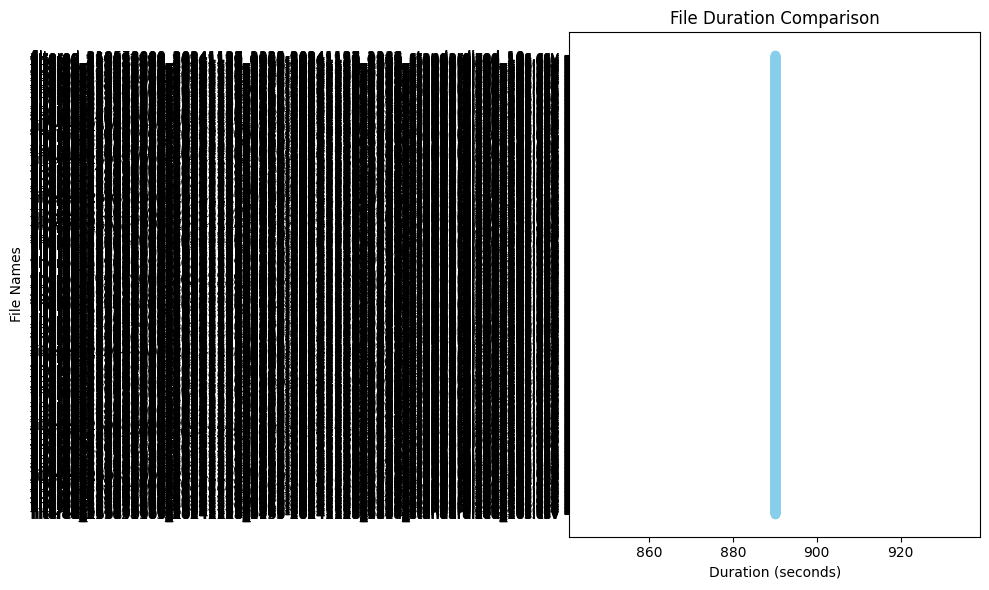

In [26]:
import os
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime

# Specify the folder path where your CSV files are located
folder_path = './time_sets_standardized'

# Lists to store file names and their durations
file_names = []
durations = []

# Loop through all CSV files in the folder
for filename in os.listdir(folder_path):
    if filename.endswith('.csv'):
        file_path = os.path.join(folder_path, filename)
        
        # Read the CSV file into a DataFrame
        df = pd.read_csv(file_path)

        # Convert 'Timestamp' to datetime format
        df['Timestamp'] = pd.to_datetime(df['Timestamp'])

        # Calculate the duration (time between first and last timestamp)
        time_diff = df['Timestamp'].max() - df['Timestamp'].min()

        # Append the file name and duration
        file_names.append(filename)
        durations.append(time_diff.total_seconds())  # Convert to seconds for easy comparison

# Scatter plot with durations on the x-axis
plt.figure(figsize=(10, 6))
plt.scatter(durations, file_names, color='skyblue')
plt.xlabel('Duration (seconds)')
plt.ylabel('File Names')
plt.title('File Duration Comparison')

# Show the plot
plt.tight_layout()
plt.show()


In [8]:
import os
import pandas as pd

def check_underway_sog(folder, sog_threshold):
    # Step 1: Get all CSV files in the specified folder
    csv_files = [f for f in os.listdir(folder) if f.endswith('.csv')]

    for csv_file in csv_files:
        file_path = os.path.join(folder, csv_file)
        try:
            # Step 2: Read the CSV file into a DataFrame
            df = pd.read_csv(file_path)

            # Step 3: Check if the navigational status is "Underway using engine" and SOG is above threshold
            if 'Navigational status' in df.columns and 'SOG' in df.columns:
                # Assuming there is only one row (vessel) per file, we directly check the condition
                navigational_status = df['Navigational status'].iloc[0]  # First row, first column value
                sog = df['SOG'].iloc[0]  # First row, first column value

                if navigational_status == 'Underway using engine' and sog > sog_threshold:
                    print(f"File {csv_file}: Vessel is 'Underway using engine' with SOG above {sog_threshold}")
            else:
                print(f"File {csv_file}: Missing required columns ('Navigational status' or 'SOG').")

        except Exception as e:
            print(f"Failed to process {csv_file}: {e}")

# Example usage:
folder = 'time_sets_st_shortened'  # Replace with your folder path
sog_threshold = 5.0  # Example threshold for SOG (e.g., 5 knots)

check_underway_sog(folder, sog_threshold)
